In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.optimizers import Adam
import numpy as np

In [2]:
class Policy:
    def __init__(self):
        self.alpha = 0.01
        self.policy = keras.models.Sequential([
            keras.layers.Dense(25, activation="relu", input_shape=[25]),
            keras.layers.Dense(10, activation="relu"),
            keras.layers.Dense(5, activation="softmax"),
        ])
        self.policy.compile(optimizer=Adam(learning_rate=self.alpha))
        
    def __call__(self, state):
        pi = self.policy(state)
        return pi
    
def get_obs(array, pos):
    obs = []
    i, j = pos
    for ii in range(-2, 3, 1):
        row = []
        for jj in range(-2, 3, 1):
            row.append(array[(i + ii) % len(array)][(j + jj) % len(array)])
        obs.append(row)     
    return obs

def apply_action(array, pos, action):
    i, j = pos
    if action == 0:
        array[i][j], array[i][(j + 1) % len(array)] = array[i][(j + 1) % len(array)], array[i][j]
    elif action == 1:
        array[i][j], array[i][(j - 1)] = array[i][(j - 1)], array[i][j]
    elif action == 2:
        array[i][j], array[i - 1][j] = array[i - 1][j], array[i][j]
    elif action == 3:
        array[i][j], array[i + 1][j] = array[(i + 1) % len(array)][j], array[i][j]

In [3]:
import gym
import random

In [4]:
types = [0, 1, 2]

In [5]:
obs = [[random.choice(types) for i in range(5)] for j in range(5)]
obs[2][2] = 1

In [6]:
array = np.array([[random.choice(types) for i in range(10)] for j in range(10)])

In [7]:
array

array([[2, 0, 2, 1, 0, 2, 2, 0, 0, 1],
       [1, 1, 0, 0, 2, 0, 0, 0, 0, 1],
       [0, 0, 2, 0, 0, 1, 0, 2, 0, 0],
       [1, 2, 2, 1, 2, 1, 1, 0, 0, 1],
       [1, 0, 0, 0, 0, 2, 0, 1, 2, 0],
       [2, 0, 2, 0, 2, 0, 0, 1, 0, 2],
       [0, 0, 1, 2, 2, 1, 2, 0, 1, 0],
       [1, 1, 2, 0, 2, 0, 1, 1, 0, 0],
       [1, 2, 2, 2, 1, 2, 2, 2, 2, 0],
       [0, 2, 1, 2, 2, 1, 2, 1, 2, 0]])

## Create Environment

In [8]:
from gym import Env
from gym.spaces import Discrete, Box, MultiDiscrete
import random

In [65]:
'''
Lets create environment that we have just onde predator in initial middle of table
'''
class PPEnv(Env):
    def __init__(self, L=5, time_limit=40, pos=(0, 0)):
        self.L = L
        self.pos = (self.L // 2, self.L // 2)
        self.action_space = Discrete(4)
        self.obs_shape = (5, 5)
        self.observation_space = gym.spaces.utils.flatten_space(MultiDiscrete(np.array([[1 for i in range(5)] for j in range(5)]))) #MultiDiscrete(np.array([[1 for i in range(5)] for j in range(5)]))
        self.types = Discrete(3)
        self.array = np.array([[Discrete(2).sample() * 2 for i in range(self.L)] for j in range(self.L)])
        # Put one predator
        self.array[self.pos[0], self.pos[1]] = 1               
        self.time = 0
        self.time_limit = time_limit
    
    def get_obs(self):
        obs = []
        i, j = self.pos
        for ii in range(-2, 3, 1):
            row = []
            for jj in range(-2, 3, 1):
                row.append(self.array[(i + ii) % self.L][(j + jj) % self.L])
            obs.append(row)     
        return np.array(obs)
    
    # Jump
    def apply_action(self, action):
        i, j = self.pos
        L = self.L
        if action == 0:
            self.array[i][j], self.array[i][(j + 1) % L] = self.array[i][(j + 1) % L], self.array[i][j]
            self.pos = (i, (j + 1) % L)
        elif action == 1:
            self.array[i][j], self.array[i][(j - 1) % L] = self.array[i][(j - 1) % L], self.array[i][j]
            self.pos = (i, (j - 1) % L)
        elif action == 2:
            self.array[i][j], self.array[(i - 1) % L][j] = self.array[(i - 1) % L][j], self.array[i][j]
            self.pos = ((i - 1) % L, j)
        elif action == 3:
            self.array[i][j], self.array[(i + 1) % L][j] = self.array[(i + 1) % L][j], self.array[i][j]
            self.pos = ((i + 1) % L, j)
    
    def get_neighboors(self):
        i, j = self.pos
        adress = [
            (i, (j + 1) % self.L), 
            (i, (j - 1) % self.L), 
            ((i - 1) % self.L, j), 
            ((i + 1) % self.L, j)
        ]
        right, left, up, down = self.array[adress[0][0]][adress[0][1]], self.array[adress[1][0]][adress[1][1]], self.array[adress[2][0]][adress[2][1]], self.array[adress[3][0]][adress[3][1]]
        return [right, left, up, down]
    
    def step(self, action):
        # Get obs
        obs = self.get_obs()
        
        # Colect reward
        ngbs = [obs[2][2 + 1], obs[2][2 - 1], obs[2 - 1][2], obs[2 + 1][2]] #self.get_neighboors()
        reward = 2 ** ngbs.count(2)
        
        # Get info
        info = {}
        
        # Check if done
        if self.time >= self.time_limit:
            done = True
            return obs, reward, done, info
        else: 
            done = False
            
        # apply action
        self.apply_action(action)
        self.time += 1
        return obs.reshape(1, -1), reward, done, info
    
    def render(self):
        print('-' * self.L)
        print(self.array)
        print('-' * self.L)
    
    def reset(self):
        self.pos = (self.L // 2, self.L // 2)
        self.action_space = Discrete(4)
        self.observation_space = gym.spaces.utils.flatten_space(MultiDiscrete(np.array([[1 for i in range(5)] for j in range(5)]))) # MultiDiscrete(np.array([[3 for i in range(5)] for j in range(5)]))
        self.types = Discrete(3)
        self.array = np.array([[Discrete(2).sample() * 2 for i in range(self.L)] for j in range(self.L)])
        # Put one predator
        self.array[self.pos[0], self.pos[1]] = 1               
        self.time = 0
        return self.get_obs().reshape(1, -1)

In [66]:
env = PPEnv()

In [67]:
obs = env.reset()
env.apply_action(0)

In [68]:
env.action_space.sample()

3

### Testing environment

In [69]:
render = False

In [70]:
episodes = 100
for ep in range(episodes):
    obs = env.reset()
    done = False
    score = 0
    while not done:
        obs, rew, done, info = env.step(env.action_space.sample())
        if render:
            env.render()
        score += rew
    print(f"Ep: {ep} || Score: {score}")

Ep: 0 || Score: 238
Ep: 1 || Score: 207
Ep: 2 || Score: 159
Ep: 3 || Score: 244
Ep: 4 || Score: 208
Ep: 5 || Score: 202
Ep: 6 || Score: 161
Ep: 7 || Score: 278
Ep: 8 || Score: 175
Ep: 9 || Score: 189
Ep: 10 || Score: 178
Ep: 11 || Score: 292
Ep: 12 || Score: 133
Ep: 13 || Score: 190
Ep: 14 || Score: 129
Ep: 15 || Score: 280
Ep: 16 || Score: 256
Ep: 17 || Score: 132
Ep: 18 || Score: 192
Ep: 19 || Score: 199
Ep: 20 || Score: 196
Ep: 21 || Score: 278
Ep: 22 || Score: 98
Ep: 23 || Score: 398
Ep: 24 || Score: 176
Ep: 25 || Score: 237
Ep: 26 || Score: 304
Ep: 27 || Score: 113
Ep: 28 || Score: 205
Ep: 29 || Score: 204
Ep: 30 || Score: 277
Ep: 31 || Score: 179
Ep: 32 || Score: 161
Ep: 33 || Score: 292
Ep: 34 || Score: 176
Ep: 35 || Score: 272
Ep: 36 || Score: 254
Ep: 37 || Score: 216
Ep: 38 || Score: 209
Ep: 39 || Score: 286
Ep: 40 || Score: 169
Ep: 41 || Score: 257
Ep: 42 || Score: 255
Ep: 43 || Score: 180
Ep: 44 || Score: 103
Ep: 45 || Score: 171
Ep: 46 || Score: 238
Ep: 47 || Score: 178
Ep:

In [71]:
np.array([Discrete(3)] * 25).shape

(25,)

In [72]:
MultiDiscrete(2).sample()

1

## PPO stablebaselines

In [73]:
import os
from stable_baselines3 import PPO
from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3.common.evaluation import evaluate_policy

## Treinando o modelo

In [74]:
log_path = os.path.join('Training', 'PP_0')

In [75]:
log_path

'Training\\PP_0'

In [76]:
len(gym.spaces.utils.flatten_space(env.observation_space).sample())

25

In [105]:
model2 = PPO('MlpPolicy', env, verbose=1, tensorboard_log=log_path)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


C:\Users\gabri\anaconda3\lib\site-packages\gym\core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(


In [106]:
model2.set_parameters(model.get_parameters())

In [107]:
model2.learn(total_timesteps=40000000, callback=None, log_interval=1, eval_env=env)

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Logging to Training\PP_0\PPO_4


C:\Users\gabri\anaconda3\lib\site-packages\gym\core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 41       |
|    ep_rew_mean     | 305      |
| time/              |          |
|    fps             | 1180     |
|    iterations      | 1        |
|    time_elapsed    | 1        |
|    total_timesteps | 2048     |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 868         |
|    iterations           | 2           |
|    time_elapsed         | 4           |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.002930596 |
|    clip_fraction        | 0.0253      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.3        |
|    explained_variance   | 0.283       |
|    learning_rate        | 0.

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 691          |
|    iterations           | 11           |
|    time_elapsed         | 32           |
|    total_timesteps      | 22528        |
| train/                  |              |
|    approx_kl            | 0.0025815158 |
|    clip_fraction        | 0.022        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.251       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 100          |
|    policy_gradient_loss | -0.00699     |
|    value_loss           | 5.63e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 641          |
|    iterations           | 21           |
|    time_elapsed         | 67           |
|    total_timesteps      | 43008        |
| train/                  |              |
|    approx_kl            | 0.0030041472 |
|    clip_fraction        | 0.0337       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.319        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.98e+03     |
|    n_updates            | 200          |
|    policy_gradient_loss | -0.00739     |
|    value_loss           | 5.13e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 653         |
|    iterations           | 31          |
|    time_elapsed         | 97          |
|    total_timesteps      | 63488       |
| train/                  |             |
|    approx_kl            | 0.002604977 |
|    clip_fraction        | 0.018       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.2e+03     |
|    n_updates            | 300         |
|    policy_gradient_loss | -0.00633    |
|    value_loss           | 5.38e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 674          |
|    iterations           | 41           |
|    time_elapsed         | 124          |
|    total_timesteps      | 83968        |
| train/                  |              |
|    approx_kl            | 0.0024594562 |
|    clip_fraction        | 0.0257       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.3         |
|    explained_variance   | 0.247        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 400          |
|    policy_gradient_loss | -0.00671     |
|    value_loss           | 5.68e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 681         |
|    iterations           | 51          |
|    time_elapsed         | 153         |
|    total_timesteps      | 104448      |
| train/                  |             |
|    approx_kl            | 0.002793749 |
|    clip_fraction        | 0.0303      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.14e+03    |
|    n_updates            | 500         |
|    policy_gradient_loss | -0.00755    |
|    value_loss           | 5.09e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 332         |
| time/                   |             |
|    fps                  | 673         |
|    iterations           | 61          |
|    time_elapsed         | 185         |
|    total_timesteps      | 124928      |
| train/                  |             |
|    approx_kl            | 0.002049278 |
|    clip_fraction        | 0.0169      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.241      |
|    explained_variance   | 0.152       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.05e+03    |
|    n_updates            | 600         |
|    policy_gradient_loss | -0.00576    |
|    value_loss           | 5.86e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 674          |
|    iterations           | 71           |
|    time_elapsed         | 215          |
|    total_timesteps      | 145408       |
| train/                  |              |
|    approx_kl            | 0.0037689526 |
|    clip_fraction        | 0.0323       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43e+03     |
|    n_updates            | 700          |
|    policy_gradient_loss | -0.0088      |
|    value_loss           | 5.12e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 682          |
|    iterations           | 81           |
|    time_elapsed         | 243          |
|    total_timesteps      | 165888       |
| train/                  |              |
|    approx_kl            | 0.0030269895 |
|    clip_fraction        | 0.0268       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.27        |
|    explained_variance   | 0.28         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 800          |
|    policy_gradient_loss | -0.00808     |
|    value_loss           | 4.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 687          |
|    iterations           | 91           |
|    time_elapsed         | 271          |
|    total_timesteps      | 186368       |
| train/                  |              |
|    approx_kl            | 0.0023706786 |
|    clip_fraction        | 0.0232       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.258       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 900          |
|    policy_gradient_loss | -0.00574     |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 682          |
|    iterations           | 101          |
|    time_elapsed         | 303          |
|    total_timesteps      | 206848       |
| train/                  |              |
|    approx_kl            | 0.0029018763 |
|    clip_fraction        | 0.0264       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.285       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 1000         |
|    policy_gradient_loss | -0.00667     |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 683          |
|    iterations           | 111          |
|    time_elapsed         | 332          |
|    total_timesteps      | 227328       |
| train/                  |              |
|    approx_kl            | 0.0032139954 |
|    clip_fraction        | 0.0324       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.281       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43e+03     |
|    n_updates            | 1100         |
|    policy_gradient_loss | -0.00908     |
|    value_loss           | 5.61e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 688          |
|    iterations           | 121          |
|    time_elapsed         | 359          |
|    total_timesteps      | 247808       |
| train/                  |              |
|    approx_kl            | 0.0029729796 |
|    clip_fraction        | 0.0244       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.273       |
|    explained_variance   | 0.259        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.05e+03     |
|    n_updates            | 1200         |
|    policy_gradient_loss | -0.00675     |
|    value_loss           | 4.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 691          |
|    iterations           | 131          |
|    time_elapsed         | 388          |
|    total_timesteps      | 268288       |
| train/                  |              |
|    approx_kl            | 0.0030744257 |
|    clip_fraction        | 0.028        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.34e+03     |
|    n_updates            | 1300         |
|    policy_gradient_loss | -0.00838     |
|    value_loss           | 5.39e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 688          |
|    iterations           | 141          |
|    time_elapsed         | 419          |
|    total_timesteps      | 288768       |
| train/                  |              |
|    approx_kl            | 0.0021821312 |
|    clip_fraction        | 0.0172       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.286       |
|    explained_variance   | 0.237        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 1400         |
|    policy_gradient_loss | -0.00492     |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 688          |
|    iterations           | 151          |
|    time_elapsed         | 449          |
|    total_timesteps      | 309248       |
| train/                  |              |
|    approx_kl            | 0.0017696167 |
|    clip_fraction        | 0.017        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.244       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 1500         |
|    policy_gradient_loss | -0.00496     |
|    value_loss           | 4.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 693          |
|    iterations           | 161          |
|    time_elapsed         | 475          |
|    total_timesteps      | 329728       |
| train/                  |              |
|    approx_kl            | 0.0025478574 |
|    clip_fraction        | 0.0224       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.255       |
|    explained_variance   | 0.282        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.84e+03     |
|    n_updates            | 1600         |
|    policy_gradient_loss | -0.0065      |
|    value_loss           | 5.71e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 696          |
|    iterations           | 171          |
|    time_elapsed         | 502          |
|    total_timesteps      | 350208       |
| train/                  |              |
|    approx_kl            | 0.0023214081 |
|    clip_fraction        | 0.0185       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.266       |
|    explained_variance   | 0.294        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.59e+03     |
|    n_updates            | 1700         |
|    policy_gradient_loss | -0.0061      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 697          |
|    iterations           | 181          |
|    time_elapsed         | 531          |
|    total_timesteps      | 370688       |
| train/                  |              |
|    approx_kl            | 0.0027276846 |
|    clip_fraction        | 0.0302       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.278       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 1800         |
|    policy_gradient_loss | -0.00721     |
|    value_loss           | 5.76e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 696          |
|    iterations           | 191          |
|    time_elapsed         | 561          |
|    total_timesteps      | 391168       |
| train/                  |              |
|    approx_kl            | 0.0030019945 |
|    clip_fraction        | 0.0337       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.245       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 1900         |
|    policy_gradient_loss | -0.00779     |
|    value_loss           | 5.64e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 698          |
|    iterations           | 201          |
|    time_elapsed         | 589          |
|    total_timesteps      | 411648       |
| train/                  |              |
|    approx_kl            | 0.0031083701 |
|    clip_fraction        | 0.0276       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.286       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.72e+03     |
|    n_updates            | 2000         |
|    policy_gradient_loss | -0.00731     |
|    value_loss           | 5e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 701          |
|    iterations           | 211          |
|    time_elapsed         | 616          |
|    total_timesteps      | 432128       |
| train/                  |              |
|    approx_kl            | 0.0026571737 |
|    clip_fraction        | 0.0215       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 2100         |
|    policy_gradient_loss | -0.00734     |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 340          |
| time/                   |              |
|    fps                  | 701          |
|    iterations           | 221          |
|    time_elapsed         | 645          |
|    total_timesteps      | 452608       |
| train/                  |              |
|    approx_kl            | 0.0022358657 |
|    clip_fraction        | 0.021        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.247       |
|    explained_variance   | 0.156        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.76e+03     |
|    n_updates            | 2200         |
|    policy_gradient_loss | -0.00603     |
|    value_loss           | 5.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 336          |
| time/                   |              |
|    fps                  | 700          |
|    iterations           | 231          |
|    time_elapsed         | 675          |
|    total_timesteps      | 473088       |
| train/                  |              |
|    approx_kl            | 0.0019364341 |
|    clip_fraction        | 0.0217       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.252       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.2e+03      |
|    n_updates            | 2300         |
|    policy_gradient_loss | -0.00511     |
|    value_loss           | 6.12e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 702          |
|    iterations           | 241          |
|    time_elapsed         | 702          |
|    total_timesteps      | 493568       |
| train/                  |              |
|    approx_kl            | 0.0029308745 |
|    clip_fraction        | 0.0217       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.247       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.1e+03      |
|    n_updates            | 2400         |
|    policy_gradient_loss | -0.00744     |
|    value_loss           | 5.67e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 704          |
|    iterations           | 251          |
|    time_elapsed         | 729          |
|    total_timesteps      | 514048       |
| train/                  |              |
|    approx_kl            | 0.0027466852 |
|    clip_fraction        | 0.0218       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 2500         |
|    policy_gradient_loss | -0.00605     |
|    value_loss           | 5.3e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 706          |
|    iterations           | 261          |
|    time_elapsed         | 756          |
|    total_timesteps      | 534528       |
| train/                  |              |
|    approx_kl            | 0.0024971662 |
|    clip_fraction        | 0.0226       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.259       |
|    explained_variance   | 0.242        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 2600         |
|    policy_gradient_loss | -0.00692     |
|    value_loss           | 5.59e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 705          |
|    iterations           | 271          |
|    time_elapsed         | 787          |
|    total_timesteps      | 555008       |
| train/                  |              |
|    approx_kl            | 0.0026505687 |
|    clip_fraction        | 0.0227       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.258       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 2700         |
|    policy_gradient_loss | -0.00599     |
|    value_loss           | 5.8e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 340          |
| time/                   |              |
|    fps                  | 705          |
|    iterations           | 281          |
|    time_elapsed         | 815          |
|    total_timesteps      | 575488       |
| train/                  |              |
|    approx_kl            | 0.0015345563 |
|    clip_fraction        | 0.0125       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.216       |
|    explained_variance   | 0.269        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.67e+03     |
|    n_updates            | 2800         |
|    policy_gradient_loss | -0.00495     |
|    value_loss           | 6.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 707          |
|    iterations           | 291          |
|    time_elapsed         | 842          |
|    total_timesteps      | 595968       |
| train/                  |              |
|    approx_kl            | 0.0021463274 |
|    clip_fraction        | 0.0225       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.243       |
|    explained_variance   | 0.113        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43e+03     |
|    n_updates            | 2900         |
|    policy_gradient_loss | -0.00679     |
|    value_loss           | 6.54e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 342         |
| time/                   |             |
|    fps                  | 709         |
|    iterations           | 301         |
|    time_elapsed         | 869         |
|    total_timesteps      | 616448      |
| train/                  |             |
|    approx_kl            | 0.001720774 |
|    clip_fraction        | 0.0125      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.248      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 3000        |
|    policy_gradient_loss | -0.00512    |
|    value_loss           | 5.65e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 707          |
|    iterations           | 311          |
|    time_elapsed         | 900          |
|    total_timesteps      | 636928       |
| train/                  |              |
|    approx_kl            | 0.0034103221 |
|    clip_fraction        | 0.0397       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.268       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.49e+03     |
|    n_updates            | 3100         |
|    policy_gradient_loss | -0.0089      |
|    value_loss           | 5.72e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 708          |
|    iterations           | 321          |
|    time_elapsed         | 928          |
|    total_timesteps      | 657408       |
| train/                  |              |
|    approx_kl            | 0.0023633405 |
|    clip_fraction        | 0.0207       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.255       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 3200         |
|    policy_gradient_loss | -0.00584     |
|    value_loss           | 5.08e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 709          |
|    iterations           | 331          |
|    time_elapsed         | 955          |
|    total_timesteps      | 677888       |
| train/                  |              |
|    approx_kl            | 0.0027454342 |
|    clip_fraction        | 0.0208       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.273       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.39e+03     |
|    n_updates            | 3300         |
|    policy_gradient_loss | -0.00673     |
|    value_loss           | 6.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 710          |
|    iterations           | 341          |
|    time_elapsed         | 982          |
|    total_timesteps      | 698368       |
| train/                  |              |
|    approx_kl            | 0.0028405017 |
|    clip_fraction        | 0.0247       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.251       |
|    explained_variance   | 0.238        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 3400         |
|    policy_gradient_loss | -0.00584     |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 712         |
|    iterations           | 351         |
|    time_elapsed         | 1009        |
|    total_timesteps      | 718848      |
| train/                  |             |
|    approx_kl            | 0.003578444 |
|    clip_fraction        | 0.0322      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 3500        |
|    policy_gradient_loss | -0.00837    |
|    value_loss           | 5.58e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 713          |
|    iterations           | 361          |
|    time_elapsed         | 1036         |
|    total_timesteps      | 739328       |
| train/                  |              |
|    approx_kl            | 0.0018335772 |
|    clip_fraction        | 0.0116       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.234       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.71e+03     |
|    n_updates            | 3600         |
|    policy_gradient_loss | -0.005       |
|    value_loss           | 5.43e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 714          |
|    iterations           | 371          |
|    time_elapsed         | 1062         |
|    total_timesteps      | 759808       |
| train/                  |              |
|    approx_kl            | 0.0024404149 |
|    clip_fraction        | 0.0245       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.272       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.71e+03     |
|    n_updates            | 3700         |
|    policy_gradient_loss | -0.00775     |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 715          |
|    iterations           | 381          |
|    time_elapsed         | 1090         |
|    total_timesteps      | 780288       |
| train/                  |              |
|    approx_kl            | 0.0021892479 |
|    clip_fraction        | 0.0197       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.266       |
|    explained_variance   | 0.293        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.47e+03     |
|    n_updates            | 3800         |
|    policy_gradient_loss | -0.00668     |
|    value_loss           | 5.37e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 331        |
| time/                   |            |
|    fps                  | 715        |
|    iterations           | 391        |
|    time_elapsed         | 1118       |
|    total_timesteps      | 800768     |
| train/                  |            |
|    approx_kl            | 0.00294891 |
|    clip_fraction        | 0.0234     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.288     |
|    explained_variance   | 0.225      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.98e+03   |
|    n_updates            | 3900       |
|    policy_gradient_loss | -0.00768   |
|    value_loss           | 5.56e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 716          |
|    iterations           | 401          |
|    time_elapsed         | 1146         |
|    total_timesteps      | 821248       |
| train/                  |              |
|    approx_kl            | 0.0027573127 |
|    clip_fraction        | 0.0282       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.254        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 4000         |
|    policy_gradient_loss | -0.00725     |
|    value_loss           | 5.64e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 716          |
|    iterations           | 411          |
|    time_elapsed         | 1174         |
|    total_timesteps      | 841728       |
| train/                  |              |
|    approx_kl            | 0.0027613952 |
|    clip_fraction        | 0.0227       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.256       |
|    explained_variance   | 0.237        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 4100         |
|    policy_gradient_loss | -0.00594     |
|    value_loss           | 5.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 719          |
|    iterations           | 421          |
|    time_elapsed         | 1199         |
|    total_timesteps      | 862208       |
| train/                  |              |
|    approx_kl            | 0.0027728062 |
|    clip_fraction        | 0.0317       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.241       |
|    explained_variance   | 0.296        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 4200         |
|    policy_gradient_loss | -0.00729     |
|    value_loss           | 5.31e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 722          |
|    iterations           | 431          |
|    time_elapsed         | 1221         |
|    total_timesteps      | 882688       |
| train/                  |              |
|    approx_kl            | 0.0024790212 |
|    clip_fraction        | 0.0246       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.245        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.62e+03     |
|    n_updates            | 4300         |
|    policy_gradient_loss | -0.00654     |
|    value_loss           | 5e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 725          |
|    iterations           | 441          |
|    time_elapsed         | 1244         |
|    total_timesteps      | 903168       |
| train/                  |              |
|    approx_kl            | 0.0025461523 |
|    clip_fraction        | 0.0215       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.31e+03     |
|    n_updates            | 4400         |
|    policy_gradient_loss | -0.00597     |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 729          |
|    iterations           | 451          |
|    time_elapsed         | 1266         |
|    total_timesteps      | 923648       |
| train/                  |              |
|    approx_kl            | 0.0028336379 |
|    clip_fraction        | 0.0204       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.265       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.54e+03     |
|    n_updates            | 4500         |
|    policy_gradient_loss | -0.00663     |
|    value_loss           | 6.05e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 732          |
|    iterations           | 461          |
|    time_elapsed         | 1289         |
|    total_timesteps      | 944128       |
| train/                  |              |
|    approx_kl            | 0.0034399885 |
|    clip_fraction        | 0.0339       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.261       |
|    explained_variance   | 0.257        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 4600         |
|    policy_gradient_loss | -0.00726     |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 735          |
|    iterations           | 471          |
|    time_elapsed         | 1312         |
|    total_timesteps      | 964608       |
| train/                  |              |
|    approx_kl            | 0.0023179264 |
|    clip_fraction        | 0.0278       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.241       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 4700         |
|    policy_gradient_loss | -0.00631     |
|    value_loss           | 4.99e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 738          |
|    iterations           | 481          |
|    time_elapsed         | 1334         |
|    total_timesteps      | 985088       |
| train/                  |              |
|    approx_kl            | 0.0025220565 |
|    clip_fraction        | 0.0254       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.259       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 4800         |
|    policy_gradient_loss | -0.00677     |
|    value_loss           | 5.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 740         |
|    iterations           | 491         |
|    time_elapsed         | 1357        |
|    total_timesteps      | 1005568     |
| train/                  |             |
|    approx_kl            | 0.003293295 |
|    clip_fraction        | 0.0333      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.26       |
|    explained_variance   | 0.272       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.15e+03    |
|    n_updates            | 4900        |
|    policy_gradient_loss | -0.0079     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 743          |
|    iterations           | 501          |
|    time_elapsed         | 1379         |
|    total_timesteps      | 1026048      |
| train/                  |              |
|    approx_kl            | 0.0021242225 |
|    clip_fraction        | 0.0215       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.243       |
|    explained_variance   | 0.231        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 5000         |
|    policy_gradient_loss | -0.00611     |
|    value_loss           | 6.29e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 746          |
|    iterations           | 511          |
|    time_elapsed         | 1401         |
|    total_timesteps      | 1046528      |
| train/                  |              |
|    approx_kl            | 0.0023843506 |
|    clip_fraction        | 0.0235       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.237       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 5100         |
|    policy_gradient_loss | -0.00685     |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 749          |
|    iterations           | 521          |
|    time_elapsed         | 1423         |
|    total_timesteps      | 1067008      |
| train/                  |              |
|    approx_kl            | 0.0028369138 |
|    clip_fraction        | 0.0231       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.226       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.13e+03     |
|    n_updates            | 5200         |
|    policy_gradient_loss | -0.00659     |
|    value_loss           | 4.94e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 752          |
|    iterations           | 531          |
|    time_elapsed         | 1444         |
|    total_timesteps      | 1087488      |
| train/                  |              |
|    approx_kl            | 0.0020478785 |
|    clip_fraction        | 0.0152       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.239       |
|    explained_variance   | 0.294        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 5300         |
|    policy_gradient_loss | -0.00553     |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 755          |
|    iterations           | 541          |
|    time_elapsed         | 1467         |
|    total_timesteps      | 1107968      |
| train/                  |              |
|    approx_kl            | 0.0019304425 |
|    clip_fraction        | 0.0246       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.247       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 5400         |
|    policy_gradient_loss | -0.006       |
|    value_loss           | 6.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 757          |
|    iterations           | 551          |
|    time_elapsed         | 1489         |
|    total_timesteps      | 1128448      |
| train/                  |              |
|    approx_kl            | 0.0018421804 |
|    clip_fraction        | 0.0169       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.227       |
|    explained_variance   | 0.269        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 5500         |
|    policy_gradient_loss | -0.00581     |
|    value_loss           | 5.19e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 759          |
|    iterations           | 561          |
|    time_elapsed         | 1512         |
|    total_timesteps      | 1148928      |
| train/                  |              |
|    approx_kl            | 0.0022726024 |
|    clip_fraction        | 0.022        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.222       |
|    explained_variance   | 0.299        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.94e+03     |
|    n_updates            | 5600         |
|    policy_gradient_loss | -0.0049      |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 762          |
|    iterations           | 571          |
|    time_elapsed         | 1534         |
|    total_timesteps      | 1169408      |
| train/                  |              |
|    approx_kl            | 0.0028660824 |
|    clip_fraction        | 0.0255       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.249       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.73e+03     |
|    n_updates            | 5700         |
|    policy_gradient_loss | -0.00779     |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 764         |
|    iterations           | 581         |
|    time_elapsed         | 1555        |
|    total_timesteps      | 1189888     |
| train/                  |             |
|    approx_kl            | 0.002340029 |
|    clip_fraction        | 0.0218      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.261      |
|    explained_variance   | 0.227       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.83e+03    |
|    n_updates            | 5800        |
|    policy_gradient_loss | -0.00687    |
|    value_loss           | 6.03e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 767          |
|    iterations           | 591          |
|    time_elapsed         | 1577         |
|    total_timesteps      | 1210368      |
| train/                  |              |
|    approx_kl            | 0.0023136293 |
|    clip_fraction        | 0.021        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.251       |
|    explained_variance   | 0.303        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.17e+03     |
|    n_updates            | 5900         |
|    policy_gradient_loss | -0.00717     |
|    value_loss           | 5.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 769          |
|    iterations           | 601          |
|    time_elapsed         | 1599         |
|    total_timesteps      | 1230848      |
| train/                  |              |
|    approx_kl            | 0.0020507458 |
|    clip_fraction        | 0.0125       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.231       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 6000         |
|    policy_gradient_loss | -0.00541     |
|    value_loss           | 5.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 771          |
|    iterations           | 611          |
|    time_elapsed         | 1621         |
|    total_timesteps      | 1251328      |
| train/                  |              |
|    approx_kl            | 0.0024801134 |
|    clip_fraction        | 0.0208       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.238       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 6100         |
|    policy_gradient_loss | -0.00633     |
|    value_loss           | 5.65e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 773          |
|    iterations           | 621          |
|    time_elapsed         | 1643         |
|    total_timesteps      | 1271808      |
| train/                  |              |
|    approx_kl            | 0.0032629492 |
|    clip_fraction        | 0.0288       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.258       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.94e+03     |
|    n_updates            | 6200         |
|    policy_gradient_loss | -0.00767     |
|    value_loss           | 5.59e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 775          |
|    iterations           | 631          |
|    time_elapsed         | 1665         |
|    total_timesteps      | 1292288      |
| train/                  |              |
|    approx_kl            | 0.0028782168 |
|    clip_fraction        | 0.0223       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.58e+03     |
|    n_updates            | 6300         |
|    policy_gradient_loss | -0.00682     |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 778          |
|    iterations           | 641          |
|    time_elapsed         | 1687         |
|    total_timesteps      | 1312768      |
| train/                  |              |
|    approx_kl            | 0.0025005979 |
|    clip_fraction        | 0.0194       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.251       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 6400         |
|    policy_gradient_loss | -0.00705     |
|    value_loss           | 5.47e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 780          |
|    iterations           | 651          |
|    time_elapsed         | 1709         |
|    total_timesteps      | 1333248      |
| train/                  |              |
|    approx_kl            | 0.0025540662 |
|    clip_fraction        | 0.0201       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.213       |
|    explained_variance   | 0.285        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.3e+03      |
|    n_updates            | 6500         |
|    policy_gradient_loss | -0.00599     |
|    value_loss           | 6e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 782          |
|    iterations           | 661          |
|    time_elapsed         | 1730         |
|    total_timesteps      | 1353728      |
| train/                  |              |
|    approx_kl            | 0.0015614268 |
|    clip_fraction        | 0.0104       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.244       |
|    explained_variance   | 0.263        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.96e+03     |
|    n_updates            | 6600         |
|    policy_gradient_loss | -0.00435     |
|    value_loss           | 6.02e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 783          |
|    iterations           | 671          |
|    time_elapsed         | 1752         |
|    total_timesteps      | 1374208      |
| train/                  |              |
|    approx_kl            | 0.0022974042 |
|    clip_fraction        | 0.0293       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.218       |
|    explained_variance   | 0.297        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.02e+03     |
|    n_updates            | 6700         |
|    policy_gradient_loss | -0.00688     |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 785          |
|    iterations           | 681          |
|    time_elapsed         | 1774         |
|    total_timesteps      | 1394688      |
| train/                  |              |
|    approx_kl            | 0.0025556656 |
|    clip_fraction        | 0.0225       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.245       |
|    explained_variance   | 0.261        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.86e+03     |
|    n_updates            | 6800         |
|    policy_gradient_loss | -0.00665     |
|    value_loss           | 5.45e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 787          |
|    iterations           | 691          |
|    time_elapsed         | 1796         |
|    total_timesteps      | 1415168      |
| train/                  |              |
|    approx_kl            | 0.0019399318 |
|    clip_fraction        | 0.0148       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.208       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.03e+03     |
|    n_updates            | 6900         |
|    policy_gradient_loss | -0.00558     |
|    value_loss           | 5.72e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 789          |
|    iterations           | 701          |
|    time_elapsed         | 1818         |
|    total_timesteps      | 1435648      |
| train/                  |              |
|    approx_kl            | 0.0023934697 |
|    clip_fraction        | 0.0196       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.234       |
|    explained_variance   | 0.247        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.16e+03     |
|    n_updates            | 7000         |
|    policy_gradient_loss | -0.00676     |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 791          |
|    iterations           | 711          |
|    time_elapsed         | 1840         |
|    total_timesteps      | 1456128      |
| train/                  |              |
|    approx_kl            | 0.0021928104 |
|    clip_fraction        | 0.0142       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.223       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 7100         |
|    policy_gradient_loss | -0.00527     |
|    value_loss           | 6.59e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 792          |
|    iterations           | 721          |
|    time_elapsed         | 1862         |
|    total_timesteps      | 1476608      |
| train/                  |              |
|    approx_kl            | 0.0035064176 |
|    clip_fraction        | 0.0345       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.192        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.86e+03     |
|    n_updates            | 7200         |
|    policy_gradient_loss | -0.00882     |
|    value_loss           | 5.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 794          |
|    iterations           | 731          |
|    time_elapsed         | 1884         |
|    total_timesteps      | 1497088      |
| train/                  |              |
|    approx_kl            | 0.0019394706 |
|    clip_fraction        | 0.0151       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.22        |
|    explained_variance   | 0.266        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 7300         |
|    policy_gradient_loss | -0.00505     |
|    value_loss           | 5.25e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 796         |
|    iterations           | 741         |
|    time_elapsed         | 1906        |
|    total_timesteps      | 1517568     |
| train/                  |             |
|    approx_kl            | 0.002085832 |
|    clip_fraction        | 0.0187      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.227      |
|    explained_variance   | 0.214       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.55e+03    |
|    n_updates            | 7400        |
|    policy_gradient_loss | -0.00594    |
|    value_loss           | 5.72e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 797          |
|    iterations           | 751          |
|    time_elapsed         | 1927         |
|    total_timesteps      | 1538048      |
| train/                  |              |
|    approx_kl            | 0.0030603306 |
|    clip_fraction        | 0.0245       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.243       |
|    explained_variance   | 0.272        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 7500         |
|    policy_gradient_loss | -0.00878     |
|    value_loss           | 4.92e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 799          |
|    iterations           | 761          |
|    time_elapsed         | 1949         |
|    total_timesteps      | 1558528      |
| train/                  |              |
|    approx_kl            | 0.0023894436 |
|    clip_fraction        | 0.0269       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.214       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 7600         |
|    policy_gradient_loss | -0.00624     |
|    value_loss           | 4.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 800          |
|    iterations           | 771          |
|    time_elapsed         | 1971         |
|    total_timesteps      | 1579008      |
| train/                  |              |
|    approx_kl            | 0.0025210772 |
|    clip_fraction        | 0.0203       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.232       |
|    explained_variance   | 0.27         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.05e+03     |
|    n_updates            | 7700         |
|    policy_gradient_loss | -0.00593     |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 802          |
|    iterations           | 781          |
|    time_elapsed         | 1993         |
|    total_timesteps      | 1599488      |
| train/                  |              |
|    approx_kl            | 0.0027030837 |
|    clip_fraction        | 0.0276       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.252       |
|    explained_variance   | 0.246        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 7800         |
|    policy_gradient_loss | -0.00686     |
|    value_loss           | 5.94e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 803          |
|    iterations           | 791          |
|    time_elapsed         | 2015         |
|    total_timesteps      | 1619968      |
| train/                  |              |
|    approx_kl            | 0.0027425024 |
|    clip_fraction        | 0.0249       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 7900         |
|    policy_gradient_loss | -0.00715     |
|    value_loss           | 6.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 344          |
| time/                   |              |
|    fps                  | 805          |
|    iterations           | 801          |
|    time_elapsed         | 2037         |
|    total_timesteps      | 1640448      |
| train/                  |              |
|    approx_kl            | 0.0024037757 |
|    clip_fraction        | 0.025        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.215       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.18e+03     |
|    n_updates            | 8000         |
|    policy_gradient_loss | -0.00792     |
|    value_loss           | 6e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 806          |
|    iterations           | 811          |
|    time_elapsed         | 2059         |
|    total_timesteps      | 1660928      |
| train/                  |              |
|    approx_kl            | 0.0024058777 |
|    clip_fraction        | 0.0195       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.204       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 8100         |
|    policy_gradient_loss | -0.00505     |
|    value_loss           | 4.97e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 807         |
|    iterations           | 821         |
|    time_elapsed         | 2081        |
|    total_timesteps      | 1681408     |
| train/                  |             |
|    approx_kl            | 0.002897042 |
|    clip_fraction        | 0.0225      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.223      |
|    explained_variance   | 0.239       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.34e+03    |
|    n_updates            | 8200        |
|    policy_gradient_loss | -0.00735    |
|    value_loss           | 6.04e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 809         |
|    iterations           | 831         |
|    time_elapsed         | 2103        |
|    total_timesteps      | 1701888     |
| train/                  |             |
|    approx_kl            | 0.002566337 |
|    clip_fraction        | 0.0237      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.219      |
|    explained_variance   | 0.259       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.64e+03    |
|    n_updates            | 8300        |
|    policy_gradient_loss | -0.00651    |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 810          |
|    iterations           | 841          |
|    time_elapsed         | 2125         |
|    total_timesteps      | 1722368      |
| train/                  |              |
|    approx_kl            | 0.0019408215 |
|    clip_fraction        | 0.0183       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.225       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.81e+03     |
|    n_updates            | 8400         |
|    policy_gradient_loss | -0.0056      |
|    value_loss           | 5.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 811          |
|    iterations           | 851          |
|    time_elapsed         | 2147         |
|    total_timesteps      | 1742848      |
| train/                  |              |
|    approx_kl            | 0.0016973789 |
|    clip_fraction        | 0.0148       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.222       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.23e+03     |
|    n_updates            | 8500         |
|    policy_gradient_loss | -0.00502     |
|    value_loss           | 5.45e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 812          |
|    iterations           | 861          |
|    time_elapsed         | 2169         |
|    total_timesteps      | 1763328      |
| train/                  |              |
|    approx_kl            | 0.0027986343 |
|    clip_fraction        | 0.0309       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.251        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 8600         |
|    policy_gradient_loss | -0.00804     |
|    value_loss           | 5.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 813          |
|    iterations           | 871          |
|    time_elapsed         | 2191         |
|    total_timesteps      | 1783808      |
| train/                  |              |
|    approx_kl            | 0.0022563725 |
|    clip_fraction        | 0.0234       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.225       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.02e+03     |
|    n_updates            | 8700         |
|    policy_gradient_loss | -0.00606     |
|    value_loss           | 5.48e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 815          |
|    iterations           | 881          |
|    time_elapsed         | 2213         |
|    total_timesteps      | 1804288      |
| train/                  |              |
|    approx_kl            | 0.0024457502 |
|    clip_fraction        | 0.0239       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.222       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.99e+03     |
|    n_updates            | 8800         |
|    policy_gradient_loss | -0.00659     |
|    value_loss           | 5.11e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 816          |
|    iterations           | 891          |
|    time_elapsed         | 2235         |
|    total_timesteps      | 1824768      |
| train/                  |              |
|    approx_kl            | 0.0029585545 |
|    clip_fraction        | 0.0225       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.288        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 8900         |
|    policy_gradient_loss | -0.00767     |
|    value_loss           | 5.6e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 817         |
|    iterations           | 901         |
|    time_elapsed         | 2257        |
|    total_timesteps      | 1845248     |
| train/                  |             |
|    approx_kl            | 0.002301427 |
|    clip_fraction        | 0.0255      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.233      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.93e+03    |
|    n_updates            | 9000        |
|    policy_gradient_loss | -0.00643    |
|    value_loss           | 5.99e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 818         |
|    iterations           | 911         |
|    time_elapsed         | 2279        |
|    total_timesteps      | 1865728     |
| train/                  |             |
|    approx_kl            | 0.002889973 |
|    clip_fraction        | 0.0239      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.226      |
|    explained_variance   | 0.186       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.16e+03    |
|    n_updates            | 9100        |
|    policy_gradient_loss | -0.00688    |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 819         |
|    iterations           | 921         |
|    time_elapsed         | 2301        |
|    total_timesteps      | 1886208     |
| train/                  |             |
|    approx_kl            | 0.002959204 |
|    clip_fraction        | 0.0271      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.236      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.03e+03    |
|    n_updates            | 9200        |
|    policy_gradient_loss | -0.00728    |
|    value_loss           | 5.57e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 820          |
|    iterations           | 931          |
|    time_elapsed         | 2323         |
|    total_timesteps      | 1906688      |
| train/                  |              |
|    approx_kl            | 0.0020778994 |
|    clip_fraction        | 0.0126       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.24        |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 9300         |
|    policy_gradient_loss | -0.00525     |
|    value_loss           | 6.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 821         |
|    iterations           | 941         |
|    time_elapsed         | 2345        |
|    total_timesteps      | 1927168     |
| train/                  |             |
|    approx_kl            | 0.002891676 |
|    clip_fraction        | 0.0328      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.213      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.33e+03    |
|    n_updates            | 9400        |
|    policy_gradient_loss | -0.00718    |
|    value_loss           | 5.45e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 340         |
| time/                   |             |
|    fps                  | 822         |
|    iterations           | 951         |
|    time_elapsed         | 2368        |
|    total_timesteps      | 1947648     |
| train/                  |             |
|    approx_kl            | 0.002363123 |
|    clip_fraction        | 0.0228      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.222      |
|    explained_variance   | 0.228       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.71e+03    |
|    n_updates            | 9500        |
|    policy_gradient_loss | -0.00651    |
|    value_loss           | 6.32e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 823          |
|    iterations           | 961          |
|    time_elapsed         | 2391         |
|    total_timesteps      | 1968128      |
| train/                  |              |
|    approx_kl            | 0.0022673197 |
|    clip_fraction        | 0.0192       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.207       |
|    explained_variance   | 0.264        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 9600         |
|    policy_gradient_loss | -0.00539     |
|    value_loss           | 5.56e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 342          |
| time/                   |              |
|    fps                  | 824          |
|    iterations           | 971          |
|    time_elapsed         | 2412         |
|    total_timesteps      | 1988608      |
| train/                  |              |
|    approx_kl            | 0.0023475024 |
|    clip_fraction        | 0.017        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.214       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.07e+03     |
|    n_updates            | 9700         |
|    policy_gradient_loss | -0.00598     |
|    value_loss           | 6.01e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 825          |
|    iterations           | 981          |
|    time_elapsed         | 2434         |
|    total_timesteps      | 2009088      |
| train/                  |              |
|    approx_kl            | 0.0020025005 |
|    clip_fraction        | 0.0181       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.219       |
|    explained_variance   | 0.179        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.73e+03     |
|    n_updates            | 9800         |
|    policy_gradient_loss | -0.00539     |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 826          |
|    iterations           | 991          |
|    time_elapsed         | 2456         |
|    total_timesteps      | 2029568      |
| train/                  |              |
|    approx_kl            | 0.0028716037 |
|    clip_fraction        | 0.0247       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.81e+03     |
|    n_updates            | 9900         |
|    policy_gradient_loss | -0.007       |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 826          |
|    iterations           | 1001         |
|    time_elapsed         | 2478         |
|    total_timesteps      | 2050048      |
| train/                  |              |
|    approx_kl            | 0.0038213271 |
|    clip_fraction        | 0.0333       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.22        |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.28e+03     |
|    n_updates            | 10000        |
|    policy_gradient_loss | -0.00815     |
|    value_loss           | 5.85e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 827          |
|    iterations           | 1011         |
|    time_elapsed         | 2500         |
|    total_timesteps      | 2070528      |
| train/                  |              |
|    approx_kl            | 0.0026825531 |
|    clip_fraction        | 0.0238       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.252       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.56e+03     |
|    n_updates            | 10100        |
|    policy_gradient_loss | -0.00711     |
|    value_loss           | 6.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 828          |
|    iterations           | 1021         |
|    time_elapsed         | 2522         |
|    total_timesteps      | 2091008      |
| train/                  |              |
|    approx_kl            | 0.0029879496 |
|    clip_fraction        | 0.0219       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 10200        |
|    policy_gradient_loss | -0.00723     |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 347          |
| time/                   |              |
|    fps                  | 829          |
|    iterations           | 1031         |
|    time_elapsed         | 2544         |
|    total_timesteps      | 2111488      |
| train/                  |              |
|    approx_kl            | 0.0026424807 |
|    clip_fraction        | 0.0245       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.227       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 10300        |
|    policy_gradient_loss | -0.00654     |
|    value_loss           | 6.66e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 830         |
|    iterations           | 1041        |
|    time_elapsed         | 2566        |
|    total_timesteps      | 2131968     |
| train/                  |             |
|    approx_kl            | 0.003524555 |
|    clip_fraction        | 0.0415      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.258      |
|    explained_variance   | 0.246       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.39e+03    |
|    n_updates            | 10400       |
|    policy_gradient_loss | -0.00783    |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 831          |
|    iterations           | 1051         |
|    time_elapsed         | 2588         |
|    total_timesteps      | 2152448      |
| train/                  |              |
|    approx_kl            | 0.0025895066 |
|    clip_fraction        | 0.026        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.68e+03     |
|    n_updates            | 10500        |
|    policy_gradient_loss | -0.00804     |
|    value_loss           | 5.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 832          |
|    iterations           | 1061         |
|    time_elapsed         | 2610         |
|    total_timesteps      | 2172928      |
| train/                  |              |
|    approx_kl            | 0.0025947841 |
|    clip_fraction        | 0.0222       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.231       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.54e+03     |
|    n_updates            | 10600        |
|    policy_gradient_loss | -0.007       |
|    value_loss           | 5.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 833          |
|    iterations           | 1071         |
|    time_elapsed         | 2632         |
|    total_timesteps      | 2193408      |
| train/                  |              |
|    approx_kl            | 0.0031913472 |
|    clip_fraction        | 0.0281       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.235       |
|    explained_variance   | 0.3          |
|    learning_rate        | 0.0003       |
|    loss                 | 1.82e+03     |
|    n_updates            | 10700        |
|    policy_gradient_loss | -0.00724     |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 345          |
| time/                   |              |
|    fps                  | 833          |
|    iterations           | 1081         |
|    time_elapsed         | 2655         |
|    total_timesteps      | 2213888      |
| train/                  |              |
|    approx_kl            | 0.0027974318 |
|    clip_fraction        | 0.0241       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.321        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.15e+03     |
|    n_updates            | 10800        |
|    policy_gradient_loss | -0.00664     |
|    value_loss           | 5.59e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 834          |
|    iterations           | 1091         |
|    time_elapsed         | 2676         |
|    total_timesteps      | 2234368      |
| train/                  |              |
|    approx_kl            | 0.0029931215 |
|    clip_fraction        | 0.0276       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.235       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2e+03        |
|    n_updates            | 10900        |
|    policy_gradient_loss | -0.00832     |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 835         |
|    iterations           | 1101        |
|    time_elapsed         | 2698        |
|    total_timesteps      | 2254848     |
| train/                  |             |
|    approx_kl            | 0.003134021 |
|    clip_fraction        | 0.0216      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.235      |
|    explained_variance   | 0.177       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 11000       |
|    policy_gradient_loss | -0.00839    |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 836          |
|    iterations           | 1111         |
|    time_elapsed         | 2720         |
|    total_timesteps      | 2275328      |
| train/                  |              |
|    approx_kl            | 0.0025599184 |
|    clip_fraction        | 0.0247       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.235       |
|    explained_variance   | 0.251        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 11100        |
|    policy_gradient_loss | -0.00728     |
|    value_loss           | 5.43e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 341          |
| time/                   |              |
|    fps                  | 837          |
|    iterations           | 1121         |
|    time_elapsed         | 2742         |
|    total_timesteps      | 2295808      |
| train/                  |              |
|    approx_kl            | 0.0026483724 |
|    clip_fraction        | 0.0268       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.278        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.99e+03     |
|    n_updates            | 11200        |
|    policy_gradient_loss | -0.00729     |
|    value_loss           | 6.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 837          |
|    iterations           | 1131         |
|    time_elapsed         | 2764         |
|    total_timesteps      | 2316288      |
| train/                  |              |
|    approx_kl            | 0.0031965768 |
|    clip_fraction        | 0.0372       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.235       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.1e+03      |
|    n_updates            | 11300        |
|    policy_gradient_loss | -0.00841     |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 838          |
|    iterations           | 1141         |
|    time_elapsed         | 2786         |
|    total_timesteps      | 2336768      |
| train/                  |              |
|    approx_kl            | 0.0025528115 |
|    clip_fraction        | 0.0241       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.251       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.49e+03     |
|    n_updates            | 11400        |
|    policy_gradient_loss | -0.00657     |
|    value_loss           | 5.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 839          |
|    iterations           | 1151         |
|    time_elapsed         | 2808         |
|    total_timesteps      | 2357248      |
| train/                  |              |
|    approx_kl            | 0.0035889018 |
|    clip_fraction        | 0.0346       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.222       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 11500        |
|    policy_gradient_loss | -0.00844     |
|    value_loss           | 5.73e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 840          |
|    iterations           | 1161         |
|    time_elapsed         | 2830         |
|    total_timesteps      | 2377728      |
| train/                  |              |
|    approx_kl            | 0.0031049938 |
|    clip_fraction        | 0.0278       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.221       |
|    explained_variance   | 0.273        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.23e+03     |
|    n_updates            | 11600        |
|    policy_gradient_loss | -0.00761     |
|    value_loss           | 6e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 840          |
|    iterations           | 1171         |
|    time_elapsed         | 2852         |
|    total_timesteps      | 2398208      |
| train/                  |              |
|    approx_kl            | 0.0022876228 |
|    clip_fraction        | 0.0183       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 11700        |
|    policy_gradient_loss | -0.0055      |
|    value_loss           | 5.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 841          |
|    iterations           | 1181         |
|    time_elapsed         | 2874         |
|    total_timesteps      | 2418688      |
| train/                  |              |
|    approx_kl            | 0.0034134618 |
|    clip_fraction        | 0.0299       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.93e+03     |
|    n_updates            | 11800        |
|    policy_gradient_loss | -0.00763     |
|    value_loss           | 5.55e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 330         |
| time/                   |             |
|    fps                  | 842         |
|    iterations           | 1191        |
|    time_elapsed         | 2896        |
|    total_timesteps      | 2439168     |
| train/                  |             |
|    approx_kl            | 0.002651156 |
|    clip_fraction        | 0.0216      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.223      |
|    explained_variance   | 0.235       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.19e+03    |
|    n_updates            | 11900       |
|    policy_gradient_loss | -0.00543    |
|    value_loss           | 6.01e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 842          |
|    iterations           | 1201         |
|    time_elapsed         | 2918         |
|    total_timesteps      | 2459648      |
| train/                  |              |
|    approx_kl            | 0.0025388277 |
|    clip_fraction        | 0.0241       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.221       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.01e+03     |
|    n_updates            | 12000        |
|    policy_gradient_loss | -0.00643     |
|    value_loss           | 5.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 843          |
|    iterations           | 1211         |
|    time_elapsed         | 2940         |
|    total_timesteps      | 2480128      |
| train/                  |              |
|    approx_kl            | 0.0025671145 |
|    clip_fraction        | 0.0297       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.239       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 12100        |
|    policy_gradient_loss | -0.00726     |
|    value_loss           | 5.49e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 339         |
| time/                   |             |
|    fps                  | 844         |
|    iterations           | 1221        |
|    time_elapsed         | 2962        |
|    total_timesteps      | 2500608     |
| train/                  |             |
|    approx_kl            | 0.002467088 |
|    clip_fraction        | 0.0223      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.229      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.07e+03    |
|    n_updates            | 12200       |
|    policy_gradient_loss | -0.0062     |
|    value_loss           | 6.4e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 844          |
|    iterations           | 1231         |
|    time_elapsed         | 2984         |
|    total_timesteps      | 2521088      |
| train/                  |              |
|    approx_kl            | 0.0021475286 |
|    clip_fraction        | 0.0235       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.205       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.02e+03     |
|    n_updates            | 12300        |
|    policy_gradient_loss | -0.00511     |
|    value_loss           | 5.41e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 845          |
|    iterations           | 1241         |
|    time_elapsed         | 3006         |
|    total_timesteps      | 2541568      |
| train/                  |              |
|    approx_kl            | 0.0023059235 |
|    clip_fraction        | 0.0222       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.196       |
|    explained_variance   | 0.161        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.63e+03     |
|    n_updates            | 12400        |
|    policy_gradient_loss | -0.00608     |
|    value_loss           | 5.47e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 845          |
|    iterations           | 1251         |
|    time_elapsed         | 3029         |
|    total_timesteps      | 2562048      |
| train/                  |              |
|    approx_kl            | 0.0031498377 |
|    clip_fraction        | 0.0249       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.219       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 12500        |
|    policy_gradient_loss | -0.00629     |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 846          |
|    iterations           | 1261         |
|    time_elapsed         | 3051         |
|    total_timesteps      | 2582528      |
| train/                  |              |
|    approx_kl            | 0.0030359218 |
|    clip_fraction        | 0.024        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.215       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 12600        |
|    policy_gradient_loss | -0.00644     |
|    value_loss           | 5.63e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 846         |
|    iterations           | 1271        |
|    time_elapsed         | 3073        |
|    total_timesteps      | 2603008     |
| train/                  |             |
|    approx_kl            | 0.003561158 |
|    clip_fraction        | 0.0297      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.209      |
|    explained_variance   | 0.263       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 12700       |
|    policy_gradient_loss | -0.00794    |
|    value_loss           | 5.3e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 847          |
|    iterations           | 1281         |
|    time_elapsed         | 3096         |
|    total_timesteps      | 2623488      |
| train/                  |              |
|    approx_kl            | 0.0025707523 |
|    clip_fraction        | 0.0279       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.206       |
|    explained_variance   | 0.292        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.4e+03      |
|    n_updates            | 12800        |
|    policy_gradient_loss | -0.00643     |
|    value_loss           | 6.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 847         |
|    iterations           | 1291        |
|    time_elapsed         | 3120        |
|    total_timesteps      | 2643968     |
| train/                  |             |
|    approx_kl            | 0.003177651 |
|    clip_fraction        | 0.024       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.203      |
|    explained_variance   | 0.233       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9e+03     |
|    n_updates            | 12900       |
|    policy_gradient_loss | -0.00624    |
|    value_loss           | 5.6e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 847          |
|    iterations           | 1301         |
|    time_elapsed         | 3143         |
|    total_timesteps      | 2664448      |
| train/                  |              |
|    approx_kl            | 0.0028141672 |
|    clip_fraction        | 0.025        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.232       |
|    explained_variance   | 0.277        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 13000        |
|    policy_gradient_loss | -0.00722     |
|    value_loss           | 5.54e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 848          |
|    iterations           | 1311         |
|    time_elapsed         | 3165         |
|    total_timesteps      | 2684928      |
| train/                  |              |
|    approx_kl            | 0.0029444864 |
|    clip_fraction        | 0.0231       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.203       |
|    explained_variance   | 0.255        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 13100        |
|    policy_gradient_loss | -0.0054      |
|    value_loss           | 5.8e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 848          |
|    iterations           | 1321         |
|    time_elapsed         | 3187         |
|    total_timesteps      | 2705408      |
| train/                  |              |
|    approx_kl            | 0.0033714138 |
|    clip_fraction        | 0.0309       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.229       |
|    explained_variance   | 0.271        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.88e+03     |
|    n_updates            | 13200        |
|    policy_gradient_loss | -0.00777     |
|    value_loss           | 5.05e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 330         |
| time/                   |             |
|    fps                  | 849         |
|    iterations           | 1331        |
|    time_elapsed         | 3210        |
|    total_timesteps      | 2725888     |
| train/                  |             |
|    approx_kl            | 0.002704361 |
|    clip_fraction        | 0.0277      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.228      |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.08e+03    |
|    n_updates            | 13300       |
|    policy_gradient_loss | -0.00761    |
|    value_loss           | 5.98e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 849         |
|    iterations           | 1341        |
|    time_elapsed         | 3232        |
|    total_timesteps      | 2746368     |
| train/                  |             |
|    approx_kl            | 0.002556501 |
|    clip_fraction        | 0.0222      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.226      |
|    explained_variance   | 0.263       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.77e+03    |
|    n_updates            | 13400       |
|    policy_gradient_loss | -0.00622    |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 330         |
| time/                   |             |
|    fps                  | 850         |
|    iterations           | 1351        |
|    time_elapsed         | 3254        |
|    total_timesteps      | 2766848     |
| train/                  |             |
|    approx_kl            | 0.003492211 |
|    clip_fraction        | 0.0236      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.219      |
|    explained_variance   | 0.252       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.98e+03    |
|    n_updates            | 13500       |
|    policy_gradient_loss | -0.00757    |
|    value_loss           | 5.78e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 850         |
|    iterations           | 1361        |
|    time_elapsed         | 3276        |
|    total_timesteps      | 2787328     |
| train/                  |             |
|    approx_kl            | 0.002900779 |
|    clip_fraction        | 0.0297      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.198      |
|    explained_variance   | 0.213       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.99e+03    |
|    n_updates            | 13600       |
|    policy_gradient_loss | -0.00713    |
|    value_loss           | 5.57e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 851         |
|    iterations           | 1371        |
|    time_elapsed         | 3299        |
|    total_timesteps      | 2807808     |
| train/                  |             |
|    approx_kl            | 0.002177798 |
|    clip_fraction        | 0.0208      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.201      |
|    explained_variance   | 0.333       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.73e+03    |
|    n_updates            | 13700       |
|    policy_gradient_loss | -0.00604    |
|    value_loss           | 5.33e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 851          |
|    iterations           | 1381         |
|    time_elapsed         | 3321         |
|    total_timesteps      | 2828288      |
| train/                  |              |
|    approx_kl            | 0.0032912153 |
|    clip_fraction        | 0.0302       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.26        |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 13800        |
|    policy_gradient_loss | -0.00898     |
|    value_loss           | 5.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 852          |
|    iterations           | 1391         |
|    time_elapsed         | 3343         |
|    total_timesteps      | 2848768      |
| train/                  |              |
|    approx_kl            | 0.0045462158 |
|    clip_fraction        | 0.0378       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.12e+03     |
|    n_updates            | 13900        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 852          |
|    iterations           | 1401         |
|    time_elapsed         | 3365         |
|    total_timesteps      | 2869248      |
| train/                  |              |
|    approx_kl            | 0.0026713354 |
|    clip_fraction        | 0.021        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.216       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 14000        |
|    policy_gradient_loss | -0.00741     |
|    value_loss           | 5.1e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 853          |
|    iterations           | 1411         |
|    time_elapsed         | 3387         |
|    total_timesteps      | 2889728      |
| train/                  |              |
|    approx_kl            | 0.0023181506 |
|    clip_fraction        | 0.019        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.226       |
|    explained_variance   | 0.262        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 14100        |
|    policy_gradient_loss | -0.00619     |
|    value_loss           | 6.1e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 853          |
|    iterations           | 1421         |
|    time_elapsed         | 3410         |
|    total_timesteps      | 2910208      |
| train/                  |              |
|    approx_kl            | 0.0023468048 |
|    clip_fraction        | 0.0236       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.241       |
|    explained_variance   | 0.286        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 14200        |
|    policy_gradient_loss | -0.00534     |
|    value_loss           | 6.17e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 351         |
| time/                   |             |
|    fps                  | 853         |
|    iterations           | 1431        |
|    time_elapsed         | 3434        |
|    total_timesteps      | 2930688     |
| train/                  |             |
|    approx_kl            | 0.002114597 |
|    clip_fraction        | 0.0215      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.235      |
|    explained_variance   | 0.239       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9e+03     |
|    n_updates            | 14300       |
|    policy_gradient_loss | -0.00583    |
|    value_loss           | 6.6e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 853          |
|    iterations           | 1441         |
|    time_elapsed         | 3456         |
|    total_timesteps      | 2951168      |
| train/                  |              |
|    approx_kl            | 0.0037334315 |
|    clip_fraction        | 0.0345       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.242       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.1e+03      |
|    n_updates            | 14400        |
|    policy_gradient_loss | -0.00856     |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 854         |
|    iterations           | 1451        |
|    time_elapsed         | 3478        |
|    total_timesteps      | 2971648     |
| train/                  |             |
|    approx_kl            | 0.004850328 |
|    clip_fraction        | 0.0476      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.235      |
|    explained_variance   | 0.187       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.3e+03     |
|    n_updates            | 14500       |
|    policy_gradient_loss | -0.00916    |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 854          |
|    iterations           | 1461         |
|    time_elapsed         | 3500         |
|    total_timesteps      | 2992128      |
| train/                  |              |
|    approx_kl            | 0.0028779865 |
|    clip_fraction        | 0.026        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.222       |
|    explained_variance   | 0.178        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 14600        |
|    policy_gradient_loss | -0.00698     |
|    value_loss           | 5.34e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 855          |
|    iterations           | 1471         |
|    time_elapsed         | 3522         |
|    total_timesteps      | 3012608      |
| train/                  |              |
|    approx_kl            | 0.0029693912 |
|    clip_fraction        | 0.0301       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 14700        |
|    policy_gradient_loss | -0.00855     |
|    value_loss           | 5.1e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 855          |
|    iterations           | 1481         |
|    time_elapsed         | 3544         |
|    total_timesteps      | 3033088      |
| train/                  |              |
|    approx_kl            | 0.0020262764 |
|    clip_fraction        | 0.0169       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.205       |
|    explained_variance   | 0.149        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 14800        |
|    policy_gradient_loss | -0.00547     |
|    value_loss           | 5.55e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 856          |
|    iterations           | 1491         |
|    time_elapsed         | 3566         |
|    total_timesteps      | 3053568      |
| train/                  |              |
|    approx_kl            | 0.0029853273 |
|    clip_fraction        | 0.0235       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.231       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.67e+03     |
|    n_updates            | 14900        |
|    policy_gradient_loss | -0.0075      |
|    value_loss           | 5.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 363          |
| time/                   |              |
|    fps                  | 856          |
|    iterations           | 1501         |
|    time_elapsed         | 3588         |
|    total_timesteps      | 3074048      |
| train/                  |              |
|    approx_kl            | 0.0025370596 |
|    clip_fraction        | 0.0232       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.23        |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.86e+03     |
|    n_updates            | 15000        |
|    policy_gradient_loss | -0.00687     |
|    value_loss           | 6.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 331         |
| time/                   |             |
|    fps                  | 857         |
|    iterations           | 1511        |
|    time_elapsed         | 3610        |
|    total_timesteps      | 3094528     |
| train/                  |             |
|    approx_kl            | 0.002986309 |
|    clip_fraction        | 0.0339      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.235      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.41e+03    |
|    n_updates            | 15100       |
|    policy_gradient_loss | -0.00767    |
|    value_loss           | 5.71e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 857         |
|    iterations           | 1521        |
|    time_elapsed         | 3632        |
|    total_timesteps      | 3115008     |
| train/                  |             |
|    approx_kl            | 0.002366051 |
|    clip_fraction        | 0.026       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.228      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.35e+03    |
|    n_updates            | 15200       |
|    policy_gradient_loss | -0.00728    |
|    value_loss           | 6.15e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 857          |
|    iterations           | 1531         |
|    time_elapsed         | 3654         |
|    total_timesteps      | 3135488      |
| train/                  |              |
|    approx_kl            | 0.0025576975 |
|    clip_fraction        | 0.0236       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.301        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.09e+03     |
|    n_updates            | 15300        |
|    policy_gradient_loss | -0.00677     |
|    value_loss           | 6.13e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 858          |
|    iterations           | 1541         |
|    time_elapsed         | 3676         |
|    total_timesteps      | 3155968      |
| train/                  |              |
|    approx_kl            | 0.0029268516 |
|    clip_fraction        | 0.0354       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.2         |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 15400        |
|    policy_gradient_loss | -0.00796     |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 858          |
|    iterations           | 1551         |
|    time_elapsed         | 3698         |
|    total_timesteps      | 3176448      |
| train/                  |              |
|    approx_kl            | 0.0023711098 |
|    clip_fraction        | 0.0223       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.226       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 15500        |
|    policy_gradient_loss | -0.00682     |
|    value_loss           | 5.13e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 859          |
|    iterations           | 1561         |
|    time_elapsed         | 3720         |
|    total_timesteps      | 3196928      |
| train/                  |              |
|    approx_kl            | 0.0023086178 |
|    clip_fraction        | 0.0287       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.238       |
|    explained_variance   | 0.139        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 15600        |
|    policy_gradient_loss | -0.00764     |
|    value_loss           | 5.62e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 336          |
| time/                   |              |
|    fps                  | 859          |
|    iterations           | 1571         |
|    time_elapsed         | 3742         |
|    total_timesteps      | 3217408      |
| train/                  |              |
|    approx_kl            | 0.0028518518 |
|    clip_fraction        | 0.0274       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.24e+03     |
|    n_updates            | 15700        |
|    policy_gradient_loss | -0.00697     |
|    value_loss           | 5.4e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 341          |
| time/                   |              |
|    fps                  | 860          |
|    iterations           | 1581         |
|    time_elapsed         | 3764         |
|    total_timesteps      | 3237888      |
| train/                  |              |
|    approx_kl            | 0.0022631679 |
|    clip_fraction        | 0.0214       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.24        |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.29e+03     |
|    n_updates            | 15800        |
|    policy_gradient_loss | -0.00608     |
|    value_loss           | 5.78e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 860          |
|    iterations           | 1591         |
|    time_elapsed         | 3786         |
|    total_timesteps      | 3258368      |
| train/                  |              |
|    approx_kl            | 0.0028533693 |
|    clip_fraction        | 0.0258       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.235       |
|    explained_variance   | 0.294        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.9e+03      |
|    n_updates            | 15900        |
|    policy_gradient_loss | -0.00797     |
|    value_loss           | 5.13e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 860         |
|    iterations           | 1601        |
|    time_elapsed         | 3808        |
|    total_timesteps      | 3278848     |
| train/                  |             |
|    approx_kl            | 0.002536204 |
|    clip_fraction        | 0.0212      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.209      |
|    explained_variance   | 0.208       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.11e+03    |
|    n_updates            | 16000       |
|    policy_gradient_loss | -0.00651    |
|    value_loss           | 5.55e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 861          |
|    iterations           | 1611         |
|    time_elapsed         | 3830         |
|    total_timesteps      | 3299328      |
| train/                  |              |
|    approx_kl            | 0.0029245948 |
|    clip_fraction        | 0.0301       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.229       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.02e+03     |
|    n_updates            | 16100        |
|    policy_gradient_loss | -0.00766     |
|    value_loss           | 4.93e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 861          |
|    iterations           | 1621         |
|    time_elapsed         | 3852         |
|    total_timesteps      | 3319808      |
| train/                  |              |
|    approx_kl            | 0.0021411732 |
|    clip_fraction        | 0.023        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.205       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 16200        |
|    policy_gradient_loss | -0.00626     |
|    value_loss           | 5.5e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 862          |
|    iterations           | 1631         |
|    time_elapsed         | 3874         |
|    total_timesteps      | 3340288      |
| train/                  |              |
|    approx_kl            | 0.0034499497 |
|    clip_fraction        | 0.0279       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.244       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 16300        |
|    policy_gradient_loss | -0.008       |
|    value_loss           | 5.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 862          |
|    iterations           | 1641         |
|    time_elapsed         | 3897         |
|    total_timesteps      | 3360768      |
| train/                  |              |
|    approx_kl            | 0.0023959551 |
|    clip_fraction        | 0.0234       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.243       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 16400        |
|    policy_gradient_loss | -0.00709     |
|    value_loss           | 5.82e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 861          |
|    iterations           | 1651         |
|    time_elapsed         | 3922         |
|    total_timesteps      | 3381248      |
| train/                  |              |
|    approx_kl            | 0.0022169822 |
|    clip_fraction        | 0.0184       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 16500        |
|    policy_gradient_loss | -0.006       |
|    value_loss           | 5.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 862          |
|    iterations           | 1661         |
|    time_elapsed         | 3945         |
|    total_timesteps      | 3401728      |
| train/                  |              |
|    approx_kl            | 0.0033719568 |
|    clip_fraction        | 0.0301       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.246       |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 16600        |
|    policy_gradient_loss | -0.00711     |
|    value_loss           | 5.42e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 862          |
|    iterations           | 1671         |
|    time_elapsed         | 3967         |
|    total_timesteps      | 3422208      |
| train/                  |              |
|    approx_kl            | 0.0030246703 |
|    clip_fraction        | 0.0296       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.231        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.76e+03     |
|    n_updates            | 16700        |
|    policy_gradient_loss | -0.00718     |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 862          |
|    iterations           | 1681         |
|    time_elapsed         | 3989         |
|    total_timesteps      | 3442688      |
| train/                  |              |
|    approx_kl            | 0.0032539186 |
|    clip_fraction        | 0.0271       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.238       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.37e+03     |
|    n_updates            | 16800        |
|    policy_gradient_loss | -0.00789     |
|    value_loss           | 5.43e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 346          |
| time/                   |              |
|    fps                  | 863          |
|    iterations           | 1691         |
|    time_elapsed         | 4011         |
|    total_timesteps      | 3463168      |
| train/                  |              |
|    approx_kl            | 0.0035289002 |
|    clip_fraction        | 0.0329       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.232       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 16900        |
|    policy_gradient_loss | -0.00808     |
|    value_loss           | 6.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 863          |
|    iterations           | 1701         |
|    time_elapsed         | 4033         |
|    total_timesteps      | 3483648      |
| train/                  |              |
|    approx_kl            | 0.0029996624 |
|    clip_fraction        | 0.0228       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.215       |
|    explained_variance   | 0.255        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.98e+03     |
|    n_updates            | 17000        |
|    policy_gradient_loss | -0.007       |
|    value_loss           | 4.71e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 863          |
|    iterations           | 1711         |
|    time_elapsed         | 4056         |
|    total_timesteps      | 3504128      |
| train/                  |              |
|    approx_kl            | 0.0031254392 |
|    clip_fraction        | 0.0201       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.234       |
|    explained_variance   | 0.271        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 17100        |
|    policy_gradient_loss | -0.00647     |
|    value_loss           | 5.48e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 864          |
|    iterations           | 1721         |
|    time_elapsed         | 4078         |
|    total_timesteps      | 3524608      |
| train/                  |              |
|    approx_kl            | 0.0034206032 |
|    clip_fraction        | 0.0284       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.226       |
|    explained_variance   | 0.192        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.34e+03     |
|    n_updates            | 17200        |
|    policy_gradient_loss | -0.00818     |
|    value_loss           | 5.31e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 864          |
|    iterations           | 1731         |
|    time_elapsed         | 4100         |
|    total_timesteps      | 3545088      |
| train/                  |              |
|    approx_kl            | 0.0030891043 |
|    clip_fraction        | 0.0318       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.239       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.31e+03     |
|    n_updates            | 17300        |
|    policy_gradient_loss | -0.00877     |
|    value_loss           | 5.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 864          |
|    iterations           | 1741         |
|    time_elapsed         | 4122         |
|    total_timesteps      | 3565568      |
| train/                  |              |
|    approx_kl            | 0.0027066898 |
|    clip_fraction        | 0.0306       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 17400        |
|    policy_gradient_loss | -0.00718     |
|    value_loss           | 5.05e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 865          |
|    iterations           | 1751         |
|    time_elapsed         | 4144         |
|    total_timesteps      | 3586048      |
| train/                  |              |
|    approx_kl            | 0.0031248867 |
|    clip_fraction        | 0.0306       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.22        |
|    explained_variance   | 0.301        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 17500        |
|    policy_gradient_loss | -0.00923     |
|    value_loss           | 5.21e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 343          |
| time/                   |              |
|    fps                  | 865          |
|    iterations           | 1761         |
|    time_elapsed         | 4166         |
|    total_timesteps      | 3606528      |
| train/                  |              |
|    approx_kl            | 0.0033255245 |
|    clip_fraction        | 0.0297       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.266       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 17600        |
|    policy_gradient_loss | -0.00942     |
|    value_loss           | 6.48e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 865          |
|    iterations           | 1771         |
|    time_elapsed         | 4189         |
|    total_timesteps      | 3627008      |
| train/                  |              |
|    approx_kl            | 0.0030160164 |
|    clip_fraction        | 0.0243       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.258       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 17700        |
|    policy_gradient_loss | -0.00712     |
|    value_loss           | 5.49e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 355          |
| time/                   |              |
|    fps                  | 866          |
|    iterations           | 1781         |
|    time_elapsed         | 4211         |
|    total_timesteps      | 3647488      |
| train/                  |              |
|    approx_kl            | 0.0017901477 |
|    clip_fraction        | 0.0202       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.216       |
|    explained_variance   | 0.263        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.99e+03     |
|    n_updates            | 17800        |
|    policy_gradient_loss | -0.00611     |
|    value_loss           | 6.55e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 865          |
|    iterations           | 1791         |
|    time_elapsed         | 4236         |
|    total_timesteps      | 3667968      |
| train/                  |              |
|    approx_kl            | 0.0027598091 |
|    clip_fraction        | 0.0239       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.256       |
|    explained_variance   | 0.179        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 17900        |
|    policy_gradient_loss | -0.00732     |
|    value_loss           | 5.39e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 340          |
| time/                   |              |
|    fps                  | 866          |
|    iterations           | 1801         |
|    time_elapsed         | 4258         |
|    total_timesteps      | 3688448      |
| train/                  |              |
|    approx_kl            | 0.0025106717 |
|    clip_fraction        | 0.0238       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.237       |
|    explained_variance   | 0.192        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.39e+03     |
|    n_updates            | 18000        |
|    policy_gradient_loss | -0.00616     |
|    value_loss           | 5.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 866          |
|    iterations           | 1811         |
|    time_elapsed         | 4280         |
|    total_timesteps      | 3708928      |
| train/                  |              |
|    approx_kl            | 0.0023946879 |
|    clip_fraction        | 0.0226       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.24        |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.01e+03     |
|    n_updates            | 18100        |
|    policy_gradient_loss | -0.00688     |
|    value_loss           | 6e+03        |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 305        |
| time/                   |            |
|    fps                  | 866        |
|    iterations           | 1821       |
|    time_elapsed         | 4302       |
|    total_timesteps      | 3729408    |
| train/                  |            |
|    approx_kl            | 0.00309336 |
|    clip_fraction        | 0.0324     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.213     |
|    explained_variance   | 0.241      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.22e+03   |
|    n_updates            | 18200      |
|    policy_gradient_loss | -0.00764   |
|    value_loss           | 5.08e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 867          |
|    iterations           | 1831         |
|    time_elapsed         | 4324         |
|    total_timesteps      | 3749888      |
| train/                  |              |
|    approx_kl            | 0.0032794583 |
|    clip_fraction        | 0.0367       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 18300        |
|    policy_gradient_loss | -0.00871     |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 867          |
|    iterations           | 1841         |
|    time_elapsed         | 4346         |
|    total_timesteps      | 3770368      |
| train/                  |              |
|    approx_kl            | 0.0030048946 |
|    clip_fraction        | 0.0289       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.231       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 18400        |
|    policy_gradient_loss | -0.00737     |
|    value_loss           | 4.83e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 867         |
|    iterations           | 1851        |
|    time_elapsed         | 4368        |
|    total_timesteps      | 3790848     |
| train/                  |             |
|    approx_kl            | 0.002651439 |
|    clip_fraction        | 0.0311      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.232      |
|    explained_variance   | 0.264       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.68e+03    |
|    n_updates            | 18500       |
|    policy_gradient_loss | -0.00812    |
|    value_loss           | 5.7e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 868         |
|    iterations           | 1861        |
|    time_elapsed         | 4390        |
|    total_timesteps      | 3811328     |
| train/                  |             |
|    approx_kl            | 0.002706153 |
|    clip_fraction        | 0.0225      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.257      |
|    explained_variance   | 0.265       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.6e+03     |
|    n_updates            | 18600       |
|    policy_gradient_loss | -0.00728    |
|    value_loss           | 6.76e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 868         |
|    iterations           | 1871        |
|    time_elapsed         | 4412        |
|    total_timesteps      | 3831808     |
| train/                  |             |
|    approx_kl            | 0.002874206 |
|    clip_fraction        | 0.0287      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.226      |
|    explained_variance   | 0.263       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 18700       |
|    policy_gradient_loss | -0.00718    |
|    value_loss           | 6.26e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 868         |
|    iterations           | 1881        |
|    time_elapsed         | 4434        |
|    total_timesteps      | 3852288     |
| train/                  |             |
|    approx_kl            | 0.002526606 |
|    clip_fraction        | 0.0277      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.21       |
|    explained_variance   | 0.207       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.24e+03    |
|    n_updates            | 18800       |
|    policy_gradient_loss | -0.00679    |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 869         |
|    iterations           | 1891        |
|    time_elapsed         | 4456        |
|    total_timesteps      | 3872768     |
| train/                  |             |
|    approx_kl            | 0.003261421 |
|    clip_fraction        | 0.0283      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.252      |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.87e+03    |
|    n_updates            | 18900       |
|    policy_gradient_loss | -0.00729    |
|    value_loss           | 5.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 326         |
| time/                   |             |
|    fps                  | 869         |
|    iterations           | 1901        |
|    time_elapsed         | 4478        |
|    total_timesteps      | 3893248     |
| train/                  |             |
|    approx_kl            | 0.002743917 |
|    clip_fraction        | 0.0274      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.221      |
|    explained_variance   | 0.239       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.39e+03    |
|    n_updates            | 19000       |
|    policy_gradient_loss | -0.00754    |
|    value_loss           | 5.16e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 308        |
| time/                   |            |
|    fps                  | 869        |
|    iterations           | 1911       |
|    time_elapsed         | 4500       |
|    total_timesteps      | 3913728    |
| train/                  |            |
|    approx_kl            | 0.00239084 |
|    clip_fraction        | 0.0265     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.222     |
|    explained_variance   | 0.281      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.17e+03   |
|    n_updates            | 19100      |
|    policy_gradient_loss | -0.00778   |
|    value_loss           | 5.03e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 869          |
|    iterations           | 1921         |
|    time_elapsed         | 4522         |
|    total_timesteps      | 3934208      |
| train/                  |              |
|    approx_kl            | 0.0029428133 |
|    clip_fraction        | 0.0311       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.23        |
|    explained_variance   | 0.289        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.66e+03     |
|    n_updates            | 19200        |
|    policy_gradient_loss | -0.00788     |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 870          |
|    iterations           | 1931         |
|    time_elapsed         | 4544         |
|    total_timesteps      | 3954688      |
| train/                  |              |
|    approx_kl            | 0.0037723253 |
|    clip_fraction        | 0.0407       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.244       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.31e+03     |
|    n_updates            | 19300        |
|    policy_gradient_loss | -0.0093      |
|    value_loss           | 5.45e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 870          |
|    iterations           | 1941         |
|    time_elapsed         | 4566         |
|    total_timesteps      | 3975168      |
| train/                  |              |
|    approx_kl            | 0.0026815068 |
|    clip_fraction        | 0.0264       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.232       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.05e+03     |
|    n_updates            | 19400        |
|    policy_gradient_loss | -0.00714     |
|    value_loss           | 5.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 341          |
| time/                   |              |
|    fps                  | 870          |
|    iterations           | 1951         |
|    time_elapsed         | 4588         |
|    total_timesteps      | 3995648      |
| train/                  |              |
|    approx_kl            | 0.0029247792 |
|    clip_fraction        | 0.0273       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.12e+03     |
|    n_updates            | 19500        |
|    policy_gradient_loss | -0.00778     |
|    value_loss           | 6.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 871          |
|    iterations           | 1961         |
|    time_elapsed         | 4610         |
|    total_timesteps      | 4016128      |
| train/                  |              |
|    approx_kl            | 0.0023575209 |
|    clip_fraction        | 0.0235       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.249       |
|    explained_variance   | 0.277        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 19600        |
|    policy_gradient_loss | -0.00633     |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 871          |
|    iterations           | 1971         |
|    time_elapsed         | 4632         |
|    total_timesteps      | 4036608      |
| train/                  |              |
|    approx_kl            | 0.0030692797 |
|    clip_fraction        | 0.0314       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.222       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 19700        |
|    policy_gradient_loss | -0.00741     |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 336         |
| time/                   |             |
|    fps                  | 871         |
|    iterations           | 1981        |
|    time_elapsed         | 4655        |
|    total_timesteps      | 4057088     |
| train/                  |             |
|    approx_kl            | 0.002445657 |
|    clip_fraction        | 0.0246      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.23       |
|    explained_variance   | 0.305       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.78e+03    |
|    n_updates            | 19800       |
|    policy_gradient_loss | -0.00664    |
|    value_loss           | 5.59e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 340          |
| time/                   |              |
|    fps                  | 871          |
|    iterations           | 1991         |
|    time_elapsed         | 4679         |
|    total_timesteps      | 4077568      |
| train/                  |              |
|    approx_kl            | 0.0035521104 |
|    clip_fraction        | 0.0356       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.231       |
|    explained_variance   | 0.192        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 19900        |
|    policy_gradient_loss | -0.00965     |
|    value_loss           | 6.07e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 331        |
| time/                   |            |
|    fps                  | 871        |
|    iterations           | 2001       |
|    time_elapsed         | 4703       |
|    total_timesteps      | 4098048    |
| train/                  |            |
|    approx_kl            | 0.00261758 |
|    clip_fraction        | 0.022      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.223     |
|    explained_variance   | 0.236      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.12e+03   |
|    n_updates            | 20000      |
|    policy_gradient_loss | -0.00757   |
|    value_loss           | 5.74e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 871          |
|    iterations           | 2011         |
|    time_elapsed         | 4724         |
|    total_timesteps      | 4118528      |
| train/                  |              |
|    approx_kl            | 0.0037664382 |
|    clip_fraction        | 0.0377       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.29        |
|    explained_variance   | 0.238        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.73e+03     |
|    n_updates            | 20100        |
|    policy_gradient_loss | -0.0099      |
|    value_loss           | 6.27e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 871          |
|    iterations           | 2021         |
|    time_elapsed         | 4746         |
|    total_timesteps      | 4139008      |
| train/                  |              |
|    approx_kl            | 0.0025686873 |
|    clip_fraction        | 0.0227       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.225       |
|    explained_variance   | 0.233        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.39e+03     |
|    n_updates            | 20200        |
|    policy_gradient_loss | -0.00725     |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 872          |
|    iterations           | 2031         |
|    time_elapsed         | 4769         |
|    total_timesteps      | 4159488      |
| train/                  |              |
|    approx_kl            | 0.0028511789 |
|    clip_fraction        | 0.0266       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.239       |
|    explained_variance   | 0.291        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 20300        |
|    policy_gradient_loss | -0.00793     |
|    value_loss           | 5.3e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 872          |
|    iterations           | 2041         |
|    time_elapsed         | 4791         |
|    total_timesteps      | 4179968      |
| train/                  |              |
|    approx_kl            | 0.0028637294 |
|    clip_fraction        | 0.0255       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.266       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.69e+03     |
|    n_updates            | 20400        |
|    policy_gradient_loss | -0.00741     |
|    value_loss           | 5.33e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 872          |
|    iterations           | 2051         |
|    time_elapsed         | 4813         |
|    total_timesteps      | 4200448      |
| train/                  |              |
|    approx_kl            | 0.0021727174 |
|    clip_fraction        | 0.0155       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.238       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 20500        |
|    policy_gradient_loss | -0.00619     |
|    value_loss           | 5.17e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 872          |
|    iterations           | 2061         |
|    time_elapsed         | 4835         |
|    total_timesteps      | 4220928      |
| train/                  |              |
|    approx_kl            | 0.0029631932 |
|    clip_fraction        | 0.0289       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.248       |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.69e+03     |
|    n_updates            | 20600        |
|    policy_gradient_loss | -0.00718     |
|    value_loss           | 5.61e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 323        |
| time/                   |            |
|    fps                  | 873        |
|    iterations           | 2071       |
|    time_elapsed         | 4857       |
|    total_timesteps      | 4241408    |
| train/                  |            |
|    approx_kl            | 0.00358071 |
|    clip_fraction        | 0.0373     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.232     |
|    explained_variance   | 0.24       |
|    learning_rate        | 0.0003     |
|    loss                 | 3.51e+03   |
|    n_updates            | 20700      |
|    policy_gradient_loss | -0.0093    |
|    value_loss           | 5.52e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 873          |
|    iterations           | 2081         |
|    time_elapsed         | 4880         |
|    total_timesteps      | 4261888      |
| train/                  |              |
|    approx_kl            | 0.0027673766 |
|    clip_fraction        | 0.025        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.99e+03     |
|    n_updates            | 20800        |
|    policy_gradient_loss | -0.00787     |
|    value_loss           | 5.15e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 873          |
|    iterations           | 2091         |
|    time_elapsed         | 4902         |
|    total_timesteps      | 4282368      |
| train/                  |              |
|    approx_kl            | 0.0030130332 |
|    clip_fraction        | 0.0238       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.248       |
|    explained_variance   | 0.263        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 20900        |
|    policy_gradient_loss | -0.0069      |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 873          |
|    iterations           | 2101         |
|    time_elapsed         | 4924         |
|    total_timesteps      | 4302848      |
| train/                  |              |
|    approx_kl            | 0.0025387662 |
|    clip_fraction        | 0.0248       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.222       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 21000        |
|    policy_gradient_loss | -0.00649     |
|    value_loss           | 5.37e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 873          |
|    iterations           | 2111         |
|    time_elapsed         | 4946         |
|    total_timesteps      | 4323328      |
| train/                  |              |
|    approx_kl            | 0.0037285064 |
|    clip_fraction        | 0.0338       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.248       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.63e+03     |
|    n_updates            | 21100        |
|    policy_gradient_loss | -0.00995     |
|    value_loss           | 4.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 873         |
|    iterations           | 2121        |
|    time_elapsed         | 4970        |
|    total_timesteps      | 4343808     |
| train/                  |             |
|    approx_kl            | 0.002670829 |
|    clip_fraction        | 0.0223      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.24       |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.23e+03    |
|    n_updates            | 21200       |
|    policy_gradient_loss | -0.00745    |
|    value_loss           | 4.94e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 873         |
|    iterations           | 2131        |
|    time_elapsed         | 4994        |
|    total_timesteps      | 4364288     |
| train/                  |             |
|    approx_kl            | 0.003658884 |
|    clip_fraction        | 0.0366      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.226      |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.21e+03    |
|    n_updates            | 21300       |
|    policy_gradient_loss | -0.00923    |
|    value_loss           | 5.22e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 874          |
|    iterations           | 2141         |
|    time_elapsed         | 5016         |
|    total_timesteps      | 4384768      |
| train/                  |              |
|    approx_kl            | 0.0026668892 |
|    clip_fraction        | 0.0257       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 21400        |
|    policy_gradient_loss | -0.00686     |
|    value_loss           | 5.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 874          |
|    iterations           | 2151         |
|    time_elapsed         | 5038         |
|    total_timesteps      | 4405248      |
| train/                  |              |
|    approx_kl            | 0.0031901652 |
|    clip_fraction        | 0.0313       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.245       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.05e+03     |
|    n_updates            | 21500        |
|    policy_gradient_loss | -0.00747     |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 874          |
|    iterations           | 2161         |
|    time_elapsed         | 5060         |
|    total_timesteps      | 4425728      |
| train/                  |              |
|    approx_kl            | 0.0030132867 |
|    clip_fraction        | 0.0241       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 21600        |
|    policy_gradient_loss | -0.0075      |
|    value_loss           | 5.67e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 874         |
|    iterations           | 2171        |
|    time_elapsed         | 5083        |
|    total_timesteps      | 4446208     |
| train/                  |             |
|    approx_kl            | 0.003957206 |
|    clip_fraction        | 0.0365      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.228      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.41e+03    |
|    n_updates            | 21700       |
|    policy_gradient_loss | -0.0093     |
|    value_loss           | 4.67e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 874          |
|    iterations           | 2181         |
|    time_elapsed         | 5105         |
|    total_timesteps      | 4466688      |
| train/                  |              |
|    approx_kl            | 0.0027217753 |
|    clip_fraction        | 0.0246       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.25        |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.64e+03     |
|    n_updates            | 21800        |
|    policy_gradient_loss | -0.00733     |
|    value_loss           | 6e+03        |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 874          |
|    iterations           | 2191         |
|    time_elapsed         | 5128         |
|    total_timesteps      | 4487168      |
| train/                  |              |
|    approx_kl            | 0.0027435843 |
|    clip_fraction        | 0.0269       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.39e+03     |
|    n_updates            | 21900        |
|    policy_gradient_loss | -0.0076      |
|    value_loss           | 5.44e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 875         |
|    iterations           | 2201        |
|    time_elapsed         | 5150        |
|    total_timesteps      | 4507648     |
| train/                  |             |
|    approx_kl            | 0.004451528 |
|    clip_fraction        | 0.0422      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.252      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.7e+03     |
|    n_updates            | 22000       |
|    policy_gradient_loss | -0.00991    |
|    value_loss           | 5.49e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 875          |
|    iterations           | 2211         |
|    time_elapsed         | 5172         |
|    total_timesteps      | 4528128      |
| train/                  |              |
|    approx_kl            | 0.0030496684 |
|    clip_fraction        | 0.0274       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.234       |
|    explained_variance   | 0.146        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.87e+03     |
|    n_updates            | 22100        |
|    policy_gradient_loss | -0.00892     |
|    value_loss           | 6.02e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 875          |
|    iterations           | 2221         |
|    time_elapsed         | 5194         |
|    total_timesteps      | 4548608      |
| train/                  |              |
|    approx_kl            | 0.0028409807 |
|    clip_fraction        | 0.0277       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.241       |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 22200        |
|    policy_gradient_loss | -0.00795     |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 875          |
|    iterations           | 2231         |
|    time_elapsed         | 5218         |
|    total_timesteps      | 4569088      |
| train/                  |              |
|    approx_kl            | 0.0029259843 |
|    clip_fraction        | 0.0235       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.73e+03     |
|    n_updates            | 22300        |
|    policy_gradient_loss | -0.00646     |
|    value_loss           | 5.99e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 318        |
| time/                   |            |
|    fps                  | 875        |
|    iterations           | 2241       |
|    time_elapsed         | 5242       |
|    total_timesteps      | 4589568    |
| train/                  |            |
|    approx_kl            | 0.00262038 |
|    clip_fraction        | 0.023      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.239     |
|    explained_variance   | 0.216      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.01e+03   |
|    n_updates            | 22400      |
|    policy_gradient_loss | -0.00713   |
|    value_loss           | 5.59e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 875          |
|    iterations           | 2251         |
|    time_elapsed         | 5264         |
|    total_timesteps      | 4610048      |
| train/                  |              |
|    approx_kl            | 0.0040327744 |
|    clip_fraction        | 0.0361       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.249       |
|    explained_variance   | 0.237        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.1e+03      |
|    n_updates            | 22500        |
|    policy_gradient_loss | -0.00819     |
|    value_loss           | 5.91e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 875          |
|    iterations           | 2261         |
|    time_elapsed         | 5286         |
|    total_timesteps      | 4630528      |
| train/                  |              |
|    approx_kl            | 0.0027406423 |
|    clip_fraction        | 0.0218       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 22600        |
|    policy_gradient_loss | -0.00749     |
|    value_loss           | 5.85e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 876          |
|    iterations           | 2271         |
|    time_elapsed         | 5308         |
|    total_timesteps      | 4651008      |
| train/                  |              |
|    approx_kl            | 0.0036809095 |
|    clip_fraction        | 0.0283       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.236       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.01e+03     |
|    n_updates            | 22700        |
|    policy_gradient_loss | -0.00868     |
|    value_loss           | 6.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 876         |
|    iterations           | 2281        |
|    time_elapsed         | 5330        |
|    total_timesteps      | 4671488     |
| train/                  |             |
|    approx_kl            | 0.002612527 |
|    clip_fraction        | 0.0237      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.249      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.5e+03     |
|    n_updates            | 22800       |
|    policy_gradient_loss | -0.00721    |
|    value_loss           | 5.3e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 876          |
|    iterations           | 2291         |
|    time_elapsed         | 5352         |
|    total_timesteps      | 4691968      |
| train/                  |              |
|    approx_kl            | 0.0039713085 |
|    clip_fraction        | 0.0375       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.86e+03     |
|    n_updates            | 22900        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 876          |
|    iterations           | 2301         |
|    time_elapsed         | 5374         |
|    total_timesteps      | 4712448      |
| train/                  |              |
|    approx_kl            | 0.0026032678 |
|    clip_fraction        | 0.0178       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.346        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 23000        |
|    policy_gradient_loss | -0.00661     |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 877          |
|    iterations           | 2311         |
|    time_elapsed         | 5396         |
|    total_timesteps      | 4732928      |
| train/                  |              |
|    approx_kl            | 0.0039467732 |
|    clip_fraction        | 0.0321       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.261       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 23100        |
|    policy_gradient_loss | -0.00927     |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 877          |
|    iterations           | 2321         |
|    time_elapsed         | 5418         |
|    total_timesteps      | 4753408      |
| train/                  |              |
|    approx_kl            | 0.0030055824 |
|    clip_fraction        | 0.0279       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.246       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 23200        |
|    policy_gradient_loss | -0.00789     |
|    value_loss           | 5.71e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 877          |
|    iterations           | 2331         |
|    time_elapsed         | 5440         |
|    total_timesteps      | 4773888      |
| train/                  |              |
|    approx_kl            | 0.0030715028 |
|    clip_fraction        | 0.0285       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.238       |
|    explained_variance   | 0.192        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 23300        |
|    policy_gradient_loss | -0.00852     |
|    value_loss           | 5.51e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 877          |
|    iterations           | 2341         |
|    time_elapsed         | 5462         |
|    total_timesteps      | 4794368      |
| train/                  |              |
|    approx_kl            | 0.0030920634 |
|    clip_fraction        | 0.0244       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.28        |
|    explained_variance   | 0.186        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.28e+03     |
|    n_updates            | 23400        |
|    policy_gradient_loss | -0.00766     |
|    value_loss           | 5.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 332         |
| time/                   |             |
|    fps                  | 877         |
|    iterations           | 2351        |
|    time_elapsed         | 5484        |
|    total_timesteps      | 4814848     |
| train/                  |             |
|    approx_kl            | 0.004188304 |
|    clip_fraction        | 0.0349      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.235      |
|    explained_variance   | 0.234       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.8e+03     |
|    n_updates            | 23500       |
|    policy_gradient_loss | -0.00857    |
|    value_loss           | 4.94e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 878          |
|    iterations           | 2361         |
|    time_elapsed         | 5506         |
|    total_timesteps      | 4835328      |
| train/                  |              |
|    approx_kl            | 0.0023249164 |
|    clip_fraction        | 0.024        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.247       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.91e+03     |
|    n_updates            | 23600        |
|    policy_gradient_loss | -0.00624     |
|    value_loss           | 6.27e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 878          |
|    iterations           | 2371         |
|    time_elapsed         | 5528         |
|    total_timesteps      | 4855808      |
| train/                  |              |
|    approx_kl            | 0.0027806358 |
|    clip_fraction        | 0.0226       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.24        |
|    explained_variance   | 0.304        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.12e+03     |
|    n_updates            | 23700        |
|    policy_gradient_loss | -0.00693     |
|    value_loss           | 5.44e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 878         |
|    iterations           | 2381        |
|    time_elapsed         | 5550        |
|    total_timesteps      | 4876288     |
| train/                  |             |
|    approx_kl            | 0.003150445 |
|    clip_fraction        | 0.0265      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.251      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.09e+03    |
|    n_updates            | 23800       |
|    policy_gradient_loss | -0.00868    |
|    value_loss           | 5.83e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 878          |
|    iterations           | 2391         |
|    time_elapsed         | 5572         |
|    total_timesteps      | 4896768      |
| train/                  |              |
|    approx_kl            | 0.0030287178 |
|    clip_fraction        | 0.0323       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.182        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.05e+03     |
|    n_updates            | 23900        |
|    policy_gradient_loss | -0.00879     |
|    value_loss           | 5.62e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 323        |
| time/                   |            |
|    fps                  | 878        |
|    iterations           | 2401       |
|    time_elapsed         | 5594       |
|    total_timesteps      | 4917248    |
| train/                  |            |
|    approx_kl            | 0.00274003 |
|    clip_fraction        | 0.0271     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.282     |
|    explained_variance   | 0.175      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.99e+03   |
|    n_updates            | 24000      |
|    policy_gradient_loss | -0.00773   |
|    value_loss           | 5.58e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 878          |
|    iterations           | 2411         |
|    time_elapsed         | 5618         |
|    total_timesteps      | 4937728      |
| train/                  |              |
|    approx_kl            | 0.0041927714 |
|    clip_fraction        | 0.0379       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.231        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 24100        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 5.48e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 334         |
| time/                   |             |
|    fps                  | 878         |
|    iterations           | 2421        |
|    time_elapsed         | 5642        |
|    total_timesteps      | 4958208     |
| train/                  |             |
|    approx_kl            | 0.003540657 |
|    clip_fraction        | 0.026       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.274      |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 24200       |
|    policy_gradient_loss | -0.00979    |
|    value_loss           | 5.77e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 878          |
|    iterations           | 2431         |
|    time_elapsed         | 5665         |
|    total_timesteps      | 4978688      |
| train/                  |              |
|    approx_kl            | 0.0026256158 |
|    clip_fraction        | 0.0299       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.273       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.23e+03     |
|    n_updates            | 24300        |
|    policy_gradient_loss | -0.0085      |
|    value_loss           | 6.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 330         |
| time/                   |             |
|    fps                  | 879         |
|    iterations           | 2441        |
|    time_elapsed         | 5687        |
|    total_timesteps      | 4999168     |
| train/                  |             |
|    approx_kl            | 0.003291586 |
|    clip_fraction        | 0.0332      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.283      |
|    explained_variance   | 0.127       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.35e+03    |
|    n_updates            | 24400       |
|    policy_gradient_loss | -0.00934    |
|    value_loss           | 5.59e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 879          |
|    iterations           | 2451         |
|    time_elapsed         | 5708         |
|    total_timesteps      | 5019648      |
| train/                  |              |
|    approx_kl            | 0.0031992604 |
|    clip_fraction        | 0.0245       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.279       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.12e+03     |
|    n_updates            | 24500        |
|    policy_gradient_loss | -0.00806     |
|    value_loss           | 6.6e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 879          |
|    iterations           | 2461         |
|    time_elapsed         | 5731         |
|    total_timesteps      | 5040128      |
| train/                  |              |
|    approx_kl            | 0.0026507028 |
|    clip_fraction        | 0.0368       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.249       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 24600        |
|    policy_gradient_loss | -0.00865     |
|    value_loss           | 5.62e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 879          |
|    iterations           | 2471         |
|    time_elapsed         | 5753         |
|    total_timesteps      | 5060608      |
| train/                  |              |
|    approx_kl            | 0.0033071483 |
|    clip_fraction        | 0.0276       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.26        |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.3e+03      |
|    n_updates            | 24700        |
|    policy_gradient_loss | -0.00704     |
|    value_loss           | 5.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 879          |
|    iterations           | 2481         |
|    time_elapsed         | 5775         |
|    total_timesteps      | 5081088      |
| train/                  |              |
|    approx_kl            | 0.0025675632 |
|    clip_fraction        | 0.0196       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.94e+03     |
|    n_updates            | 24800        |
|    policy_gradient_loss | -0.0076      |
|    value_loss           | 6.4e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 879          |
|    iterations           | 2491         |
|    time_elapsed         | 5797         |
|    total_timesteps      | 5101568      |
| train/                  |              |
|    approx_kl            | 0.0031179143 |
|    clip_fraction        | 0.0317       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.279       |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 24900        |
|    policy_gradient_loss | -0.00757     |
|    value_loss           | 5.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2501         |
|    time_elapsed         | 5819         |
|    total_timesteps      | 5122048      |
| train/                  |              |
|    approx_kl            | 0.0032775637 |
|    clip_fraction        | 0.0286       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.136        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.75e+03     |
|    n_updates            | 25000        |
|    policy_gradient_loss | -0.0076      |
|    value_loss           | 5.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2511         |
|    time_elapsed         | 5842         |
|    total_timesteps      | 5142528      |
| train/                  |              |
|    approx_kl            | 0.0025177984 |
|    clip_fraction        | 0.0241       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.278       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.35e+03     |
|    n_updates            | 25100        |
|    policy_gradient_loss | -0.00663     |
|    value_loss           | 5.64e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 880         |
|    iterations           | 2521        |
|    time_elapsed         | 5864        |
|    total_timesteps      | 5163008     |
| train/                  |             |
|    approx_kl            | 0.002980056 |
|    clip_fraction        | 0.0226      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.265      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.44e+03    |
|    n_updates            | 25200       |
|    policy_gradient_loss | -0.00883    |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2531         |
|    time_elapsed         | 5885         |
|    total_timesteps      | 5183488      |
| train/                  |              |
|    approx_kl            | 0.0041087223 |
|    clip_fraction        | 0.0368       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 25300        |
|    policy_gradient_loss | -0.0099      |
|    value_loss           | 5.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2541         |
|    time_elapsed         | 5908         |
|    total_timesteps      | 5203968      |
| train/                  |              |
|    approx_kl            | 0.0047045485 |
|    clip_fraction        | 0.0483       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.144        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.47e+03     |
|    n_updates            | 25400        |
|    policy_gradient_loss | -0.0117      |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 334        |
| time/                   |            |
|    fps                  | 880        |
|    iterations           | 2551       |
|    time_elapsed         | 5930       |
|    total_timesteps      | 5224448    |
| train/                  |            |
|    approx_kl            | 0.00357767 |
|    clip_fraction        | 0.0265     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.279     |
|    explained_variance   | 0.227      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.9e+03    |
|    n_updates            | 25500      |
|    policy_gradient_loss | -0.00876   |
|    value_loss           | 5.78e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2561         |
|    time_elapsed         | 5954         |
|    total_timesteps      | 5244928      |
| train/                  |              |
|    approx_kl            | 0.0037823669 |
|    clip_fraction        | 0.0367       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.272       |
|    explained_variance   | 0.283        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 25600        |
|    policy_gradient_loss | -0.00908     |
|    value_loss           | 5.59e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2571         |
|    time_elapsed         | 5978         |
|    total_timesteps      | 5265408      |
| train/                  |              |
|    approx_kl            | 0.0028948681 |
|    clip_fraction        | 0.0256       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.265        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.22e+03     |
|    n_updates            | 25700        |
|    policy_gradient_loss | -0.00778     |
|    value_loss           | 6.14e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2581         |
|    time_elapsed         | 6001         |
|    total_timesteps      | 5285888      |
| train/                  |              |
|    approx_kl            | 0.0034996902 |
|    clip_fraction        | 0.0367       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.29        |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 25800        |
|    policy_gradient_loss | -0.00838     |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 880          |
|    iterations           | 2591         |
|    time_elapsed         | 6023         |
|    total_timesteps      | 5306368      |
| train/                  |              |
|    approx_kl            | 0.0034293374 |
|    clip_fraction        | 0.0316       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.275       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.4e+03      |
|    n_updates            | 25900        |
|    policy_gradient_loss | -0.00863     |
|    value_loss           | 5.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 881          |
|    iterations           | 2601         |
|    time_elapsed         | 6045         |
|    total_timesteps      | 5326848      |
| train/                  |              |
|    approx_kl            | 0.0039794003 |
|    clip_fraction        | 0.0334       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 26000        |
|    policy_gradient_loss | -0.00974     |
|    value_loss           | 5.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 338         |
| time/                   |             |
|    fps                  | 881         |
|    iterations           | 2611        |
|    time_elapsed         | 6067        |
|    total_timesteps      | 5347328     |
| train/                  |             |
|    approx_kl            | 0.004121665 |
|    clip_fraction        | 0.0414      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.318      |
|    explained_variance   | 0.247       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.86e+03    |
|    n_updates            | 26100       |
|    policy_gradient_loss | -0.0102     |
|    value_loss           | 5.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 881         |
|    iterations           | 2621        |
|    time_elapsed         | 6089        |
|    total_timesteps      | 5367808     |
| train/                  |             |
|    approx_kl            | 0.003236087 |
|    clip_fraction        | 0.0288      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.284      |
|    explained_variance   | 0.267       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 26200       |
|    policy_gradient_loss | -0.00928    |
|    value_loss           | 5.31e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 881          |
|    iterations           | 2631         |
|    time_elapsed         | 6111         |
|    total_timesteps      | 5388288      |
| train/                  |              |
|    approx_kl            | 0.0028624977 |
|    clip_fraction        | 0.0259       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.261       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.35e+03     |
|    n_updates            | 26300        |
|    policy_gradient_loss | -0.00769     |
|    value_loss           | 5e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 881          |
|    iterations           | 2641         |
|    time_elapsed         | 6133         |
|    total_timesteps      | 5408768      |
| train/                  |              |
|    approx_kl            | 0.0028140137 |
|    clip_fraction        | 0.022        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.278       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 26400        |
|    policy_gradient_loss | -0.00698     |
|    value_loss           | 5.44e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 343         |
| time/                   |             |
|    fps                  | 881         |
|    iterations           | 2651        |
|    time_elapsed         | 6156        |
|    total_timesteps      | 5429248     |
| train/                  |             |
|    approx_kl            | 0.003243648 |
|    clip_fraction        | 0.0281      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.265      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.6e+03     |
|    n_updates            | 26500       |
|    policy_gradient_loss | -0.00777    |
|    value_loss           | 6.47e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 881          |
|    iterations           | 2661         |
|    time_elapsed         | 6180         |
|    total_timesteps      | 5449728      |
| train/                  |              |
|    approx_kl            | 0.0027363356 |
|    clip_fraction        | 0.0279       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.41e+03     |
|    n_updates            | 26600        |
|    policy_gradient_loss | -0.00828     |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 881         |
|    iterations           | 2671        |
|    time_elapsed         | 6204        |
|    total_timesteps      | 5470208     |
| train/                  |             |
|    approx_kl            | 0.003694742 |
|    clip_fraction        | 0.0305      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.286      |
|    explained_variance   | 0.249       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.26e+03    |
|    n_updates            | 26700       |
|    policy_gradient_loss | -0.00898    |
|    value_loss           | 5.29e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 881          |
|    iterations           | 2681         |
|    time_elapsed         | 6225         |
|    total_timesteps      | 5490688      |
| train/                  |              |
|    approx_kl            | 0.0033728846 |
|    clip_fraction        | 0.0286       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.161        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 26800        |
|    policy_gradient_loss | -0.00825     |
|    value_loss           | 6.02e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 882          |
|    iterations           | 2691         |
|    time_elapsed         | 6247         |
|    total_timesteps      | 5511168      |
| train/                  |              |
|    approx_kl            | 0.0034718974 |
|    clip_fraction        | 0.0328       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.26        |
|    explained_variance   | 0.27         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 26900        |
|    policy_gradient_loss | -0.00889     |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 882          |
|    iterations           | 2701         |
|    time_elapsed         | 6269         |
|    total_timesteps      | 5531648      |
| train/                  |              |
|    approx_kl            | 0.0032691332 |
|    clip_fraction        | 0.0278       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 27000        |
|    policy_gradient_loss | -0.00952     |
|    value_loss           | 5.54e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 882          |
|    iterations           | 2711         |
|    time_elapsed         | 6291         |
|    total_timesteps      | 5552128      |
| train/                  |              |
|    approx_kl            | 0.0035654749 |
|    clip_fraction        | 0.0317       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.264       |
|    explained_variance   | 0.154        |
|    learning_rate        | 0.0003       |
|    loss                 | 3e+03        |
|    n_updates            | 27100        |
|    policy_gradient_loss | -0.00939     |
|    value_loss           | 5.94e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 882          |
|    iterations           | 2721         |
|    time_elapsed         | 6314         |
|    total_timesteps      | 5572608      |
| train/                  |              |
|    approx_kl            | 0.0035311887 |
|    clip_fraction        | 0.0355       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.29        |
|    explained_variance   | 0.252        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.27e+03     |
|    n_updates            | 27200        |
|    policy_gradient_loss | -0.00911     |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 882         |
|    iterations           | 2731        |
|    time_elapsed         | 6335        |
|    total_timesteps      | 5593088     |
| train/                  |             |
|    approx_kl            | 0.003934269 |
|    clip_fraction        | 0.0386      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.269      |
|    explained_variance   | 0.227       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.55e+03    |
|    n_updates            | 27300       |
|    policy_gradient_loss | -0.0104     |
|    value_loss           | 5.17e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 882          |
|    iterations           | 2741         |
|    time_elapsed         | 6357         |
|    total_timesteps      | 5613568      |
| train/                  |              |
|    approx_kl            | 0.0034827616 |
|    clip_fraction        | 0.0275       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 27400        |
|    policy_gradient_loss | -0.00988     |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 883         |
|    iterations           | 2751        |
|    time_elapsed         | 6379        |
|    total_timesteps      | 5634048     |
| train/                  |             |
|    approx_kl            | 0.003392464 |
|    clip_fraction        | 0.027       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.272       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.77e+03    |
|    n_updates            | 27500       |
|    policy_gradient_loss | -0.00802    |
|    value_loss           | 4.94e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 883          |
|    iterations           | 2761         |
|    time_elapsed         | 6401         |
|    total_timesteps      | 5654528      |
| train/                  |              |
|    approx_kl            | 0.0036460105 |
|    clip_fraction        | 0.0333       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.298       |
|    explained_variance   | 0.149        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 27600        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 883         |
|    iterations           | 2771        |
|    time_elapsed         | 6423        |
|    total_timesteps      | 5675008     |
| train/                  |             |
|    approx_kl            | 0.004489537 |
|    clip_fraction        | 0.0437      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.3        |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.8e+03     |
|    n_updates            | 27700       |
|    policy_gradient_loss | -0.0113     |
|    value_loss           | 5.62e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 883          |
|    iterations           | 2781         |
|    time_elapsed         | 6446         |
|    total_timesteps      | 5695488      |
| train/                  |              |
|    approx_kl            | 0.0032737737 |
|    clip_fraction        | 0.0234       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.81e+03     |
|    n_updates            | 27800        |
|    policy_gradient_loss | -0.00844     |
|    value_loss           | 5.47e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 883          |
|    iterations           | 2791         |
|    time_elapsed         | 6468         |
|    total_timesteps      | 5715968      |
| train/                  |              |
|    approx_kl            | 0.0027119122 |
|    clip_fraction        | 0.0229       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.29e+03     |
|    n_updates            | 27900        |
|    policy_gradient_loss | -0.0079      |
|    value_loss           | 5.98e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 883          |
|    iterations           | 2801         |
|    time_elapsed         | 6493         |
|    total_timesteps      | 5736448      |
| train/                  |              |
|    approx_kl            | 0.0035935685 |
|    clip_fraction        | 0.0361       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.95e+03     |
|    n_updates            | 28000        |
|    policy_gradient_loss | -0.00913     |
|    value_loss           | 5.69e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 337         |
| time/                   |             |
|    fps                  | 883         |
|    iterations           | 2811        |
|    time_elapsed         | 6516        |
|    total_timesteps      | 5756928     |
| train/                  |             |
|    approx_kl            | 0.003509913 |
|    clip_fraction        | 0.0311      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.287      |
|    explained_variance   | 0.122       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.56e+03    |
|    n_updates            | 28100       |
|    policy_gradient_loss | -0.00884    |
|    value_loss           | 5.76e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 883          |
|    iterations           | 2821         |
|    time_elapsed         | 6537         |
|    total_timesteps      | 5777408      |
| train/                  |              |
|    approx_kl            | 0.0035042583 |
|    clip_fraction        | 0.0314       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.241       |
|    explained_variance   | 0.277        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 28200        |
|    policy_gradient_loss | -0.00827     |
|    value_loss           | 5.2e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 883          |
|    iterations           | 2831         |
|    time_elapsed         | 6560         |
|    total_timesteps      | 5797888      |
| train/                  |              |
|    approx_kl            | 0.0037935597 |
|    clip_fraction        | 0.031        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.229       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.44e+03     |
|    n_updates            | 28300        |
|    policy_gradient_loss | -0.00788     |
|    value_loss           | 5.36e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 883          |
|    iterations           | 2841         |
|    time_elapsed         | 6581         |
|    total_timesteps      | 5818368      |
| train/                  |              |
|    approx_kl            | 0.0033745472 |
|    clip_fraction        | 0.0399       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.256       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 28400        |
|    policy_gradient_loss | -0.00753     |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 884          |
|    iterations           | 2851         |
|    time_elapsed         | 6603         |
|    total_timesteps      | 5838848      |
| train/                  |              |
|    approx_kl            | 0.0024698724 |
|    clip_fraction        | 0.0263       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.265       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 28500        |
|    policy_gradient_loss | -0.00763     |
|    value_loss           | 5.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 884          |
|    iterations           | 2861         |
|    time_elapsed         | 6626         |
|    total_timesteps      | 5859328      |
| train/                  |              |
|    approx_kl            | 0.0036494094 |
|    clip_fraction        | 0.0336       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.239       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 28600        |
|    policy_gradient_loss | -0.00852     |
|    value_loss           | 5.16e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 884          |
|    iterations           | 2871         |
|    time_elapsed         | 6648         |
|    total_timesteps      | 5879808      |
| train/                  |              |
|    approx_kl            | 0.0027362094 |
|    clip_fraction        | 0.0199       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.245        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 28700        |
|    policy_gradient_loss | -0.00645     |
|    value_loss           | 6.17e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 884         |
|    iterations           | 2881        |
|    time_elapsed         | 6670        |
|    total_timesteps      | 5900288     |
| train/                  |             |
|    approx_kl            | 0.002514759 |
|    clip_fraction        | 0.0242      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.242      |
|    explained_variance   | 0.21        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 28800       |
|    policy_gradient_loss | -0.00705    |
|    value_loss           | 5.58e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 884          |
|    iterations           | 2891         |
|    time_elapsed         | 6692         |
|    total_timesteps      | 5920768      |
| train/                  |              |
|    approx_kl            | 0.0030036587 |
|    clip_fraction        | 0.0279       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.159        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.9e+03      |
|    n_updates            | 28900        |
|    policy_gradient_loss | -0.00859     |
|    value_loss           | 5.47e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 884          |
|    iterations           | 2901         |
|    time_elapsed         | 6714         |
|    total_timesteps      | 5941248      |
| train/                  |              |
|    approx_kl            | 0.0042710127 |
|    clip_fraction        | 0.0375       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.268       |
|    explained_variance   | 0.251        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.27e+03     |
|    n_updates            | 29000        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 5.13e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 884         |
|    iterations           | 2911        |
|    time_elapsed         | 6736        |
|    total_timesteps      | 5961728     |
| train/                  |             |
|    approx_kl            | 0.005322502 |
|    clip_fraction        | 0.0379      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.295      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.26e+03    |
|    n_updates            | 29100       |
|    policy_gradient_loss | -0.0103     |
|    value_loss           | 5.4e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 885         |
|    iterations           | 2921        |
|    time_elapsed         | 6758        |
|    total_timesteps      | 5982208     |
| train/                  |             |
|    approx_kl            | 0.002988732 |
|    clip_fraction        | 0.0261      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.268      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.13e+03    |
|    n_updates            | 29200       |
|    policy_gradient_loss | -0.00776    |
|    value_loss           | 5.24e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 2931         |
|    time_elapsed         | 6782         |
|    total_timesteps      | 6002688      |
| train/                  |              |
|    approx_kl            | 0.0028317312 |
|    clip_fraction        | 0.0315       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43e+03     |
|    n_updates            | 29300        |
|    policy_gradient_loss | -0.00751     |
|    value_loss           | 5.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 343          |
| time/                   |              |
|    fps                  | 884          |
|    iterations           | 2941         |
|    time_elapsed         | 6807         |
|    total_timesteps      | 6023168      |
| train/                  |              |
|    approx_kl            | 0.0037592286 |
|    clip_fraction        | 0.0343       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.92e+03     |
|    n_updates            | 29400        |
|    policy_gradient_loss | -0.00918     |
|    value_loss           | 6.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 884          |
|    iterations           | 2951         |
|    time_elapsed         | 6829         |
|    total_timesteps      | 6043648      |
| train/                  |              |
|    approx_kl            | 0.0029130732 |
|    clip_fraction        | 0.0248       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.131        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 29500        |
|    policy_gradient_loss | -0.00676     |
|    value_loss           | 5.23e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 885         |
|    iterations           | 2961        |
|    time_elapsed         | 6851        |
|    total_timesteps      | 6064128     |
| train/                  |             |
|    approx_kl            | 0.005175368 |
|    clip_fraction        | 0.0419      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.21        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.23e+03    |
|    n_updates            | 29600       |
|    policy_gradient_loss | -0.0106     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 885         |
|    iterations           | 2971        |
|    time_elapsed         | 6873        |
|    total_timesteps      | 6084608     |
| train/                  |             |
|    approx_kl            | 0.004142088 |
|    clip_fraction        | 0.0328      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.293      |
|    explained_variance   | 0.156       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.89e+03    |
|    n_updates            | 29700       |
|    policy_gradient_loss | -0.00913    |
|    value_loss           | 4.99e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 2981         |
|    time_elapsed         | 6897         |
|    total_timesteps      | 6105088      |
| train/                  |              |
|    approx_kl            | 0.0042685918 |
|    clip_fraction        | 0.0345       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.172        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.9e+03      |
|    n_updates            | 29800        |
|    policy_gradient_loss | -0.00943     |
|    value_loss           | 5e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 2991         |
|    time_elapsed         | 6919         |
|    total_timesteps      | 6125568      |
| train/                  |              |
|    approx_kl            | 0.0036388473 |
|    clip_fraction        | 0.0418       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.286       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.25e+03     |
|    n_updates            | 29900        |
|    policy_gradient_loss | -0.0108      |
|    value_loss           | 4.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 3001         |
|    time_elapsed         | 6943         |
|    total_timesteps      | 6146048      |
| train/                  |              |
|    approx_kl            | 0.0034325484 |
|    clip_fraction        | 0.0342       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.58e+03     |
|    n_updates            | 30000        |
|    policy_gradient_loss | -0.00833     |
|    value_loss           | 5.61e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 343         |
| time/                   |             |
|    fps                  | 885         |
|    iterations           | 3011        |
|    time_elapsed         | 6965        |
|    total_timesteps      | 6166528     |
| train/                  |             |
|    approx_kl            | 0.003284854 |
|    clip_fraction        | 0.0338      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.292      |
|    explained_variance   | 0.243       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.98e+03    |
|    n_updates            | 30100       |
|    policy_gradient_loss | -0.00926    |
|    value_loss           | 5.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 3021         |
|    time_elapsed         | 6987         |
|    total_timesteps      | 6187008      |
| train/                  |              |
|    approx_kl            | 0.0037654217 |
|    clip_fraction        | 0.0387       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.11e+03     |
|    n_updates            | 30200        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 5.74e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 3031         |
|    time_elapsed         | 7009         |
|    total_timesteps      | 6207488      |
| train/                  |              |
|    approx_kl            | 0.0032397213 |
|    clip_fraction        | 0.0326       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 30300        |
|    policy_gradient_loss | -0.00952     |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 3041         |
|    time_elapsed         | 7031         |
|    total_timesteps      | 6227968      |
| train/                  |              |
|    approx_kl            | 0.0043624053 |
|    clip_fraction        | 0.0403       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.246       |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 30400        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.3e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 885         |
|    iterations           | 3051        |
|    time_elapsed         | 7055        |
|    total_timesteps      | 6248448     |
| train/                  |             |
|    approx_kl            | 0.002840292 |
|    clip_fraction        | 0.0253      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.269      |
|    explained_variance   | 0.226       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 30500       |
|    policy_gradient_loss | -0.00822    |
|    value_loss           | 5.05e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 3061         |
|    time_elapsed         | 7080         |
|    total_timesteps      | 6268928      |
| train/                  |              |
|    approx_kl            | 0.0051998175 |
|    clip_fraction        | 0.0453       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 30600        |
|    policy_gradient_loss | -0.0108      |
|    value_loss           | 5.38e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 3071         |
|    time_elapsed         | 7102         |
|    total_timesteps      | 6289408      |
| train/                  |              |
|    approx_kl            | 0.0032938798 |
|    clip_fraction        | 0.0331       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 30700        |
|    policy_gradient_loss | -0.00895     |
|    value_loss           | 5.55e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 885          |
|    iterations           | 3081         |
|    time_elapsed         | 7124         |
|    total_timesteps      | 6309888      |
| train/                  |              |
|    approx_kl            | 0.0032045953 |
|    clip_fraction        | 0.0306       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.256       |
|    explained_variance   | 0.28         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.35e+03     |
|    n_updates            | 30800        |
|    policy_gradient_loss | -0.00935     |
|    value_loss           | 5.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 885         |
|    iterations           | 3091        |
|    time_elapsed         | 7145        |
|    total_timesteps      | 6330368     |
| train/                  |             |
|    approx_kl            | 0.003377603 |
|    clip_fraction        | 0.037       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.247       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.13e+03    |
|    n_updates            | 30900       |
|    policy_gradient_loss | -0.00836    |
|    value_loss           | 5.15e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 337         |
| time/                   |             |
|    fps                  | 885         |
|    iterations           | 3101        |
|    time_elapsed         | 7168        |
|    total_timesteps      | 6350848     |
| train/                  |             |
|    approx_kl            | 0.004395591 |
|    clip_fraction        | 0.035       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.186       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 31000       |
|    policy_gradient_loss | -0.0105     |
|    value_loss           | 5.57e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3111         |
|    time_elapsed         | 7190         |
|    total_timesteps      | 6371328      |
| train/                  |              |
|    approx_kl            | 0.0035876827 |
|    clip_fraction        | 0.0305       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.1e+03      |
|    n_updates            | 31100        |
|    policy_gradient_loss | -0.00907     |
|    value_loss           | 6.07e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3121         |
|    time_elapsed         | 7211         |
|    total_timesteps      | 6391808      |
| train/                  |              |
|    approx_kl            | 0.0037683556 |
|    clip_fraction        | 0.0337       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 31200        |
|    policy_gradient_loss | -0.00913     |
|    value_loss           | 5.76e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3131         |
|    time_elapsed         | 7234         |
|    total_timesteps      | 6412288      |
| train/                  |              |
|    approx_kl            | 0.0031188426 |
|    clip_fraction        | 0.0348       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 31300        |
|    policy_gradient_loss | -0.00982     |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3141         |
|    time_elapsed         | 7255         |
|    total_timesteps      | 6432768      |
| train/                  |              |
|    approx_kl            | 0.0047019217 |
|    clip_fraction        | 0.0412       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.291       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 31400        |
|    policy_gradient_loss | -0.00993     |
|    value_loss           | 5.55e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3151         |
|    time_elapsed         | 7278         |
|    total_timesteps      | 6453248      |
| train/                  |              |
|    approx_kl            | 0.0041611018 |
|    clip_fraction        | 0.0399       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 31500        |
|    policy_gradient_loss | -0.0108      |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3161         |
|    time_elapsed         | 7300         |
|    total_timesteps      | 6473728      |
| train/                  |              |
|    approx_kl            | 0.0032633315 |
|    clip_fraction        | 0.0315       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.136        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.96e+03     |
|    n_updates            | 31600        |
|    policy_gradient_loss | -0.00862     |
|    value_loss           | 5.86e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3171         |
|    time_elapsed         | 7321         |
|    total_timesteps      | 6494208      |
| train/                  |              |
|    approx_kl            | 0.0040544467 |
|    clip_fraction        | 0.0433       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.281       |
|    explained_variance   | 0.149        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 31700        |
|    policy_gradient_loss | -0.0115      |
|    value_loss           | 5.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 887         |
|    iterations           | 3181        |
|    time_elapsed         | 7343        |
|    total_timesteps      | 6514688     |
| train/                  |             |
|    approx_kl            | 0.004384332 |
|    clip_fraction        | 0.0455      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.301      |
|    explained_variance   | 0.15        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.02e+03    |
|    n_updates            | 31800       |
|    policy_gradient_loss | -0.0125     |
|    value_loss           | 5.62e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3191         |
|    time_elapsed         | 7367         |
|    total_timesteps      | 6535168      |
| train/                  |              |
|    approx_kl            | 0.0036654074 |
|    clip_fraction        | 0.0311       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.254        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.28e+03     |
|    n_updates            | 31900        |
|    policy_gradient_loss | -0.00919     |
|    value_loss           | 5.38e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 340          |
| time/                   |              |
|    fps                  | 886          |
|    iterations           | 3201         |
|    time_elapsed         | 7391         |
|    total_timesteps      | 6555648      |
| train/                  |              |
|    approx_kl            | 0.0033335797 |
|    clip_fraction        | 0.0339       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.272       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.47e+03     |
|    n_updates            | 32000        |
|    policy_gradient_loss | -0.0098      |
|    value_loss           | 5.68e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 321        |
| time/                   |            |
|    fps                  | 886        |
|    iterations           | 3211       |
|    time_elapsed         | 7414       |
|    total_timesteps      | 6576128    |
| train/                  |            |
|    approx_kl            | 0.00325118 |
|    clip_fraction        | 0.029      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.27      |
|    explained_variance   | 0.168      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.72e+03   |
|    n_updates            | 32100      |
|    policy_gradient_loss | -0.00864   |
|    value_loss           | 5.83e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3221         |
|    time_elapsed         | 7436         |
|    total_timesteps      | 6596608      |
| train/                  |              |
|    approx_kl            | 0.0032019184 |
|    clip_fraction        | 0.0302       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.15e+03     |
|    n_updates            | 32200        |
|    policy_gradient_loss | -0.00839     |
|    value_loss           | 5.59e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 887         |
|    iterations           | 3231        |
|    time_elapsed         | 7458        |
|    total_timesteps      | 6617088     |
| train/                  |             |
|    approx_kl            | 0.003305267 |
|    clip_fraction        | 0.0281      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.268      |
|    explained_variance   | 0.165       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.24e+03    |
|    n_updates            | 32300       |
|    policy_gradient_loss | -0.00796    |
|    value_loss           | 5.16e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3241         |
|    time_elapsed         | 7480         |
|    total_timesteps      | 6637568      |
| train/                  |              |
|    approx_kl            | 0.0029397132 |
|    clip_fraction        | 0.0265       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 32400        |
|    policy_gradient_loss | -0.00764     |
|    value_loss           | 5.26e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3251         |
|    time_elapsed         | 7502         |
|    total_timesteps      | 6658048      |
| train/                  |              |
|    approx_kl            | 0.0032819097 |
|    clip_fraction        | 0.0375       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.248       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 32500        |
|    policy_gradient_loss | -0.00943     |
|    value_loss           | 4.87e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3261         |
|    time_elapsed         | 7524         |
|    total_timesteps      | 6678528      |
| train/                  |              |
|    approx_kl            | 0.0034359575 |
|    clip_fraction        | 0.0391       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.272       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.54e+03     |
|    n_updates            | 32600        |
|    policy_gradient_loss | -0.00944     |
|    value_loss           | 5.56e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3271         |
|    time_elapsed         | 7546         |
|    total_timesteps      | 6699008      |
| train/                  |              |
|    approx_kl            | 0.0034568002 |
|    clip_fraction        | 0.0307       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.23        |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.94e+03     |
|    n_updates            | 32700        |
|    policy_gradient_loss | -0.00804     |
|    value_loss           | 4.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3281         |
|    time_elapsed         | 7568         |
|    total_timesteps      | 6719488      |
| train/                  |              |
|    approx_kl            | 0.0026127486 |
|    clip_fraction        | 0.0269       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.234       |
|    explained_variance   | 0.26         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.59e+03     |
|    n_updates            | 32800        |
|    policy_gradient_loss | -0.00679     |
|    value_loss           | 4.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 887          |
|    iterations           | 3291         |
|    time_elapsed         | 7590         |
|    total_timesteps      | 6739968      |
| train/                  |              |
|    approx_kl            | 0.0034514582 |
|    clip_fraction        | 0.0332       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 32900        |
|    policy_gradient_loss | -0.00901     |
|    value_loss           | 4.98e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 323        |
| time/                   |            |
|    fps                  | 888        |
|    iterations           | 3301       |
|    time_elapsed         | 7612       |
|    total_timesteps      | 6760448    |
| train/                  |            |
|    approx_kl            | 0.00432115 |
|    clip_fraction        | 0.0384     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.235     |
|    explained_variance   | 0.171      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.96e+03   |
|    n_updates            | 33000      |
|    policy_gradient_loss | -0.00997   |
|    value_loss           | 5.02e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 888         |
|    iterations           | 3311        |
|    time_elapsed         | 7634        |
|    total_timesteps      | 6780928     |
| train/                  |             |
|    approx_kl            | 0.003586989 |
|    clip_fraction        | 0.0453      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.26       |
|    explained_variance   | 0.195       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.81e+03    |
|    n_updates            | 33100       |
|    policy_gradient_loss | -0.00902    |
|    value_loss           | 5.07e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3321         |
|    time_elapsed         | 7657         |
|    total_timesteps      | 6801408      |
| train/                  |              |
|    approx_kl            | 0.0032576872 |
|    clip_fraction        | 0.0259       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.239       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.91e+03     |
|    n_updates            | 33200        |
|    policy_gradient_loss | -0.00811     |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 888         |
|    iterations           | 3331        |
|    time_elapsed         | 7681        |
|    total_timesteps      | 6821888     |
| train/                  |             |
|    approx_kl            | 0.003174826 |
|    clip_fraction        | 0.0301      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.212      |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.44e+03    |
|    n_updates            | 33300       |
|    policy_gradient_loss | -0.00881    |
|    value_loss           | 5.05e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3341         |
|    time_elapsed         | 7704         |
|    total_timesteps      | 6842368      |
| train/                  |              |
|    approx_kl            | 0.0022576982 |
|    clip_fraction        | 0.0269       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.229       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.3e+03      |
|    n_updates            | 33400        |
|    policy_gradient_loss | -0.00709     |
|    value_loss           | 5.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3351         |
|    time_elapsed         | 7726         |
|    total_timesteps      | 6862848      |
| train/                  |              |
|    approx_kl            | 0.0028398884 |
|    clip_fraction        | 0.0265       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 33500        |
|    policy_gradient_loss | -0.00998     |
|    value_loss           | 5.39e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3361         |
|    time_elapsed         | 7748         |
|    total_timesteps      | 6883328      |
| train/                  |              |
|    approx_kl            | 0.0027586943 |
|    clip_fraction        | 0.0276       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.312        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.38e+03     |
|    n_updates            | 33600        |
|    policy_gradient_loss | -0.00799     |
|    value_loss           | 6.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3371         |
|    time_elapsed         | 7770         |
|    total_timesteps      | 6903808      |
| train/                  |              |
|    approx_kl            | 0.0033234977 |
|    clip_fraction        | 0.0312       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.278        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.1e+03      |
|    n_updates            | 33700        |
|    policy_gradient_loss | -0.00839     |
|    value_loss           | 6.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3381         |
|    time_elapsed         | 7793         |
|    total_timesteps      | 6924288      |
| train/                  |              |
|    approx_kl            | 0.0035579153 |
|    clip_fraction        | 0.0384       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.26        |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.15e+03     |
|    n_updates            | 33800        |
|    policy_gradient_loss | -0.00889     |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3391         |
|    time_elapsed         | 7815         |
|    total_timesteps      | 6944768      |
| train/                  |              |
|    approx_kl            | 0.0032999888 |
|    clip_fraction        | 0.0359       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.246       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 33900        |
|    policy_gradient_loss | -0.00847     |
|    value_loss           | 5.72e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 344          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3401         |
|    time_elapsed         | 7837         |
|    total_timesteps      | 6965248      |
| train/                  |              |
|    approx_kl            | 0.0037509687 |
|    clip_fraction        | 0.0365       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 34000        |
|    policy_gradient_loss | -0.00992     |
|    value_loss           | 5.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3411         |
|    time_elapsed         | 7859         |
|    total_timesteps      | 6985728      |
| train/                  |              |
|    approx_kl            | 0.0035421606 |
|    clip_fraction        | 0.0344       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.255        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 34100        |
|    policy_gradient_loss | -0.00849     |
|    value_loss           | 5.1e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 888          |
|    iterations           | 3421         |
|    time_elapsed         | 7881         |
|    total_timesteps      | 7006208      |
| train/                  |              |
|    approx_kl            | 0.0034158747 |
|    clip_fraction        | 0.0322       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.23        |
|    explained_variance   | 0.149        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.18e+03     |
|    n_updates            | 34200        |
|    policy_gradient_loss | -0.00825     |
|    value_loss           | 5.39e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3431         |
|    time_elapsed         | 7903         |
|    total_timesteps      | 7026688      |
| train/                  |              |
|    approx_kl            | 0.0040795556 |
|    clip_fraction        | 0.0349       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.9e+03      |
|    n_updates            | 34300        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 343         |
| time/                   |             |
|    fps                  | 889         |
|    iterations           | 3441        |
|    time_elapsed         | 7925        |
|    total_timesteps      | 7047168     |
| train/                  |             |
|    approx_kl            | 0.002686923 |
|    clip_fraction        | 0.0217      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.253      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 4.15e+03    |
|    n_updates            | 34400       |
|    policy_gradient_loss | -0.00638    |
|    value_loss           | 5.92e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3451         |
|    time_elapsed         | 7947         |
|    total_timesteps      | 7067648      |
| train/                  |              |
|    approx_kl            | 0.0035955366 |
|    clip_fraction        | 0.0326       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.247       |
|    explained_variance   | 0.269        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.51e+03     |
|    n_updates            | 34500        |
|    policy_gradient_loss | -0.00821     |
|    value_loss           | 5.99e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 889         |
|    iterations           | 3461        |
|    time_elapsed         | 7971        |
|    total_timesteps      | 7088128     |
| train/                  |             |
|    approx_kl            | 0.002817345 |
|    clip_fraction        | 0.0289      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.232      |
|    explained_variance   | 0.228       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 34600       |
|    policy_gradient_loss | -0.00772    |
|    value_loss           | 4.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3471         |
|    time_elapsed         | 7995         |
|    total_timesteps      | 7108608      |
| train/                  |              |
|    approx_kl            | 0.0033561678 |
|    clip_fraction        | 0.029        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.279        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.84e+03     |
|    n_updates            | 34700        |
|    policy_gradient_loss | -0.00692     |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3481         |
|    time_elapsed         | 8018         |
|    total_timesteps      | 7129088      |
| train/                  |              |
|    approx_kl            | 0.0032142233 |
|    clip_fraction        | 0.0317       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.237       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.17e+03     |
|    n_updates            | 34800        |
|    policy_gradient_loss | -0.00859     |
|    value_loss           | 5.84e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3491         |
|    time_elapsed         | 8039         |
|    total_timesteps      | 7149568      |
| train/                  |              |
|    approx_kl            | 0.0040429807 |
|    clip_fraction        | 0.0367       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.237       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.89e+03     |
|    n_updates            | 34900        |
|    policy_gradient_loss | -0.0093      |
|    value_loss           | 5.21e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3501         |
|    time_elapsed         | 8061         |
|    total_timesteps      | 7170048      |
| train/                  |              |
|    approx_kl            | 0.0034445906 |
|    clip_fraction        | 0.0305       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 35000        |
|    policy_gradient_loss | -0.0079      |
|    value_loss           | 5.26e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 889         |
|    iterations           | 3511        |
|    time_elapsed         | 8083        |
|    total_timesteps      | 7190528     |
| train/                  |             |
|    approx_kl            | 0.003188475 |
|    clip_fraction        | 0.0297      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.253      |
|    explained_variance   | 0.26        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.88e+03    |
|    n_updates            | 35100       |
|    policy_gradient_loss | -0.00937    |
|    value_loss           | 5.83e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3521         |
|    time_elapsed         | 8105         |
|    total_timesteps      | 7211008      |
| train/                  |              |
|    approx_kl            | 0.0031008415 |
|    clip_fraction        | 0.034        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.237       |
|    explained_variance   | 0.237        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 35200        |
|    policy_gradient_loss | -0.00796     |
|    value_loss           | 5.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 889         |
|    iterations           | 3531        |
|    time_elapsed         | 8128        |
|    total_timesteps      | 7231488     |
| train/                  |             |
|    approx_kl            | 0.003052475 |
|    clip_fraction        | 0.0234      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.257      |
|    explained_variance   | 0.225       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.16e+03    |
|    n_updates            | 35300       |
|    policy_gradient_loss | -0.00751    |
|    value_loss           | 5.18e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 889         |
|    iterations           | 3541        |
|    time_elapsed         | 8150        |
|    total_timesteps      | 7251968     |
| train/                  |             |
|    approx_kl            | 0.004046919 |
|    clip_fraction        | 0.0402      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.262      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 35400       |
|    policy_gradient_loss | -0.00966    |
|    value_loss           | 5.56e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 889          |
|    iterations           | 3551         |
|    time_elapsed         | 8171         |
|    total_timesteps      | 7272448      |
| train/                  |              |
|    approx_kl            | 0.0035885097 |
|    clip_fraction        | 0.0334       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.52e+03     |
|    n_updates            | 35500        |
|    policy_gradient_loss | -0.00903     |
|    value_loss           | 5.66e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 330        |
| time/                   |            |
|    fps                  | 890        |
|    iterations           | 3561       |
|    time_elapsed         | 8193       |
|    total_timesteps      | 7292928    |
| train/                  |            |
|    approx_kl            | 0.00297574 |
|    clip_fraction        | 0.0318     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.242     |
|    explained_variance   | 0.221      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.09e+03   |
|    n_updates            | 35600      |
|    policy_gradient_loss | -0.00808   |
|    value_loss           | 5.96e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3571         |
|    time_elapsed         | 8215         |
|    total_timesteps      | 7313408      |
| train/                  |              |
|    approx_kl            | 0.0033327318 |
|    clip_fraction        | 0.0371       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.218       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.13e+03     |
|    n_updates            | 35700        |
|    policy_gradient_loss | -0.00967     |
|    value_loss           | 5.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3581         |
|    time_elapsed         | 8237         |
|    total_timesteps      | 7333888      |
| train/                  |              |
|    approx_kl            | 0.0035600637 |
|    clip_fraction        | 0.0399       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.252       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 35800        |
|    policy_gradient_loss | -0.00966     |
|    value_loss           | 4.79e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 890         |
|    iterations           | 3591        |
|    time_elapsed         | 8260        |
|    total_timesteps      | 7354368     |
| train/                  |             |
|    approx_kl            | 0.003119722 |
|    clip_fraction        | 0.036       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.233      |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.77e+03    |
|    n_updates            | 35900       |
|    policy_gradient_loss | -0.00861    |
|    value_loss           | 5.69e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3601         |
|    time_elapsed         | 8284         |
|    total_timesteps      | 7374848      |
| train/                  |              |
|    approx_kl            | 0.0040488555 |
|    clip_fraction        | 0.036        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.258       |
|    explained_variance   | 0.264        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.19e+03     |
|    n_updates            | 36000        |
|    policy_gradient_loss | -0.0084      |
|    value_loss           | 5.45e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3611         |
|    time_elapsed         | 8308         |
|    total_timesteps      | 7395328      |
| train/                  |              |
|    approx_kl            | 0.0040975036 |
|    clip_fraction        | 0.0408       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.273       |
|    explained_variance   | 0.251        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.2e+03      |
|    n_updates            | 36100        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.75e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3621         |
|    time_elapsed         | 8329         |
|    total_timesteps      | 7415808      |
| train/                  |              |
|    approx_kl            | 0.0039586215 |
|    clip_fraction        | 0.0331       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.23        |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 36200        |
|    policy_gradient_loss | -0.00928     |
|    value_loss           | 5.42e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 338          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3631         |
|    time_elapsed         | 8351         |
|    total_timesteps      | 7436288      |
| train/                  |              |
|    approx_kl            | 0.0030889248 |
|    clip_fraction        | 0.0325       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.93e+03     |
|    n_updates            | 36300        |
|    policy_gradient_loss | -0.00793     |
|    value_loss           | 6.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3641         |
|    time_elapsed         | 8373         |
|    total_timesteps      | 7456768      |
| train/                  |              |
|    approx_kl            | 0.0036910796 |
|    clip_fraction        | 0.0294       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.276       |
|    explained_variance   | 0.291        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 36400        |
|    policy_gradient_loss | -0.00828     |
|    value_loss           | 5.1e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 890         |
|    iterations           | 3651        |
|    time_elapsed         | 8395        |
|    total_timesteps      | 7477248     |
| train/                  |             |
|    approx_kl            | 0.005053522 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.268      |
|    explained_variance   | 0.229       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.02e+03    |
|    n_updates            | 36500       |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 890         |
|    iterations           | 3661        |
|    time_elapsed         | 8417        |
|    total_timesteps      | 7497728     |
| train/                  |             |
|    approx_kl            | 0.003627157 |
|    clip_fraction        | 0.0325      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.234      |
|    explained_variance   | 0.258       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.84e+03    |
|    n_updates            | 36600       |
|    policy_gradient_loss | -0.00828    |
|    value_loss           | 5.33e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3671         |
|    time_elapsed         | 8440         |
|    total_timesteps      | 7518208      |
| train/                  |              |
|    approx_kl            | 0.0045273593 |
|    clip_fraction        | 0.0367       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.254       |
|    explained_variance   | 0.265        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.08e+03     |
|    n_updates            | 36700        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 890         |
|    iterations           | 3681        |
|    time_elapsed         | 8462        |
|    total_timesteps      | 7538688     |
| train/                  |             |
|    approx_kl            | 0.003621946 |
|    clip_fraction        | 0.0352      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.241      |
|    explained_variance   | 0.146       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.49e+03    |
|    n_updates            | 36800       |
|    policy_gradient_loss | -0.00909    |
|    value_loss           | 5.49e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 890          |
|    iterations           | 3691         |
|    time_elapsed         | 8484         |
|    total_timesteps      | 7559168      |
| train/                  |              |
|    approx_kl            | 0.0034428702 |
|    clip_fraction        | 0.0334       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.66e+03     |
|    n_updates            | 36900        |
|    policy_gradient_loss | -0.0092      |
|    value_loss           | 6.55e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 322        |
| time/                   |            |
|    fps                  | 891        |
|    iterations           | 3701       |
|    time_elapsed         | 8506       |
|    total_timesteps      | 7579648    |
| train/                  |            |
|    approx_kl            | 0.00578139 |
|    clip_fraction        | 0.0496     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.282     |
|    explained_variance   | 0.181      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.11e+03   |
|    n_updates            | 37000      |
|    policy_gradient_loss | -0.0114    |
|    value_loss           | 5.6e+03    |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 334         |
| time/                   |             |
|    fps                  | 891         |
|    iterations           | 3711        |
|    time_elapsed         | 8528        |
|    total_timesteps      | 7600128     |
| train/                  |             |
|    approx_kl            | 0.004523323 |
|    clip_fraction        | 0.0396      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.191       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 37100       |
|    policy_gradient_loss | -0.00966    |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 891         |
|    iterations           | 3721        |
|    time_elapsed         | 8550        |
|    total_timesteps      | 7620608     |
| train/                  |             |
|    approx_kl            | 0.004219834 |
|    clip_fraction        | 0.0437      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.219       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.89e+03    |
|    n_updates            | 37200       |
|    policy_gradient_loss | -0.0122     |
|    value_loss           | 4.9e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 891         |
|    iterations           | 3731        |
|    time_elapsed         | 8572        |
|    total_timesteps      | 7641088     |
| train/                  |             |
|    approx_kl            | 0.003414135 |
|    clip_fraction        | 0.0372      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.25       |
|    explained_variance   | 0.255       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.67e+03    |
|    n_updates            | 37300       |
|    policy_gradient_loss | -0.00954    |
|    value_loss           | 5.16e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3741         |
|    time_elapsed         | 8594         |
|    total_timesteps      | 7661568      |
| train/                  |              |
|    approx_kl            | 0.0034020722 |
|    clip_fraction        | 0.0349       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.258       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.98e+03     |
|    n_updates            | 37400        |
|    policy_gradient_loss | -0.00945     |
|    value_loss           | 5e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3751         |
|    time_elapsed         | 8618         |
|    total_timesteps      | 7682048      |
| train/                  |              |
|    approx_kl            | 0.0044992026 |
|    clip_fraction        | 0.0426       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.298       |
|    explained_variance   | 0.258        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.51e+03     |
|    n_updates            | 37500        |
|    policy_gradient_loss | -0.0104      |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3761         |
|    time_elapsed         | 8642         |
|    total_timesteps      | 7702528      |
| train/                  |              |
|    approx_kl            | 0.0037399223 |
|    clip_fraction        | 0.0359       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.252       |
|    explained_variance   | 0.331        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.45e+03     |
|    n_updates            | 37600        |
|    policy_gradient_loss | -0.00935     |
|    value_loss           | 5.59e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3771         |
|    time_elapsed         | 8665         |
|    total_timesteps      | 7723008      |
| train/                  |              |
|    approx_kl            | 0.0034071035 |
|    clip_fraction        | 0.0346       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.264       |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 37700        |
|    policy_gradient_loss | -0.00971     |
|    value_loss           | 5.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 329        |
| time/                   |            |
|    fps                  | 891        |
|    iterations           | 3781       |
|    time_elapsed         | 8687       |
|    total_timesteps      | 7743488    |
| train/                  |            |
|    approx_kl            | 0.00482441 |
|    clip_fraction        | 0.0417     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.289     |
|    explained_variance   | 0.242      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.02e+03   |
|    n_updates            | 37800      |
|    policy_gradient_loss | -0.0105    |
|    value_loss           | 5.5e+03    |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3791         |
|    time_elapsed         | 8709         |
|    total_timesteps      | 7763968      |
| train/                  |              |
|    approx_kl            | 0.0033307953 |
|    clip_fraction        | 0.0329       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.266       |
|    explained_variance   | 0.264        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 37900        |
|    policy_gradient_loss | -0.00791     |
|    value_loss           | 5.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3801         |
|    time_elapsed         | 8731         |
|    total_timesteps      | 7784448      |
| train/                  |              |
|    approx_kl            | 0.0050889337 |
|    clip_fraction        | 0.0429       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 38000        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 5.32e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 891         |
|    iterations           | 3811        |
|    time_elapsed         | 8753        |
|    total_timesteps      | 7804928     |
| train/                  |             |
|    approx_kl            | 0.004211995 |
|    clip_fraction        | 0.0403      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.94e+03    |
|    n_updates            | 38100       |
|    policy_gradient_loss | -0.01       |
|    value_loss           | 5.16e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3821         |
|    time_elapsed         | 8775         |
|    total_timesteps      | 7825408      |
| train/                  |              |
|    approx_kl            | 0.0047941157 |
|    clip_fraction        | 0.0434       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.19         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 38200        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 5.48e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 891          |
|    iterations           | 3831         |
|    time_elapsed         | 8796         |
|    total_timesteps      | 7845888      |
| train/                  |              |
|    approx_kl            | 0.0036674524 |
|    clip_fraction        | 0.0417       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.39e+03     |
|    n_updates            | 38300        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 5.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 892         |
|    iterations           | 3841        |
|    time_elapsed         | 8818        |
|    total_timesteps      | 7866368     |
| train/                  |             |
|    approx_kl            | 0.002315648 |
|    clip_fraction        | 0.0214      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.259      |
|    explained_variance   | 0.228       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.58e+03    |
|    n_updates            | 38400       |
|    policy_gradient_loss | -0.00787    |
|    value_loss           | 5.27e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3851         |
|    time_elapsed         | 8841         |
|    total_timesteps      | 7886848      |
| train/                  |              |
|    approx_kl            | 0.0036558176 |
|    clip_fraction        | 0.0318       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.275       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.87e+03     |
|    n_updates            | 38500        |
|    policy_gradient_loss | -0.0085      |
|    value_loss           | 5.35e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3861         |
|    time_elapsed         | 8862         |
|    total_timesteps      | 7907328      |
| train/                  |              |
|    approx_kl            | 0.0043189856 |
|    clip_fraction        | 0.0429       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.249        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 38600        |
|    policy_gradient_loss | -0.0112      |
|    value_loss           | 4.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3871         |
|    time_elapsed         | 8884         |
|    total_timesteps      | 7927808      |
| train/                  |              |
|    approx_kl            | 0.0038712202 |
|    clip_fraction        | 0.0414       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.54e+03     |
|    n_updates            | 38700        |
|    policy_gradient_loss | -0.01        |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3881         |
|    time_elapsed         | 8906         |
|    total_timesteps      | 7948288      |
| train/                  |              |
|    approx_kl            | 0.0040605855 |
|    clip_fraction        | 0.0339       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.26        |
|    explained_variance   | 0.266        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.02e+03     |
|    n_updates            | 38800        |
|    policy_gradient_loss | -0.00903     |
|    value_loss           | 4.84e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3891         |
|    time_elapsed         | 8928         |
|    total_timesteps      | 7968768      |
| train/                  |              |
|    approx_kl            | 0.0038658204 |
|    clip_fraction        | 0.0451       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 38900        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.54e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3901         |
|    time_elapsed         | 8951         |
|    total_timesteps      | 7989248      |
| train/                  |              |
|    approx_kl            | 0.0030888766 |
|    clip_fraction        | 0.0357       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.298       |
|    explained_variance   | 0.274        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.25e+03     |
|    n_updates            | 39000        |
|    policy_gradient_loss | -0.00925     |
|    value_loss           | 5.95e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 340          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3911         |
|    time_elapsed         | 8976         |
|    total_timesteps      | 8009728      |
| train/                  |              |
|    approx_kl            | 0.0035924835 |
|    clip_fraction        | 0.0324       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.28        |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.62e+03     |
|    n_updates            | 39100        |
|    policy_gradient_loss | -0.00939     |
|    value_loss           | 6.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3921         |
|    time_elapsed         | 8998         |
|    total_timesteps      | 8030208      |
| train/                  |              |
|    approx_kl            | 0.0035306101 |
|    clip_fraction        | 0.0326       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.27        |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 39200        |
|    policy_gradient_loss | -0.00998     |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3931         |
|    time_elapsed         | 9020         |
|    total_timesteps      | 8050688      |
| train/                  |              |
|    approx_kl            | 0.0058219256 |
|    clip_fraction        | 0.0434       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.272       |
|    explained_variance   | 0.136        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 39300        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3941         |
|    time_elapsed         | 9042         |
|    total_timesteps      | 8071168      |
| train/                  |              |
|    approx_kl            | 0.0041756527 |
|    clip_fraction        | 0.0412       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.186        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 39400        |
|    policy_gradient_loss | -0.00977     |
|    value_loss           | 5.39e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 892         |
|    iterations           | 3951        |
|    time_elapsed         | 9065        |
|    total_timesteps      | 8091648     |
| train/                  |             |
|    approx_kl            | 0.004273081 |
|    clip_fraction        | 0.0377      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.298      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.1e+03     |
|    n_updates            | 39500       |
|    policy_gradient_loss | -0.0109     |
|    value_loss           | 5.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3961         |
|    time_elapsed         | 9087         |
|    total_timesteps      | 8112128      |
| train/                  |              |
|    approx_kl            | 0.0038095226 |
|    clip_fraction        | 0.0321       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.257        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.64e+03     |
|    n_updates            | 39600        |
|    policy_gradient_loss | -0.00866     |
|    value_loss           | 5.55e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3971         |
|    time_elapsed         | 9109         |
|    total_timesteps      | 8132608      |
| train/                  |              |
|    approx_kl            | 0.0035395063 |
|    clip_fraction        | 0.031        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 39700        |
|    policy_gradient_loss | -0.00871     |
|    value_loss           | 5.68e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3981         |
|    time_elapsed         | 9131         |
|    total_timesteps      | 8153088      |
| train/                  |              |
|    approx_kl            | 0.0047379984 |
|    clip_fraction        | 0.038        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.38e+03     |
|    n_updates            | 39800        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 6.08e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 892          |
|    iterations           | 3991         |
|    time_elapsed         | 9153         |
|    total_timesteps      | 8173568      |
| train/                  |              |
|    approx_kl            | 0.0043877796 |
|    clip_fraction        | 0.0414       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.9e+03      |
|    n_updates            | 39900        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 893         |
|    iterations           | 4001        |
|    time_elapsed         | 9175        |
|    total_timesteps      | 8194048     |
| train/                  |             |
|    approx_kl            | 0.004189226 |
|    clip_fraction        | 0.0405      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.296      |
|    explained_variance   | 0.316       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.37e+03    |
|    n_updates            | 40000       |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4011         |
|    time_elapsed         | 9197         |
|    total_timesteps      | 8214528      |
| train/                  |              |
|    approx_kl            | 0.0033685956 |
|    clip_fraction        | 0.0323       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.01e+03     |
|    n_updates            | 40100        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4021         |
|    time_elapsed         | 9219         |
|    total_timesteps      | 8235008      |
| train/                  |              |
|    approx_kl            | 0.0035165385 |
|    clip_fraction        | 0.0314       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 40200        |
|    policy_gradient_loss | -0.00857     |
|    value_loss           | 5.83e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 308        |
| time/                   |            |
|    fps                  | 893        |
|    iterations           | 4031       |
|    time_elapsed         | 9241       |
|    total_timesteps      | 8255488    |
| train/                  |            |
|    approx_kl            | 0.00495453 |
|    clip_fraction        | 0.0474     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.331     |
|    explained_variance   | 0.23       |
|    learning_rate        | 0.0003     |
|    loss                 | 2.5e+03    |
|    n_updates            | 40300      |
|    policy_gradient_loss | -0.0128    |
|    value_loss           | 5.2e+03    |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 342          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4041         |
|    time_elapsed         | 9263         |
|    total_timesteps      | 8275968      |
| train/                  |              |
|    approx_kl            | 0.0042125685 |
|    clip_fraction        | 0.0436       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.156        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.86e+03     |
|    n_updates            | 40400        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.48e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4051         |
|    time_elapsed         | 9285         |
|    total_timesteps      | 8296448      |
| train/                  |              |
|    approx_kl            | 0.0058358395 |
|    clip_fraction        | 0.0462       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 40500        |
|    policy_gradient_loss | -0.0122      |
|    value_loss           | 4.85e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4061         |
|    time_elapsed         | 9310         |
|    total_timesteps      | 8316928      |
| train/                  |              |
|    approx_kl            | 0.0044872425 |
|    clip_fraction        | 0.0333       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 40600        |
|    policy_gradient_loss | -0.0103      |
|    value_loss           | 4.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4071         |
|    time_elapsed         | 9333         |
|    total_timesteps      | 8337408      |
| train/                  |              |
|    approx_kl            | 0.0039334083 |
|    clip_fraction        | 0.0358       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.87e+03     |
|    n_updates            | 40700        |
|    policy_gradient_loss | -0.0109      |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 893         |
|    iterations           | 4081        |
|    time_elapsed         | 9355        |
|    total_timesteps      | 8357888     |
| train/                  |             |
|    approx_kl            | 0.004042376 |
|    clip_fraction        | 0.0392      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.233       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.37e+03    |
|    n_updates            | 40800       |
|    policy_gradient_loss | -0.0104     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4091         |
|    time_elapsed         | 9377         |
|    total_timesteps      | 8378368      |
| train/                  |              |
|    approx_kl            | 0.0035399408 |
|    clip_fraction        | 0.0346       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 40900        |
|    policy_gradient_loss | -0.00927     |
|    value_loss           | 5.89e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 893         |
|    iterations           | 4101        |
|    time_elapsed         | 9399        |
|    total_timesteps      | 8398848     |
| train/                  |             |
|    approx_kl            | 0.003703948 |
|    clip_fraction        | 0.0341      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.87e+03    |
|    n_updates            | 41000       |
|    policy_gradient_loss | -0.00959    |
|    value_loss           | 5.05e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4111         |
|    time_elapsed         | 9421         |
|    total_timesteps      | 8419328      |
| train/                  |              |
|    approx_kl            | 0.0038561323 |
|    clip_fraction        | 0.0307       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.291       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 41100        |
|    policy_gradient_loss | -0.00905     |
|    value_loss           | 5.24e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4121         |
|    time_elapsed         | 9443         |
|    total_timesteps      | 8439808      |
| train/                  |              |
|    approx_kl            | 0.0035877745 |
|    clip_fraction        | 0.0398       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.279       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 41200        |
|    policy_gradient_loss | -0.0103      |
|    value_loss           | 5.26e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 893         |
|    iterations           | 4131        |
|    time_elapsed         | 9465        |
|    total_timesteps      | 8460288     |
| train/                  |             |
|    approx_kl            | 0.003322142 |
|    clip_fraction        | 0.0405      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.263      |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 41300       |
|    policy_gradient_loss | -0.0104     |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4141         |
|    time_elapsed         | 9487         |
|    total_timesteps      | 8480768      |
| train/                  |              |
|    approx_kl            | 0.0040351506 |
|    clip_fraction        | 0.0376       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 41400        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 4.7e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 893          |
|    iterations           | 4151         |
|    time_elapsed         | 9509         |
|    total_timesteps      | 8501248      |
| train/                  |              |
|    approx_kl            | 0.0039095134 |
|    clip_fraction        | 0.0354       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.133        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 41500        |
|    policy_gradient_loss | -0.00997     |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4161         |
|    time_elapsed         | 9531         |
|    total_timesteps      | 8521728      |
| train/                  |              |
|    approx_kl            | 0.0036292262 |
|    clip_fraction        | 0.0381       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.02e+03     |
|    n_updates            | 41600        |
|    policy_gradient_loss | -0.0109      |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4171         |
|    time_elapsed         | 9553         |
|    total_timesteps      | 8542208      |
| train/                  |              |
|    approx_kl            | 0.0035397285 |
|    clip_fraction        | 0.0348       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.73e+03     |
|    n_updates            | 41700        |
|    policy_gradient_loss | -0.00937     |
|    value_loss           | 5.06e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 330         |
| time/                   |             |
|    fps                  | 894         |
|    iterations           | 4181        |
|    time_elapsed         | 9575        |
|    total_timesteps      | 8562688     |
| train/                  |             |
|    approx_kl            | 0.003213658 |
|    clip_fraction        | 0.0291      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.262      |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.43e+03    |
|    n_updates            | 41800       |
|    policy_gradient_loss | -0.00901    |
|    value_loss           | 5.61e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4191         |
|    time_elapsed         | 9598         |
|    total_timesteps      | 8583168      |
| train/                  |              |
|    approx_kl            | 0.0039776703 |
|    clip_fraction        | 0.0437       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 41900        |
|    policy_gradient_loss | -0.00971     |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 894         |
|    iterations           | 4201        |
|    time_elapsed         | 9620        |
|    total_timesteps      | 8603648     |
| train/                  |             |
|    approx_kl            | 0.003431251 |
|    clip_fraction        | 0.0337      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.275      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.25e+03    |
|    n_updates            | 42000       |
|    policy_gradient_loss | -0.0103     |
|    value_loss           | 4.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4211         |
|    time_elapsed         | 9641         |
|    total_timesteps      | 8624128      |
| train/                  |              |
|    approx_kl            | 0.0032317364 |
|    clip_fraction        | 0.0312       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.88e+03     |
|    n_updates            | 42100        |
|    policy_gradient_loss | -0.00902     |
|    value_loss           | 5.78e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4221         |
|    time_elapsed         | 9663         |
|    total_timesteps      | 8644608      |
| train/                  |              |
|    approx_kl            | 0.0041109445 |
|    clip_fraction        | 0.0407       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.75e+03     |
|    n_updates            | 42200        |
|    policy_gradient_loss | -0.0093      |
|    value_loss           | 4.75e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4231         |
|    time_elapsed         | 9685         |
|    total_timesteps      | 8665088      |
| train/                  |              |
|    approx_kl            | 0.0037666787 |
|    clip_fraction        | 0.0359       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.272       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 42300        |
|    policy_gradient_loss | -0.00916     |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 894         |
|    iterations           | 4241        |
|    time_elapsed         | 9707        |
|    total_timesteps      | 8685568     |
| train/                  |             |
|    approx_kl            | 0.004115222 |
|    clip_fraction        | 0.0327      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.267      |
|    explained_variance   | 0.0971      |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 42400       |
|    policy_gradient_loss | -0.00975    |
|    value_loss           | 5.44e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 331         |
| time/                   |             |
|    fps                  | 894         |
|    iterations           | 4251        |
|    time_elapsed         | 9730        |
|    total_timesteps      | 8706048     |
| train/                  |             |
|    approx_kl            | 0.004649981 |
|    clip_fraction        | 0.0416      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.262      |
|    explained_variance   | 0.144       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 42500       |
|    policy_gradient_loss | -0.0107     |
|    value_loss           | 6.02e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 336         |
| time/                   |             |
|    fps                  | 894         |
|    iterations           | 4261        |
|    time_elapsed         | 9756        |
|    total_timesteps      | 8726528     |
| train/                  |             |
|    approx_kl            | 0.003561914 |
|    clip_fraction        | 0.0307      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 42600       |
|    policy_gradient_loss | -0.00961    |
|    value_loss           | 5.84e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 894         |
|    iterations           | 4271        |
|    time_elapsed         | 9778        |
|    total_timesteps      | 8747008     |
| train/                  |             |
|    approx_kl            | 0.003593496 |
|    clip_fraction        | 0.0335      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.21e+03    |
|    n_updates            | 42700       |
|    policy_gradient_loss | -0.0101     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4281         |
|    time_elapsed         | 9800         |
|    total_timesteps      | 8767488      |
| train/                  |              |
|    approx_kl            | 0.0051183132 |
|    clip_fraction        | 0.0442       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.28e+03     |
|    n_updates            | 42800        |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 296          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4291         |
|    time_elapsed         | 9822         |
|    total_timesteps      | 8787968      |
| train/                  |              |
|    approx_kl            | 0.0046586096 |
|    clip_fraction        | 0.0454       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 42900        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 4.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4301         |
|    time_elapsed         | 9844         |
|    total_timesteps      | 8808448      |
| train/                  |              |
|    approx_kl            | 0.0033654852 |
|    clip_fraction        | 0.0348       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.13e+03     |
|    n_updates            | 43000        |
|    policy_gradient_loss | -0.0093      |
|    value_loss           | 5.27e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 894         |
|    iterations           | 4311        |
|    time_elapsed         | 9867        |
|    total_timesteps      | 8828928     |
| train/                  |             |
|    approx_kl            | 0.005222735 |
|    clip_fraction        | 0.0388      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.27       |
|    explained_variance   | 0.129       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.45e+03    |
|    n_updates            | 43100       |
|    policy_gradient_loss | -0.00925    |
|    value_loss           | 5.29e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4321         |
|    time_elapsed         | 9889         |
|    total_timesteps      | 8849408      |
| train/                  |              |
|    approx_kl            | 0.0031964174 |
|    clip_fraction        | 0.0265       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.266       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.56e+03     |
|    n_updates            | 43200        |
|    policy_gradient_loss | -0.00856     |
|    value_loss           | 4.71e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4331         |
|    time_elapsed         | 9911         |
|    total_timesteps      | 8869888      |
| train/                  |              |
|    approx_kl            | 0.0034828775 |
|    clip_fraction        | 0.0328       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 43300        |
|    policy_gradient_loss | -0.00897     |
|    value_loss           | 5.38e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 894          |
|    iterations           | 4341         |
|    time_elapsed         | 9933         |
|    total_timesteps      | 8890368      |
| train/                  |              |
|    approx_kl            | 0.0037874002 |
|    clip_fraction        | 0.0331       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.256       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 43400        |
|    policy_gradient_loss | -0.0086      |
|    value_loss           | 5.81e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4351         |
|    time_elapsed         | 9955         |
|    total_timesteps      | 8910848      |
| train/                  |              |
|    approx_kl            | 0.0032890441 |
|    clip_fraction        | 0.0345       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.257       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 43500        |
|    policy_gradient_loss | -0.00991     |
|    value_loss           | 5.72e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4361         |
|    time_elapsed         | 9977         |
|    total_timesteps      | 8931328      |
| train/                  |              |
|    approx_kl            | 0.0032585827 |
|    clip_fraction        | 0.0293       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.287       |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 43600        |
|    policy_gradient_loss | -0.00763     |
|    value_loss           | 5.08e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4371         |
|    time_elapsed         | 9999         |
|    total_timesteps      | 8951808      |
| train/                  |              |
|    approx_kl            | 0.0054496443 |
|    clip_fraction        | 0.0521       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.148        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.05e+03     |
|    n_updates            | 43700        |
|    policy_gradient_loss | -0.0127      |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4381        |
|    time_elapsed         | 10021       |
|    total_timesteps      | 8972288     |
| train/                  |             |
|    approx_kl            | 0.003681512 |
|    clip_fraction        | 0.0362      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.262       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 43800       |
|    policy_gradient_loss | -0.0102     |
|    value_loss           | 4.87e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4391         |
|    time_elapsed         | 10043        |
|    total_timesteps      | 8992768      |
| train/                  |              |
|    approx_kl            | 0.0042307945 |
|    clip_fraction        | 0.0468       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.309       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.17e+03     |
|    n_updates            | 43900        |
|    policy_gradient_loss | -0.012       |
|    value_loss           | 5.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4401        |
|    time_elapsed         | 10066       |
|    total_timesteps      | 9013248     |
| train/                  |             |
|    approx_kl            | 0.004775228 |
|    clip_fraction        | 0.0498      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.241       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 44000       |
|    policy_gradient_loss | -0.0112     |
|    value_loss           | 5.04e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4411        |
|    time_elapsed         | 10091       |
|    total_timesteps      | 9033728     |
| train/                  |             |
|    approx_kl            | 0.005392508 |
|    clip_fraction        | 0.0449      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.293      |
|    explained_variance   | 0.186       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.99e+03    |
|    n_updates            | 44100       |
|    policy_gradient_loss | -0.0114     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 292          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4421         |
|    time_elapsed         | 10113        |
|    total_timesteps      | 9054208      |
| train/                  |              |
|    approx_kl            | 0.0036367099 |
|    clip_fraction        | 0.0354       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.246        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.75e+03     |
|    n_updates            | 44200        |
|    policy_gradient_loss | -0.0103      |
|    value_loss           | 4.65e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4431        |
|    time_elapsed         | 10135       |
|    total_timesteps      | 9074688     |
| train/                  |             |
|    approx_kl            | 0.004417256 |
|    clip_fraction        | 0.0453      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.299      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 44300       |
|    policy_gradient_loss | -0.0115     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4441         |
|    time_elapsed         | 10157        |
|    total_timesteps      | 9095168      |
| train/                  |              |
|    approx_kl            | 0.0036409656 |
|    clip_fraction        | 0.0352       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.57e+03     |
|    n_updates            | 44400        |
|    policy_gradient_loss | -0.0108      |
|    value_loss           | 4.92e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4451        |
|    time_elapsed         | 10180       |
|    total_timesteps      | 9115648     |
| train/                  |             |
|    approx_kl            | 0.004116318 |
|    clip_fraction        | 0.0433      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.217       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.59e+03    |
|    n_updates            | 44500       |
|    policy_gradient_loss | -0.0113     |
|    value_loss           | 4.68e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4461         |
|    time_elapsed         | 10201        |
|    total_timesteps      | 9136128      |
| train/                  |              |
|    approx_kl            | 0.0046769753 |
|    clip_fraction        | 0.0418       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.35        |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.15e+03     |
|    n_updates            | 44600        |
|    policy_gradient_loss | -0.0113      |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 332         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4471        |
|    time_elapsed         | 10224       |
|    total_timesteps      | 9156608     |
| train/                  |             |
|    approx_kl            | 0.003631842 |
|    clip_fraction        | 0.0423      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.276      |
|    explained_variance   | 0.148       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.79e+03    |
|    n_updates            | 44700       |
|    policy_gradient_loss | -0.0109     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4481        |
|    time_elapsed         | 10246       |
|    total_timesteps      | 9177088     |
| train/                  |             |
|    approx_kl            | 0.004531325 |
|    clip_fraction        | 0.0383      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.145       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 44800       |
|    policy_gradient_loss | -0.011      |
|    value_loss           | 4.88e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4491         |
|    time_elapsed         | 10268        |
|    total_timesteps      | 9197568      |
| train/                  |              |
|    approx_kl            | 0.0034350306 |
|    clip_fraction        | 0.0372       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.98e+03     |
|    n_updates            | 44900        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 5.42e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4501         |
|    time_elapsed         | 10290        |
|    total_timesteps      | 9218048      |
| train/                  |              |
|    approx_kl            | 0.0038523139 |
|    clip_fraction        | 0.0347       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.268       |
|    explained_variance   | 0.172        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.39e+03     |
|    n_updates            | 45000        |
|    policy_gradient_loss | -0.00965     |
|    value_loss           | 5e+03        |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4511        |
|    time_elapsed         | 10312       |
|    total_timesteps      | 9238528     |
| train/                  |             |
|    approx_kl            | 0.004227988 |
|    clip_fraction        | 0.0566      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.292      |
|    explained_variance   | 0.144       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.63e+03    |
|    n_updates            | 45100       |
|    policy_gradient_loss | -0.0123     |
|    value_loss           | 5.44e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4521        |
|    time_elapsed         | 10336       |
|    total_timesteps      | 9259008     |
| train/                  |             |
|    approx_kl            | 0.005203047 |
|    clip_fraction        | 0.0519      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.217       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.38e+03    |
|    n_updates            | 45200       |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 4.73e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4531        |
|    time_elapsed         | 10360       |
|    total_timesteps      | 9279488     |
| train/                  |             |
|    approx_kl            | 0.004005028 |
|    clip_fraction        | 0.0362      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.29e+03    |
|    n_updates            | 45300       |
|    policy_gradient_loss | -0.00965    |
|    value_loss           | 5.01e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4541        |
|    time_elapsed         | 10382       |
|    total_timesteps      | 9299968     |
| train/                  |             |
|    approx_kl            | 0.004284916 |
|    clip_fraction        | 0.0462      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.265      |
|    explained_variance   | 0.239       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.37e+03    |
|    n_updates            | 45400       |
|    policy_gradient_loss | -0.0113     |
|    value_loss           | 5.54e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4551        |
|    time_elapsed         | 10405       |
|    total_timesteps      | 9320448     |
| train/                  |             |
|    approx_kl            | 0.003977422 |
|    clip_fraction        | 0.0387      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.284      |
|    explained_variance   | 0.225       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.8e+03     |
|    n_updates            | 45500       |
|    policy_gradient_loss | -0.0095     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4561        |
|    time_elapsed         | 10426       |
|    total_timesteps      | 9340928     |
| train/                  |             |
|    approx_kl            | 0.003469963 |
|    clip_fraction        | 0.0305      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.263      |
|    explained_variance   | 0.264       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.51e+03    |
|    n_updates            | 45600       |
|    policy_gradient_loss | -0.00833    |
|    value_loss           | 5.56e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4571         |
|    time_elapsed         | 10449        |
|    total_timesteps      | 9361408      |
| train/                  |              |
|    approx_kl            | 0.0042672567 |
|    clip_fraction        | 0.0342       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 45700        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4581         |
|    time_elapsed         | 10471        |
|    total_timesteps      | 9381888      |
| train/                  |              |
|    approx_kl            | 0.0036761991 |
|    clip_fraction        | 0.0311       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.29        |
|    explained_variance   | 0.0589       |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 45800        |
|    policy_gradient_loss | -0.00849     |
|    value_loss           | 5.95e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4591         |
|    time_elapsed         | 10494        |
|    total_timesteps      | 9402368      |
| train/                  |              |
|    approx_kl            | 0.0041109836 |
|    clip_fraction        | 0.0355       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.273       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.28e+03     |
|    n_updates            | 45900        |
|    policy_gradient_loss | -0.0113      |
|    value_loss           | 5.7e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 896         |
|    iterations           | 4601        |
|    time_elapsed         | 10516       |
|    total_timesteps      | 9422848     |
| train/                  |             |
|    approx_kl            | 0.004012384 |
|    clip_fraction        | 0.0269      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.298      |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.64e+03    |
|    n_updates            | 46000       |
|    policy_gradient_loss | -0.00941    |
|    value_loss           | 6.02e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4611         |
|    time_elapsed         | 10540        |
|    total_timesteps      | 9443328      |
| train/                  |              |
|    approx_kl            | 0.0048581343 |
|    clip_fraction        | 0.0409       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.82e+03     |
|    n_updates            | 46100        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 4.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4621        |
|    time_elapsed         | 10565       |
|    total_timesteps      | 9463808     |
| train/                  |             |
|    approx_kl            | 0.004426728 |
|    clip_fraction        | 0.0408      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.272      |
|    explained_variance   | 0.112       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.85e+03    |
|    n_updates            | 46200       |
|    policy_gradient_loss | -0.0115     |
|    value_loss           | 5.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4631         |
|    time_elapsed         | 10590        |
|    total_timesteps      | 9484288      |
| train/                  |              |
|    approx_kl            | 0.0033949835 |
|    clip_fraction        | 0.0335       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.265        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 46300        |
|    policy_gradient_loss | -0.00965     |
|    value_loss           | 4.74e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 326         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4641        |
|    time_elapsed         | 10611       |
|    total_timesteps      | 9504768     |
| train/                  |             |
|    approx_kl            | 0.005419356 |
|    clip_fraction        | 0.0444      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.165       |
|    learning_rate        | 0.0003      |
|    loss                 | 4.36e+03    |
|    n_updates            | 46400       |
|    policy_gradient_loss | -0.0116     |
|    value_loss           | 5.82e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4651         |
|    time_elapsed         | 10633        |
|    total_timesteps      | 9525248      |
| train/                  |              |
|    approx_kl            | 0.0048099738 |
|    clip_fraction        | 0.0491       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.244        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 46500        |
|    policy_gradient_loss | -0.0109      |
|    value_loss           | 5.32e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4661         |
|    time_elapsed         | 10655        |
|    total_timesteps      | 9545728      |
| train/                  |              |
|    approx_kl            | 0.0044050496 |
|    clip_fraction        | 0.0385       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.25        |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 46600        |
|    policy_gradient_loss | -0.00929     |
|    value_loss           | 4.84e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4671         |
|    time_elapsed         | 10677        |
|    total_timesteps      | 9566208      |
| train/                  |              |
|    approx_kl            | 0.0049785385 |
|    clip_fraction        | 0.0482       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.91e+03     |
|    n_updates            | 46700        |
|    policy_gradient_loss | -0.0117      |
|    value_loss           | 5.83e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4681        |
|    time_elapsed         | 10700       |
|    total_timesteps      | 9586688     |
| train/                  |             |
|    approx_kl            | 0.003031494 |
|    clip_fraction        | 0.0278      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.267      |
|    explained_variance   | 0.21        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.94e+03    |
|    n_updates            | 46800       |
|    policy_gradient_loss | -0.00824    |
|    value_loss           | 5.03e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4691         |
|    time_elapsed         | 10722        |
|    total_timesteps      | 9607168      |
| train/                  |              |
|    approx_kl            | 0.0053323777 |
|    clip_fraction        | 0.046        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.33e+03     |
|    n_updates            | 46900        |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 5.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 895          |
|    iterations           | 4701         |
|    time_elapsed         | 10745        |
|    total_timesteps      | 9627648      |
| train/                  |              |
|    approx_kl            | 0.0040294565 |
|    clip_fraction        | 0.0361       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.287       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 47000        |
|    policy_gradient_loss | -0.0111      |
|    value_loss           | 5.44e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 332         |
| time/                   |             |
|    fps                  | 895         |
|    iterations           | 4711        |
|    time_elapsed         | 10768       |
|    total_timesteps      | 9648128     |
| train/                  |             |
|    approx_kl            | 0.005362113 |
|    clip_fraction        | 0.05        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.301      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.09e+03    |
|    n_updates            | 47100       |
|    policy_gradient_loss | -0.0115     |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 896          |
|    iterations           | 4721         |
|    time_elapsed         | 10789        |
|    total_timesteps      | 9668608      |
| train/                  |              |
|    approx_kl            | 0.0041158753 |
|    clip_fraction        | 0.04         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 47200        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 5.55e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 896          |
|    iterations           | 4731         |
|    time_elapsed         | 10811        |
|    total_timesteps      | 9689088      |
| train/                  |              |
|    approx_kl            | 0.0044250856 |
|    clip_fraction        | 0.0422       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.275       |
|    explained_variance   | 0.281        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.08e+03     |
|    n_updates            | 47300        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 896          |
|    iterations           | 4741         |
|    time_elapsed         | 10832        |
|    total_timesteps      | 9709568      |
| train/                  |              |
|    approx_kl            | 0.0046696323 |
|    clip_fraction        | 0.0452       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 47400        |
|    policy_gradient_loss | -0.0108      |
|    value_loss           | 5.42e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 896         |
|    iterations           | 4751        |
|    time_elapsed         | 10854       |
|    total_timesteps      | 9730048     |
| train/                  |             |
|    approx_kl            | 0.004213812 |
|    clip_fraction        | 0.0413      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.306      |
|    explained_variance   | 0.293       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.83e+03    |
|    n_updates            | 47500       |
|    policy_gradient_loss | -0.0105     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 896          |
|    iterations           | 4761         |
|    time_elapsed         | 10875        |
|    total_timesteps      | 9750528      |
| train/                  |              |
|    approx_kl            | 0.0047572055 |
|    clip_fraction        | 0.0479       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 47600        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 896         |
|    iterations           | 4771        |
|    time_elapsed         | 10897       |
|    total_timesteps      | 9771008     |
| train/                  |             |
|    approx_kl            | 0.005054811 |
|    clip_fraction        | 0.0418      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.296      |
|    explained_variance   | 0.205       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.65e+03    |
|    n_updates            | 47700       |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.26e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 896          |
|    iterations           | 4781         |
|    time_elapsed         | 10919        |
|    total_timesteps      | 9791488      |
| train/                  |              |
|    approx_kl            | 0.0053389547 |
|    clip_fraction        | 0.0454       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.169        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 47800        |
|    policy_gradient_loss | -0.012       |
|    value_loss           | 4.72e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 896          |
|    iterations           | 4791         |
|    time_elapsed         | 10940        |
|    total_timesteps      | 9811968      |
| train/                  |              |
|    approx_kl            | 0.0045549003 |
|    clip_fraction        | 0.0462       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 47900        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 5.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 896         |
|    iterations           | 4801        |
|    time_elapsed         | 10962       |
|    total_timesteps      | 9832448     |
| train/                  |             |
|    approx_kl            | 0.003775794 |
|    clip_fraction        | 0.0383      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.287      |
|    explained_variance   | 0.229       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 48000       |
|    policy_gradient_loss | -0.00966    |
|    value_loss           | 4.85e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 897          |
|    iterations           | 4811         |
|    time_elapsed         | 10983        |
|    total_timesteps      | 9852928      |
| train/                  |              |
|    approx_kl            | 0.0038157601 |
|    clip_fraction        | 0.0404       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.28        |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 48100        |
|    policy_gradient_loss | -0.00959     |
|    value_loss           | 5.54e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 897         |
|    iterations           | 4821        |
|    time_elapsed         | 11005       |
|    total_timesteps      | 9873408     |
| train/                  |             |
|    approx_kl            | 0.005351063 |
|    clip_fraction        | 0.0493      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.296      |
|    explained_variance   | 0.155       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 48200       |
|    policy_gradient_loss | -0.013      |
|    value_loss           | 5.34e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 334         |
| time/                   |             |
|    fps                  | 897         |
|    iterations           | 4831        |
|    time_elapsed         | 11026       |
|    total_timesteps      | 9893888     |
| train/                  |             |
|    approx_kl            | 0.004118262 |
|    clip_fraction        | 0.0407      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.258      |
|    explained_variance   | 0.198       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.13e+03    |
|    n_updates            | 48300       |
|    policy_gradient_loss | -0.0105     |
|    value_loss           | 5.26e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 897         |
|    iterations           | 4841        |
|    time_elapsed         | 11047       |
|    total_timesteps      | 9914368     |
| train/                  |             |
|    approx_kl            | 0.003991166 |
|    clip_fraction        | 0.0384      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.314       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.12e+03    |
|    n_updates            | 48400       |
|    policy_gradient_loss | -0.00978    |
|    value_loss           | 4.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 897         |
|    iterations           | 4851        |
|    time_elapsed         | 11069       |
|    total_timesteps      | 9934848     |
| train/                  |             |
|    approx_kl            | 0.003850119 |
|    clip_fraction        | 0.0342      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.42e+03    |
|    n_updates            | 48500       |
|    policy_gradient_loss | -0.00854    |
|    value_loss           | 5.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 322        |
| time/                   |            |
|    fps                  | 897        |
|    iterations           | 4861       |
|    time_elapsed         | 11090      |
|    total_timesteps      | 9955328    |
| train/                  |            |
|    approx_kl            | 0.00386737 |
|    clip_fraction        | 0.036      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.289     |
|    explained_variance   | 0.234      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.18e+03   |
|    n_updates            | 48600      |
|    policy_gradient_loss | -0.00871   |
|    value_loss           | 5.6e+03    |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 897         |
|    iterations           | 4871        |
|    time_elapsed         | 11112       |
|    total_timesteps      | 9975808     |
| train/                  |             |
|    approx_kl            | 0.004645955 |
|    clip_fraction        | 0.0457      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.303      |
|    explained_variance   | 0.164       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 48700       |
|    policy_gradient_loss | -0.0104     |
|    value_loss           | 5.56e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 897          |
|    iterations           | 4881         |
|    time_elapsed         | 11134        |
|    total_timesteps      | 9996288      |
| train/                  |              |
|    approx_kl            | 0.0043508853 |
|    clip_fraction        | 0.043        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.287       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.37e+03     |
|    n_updates            | 48800        |
|    policy_gradient_loss | -0.011       |
|    value_loss           | 5.22e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 897          |
|    iterations           | 4891         |
|    time_elapsed         | 11155        |
|    total_timesteps      | 10016768     |
| train/                  |              |
|    approx_kl            | 0.0050887237 |
|    clip_fraction        | 0.041        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.76e+03     |
|    n_updates            | 48900        |
|    policy_gradient_loss | -0.00992     |
|    value_loss           | 6.05e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 897          |
|    iterations           | 4901         |
|    time_elapsed         | 11177        |
|    total_timesteps      | 10037248     |
| train/                  |              |
|    approx_kl            | 0.0039378186 |
|    clip_fraction        | 0.0384       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.26        |
|    explained_variance   | 0.231        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.25e+03     |
|    n_updates            | 49000        |
|    policy_gradient_loss | -0.01        |
|    value_loss           | 5.28e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 898          |
|    iterations           | 4911         |
|    time_elapsed         | 11198        |
|    total_timesteps      | 10057728     |
| train/                  |              |
|    approx_kl            | 0.0033561182 |
|    clip_fraction        | 0.0303       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.231        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.84e+03     |
|    n_updates            | 49100        |
|    policy_gradient_loss | -0.00935     |
|    value_loss           | 4.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 898          |
|    iterations           | 4921         |
|    time_elapsed         | 11220        |
|    total_timesteps      | 10078208     |
| train/                  |              |
|    approx_kl            | 0.0050953026 |
|    clip_fraction        | 0.0537       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 49200        |
|    policy_gradient_loss | -0.0119      |
|    value_loss           | 5.21e+03     |
------------------------------------------
---------------------------------------
| rollout/                |           |
|    ep_len_mean 

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 898          |
|    iterations           | 4931         |
|    time_elapsed         | 11242        |
|    total_timesteps      | 10098688     |
| train/                  |              |
|    approx_kl            | 0.0046833144 |
|    clip_fraction        | 0.0436       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.87e+03     |
|    n_updates            | 49300        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.39e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 898         |
|    iterations           | 4941        |
|    time_elapsed         | 11263       |
|    total_timesteps      | 10119168    |
| train/                  |             |
|    approx_kl            | 0.004511166 |
|    clip_fraction        | 0.0458      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.312      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 49400       |
|    policy_gradient_loss | -0.0123     |
|    value_loss           | 4.84e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 898          |
|    iterations           | 4951         |
|    time_elapsed         | 11284        |
|    total_timesteps      | 10139648     |
| train/                  |              |
|    approx_kl            | 0.0043084193 |
|    clip_fraction        | 0.0431       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.85e+03     |
|    n_updates            | 49500        |
|    policy_gradient_loss | -0.0104      |
|    value_loss           | 5.15e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 898          |
|    iterations           | 4961         |
|    time_elapsed         | 11306        |
|    total_timesteps      | 10160128     |
| train/                  |              |
|    approx_kl            | 0.0046053957 |
|    clip_fraction        | 0.0482       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.135        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 49600        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 5.7e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 898          |
|    iterations           | 4971         |
|    time_elapsed         | 11328        |
|    total_timesteps      | 10180608     |
| train/                  |              |
|    approx_kl            | 0.0030591711 |
|    clip_fraction        | 0.0302       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.273       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.96e+03     |
|    n_updates            | 49700        |
|    policy_gradient_loss | -0.00874     |
|    value_loss           | 5.4e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 314        |
| time/                   |            |
|    fps                  | 898        |
|    iterations           | 4981       |
|    time_elapsed         | 11349      |
|    total_timesteps      | 10201088   |
| train/                  |            |
|    approx_kl            | 0.00442445 |
|    clip_fraction        | 0.0382     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.298     |
|    explained_variance   | 0.247      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.79e+03   |
|    n_updates            | 49800      |
|    policy_gradient_loss | -0.0102    |
|    value_loss           | 5.1e+03    |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 898          |
|    iterations           | 4991         |
|    time_elapsed         | 11371        |
|    total_timesteps      | 10221568     |
| train/                  |              |
|    approx_kl            | 0.0039049583 |
|    clip_fraction        | 0.0437       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.279       |
|    explained_variance   | 0.127        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 49900        |
|    policy_gradient_loss | -0.00966     |
|    value_loss           | 5.51e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 898         |
|    iterations           | 5001        |
|    time_elapsed         | 11393       |
|    total_timesteps      | 10242048    |
| train/                  |             |
|    approx_kl            | 0.004405658 |
|    clip_fraction        | 0.0451      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.274      |
|    explained_variance   | 0.177       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 50000       |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5011         |
|    time_elapsed         | 11415        |
|    total_timesteps      | 10262528     |
| train/                  |              |
|    approx_kl            | 0.0057051973 |
|    clip_fraction        | 0.0416       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.295        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 50100        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 5.34e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5021         |
|    time_elapsed         | 11436        |
|    total_timesteps      | 10283008     |
| train/                  |              |
|    approx_kl            | 0.0043072575 |
|    clip_fraction        | 0.0437       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.325       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 50200        |
|    policy_gradient_loss | -0.0101      |
|    value_loss           | 6.39e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 334          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5031         |
|    time_elapsed         | 11458        |
|    total_timesteps      | 10303488     |
| train/                  |              |
|    approx_kl            | 0.0045028892 |
|    clip_fraction        | 0.0392       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.12e+03     |
|    n_updates            | 50300        |
|    policy_gradient_loss | -0.0109      |
|    value_loss           | 5.83e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 323        |
| time/                   |            |
|    fps                  | 899        |
|    iterations           | 5041       |
|    time_elapsed         | 11479      |
|    total_timesteps      | 10323968   |
| train/                  |            |
|    approx_kl            | 0.00492331 |
|    clip_fraction        | 0.0463     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.339     |
|    explained_variance   | 0.233      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.8e+03    |
|    n_updates            | 50400      |
|    policy_gradient_loss | -0.0121    |
|    value_loss           | 5.85e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5051         |
|    time_elapsed         | 11501        |
|    total_timesteps      | 10344448     |
| train/                  |              |
|    approx_kl            | 0.0059891827 |
|    clip_fraction        | 0.0548       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 50500        |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5061         |
|    time_elapsed         | 11522        |
|    total_timesteps      | 10364928     |
| train/                  |              |
|    approx_kl            | 0.0058448114 |
|    clip_fraction        | 0.0432       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.59e+03     |
|    n_updates            | 50600        |
|    policy_gradient_loss | -0.0124      |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5071         |
|    time_elapsed         | 11543        |
|    total_timesteps      | 10385408     |
| train/                  |              |
|    approx_kl            | 0.0038244342 |
|    clip_fraction        | 0.0345       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.12e+03     |
|    n_updates            | 50700        |
|    policy_gradient_loss | -0.00962     |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 335         |
| time/                   |             |
|    fps                  | 899         |
|    iterations           | 5081        |
|    time_elapsed         | 11565       |
|    total_timesteps      | 10405888    |
| train/                  |             |
|    approx_kl            | 0.004759996 |
|    clip_fraction        | 0.0445      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.44e+03    |
|    n_updates            | 50800       |
|    policy_gradient_loss | -0.0124     |
|    value_loss           | 5.88e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5091         |
|    time_elapsed         | 11586        |
|    total_timesteps      | 10426368     |
| train/                  |              |
|    approx_kl            | 0.0035590532 |
|    clip_fraction        | 0.029        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.312       |
|    explained_variance   | 0.094        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.64e+03     |
|    n_updates            | 50900        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.33e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 899          |
|    iterations           | 5101         |
|    time_elapsed         | 11608        |
|    total_timesteps      | 10446848     |
| train/                  |              |
|    approx_kl            | 0.0046219113 |
|    clip_fraction        | 0.0471       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 51000        |
|    policy_gradient_loss | -0.0109      |
|    value_loss           | 4.95e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 900         |
|    iterations           | 5111        |
|    time_elapsed         | 11630       |
|    total_timesteps      | 10467328    |
| train/                  |             |
|    approx_kl            | 0.005298108 |
|    clip_fraction        | 0.0451      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.77e+03    |
|    n_updates            | 51100       |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.69e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 900          |
|    iterations           | 5121         |
|    time_elapsed         | 11651        |
|    total_timesteps      | 10487808     |
| train/                  |              |
|    approx_kl            | 0.0039046342 |
|    clip_fraction        | 0.0306       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.311       |
|    explained_variance   | 0.247        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 51200        |
|    policy_gradient_loss | -0.00897     |
|    value_loss           | 5.68e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 900          |
|    iterations           | 5131         |
|    time_elapsed         | 11674        |
|    total_timesteps      | 10508288     |
| train/                  |              |
|    approx_kl            | 0.0044851284 |
|    clip_fraction        | 0.0479       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.05e+03     |
|    n_updates            | 51300        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 900          |
|    iterations           | 5141         |
|    time_elapsed         | 11696        |
|    total_timesteps      | 10528768     |
| train/                  |              |
|    approx_kl            | 0.0060930518 |
|    clip_fraction        | 0.064        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.182        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.91e+03     |
|    n_updates            | 51400        |
|    policy_gradient_loss | -0.013       |
|    value_loss           | 4.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 900         |
|    iterations           | 5151        |
|    time_elapsed         | 11718       |
|    total_timesteps      | 10549248    |
| train/                  |             |
|    approx_kl            | 0.004502637 |
|    clip_fraction        | 0.0458      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.85e+03    |
|    n_updates            | 51500       |
|    policy_gradient_loss | -0.011      |
|    value_loss           | 4.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 900          |
|    iterations           | 5161         |
|    time_elapsed         | 11739        |
|    total_timesteps      | 10569728     |
| train/                  |              |
|    approx_kl            | 0.0049688476 |
|    clip_fraction        | 0.0527       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.359       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 51600        |
|    policy_gradient_loss | -0.013       |
|    value_loss           | 5.23e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 900         |
|    iterations           | 5171        |
|    time_elapsed         | 11761       |
|    total_timesteps      | 10590208    |
| train/                  |             |
|    approx_kl            | 0.005567695 |
|    clip_fraction        | 0.0497      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.26e+03    |
|    n_updates            | 51700       |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5.32e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 900          |
|    iterations           | 5181         |
|    time_elapsed         | 11782        |
|    total_timesteps      | 10610688     |
| train/                  |              |
|    approx_kl            | 0.0047718724 |
|    clip_fraction        | 0.0455       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 51800        |
|    policy_gradient_loss | -0.0123      |
|    value_loss           | 5.56e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 900         |
|    iterations           | 5191        |
|    time_elapsed         | 11804       |
|    total_timesteps      | 10631168    |
| train/                  |             |
|    approx_kl            | 0.005036513 |
|    clip_fraction        | 0.0439      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.156       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.52e+03    |
|    n_updates            | 51900       |
|    policy_gradient_loss | -0.0126     |
|    value_loss           | 5.2e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 900         |
|    iterations           | 5201        |
|    time_elapsed         | 11825       |
|    total_timesteps      | 10651648    |
| train/                  |             |
|    approx_kl            | 0.004158712 |
|    clip_fraction        | 0.0379      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.295      |
|    explained_variance   | 0.19        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.37e+03    |
|    n_updates            | 52000       |
|    policy_gradient_loss | -0.00933    |
|    value_loss           | 5.39e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 900          |
|    iterations           | 5211         |
|    time_elapsed         | 11847        |
|    total_timesteps      | 10672128     |
| train/                  |              |
|    approx_kl            | 0.0049887532 |
|    clip_fraction        | 0.053        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.44e+03     |
|    n_updates            | 52100        |
|    policy_gradient_loss | -0.0136      |
|    value_loss           | 6.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 900         |
|    iterations           | 5221        |
|    time_elapsed         | 11868       |
|    total_timesteps      | 10692608    |
| train/                  |             |
|    approx_kl            | 0.006703001 |
|    clip_fraction        | 0.0573      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.337      |
|    explained_variance   | 0.147       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 52200       |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 5.53e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5231         |
|    time_elapsed         | 11890        |
|    total_timesteps      | 10713088     |
| train/                  |              |
|    approx_kl            | 0.0041010506 |
|    clip_fraction        | 0.0396       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.365       |
|    explained_variance   | 0.155        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.62e+03     |
|    n_updates            | 52300        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.51e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5241         |
|    time_elapsed         | 11911        |
|    total_timesteps      | 10733568     |
| train/                  |              |
|    approx_kl            | 0.0055598794 |
|    clip_fraction        | 0.0478       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.118        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.37e+03     |
|    n_updates            | 52400        |
|    policy_gradient_loss | -0.0127      |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5251         |
|    time_elapsed         | 11933        |
|    total_timesteps      | 10754048     |
| train/                  |              |
|    approx_kl            | 0.0045706863 |
|    clip_fraction        | 0.0431       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.35e+03     |
|    n_updates            | 52500        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 4.82e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5261         |
|    time_elapsed         | 11954        |
|    total_timesteps      | 10774528     |
| train/                  |              |
|    approx_kl            | 0.0038834473 |
|    clip_fraction        | 0.0376       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.18e+03     |
|    n_updates            | 52600        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 6.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5271         |
|    time_elapsed         | 11976        |
|    total_timesteps      | 10795008     |
| train/                  |              |
|    approx_kl            | 0.0036755246 |
|    clip_fraction        | 0.0338       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.06e+03     |
|    n_updates            | 52700        |
|    policy_gradient_loss | -0.00928     |
|    value_loss           | 5.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5281         |
|    time_elapsed         | 11997        |
|    total_timesteps      | 10815488     |
| train/                  |              |
|    approx_kl            | 0.0050148377 |
|    clip_fraction        | 0.0476       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.315       |
|    explained_variance   | 0.265        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 52800        |
|    policy_gradient_loss | -0.0115      |
|    value_loss           | 5.51e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5291         |
|    time_elapsed         | 12019        |
|    total_timesteps      | 10835968     |
| train/                  |              |
|    approx_kl            | 0.0045669433 |
|    clip_fraction        | 0.0441       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 52900        |
|    policy_gradient_loss | -0.0116      |
|    value_loss           | 5.84e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5301         |
|    time_elapsed         | 12041        |
|    total_timesteps      | 10856448     |
| train/                  |              |
|    approx_kl            | 0.0045826267 |
|    clip_fraction        | 0.0355       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.06e+03     |
|    n_updates            | 53000        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 6.2e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5311         |
|    time_elapsed         | 12062        |
|    total_timesteps      | 10876928     |
| train/                  |              |
|    approx_kl            | 0.0046318155 |
|    clip_fraction        | 0.0379       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.237        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.87e+03     |
|    n_updates            | 53100        |
|    policy_gradient_loss | -0.0103      |
|    value_loss           | 5.78e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5321         |
|    time_elapsed         | 12084        |
|    total_timesteps      | 10897408     |
| train/                  |              |
|    approx_kl            | 0.0042111157 |
|    clip_fraction        | 0.0442       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.18e+03     |
|    n_updates            | 53200        |
|    policy_gradient_loss | -0.0113      |
|    value_loss           | 4.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 5331        |
|    time_elapsed         | 12105       |
|    total_timesteps      | 10917888    |
| train/                  |             |
|    approx_kl            | 0.005537302 |
|    clip_fraction        | 0.0513      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.292      |
|    explained_variance   | 0.151       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 53300       |
|    policy_gradient_loss | -0.0138     |
|    value_loss           | 4.9e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 5341         |
|    time_elapsed         | 12126        |
|    total_timesteps      | 10938368     |
| train/                  |              |
|    approx_kl            | 0.0033464467 |
|    clip_fraction        | 0.0326       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.256       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.88e+03     |
|    n_updates            | 53400        |
|    policy_gradient_loss | -0.00997     |
|    value_loss           | 5.66e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5351         |
|    time_elapsed         | 12148        |
|    total_timesteps      | 10958848     |
| train/                  |              |
|    approx_kl            | 0.0038696972 |
|    clip_fraction        | 0.0399       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 53500        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5361         |
|    time_elapsed         | 12169        |
|    total_timesteps      | 10979328     |
| train/                  |              |
|    approx_kl            | 0.0050199423 |
|    clip_fraction        | 0.0449       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.275       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 53600        |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 5.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 5371        |
|    time_elapsed         | 12191       |
|    total_timesteps      | 10999808    |
| train/                  |             |
|    approx_kl            | 0.005170902 |
|    clip_fraction        | 0.0383      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.257      |
|    explained_variance   | 0.195       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 53700       |
|    policy_gradient_loss | -0.0111     |
|    value_loss           | 4.54e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5381         |
|    time_elapsed         | 12213        |
|    total_timesteps      | 11020288     |
| train/                  |              |
|    approx_kl            | 0.0031704158 |
|    clip_fraction        | 0.0303       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.242       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.01e+03     |
|    n_updates            | 53800        |
|    policy_gradient_loss | -0.00828     |
|    value_loss           | 5.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 297        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 5391       |
|    time_elapsed         | 12235      |
|    total_timesteps      | 11040768   |
| train/                  |            |
|    approx_kl            | 0.00424496 |
|    clip_fraction        | 0.0476     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.224     |
|    explained_variance   | 0.239      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.72e+03   |
|    n_updates            | 53900      |
|    policy_gradient_loss | -0.0105    |
|    value_loss           | 4.52e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 5401        |
|    time_elapsed         | 12257       |
|    total_timesteps      | 11061248    |
| train/                  |             |
|    approx_kl            | 0.005487089 |
|    clip_fraction        | 0.0481      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.266      |
|    explained_variance   | 0.255       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 54000       |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 5.27e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5411         |
|    time_elapsed         | 12278        |
|    total_timesteps      | 11081728     |
| train/                  |              |
|    approx_kl            | 0.0041920776 |
|    clip_fraction        | 0.0362       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.237       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 3e+03        |
|    n_updates            | 54100        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.25e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 5421        |
|    time_elapsed         | 12301       |
|    total_timesteps      | 11102208    |
| train/                  |             |
|    approx_kl            | 0.004531903 |
|    clip_fraction        | 0.0499      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.245      |
|    explained_variance   | 0.128       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 54200       |
|    policy_gradient_loss | -0.0108     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5431         |
|    time_elapsed         | 12323        |
|    total_timesteps      | 11122688     |
| train/                  |              |
|    approx_kl            | 0.0042139534 |
|    clip_fraction        | 0.0452       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.233       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.56e+03     |
|    n_updates            | 54300        |
|    policy_gradient_loss | -0.0115      |
|    value_loss           | 5.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5441         |
|    time_elapsed         | 12344        |
|    total_timesteps      | 11143168     |
| train/                  |              |
|    approx_kl            | 0.0043153134 |
|    clip_fraction        | 0.0353       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.238       |
|    explained_variance   | 0.289        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.98e+03     |
|    n_updates            | 54400        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 5.83e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 338          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5451         |
|    time_elapsed         | 12366        |
|    total_timesteps      | 11163648     |
| train/                  |              |
|    approx_kl            | 0.0031176037 |
|    clip_fraction        | 0.0334       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.228       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 3.84e+03     |
|    n_updates            | 54500        |
|    policy_gradient_loss | -0.00801     |
|    value_loss           | 5.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 5461         |
|    time_elapsed         | 12387        |
|    total_timesteps      | 11184128     |
| train/                  |              |
|    approx_kl            | 0.0051329713 |
|    clip_fraction        | 0.0437       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.203       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 54600        |
|    policy_gradient_loss | -0.011       |
|    value_loss           | 5.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 5471        |
|    time_elapsed         | 12409       |
|    total_timesteps      | 11204608    |
| train/                  |             |
|    approx_kl            | 0.004501335 |
|    clip_fraction        | 0.0422      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.269      |
|    explained_variance   | 0.259       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.94e+03    |
|    n_updates            | 54700       |
|    policy_gradient_loss | -0.011      |
|    value_loss           | 5.54e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 5481        |
|    time_elapsed         | 12430       |
|    total_timesteps      | 11225088    |
| train/                  |             |
|    approx_kl            | 0.004992578 |
|    clip_fraction        | 0.0458      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.257      |
|    explained_variance   | 0.185       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 54800       |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 5.63e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 5491        |
|    time_elapsed         | 12452       |
|    total_timesteps      | 11245568    |
| train/                  |             |
|    approx_kl            | 0.005258588 |
|    clip_fraction        | 0.0545      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.214      |
|    explained_variance   | 0.234       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.99e+03    |
|    n_updates            | 54900       |
|    policy_gradient_loss | -0.0123     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 5501         |
|    time_elapsed         | 12473        |
|    total_timesteps      | 11266048     |
| train/                  |              |
|    approx_kl            | 0.0044395123 |
|    clip_fraction        | 0.0453       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 55000        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 5.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 5511         |
|    time_elapsed         | 12495        |
|    total_timesteps      | 11286528     |
| train/                  |              |
|    approx_kl            | 0.0048922575 |
|    clip_fraction        | 0.0451       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.25        |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.12e+03     |
|    n_updates            | 55100        |
|    policy_gradient_loss | -0.0102      |
|    value_loss           | 5.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 335         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 5521        |
|    time_elapsed         | 12516       |
|    total_timesteps      | 11307008    |
| train/                  |             |
|    approx_kl            | 0.004257696 |
|    clip_fraction        | 0.0406      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.242      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.62e+03    |
|    n_updates            | 55200       |
|    policy_gradient_loss | -0.0103     |
|    value_loss           | 5.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 5531         |
|    time_elapsed         | 12537        |
|    total_timesteps      | 11327488     |
| train/                  |              |
|    approx_kl            | 0.0041002026 |
|    clip_fraction        | 0.0435       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.235       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.96e+03     |
|    n_updates            | 55300        |
|    policy_gradient_loss | -0.00977     |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 5541        |
|    time_elapsed         | 12559       |
|    total_timesteps      | 11347968    |
| train/                  |             |
|    approx_kl            | 0.005055049 |
|    clip_fraction        | 0.0429      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.243      |
|    explained_variance   | 0.255       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 55400       |
|    policy_gradient_loss | -0.0106     |
|    value_loss           | 4.93e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 5551         |
|    time_elapsed         | 12581        |
|    total_timesteps      | 11368448     |
| train/                  |              |
|    approx_kl            | 0.0040109903 |
|    clip_fraction        | 0.0365       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.224       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.88e+03     |
|    n_updates            | 55500        |
|    policy_gradient_loss | -0.0091      |
|    value_loss           | 4.9e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 5561        |
|    time_elapsed         | 12602       |
|    total_timesteps      | 11388928    |
| train/                  |             |
|    approx_kl            | 0.004248459 |
|    clip_fraction        | 0.0443      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.243      |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 55600       |
|    policy_gradient_loss | -0.011      |
|    value_loss           | 5.3e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 5571         |
|    time_elapsed         | 12624        |
|    total_timesteps      | 11409408     |
| train/                  |              |
|    approx_kl            | 0.0035546613 |
|    clip_fraction        | 0.0362       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.245       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 55700        |
|    policy_gradient_loss | -0.00867     |
|    value_loss           | 6.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 5581         |
|    time_elapsed         | 12645        |
|    total_timesteps      | 11429888     |
| train/                  |              |
|    approx_kl            | 0.0043450156 |
|    clip_fraction        | 0.0478       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 55800        |
|    policy_gradient_loss | -0.012       |
|    value_loss           | 4.82e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 5591        |
|    time_elapsed         | 12666       |
|    total_timesteps      | 11450368    |
| train/                  |             |
|    approx_kl            | 0.005644831 |
|    clip_fraction        | 0.0605      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.266      |
|    explained_variance   | 0.198       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.67e+03    |
|    n_updates            | 55900       |
|    policy_gradient_loss | -0.0138     |
|    value_loss           | 5.71e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 5601         |
|    time_elapsed         | 12688        |
|    total_timesteps      | 11470848     |
| train/                  |              |
|    approx_kl            | 0.0045297905 |
|    clip_fraction        | 0.0364       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.264       |
|    explained_variance   | 0.122        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 56000        |
|    policy_gradient_loss | -0.00884     |
|    value_loss           | 5.82e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 5611         |
|    time_elapsed         | 12710        |
|    total_timesteps      | 11491328     |
| train/                  |              |
|    approx_kl            | 0.0042071147 |
|    clip_fraction        | 0.0482       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.265       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.23e+03     |
|    n_updates            | 56100        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.77e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 5621         |
|    time_elapsed         | 12731        |
|    total_timesteps      | 11511808     |
| train/                  |              |
|    approx_kl            | 0.0045801275 |
|    clip_fraction        | 0.0483       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.275       |
|    explained_variance   | 0.242        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 56200        |
|    policy_gradient_loss | -0.0104      |
|    value_loss           | 5.3e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 5631        |
|    time_elapsed         | 12753       |
|    total_timesteps      | 11532288    |
| train/                  |             |
|    approx_kl            | 0.005342004 |
|    clip_fraction        | 0.0451      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.269      |
|    explained_variance   | 0.117       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.03e+03    |
|    n_updates            | 56300       |
|    policy_gradient_loss | -0.0102     |
|    value_loss           | 5.59e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 5641        |
|    time_elapsed         | 12774       |
|    total_timesteps      | 11552768    |
| train/                  |             |
|    approx_kl            | 0.004779868 |
|    clip_fraction        | 0.0467      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.256      |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.01e+03    |
|    n_updates            | 56400       |
|    policy_gradient_loss | -0.0108     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 5651         |
|    time_elapsed         | 12796        |
|    total_timesteps      | 11573248     |
| train/                  |              |
|    approx_kl            | 0.0040450115 |
|    clip_fraction        | 0.0363       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.251       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 56500        |
|    policy_gradient_loss | -0.0109      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 5661        |
|    time_elapsed         | 12818       |
|    total_timesteps      | 11593728    |
| train/                  |             |
|    approx_kl            | 0.004330688 |
|    clip_fraction        | 0.0441      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.275      |
|    explained_variance   | 0.185       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.24e+03    |
|    n_updates            | 56600       |
|    policy_gradient_loss | -0.0124     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 5671         |
|    time_elapsed         | 12839        |
|    total_timesteps      | 11614208     |
| train/                  |              |
|    approx_kl            | 0.0031692525 |
|    clip_fraction        | 0.0281       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 56700        |
|    policy_gradient_loss | -0.00868     |
|    value_loss           | 5.17e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 330         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 5681        |
|    time_elapsed         | 12861       |
|    total_timesteps      | 11634688    |
| train/                  |             |
|    approx_kl            | 0.005114655 |
|    clip_fraction        | 0.0567      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.121       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 56800       |
|    policy_gradient_loss | -0.0114     |
|    value_loss           | 5.63e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 5691        |
|    time_elapsed         | 12882       |
|    total_timesteps      | 11655168    |
| train/                  |             |
|    approx_kl            | 0.004181816 |
|    clip_fraction        | 0.0427      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.187       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.95e+03    |
|    n_updates            | 56900       |
|    policy_gradient_loss | -0.0109     |
|    value_loss           | 4.88e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 5701        |
|    time_elapsed         | 12903       |
|    total_timesteps      | 11675648    |
| train/                  |             |
|    approx_kl            | 0.004129714 |
|    clip_fraction        | 0.0436      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.261      |
|    explained_variance   | 0.148       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.63e+03    |
|    n_updates            | 57000       |
|    policy_gradient_loss | -0.0117     |
|    value_loss           | 5.39e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 5711         |
|    time_elapsed         | 12925        |
|    total_timesteps      | 11696128     |
| train/                  |              |
|    approx_kl            | 0.0036180064 |
|    clip_fraction        | 0.0371       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.26        |
|    explained_variance   | 0.153        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 57100        |
|    policy_gradient_loss | -0.00945     |
|    value_loss           | 5.31e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 310        |
| time/                   |            |
|    fps                  | 904        |
|    iterations           | 5721       |
|    time_elapsed         | 12947      |
|    total_timesteps      | 11716608   |
| train/                  |            |
|    approx_kl            | 0.00528057 |
|    clip_fraction        | 0.0569     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.28      |
|    explained_variance   | 0.207      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.77e+03   |
|    n_updates            | 57200      |
|    policy_gradient_loss | -0.0145    |
|    value_loss           | 4.97e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 5731        |
|    time_elapsed         | 12968       |
|    total_timesteps      | 11737088    |
| train/                  |             |
|    approx_kl            | 0.004615116 |
|    clip_fraction        | 0.043       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.294      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.92e+03    |
|    n_updates            | 57300       |
|    policy_gradient_loss | -0.0105     |
|    value_loss           | 5.97e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5741         |
|    time_elapsed         | 12990        |
|    total_timesteps      | 11757568     |
| train/                  |              |
|    approx_kl            | 0.0053948755 |
|    clip_fraction        | 0.0455       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.291       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.99e+03     |
|    n_updates            | 57400        |
|    policy_gradient_loss | -0.0108      |
|    value_loss           | 4.99e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5751         |
|    time_elapsed         | 13011        |
|    total_timesteps      | 11778048     |
| train/                  |              |
|    approx_kl            | 0.0063598505 |
|    clip_fraction        | 0.0694       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 57500        |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.19e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5761         |
|    time_elapsed         | 13033        |
|    total_timesteps      | 11798528     |
| train/                  |              |
|    approx_kl            | 0.0049845604 |
|    clip_fraction        | 0.0422       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.264       |
|    explained_variance   | 0.0941       |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 57600        |
|    policy_gradient_loss | -0.00943     |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5771         |
|    time_elapsed         | 13055        |
|    total_timesteps      | 11819008     |
| train/                  |              |
|    approx_kl            | 0.0048040766 |
|    clip_fraction        | 0.0438       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.268       |
|    explained_variance   | 0.118        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.05e+03     |
|    n_updates            | 57700        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 5.54e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 5781        |
|    time_elapsed         | 13076       |
|    total_timesteps      | 11839488    |
| train/                  |             |
|    approx_kl            | 0.005053926 |
|    clip_fraction        | 0.0516      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.235       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.15e+03    |
|    n_updates            | 57800       |
|    policy_gradient_loss | -0.0137     |
|    value_loss           | 5.61e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 5791        |
|    time_elapsed         | 13098       |
|    total_timesteps      | 11859968    |
| train/                  |             |
|    approx_kl            | 0.005341327 |
|    clip_fraction        | 0.0541      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.295      |
|    explained_variance   | 0.161       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.3e+03     |
|    n_updates            | 57900       |
|    policy_gradient_loss | -0.0124     |
|    value_loss           | 5.4e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5801         |
|    time_elapsed         | 13119        |
|    total_timesteps      | 11880448     |
| train/                  |              |
|    approx_kl            | 0.0049415356 |
|    clip_fraction        | 0.0526       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.285       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.89e+03     |
|    n_updates            | 58000        |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 5.21e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 5811        |
|    time_elapsed         | 13140       |
|    total_timesteps      | 11900928    |
| train/                  |             |
|    approx_kl            | 0.005350889 |
|    clip_fraction        | 0.0526      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 58100       |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 5821        |
|    time_elapsed         | 13162       |
|    total_timesteps      | 11921408    |
| train/                  |             |
|    approx_kl            | 0.004820483 |
|    clip_fraction        | 0.049       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.157       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 58200       |
|    policy_gradient_loss | -0.0114     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5831         |
|    time_elapsed         | 13185        |
|    total_timesteps      | 11941888     |
| train/                  |              |
|    approx_kl            | 0.0037507943 |
|    clip_fraction        | 0.0369       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.27        |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.37e+03     |
|    n_updates            | 58300        |
|    policy_gradient_loss | -0.00992     |
|    value_loss           | 5.51e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 312        |
| time/                   |            |
|    fps                  | 905        |
|    iterations           | 5841       |
|    time_elapsed         | 13206      |
|    total_timesteps      | 11962368   |
| train/                  |            |
|    approx_kl            | 0.00483678 |
|    clip_fraction        | 0.0481     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.266     |
|    explained_variance   | 0.22       |
|    learning_rate        | 0.0003     |
|    loss                 | 3.25e+03   |
|    n_updates            | 58400      |
|    policy_gradient_loss | -0.0111    |
|    value_loss           | 4.66e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5851         |
|    time_elapsed         | 13228        |
|    total_timesteps      | 11982848     |
| train/                  |              |
|    approx_kl            | 0.0040361867 |
|    clip_fraction        | 0.0403       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.286       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 58500        |
|    policy_gradient_loss | -0.0112      |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5861         |
|    time_elapsed         | 13250        |
|    total_timesteps      | 12003328     |
| train/                  |              |
|    approx_kl            | 0.0048840195 |
|    clip_fraction        | 0.0443       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.245       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.08e+03     |
|    n_updates            | 58600        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 5.67e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 5871         |
|    time_elapsed         | 13271        |
|    total_timesteps      | 12023808     |
| train/                  |              |
|    approx_kl            | 0.0041926564 |
|    clip_fraction        | 0.0379       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.276       |
|    explained_variance   | 0.152        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 58700        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 4.64e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 336          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5881         |
|    time_elapsed         | 13293        |
|    total_timesteps      | 12044288     |
| train/                  |              |
|    approx_kl            | 0.0060428362 |
|    clip_fraction        | 0.0487       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 58800        |
|    policy_gradient_loss | -0.0107      |
|    value_loss           | 5.66e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 906         |
|    iterations           | 5891        |
|    time_elapsed         | 13314       |
|    total_timesteps      | 12064768    |
| train/                  |             |
|    approx_kl            | 0.005219943 |
|    clip_fraction        | 0.0438      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.304      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.69e+03    |
|    n_updates            | 58900       |
|    policy_gradient_loss | -0.0116     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5901         |
|    time_elapsed         | 13336        |
|    total_timesteps      | 12085248     |
| train/                  |              |
|    approx_kl            | 0.0043182764 |
|    clip_fraction        | 0.0413       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.8e+03      |
|    n_updates            | 59000        |
|    policy_gradient_loss | -0.0104      |
|    value_loss           | 4.85e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5911         |
|    time_elapsed         | 13357        |
|    total_timesteps      | 12105728     |
| train/                  |              |
|    approx_kl            | 0.0038656406 |
|    clip_fraction        | 0.0353       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.14e+03     |
|    n_updates            | 59100        |
|    policy_gradient_loss | -0.0106      |
|    value_loss           | 5.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5921         |
|    time_elapsed         | 13378        |
|    total_timesteps      | 12126208     |
| train/                  |              |
|    approx_kl            | 0.0055430923 |
|    clip_fraction        | 0.0402       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.98e+03     |
|    n_updates            | 59200        |
|    policy_gradient_loss | -0.0111      |
|    value_loss           | 5.15e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5931         |
|    time_elapsed         | 13400        |
|    total_timesteps      | 12146688     |
| train/                  |              |
|    approx_kl            | 0.0041384655 |
|    clip_fraction        | 0.0371       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.291       |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.25e+03     |
|    n_updates            | 59300        |
|    policy_gradient_loss | -0.00945     |
|    value_loss           | 5.42e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5941         |
|    time_elapsed         | 13422        |
|    total_timesteps      | 12167168     |
| train/                  |              |
|    approx_kl            | 0.0045207925 |
|    clip_fraction        | 0.0383       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.272       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 59400        |
|    policy_gradient_loss | -0.0108      |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5951         |
|    time_elapsed         | 13443        |
|    total_timesteps      | 12187648     |
| train/                  |              |
|    approx_kl            | 0.0045476733 |
|    clip_fraction        | 0.0505       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.247        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.82e+03     |
|    n_updates            | 59500        |
|    policy_gradient_loss | -0.0128      |
|    value_loss           | 5.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 906         |
|    iterations           | 5961        |
|    time_elapsed         | 13465       |
|    total_timesteps      | 12208128    |
| train/                  |             |
|    approx_kl            | 0.005279922 |
|    clip_fraction        | 0.0451      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.247       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.38e+03    |
|    n_updates            | 59600       |
|    policy_gradient_loss | -0.012      |
|    value_loss           | 6.14e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 321        |
| time/                   |            |
|    fps                  | 906        |
|    iterations           | 5971       |
|    time_elapsed         | 13486      |
|    total_timesteps      | 12228608   |
| train/                  |            |
|    approx_kl            | 0.00457021 |
|    clip_fraction        | 0.0471     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.303     |
|    explained_variance   | 0.216      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.76e+03   |
|    n_updates            | 59700      |
|    policy_gradient_loss | -0.0122    |
|    value_loss           | 5.29e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 906         |
|    iterations           | 5981        |
|    time_elapsed         | 13508       |
|    total_timesteps      | 12249088    |
| train/                  |             |
|    approx_kl            | 0.004657794 |
|    clip_fraction        | 0.0453      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.274      |
|    explained_variance   | 0.239       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 59800       |
|    policy_gradient_loss | -0.0112     |
|    value_loss           | 5.56e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 5991         |
|    time_elapsed         | 13529        |
|    total_timesteps      | 12269568     |
| train/                  |              |
|    approx_kl            | 0.0039669718 |
|    clip_fraction        | 0.0396       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 59900        |
|    policy_gradient_loss | -0.011       |
|    value_loss           | 6.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 906         |
|    iterations           | 6001        |
|    time_elapsed         | 13551       |
|    total_timesteps      | 12290048    |
| train/                  |             |
|    approx_kl            | 0.005352083 |
|    clip_fraction        | 0.0463      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.283      |
|    explained_variance   | 0.24        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.8e+03     |
|    n_updates            | 60000       |
|    policy_gradient_loss | -0.0128     |
|    value_loss           | 5.22e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6011         |
|    time_elapsed         | 13572        |
|    total_timesteps      | 12310528     |
| train/                  |              |
|    approx_kl            | 0.0045253644 |
|    clip_fraction        | 0.0395       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.298       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 60100        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 6e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 6021        |
|    time_elapsed         | 13594       |
|    total_timesteps      | 12331008    |
| train/                  |             |
|    approx_kl            | 0.004713534 |
|    clip_fraction        | 0.0458      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.26       |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.19e+03    |
|    n_updates            | 60200       |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 6031        |
|    time_elapsed         | 13615       |
|    total_timesteps      | 12351488    |
| train/                  |             |
|    approx_kl            | 0.004995513 |
|    clip_fraction        | 0.0407      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.195       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.22e+03    |
|    n_updates            | 60300       |
|    policy_gradient_loss | -0.0123     |
|    value_loss           | 5.54e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6041         |
|    time_elapsed         | 13636        |
|    total_timesteps      | 12371968     |
| train/                  |              |
|    approx_kl            | 0.0063321507 |
|    clip_fraction        | 0.065        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.321       |
|    explained_variance   | 0.237        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.12e+03     |
|    n_updates            | 60400        |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.63e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6051         |
|    time_elapsed         | 13658        |
|    total_timesteps      | 12392448     |
| train/                  |              |
|    approx_kl            | 0.0036302174 |
|    clip_fraction        | 0.0352       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.279        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.84e+03     |
|    n_updates            | 60500        |
|    policy_gradient_loss | -0.00931     |
|    value_loss           | 5.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 6061        |
|    time_elapsed         | 13680       |
|    total_timesteps      | 12412928    |
| train/                  |             |
|    approx_kl            | 0.005193092 |
|    clip_fraction        | 0.0498      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.219       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 60600       |
|    policy_gradient_loss | -0.0116     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6071         |
|    time_elapsed         | 13701        |
|    total_timesteps      | 12433408     |
| train/                  |              |
|    approx_kl            | 0.0049229395 |
|    clip_fraction        | 0.0415       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.309       |
|    explained_variance   | 0.192        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.91e+03     |
|    n_updates            | 60700        |
|    policy_gradient_loss | -0.0115      |
|    value_loss           | 5.51e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6081         |
|    time_elapsed         | 13722        |
|    total_timesteps      | 12453888     |
| train/                  |              |
|    approx_kl            | 0.0053059435 |
|    clip_fraction        | 0.0442       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.315       |
|    explained_variance   | 0.161        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.79e+03     |
|    n_updates            | 60800        |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 5.67e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6091         |
|    time_elapsed         | 13744        |
|    total_timesteps      | 12474368     |
| train/                  |              |
|    approx_kl            | 0.0057204794 |
|    clip_fraction        | 0.0519       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.69e+03     |
|    n_updates            | 60900        |
|    policy_gradient_loss | -0.0122      |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6101         |
|    time_elapsed         | 13766        |
|    total_timesteps      | 12494848     |
| train/                  |              |
|    approx_kl            | 0.0042058066 |
|    clip_fraction        | 0.0421       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 3e+03        |
|    n_updates            | 61000        |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 5.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 6111        |
|    time_elapsed         | 13787       |
|    total_timesteps      | 12515328    |
| train/                  |             |
|    approx_kl            | 0.006120636 |
|    clip_fraction        | 0.0586      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.185       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.86e+03    |
|    n_updates            | 61100       |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 6121        |
|    time_elapsed         | 13809       |
|    total_timesteps      | 12535808    |
| train/                  |             |
|    approx_kl            | 0.005106073 |
|    clip_fraction        | 0.0527      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.66e+03    |
|    n_updates            | 61200       |
|    policy_gradient_loss | -0.0132     |
|    value_loss           | 5.36e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6131         |
|    time_elapsed         | 13831        |
|    total_timesteps      | 12556288     |
| train/                  |              |
|    approx_kl            | 0.0043012574 |
|    clip_fraction        | 0.0413       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.06e+03     |
|    n_updates            | 61300        |
|    policy_gradient_loss | -0.0117      |
|    value_loss           | 5.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 6141         |
|    time_elapsed         | 13852        |
|    total_timesteps      | 12576768     |
| train/                  |              |
|    approx_kl            | 0.0050310716 |
|    clip_fraction        | 0.0474       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.159        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.69e+03     |
|    n_updates            | 61400        |
|    policy_gradient_loss | -0.0123      |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 6151        |
|    time_elapsed         | 13874       |
|    total_timesteps      | 12597248    |
| train/                  |             |
|    approx_kl            | 0.006103176 |
|    clip_fraction        | 0.0441      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.347      |
|    explained_variance   | 0.161       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.43e+03    |
|    n_updates            | 61500       |
|    policy_gradient_loss | -0.0117     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 301        |
| time/                   |            |
|    fps                  | 907        |
|    iterations           | 6161       |
|    time_elapsed         | 13896      |
|    total_timesteps      | 12617728   |
| train/                  |            |
|    approx_kl            | 0.00516729 |
|    clip_fraction        | 0.0448     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.31      |
|    explained_variance   | 0.188      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.35e+03   |
|    n_updates            | 61600      |
|    policy_gradient_loss | -0.012     |
|    value_loss           | 5.06e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 6171        |
|    time_elapsed         | 13917       |
|    total_timesteps      | 12638208    |
| train/                  |             |
|    approx_kl            | 0.006249454 |
|    clip_fraction        | 0.0511      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.76e+03    |
|    n_updates            | 61700       |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 4.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6181         |
|    time_elapsed         | 13939        |
|    total_timesteps      | 12658688     |
| train/                  |              |
|    approx_kl            | 0.0069213114 |
|    clip_fraction        | 0.065        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.376       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.54e+03     |
|    n_updates            | 61800        |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6191         |
|    time_elapsed         | 13961        |
|    total_timesteps      | 12679168     |
| train/                  |              |
|    approx_kl            | 0.0055280826 |
|    clip_fraction        | 0.0544       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.1e+03      |
|    n_updates            | 61900        |
|    policy_gradient_loss | -0.013       |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 6201        |
|    time_elapsed         | 13982       |
|    total_timesteps      | 12699648    |
| train/                  |             |
|    approx_kl            | 0.004781382 |
|    clip_fraction        | 0.0348      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.223       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.1e+03     |
|    n_updates            | 62000       |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 5.38e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6211         |
|    time_elapsed         | 14004        |
|    total_timesteps      | 12720128     |
| train/                  |              |
|    approx_kl            | 0.0054031806 |
|    clip_fraction        | 0.049        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.366       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 62100        |
|    policy_gradient_loss | -0.0128      |
|    value_loss           | 5.42e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 6221        |
|    time_elapsed         | 14026       |
|    total_timesteps      | 12740608    |
| train/                  |             |
|    approx_kl            | 0.005735147 |
|    clip_fraction        | 0.0555      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.348      |
|    explained_variance   | 0.165       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 62200       |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.02e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6231         |
|    time_elapsed         | 14047        |
|    total_timesteps      | 12761088     |
| train/                  |              |
|    approx_kl            | 0.0042129676 |
|    clip_fraction        | 0.0401       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.31e+03     |
|    n_updates            | 62300        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 4.95e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6241         |
|    time_elapsed         | 14069        |
|    total_timesteps      | 12781568     |
| train/                  |              |
|    approx_kl            | 0.0053065056 |
|    clip_fraction        | 0.0557       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43e+03     |
|    n_updates            | 62400        |
|    policy_gradient_loss | -0.0142      |
|    value_loss           | 5.01e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 6251        |
|    time_elapsed         | 14092       |
|    total_timesteps      | 12802048    |
| train/                  |             |
|    approx_kl            | 0.004447926 |
|    clip_fraction        | 0.0494      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.31       |
|    explained_variance   | 0.252       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.01e+03    |
|    n_updates            | 62500       |
|    policy_gradient_loss | -0.0127     |
|    value_loss           | 4.94e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6261         |
|    time_elapsed         | 14113        |
|    total_timesteps      | 12822528     |
| train/                  |              |
|    approx_kl            | 0.0044196444 |
|    clip_fraction        | 0.0458       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 62600        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6271         |
|    time_elapsed         | 14135        |
|    total_timesteps      | 12843008     |
| train/                  |              |
|    approx_kl            | 0.0040141344 |
|    clip_fraction        | 0.0387       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.34        |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.17e+03     |
|    n_updates            | 62700        |
|    policy_gradient_loss | -0.0105      |
|    value_loss           | 5.5e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 6281        |
|    time_elapsed         | 14157       |
|    total_timesteps      | 12863488    |
| train/                  |             |
|    approx_kl            | 0.005958892 |
|    clip_fraction        | 0.0527      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.345      |
|    explained_variance   | 0.153       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.44e+03    |
|    n_updates            | 62800       |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 5.02e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6291         |
|    time_elapsed         | 14178        |
|    total_timesteps      | 12883968     |
| train/                  |              |
|    approx_kl            | 0.0059380173 |
|    clip_fraction        | 0.0552       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.64e+03     |
|    n_updates            | 62900        |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 4.83e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6301         |
|    time_elapsed         | 14200        |
|    total_timesteps      | 12904448     |
| train/                  |              |
|    approx_kl            | 0.0043822043 |
|    clip_fraction        | 0.0485       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.295        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.03e+03     |
|    n_updates            | 63000        |
|    policy_gradient_loss | -0.0131      |
|    value_loss           | 5.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 6311        |
|    time_elapsed         | 14221       |
|    total_timesteps      | 12924928    |
| train/                  |             |
|    approx_kl            | 0.004682743 |
|    clip_fraction        | 0.0436      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.357      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.8e+03     |
|    n_updates            | 63100       |
|    policy_gradient_loss | -0.0115     |
|    value_loss           | 5.7e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6321         |
|    time_elapsed         | 14243        |
|    total_timesteps      | 12945408     |
| train/                  |              |
|    approx_kl            | 0.0055915527 |
|    clip_fraction        | 0.0605       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.336       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.51e+03     |
|    n_updates            | 63200        |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 6331         |
|    time_elapsed         | 14265        |
|    total_timesteps      | 12965888     |
| train/                  |              |
|    approx_kl            | 0.0044988696 |
|    clip_fraction        | 0.047        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.16         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 63300        |
|    policy_gradient_loss | -0.0119      |
|    value_loss           | 5.13e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 6341        |
|    time_elapsed         | 14286       |
|    total_timesteps      | 12986368    |
| train/                  |             |
|    approx_kl            | 0.005678794 |
|    clip_fraction        | 0.0489      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.211       |
|    learning_rate        | 0.0003      |
|    loss                 | 2e+03       |
|    n_updates            | 63400       |
|    policy_gradient_loss | -0.0123     |
|    value_loss           | 5.73e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6351         |
|    time_elapsed         | 14307        |
|    total_timesteps      | 13006848     |
| train/                  |              |
|    approx_kl            | 0.0055527054 |
|    clip_fraction        | 0.0564       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 63500        |
|    policy_gradient_loss | -0.0128      |
|    value_loss           | 4.74e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6361         |
|    time_elapsed         | 14329        |
|    total_timesteps      | 13027328     |
| train/                  |              |
|    approx_kl            | 0.0064102695 |
|    clip_fraction        | 0.0642       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.377       |
|    explained_variance   | 0.16         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 63600        |
|    policy_gradient_loss | -0.014       |
|    value_loss           | 5.08e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6371         |
|    time_elapsed         | 14350        |
|    total_timesteps      | 13047808     |
| train/                  |              |
|    approx_kl            | 0.0052540423 |
|    clip_fraction        | 0.0523       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.335       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 63700        |
|    policy_gradient_loss | -0.0139      |
|    value_loss           | 4.44e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6381         |
|    time_elapsed         | 14372        |
|    total_timesteps      | 13068288     |
| train/                  |              |
|    approx_kl            | 0.0048199655 |
|    clip_fraction        | 0.045        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.387       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 63800        |
|    policy_gradient_loss | -0.0136      |
|    value_loss           | 5.94e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6391         |
|    time_elapsed         | 14393        |
|    total_timesteps      | 13088768     |
| train/                  |              |
|    approx_kl            | 0.0042953966 |
|    clip_fraction        | 0.0432       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.247        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 63900        |
|    policy_gradient_loss | -0.0115      |
|    value_loss           | 5.02e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6401         |
|    time_elapsed         | 14415        |
|    total_timesteps      | 13109248     |
| train/                  |              |
|    approx_kl            | 0.0052846093 |
|    clip_fraction        | 0.0509       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 64000        |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6411         |
|    time_elapsed         | 14436        |
|    total_timesteps      | 13129728     |
| train/                  |              |
|    approx_kl            | 0.0051233293 |
|    clip_fraction        | 0.0479       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.25e+03     |
|    n_updates            | 64100        |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 5.79e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6421         |
|    time_elapsed         | 14458        |
|    total_timesteps      | 13150208     |
| train/                  |              |
|    approx_kl            | 0.0050416747 |
|    clip_fraction        | 0.0435       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.335       |
|    explained_variance   | 0.252        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 64200        |
|    policy_gradient_loss | -0.0119      |
|    value_loss           | 5.43e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6431         |
|    time_elapsed         | 14480        |
|    total_timesteps      | 13170688     |
| train/                  |              |
|    approx_kl            | 0.0061102523 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.334       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.91e+03     |
|    n_updates            | 64300        |
|    policy_gradient_loss | -0.014       |
|    value_loss           | 4.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6441         |
|    time_elapsed         | 14501        |
|    total_timesteps      | 13191168     |
| train/                  |              |
|    approx_kl            | 0.0056376075 |
|    clip_fraction        | 0.0537       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.121        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.56e+03     |
|    n_updates            | 64400        |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 5.43e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 6451        |
|    time_elapsed         | 14524       |
|    total_timesteps      | 13211648    |
| train/                  |             |
|    approx_kl            | 0.004532189 |
|    clip_fraction        | 0.0453      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 64500       |
|    policy_gradient_loss | -0.012      |
|    value_loss           | 5.09e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6461         |
|    time_elapsed         | 14546        |
|    total_timesteps      | 13232128     |
| train/                  |              |
|    approx_kl            | 0.0040202346 |
|    clip_fraction        | 0.0428       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.0888       |
|    learning_rate        | 0.0003       |
|    loss                 | 3.59e+03     |
|    n_updates            | 64600        |
|    policy_gradient_loss | -0.011       |
|    value_loss           | 6.26e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6471         |
|    time_elapsed         | 14567        |
|    total_timesteps      | 13252608     |
| train/                  |              |
|    approx_kl            | 0.0049439054 |
|    clip_fraction        | 0.0439       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.275       |
|    explained_variance   | 0.261        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 64700        |
|    policy_gradient_loss | -0.012       |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 332         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 6481        |
|    time_elapsed         | 14589       |
|    total_timesteps      | 13273088    |
| train/                  |             |
|    approx_kl            | 0.005211517 |
|    clip_fraction        | 0.0463      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 64800       |
|    policy_gradient_loss | -0.0125     |
|    value_loss           | 5.73e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 6491        |
|    time_elapsed         | 14611       |
|    total_timesteps      | 13293568    |
| train/                  |             |
|    approx_kl            | 0.004420547 |
|    clip_fraction        | 0.0377      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.248       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 64900       |
|    policy_gradient_loss | -0.0112     |
|    value_loss           | 4.78e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6501         |
|    time_elapsed         | 14633        |
|    total_timesteps      | 13314048     |
| train/                  |              |
|    approx_kl            | 0.0046501076 |
|    clip_fraction        | 0.0489       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.169        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 65000        |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 5.73e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 6511         |
|    time_elapsed         | 14654        |
|    total_timesteps      | 13334528     |
| train/                  |              |
|    approx_kl            | 0.0050654635 |
|    clip_fraction        | 0.0494       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.285       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.3e+03      |
|    n_updates            | 65100        |
|    policy_gradient_loss | -0.0121      |
|    value_loss           | 5.47e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 341         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 6521        |
|    time_elapsed         | 14676       |
|    total_timesteps      | 13355008    |
| train/                  |             |
|    approx_kl            | 0.004453996 |
|    clip_fraction        | 0.0417      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.28       |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.62e+03    |
|    n_updates            | 65200       |
|    policy_gradient_loss | -0.0113     |
|    value_loss           | 5.89e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 6531        |
|    time_elapsed         | 14697       |
|    total_timesteps      | 13375488    |
| train/                  |             |
|    approx_kl            | 0.004456614 |
|    clip_fraction        | 0.0498      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.235       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.2e+03     |
|    n_updates            | 65300       |
|    policy_gradient_loss | -0.0125     |
|    value_loss           | 5.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6541         |
|    time_elapsed         | 14719        |
|    total_timesteps      | 13395968     |
| train/                  |              |
|    approx_kl            | 0.0046351934 |
|    clip_fraction        | 0.0474       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.0906       |
|    learning_rate        | 0.0003       |
|    loss                 | 2.79e+03     |
|    n_updates            | 65400        |
|    policy_gradient_loss | -0.0123      |
|    value_loss           | 5.42e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6551         |
|    time_elapsed         | 14741        |
|    total_timesteps      | 13416448     |
| train/                  |              |
|    approx_kl            | 0.0062983166 |
|    clip_fraction        | 0.0507       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 65500        |
|    policy_gradient_loss | -0.0141      |
|    value_loss           | 5.14e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6561         |
|    time_elapsed         | 14762        |
|    total_timesteps      | 13436928     |
| train/                  |              |
|    approx_kl            | 0.0042564133 |
|    clip_fraction        | 0.0503       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 65600        |
|    policy_gradient_loss | -0.0114      |
|    value_loss           | 5.6e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6571         |
|    time_elapsed         | 14784        |
|    total_timesteps      | 13457408     |
| train/                  |              |
|    approx_kl            | 0.0048251636 |
|    clip_fraction        | 0.0472       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.09e+03     |
|    n_updates            | 65700        |
|    policy_gradient_loss | -0.0112      |
|    value_loss           | 5.75e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 332          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6581         |
|    time_elapsed         | 14806        |
|    total_timesteps      | 13477888     |
| train/                  |              |
|    approx_kl            | 0.0044502085 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.298       |
|    explained_variance   | 0.136        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.31e+03     |
|    n_updates            | 65800        |
|    policy_gradient_loss | -0.0119      |
|    value_loss           | 5.62e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6591         |
|    time_elapsed         | 14827        |
|    total_timesteps      | 13498368     |
| train/                  |              |
|    approx_kl            | 0.0045213317 |
|    clip_fraction        | 0.0452       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.18e+03     |
|    n_updates            | 65900        |
|    policy_gradient_loss | -0.0124      |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6601         |
|    time_elapsed         | 14849        |
|    total_timesteps      | 13518848     |
| train/                  |              |
|    approx_kl            | 0.0063385013 |
|    clip_fraction        | 0.0578       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.291       |
|    explained_variance   | 0.164        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 66000        |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 4.85e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6611         |
|    time_elapsed         | 14871        |
|    total_timesteps      | 13539328     |
| train/                  |              |
|    approx_kl            | 0.0052875187 |
|    clip_fraction        | 0.0565       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.9e+03      |
|    n_updates            | 66100        |
|    policy_gradient_loss | -0.012       |
|    value_loss           | 5.19e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 6621        |
|    time_elapsed         | 14892       |
|    total_timesteps      | 13559808    |
| train/                  |             |
|    approx_kl            | 0.004541209 |
|    clip_fraction        | 0.0381      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.272      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 66200       |
|    policy_gradient_loss | -0.0107     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6631         |
|    time_elapsed         | 14914        |
|    total_timesteps      | 13580288     |
| train/                  |              |
|    approx_kl            | 0.0055792015 |
|    clip_fraction        | 0.052        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.84e+03     |
|    n_updates            | 66300        |
|    policy_gradient_loss | -0.0142      |
|    value_loss           | 5.05e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6641         |
|    time_elapsed         | 14935        |
|    total_timesteps      | 13600768     |
| train/                  |              |
|    approx_kl            | 0.0057531153 |
|    clip_fraction        | 0.0517       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.07e+03     |
|    n_updates            | 66400        |
|    policy_gradient_loss | -0.0124      |
|    value_loss           | 5.53e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 6651        |
|    time_elapsed         | 14957       |
|    total_timesteps      | 13621248    |
| train/                  |             |
|    approx_kl            | 0.004165087 |
|    clip_fraction        | 0.0419      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.267      |
|    explained_variance   | 0.214       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.63e+03    |
|    n_updates            | 66500       |
|    policy_gradient_loss | -0.0108     |
|    value_loss           | 5.63e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 326        |
| time/                   |            |
|    fps                  | 910        |
|    iterations           | 6661       |
|    time_elapsed         | 14979      |
|    total_timesteps      | 13641728   |
| train/                  |            |
|    approx_kl            | 0.00517073 |
|    clip_fraction        | 0.0485     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.302     |
|    explained_variance   | 0.151      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.78e+03   |
|    n_updates            | 66600      |
|    policy_gradient_loss | -0.0126    |
|    value_loss           | 5.88e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6671         |
|    time_elapsed         | 15001        |
|    total_timesteps      | 13662208     |
| train/                  |              |
|    approx_kl            | 0.0054035913 |
|    clip_fraction        | 0.0554       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.137        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.35e+03     |
|    n_updates            | 66700        |
|    policy_gradient_loss | -0.0141      |
|    value_loss           | 5.33e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6681         |
|    time_elapsed         | 15023        |
|    total_timesteps      | 13682688     |
| train/                  |              |
|    approx_kl            | 0.0050422214 |
|    clip_fraction        | 0.0501       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.133        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.5e+03      |
|    n_updates            | 66800        |
|    policy_gradient_loss | -0.0123      |
|    value_loss           | 5.23e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 6691        |
|    time_elapsed         | 15044       |
|    total_timesteps      | 13703168    |
| train/                  |             |
|    approx_kl            | 0.004534689 |
|    clip_fraction        | 0.0447      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.283      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.61e+03    |
|    n_updates            | 66900       |
|    policy_gradient_loss | -0.0124     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 6701         |
|    time_elapsed         | 15065        |
|    total_timesteps      | 13723648     |
| train/                  |              |
|    approx_kl            | 0.0051695937 |
|    clip_fraction        | 0.0478       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.27         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 67000        |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 5.47e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 6711        |
|    time_elapsed         | 15087       |
|    total_timesteps      | 13744128    |
| train/                  |             |
|    approx_kl            | 0.006125182 |
|    clip_fraction        | 0.052       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.299      |
|    explained_variance   | 0.237       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.7e+03     |
|    n_updates            | 67100       |
|    policy_gradient_loss | -0.0132     |
|    value_loss           | 5.72e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 339         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 6721        |
|    time_elapsed         | 15109       |
|    total_timesteps      | 13764608    |
| train/                  |             |
|    approx_kl            | 0.004647666 |
|    clip_fraction        | 0.0465      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.295      |
|    explained_variance   | 0.139       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.56e+03    |
|    n_updates            | 67200       |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.67e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6731         |
|    time_elapsed         | 15130        |
|    total_timesteps      | 13785088     |
| train/                  |              |
|    approx_kl            | 0.0060078725 |
|    clip_fraction        | 0.0572       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.151        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 67300        |
|    policy_gradient_loss | -0.0141      |
|    value_loss           | 5.02e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6741         |
|    time_elapsed         | 15152        |
|    total_timesteps      | 13805568     |
| train/                  |              |
|    approx_kl            | 0.0040323413 |
|    clip_fraction        | 0.0428       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.287       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.41e+03     |
|    n_updates            | 67400        |
|    policy_gradient_loss | -0.0116      |
|    value_loss           | 5.38e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 6751        |
|    time_elapsed         | 15173       |
|    total_timesteps      | 13826048    |
| train/                  |             |
|    approx_kl            | 0.005686404 |
|    clip_fraction        | 0.0512      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.296      |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.52e+03    |
|    n_updates            | 67500       |
|    policy_gradient_loss | -0.0136     |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6761         |
|    time_elapsed         | 15195        |
|    total_timesteps      | 13846528     |
| train/                  |              |
|    approx_kl            | 0.0054693916 |
|    clip_fraction        | 0.0577       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 67600        |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 5.32e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6771         |
|    time_elapsed         | 15216        |
|    total_timesteps      | 13867008     |
| train/                  |              |
|    approx_kl            | 0.0055804765 |
|    clip_fraction        | 0.0501       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.25         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 67700        |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 5.92e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6781         |
|    time_elapsed         | 15238        |
|    total_timesteps      | 13887488     |
| train/                  |              |
|    approx_kl            | 0.0049906294 |
|    clip_fraction        | 0.0458       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.288        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.41e+03     |
|    n_updates            | 67800        |
|    policy_gradient_loss | -0.0138      |
|    value_loss           | 5.13e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6791         |
|    time_elapsed         | 15259        |
|    total_timesteps      | 13907968     |
| train/                  |              |
|    approx_kl            | 0.0054715723 |
|    clip_fraction        | 0.0556       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 67900        |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.51e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 6801        |
|    time_elapsed         | 15281       |
|    total_timesteps      | 13928448    |
| train/                  |             |
|    approx_kl            | 0.004023874 |
|    clip_fraction        | 0.0422      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.234       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.23e+03    |
|    n_updates            | 68000       |
|    policy_gradient_loss | -0.0119     |
|    value_loss           | 5.26e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6811         |
|    time_elapsed         | 15302        |
|    total_timesteps      | 13948928     |
| train/                  |              |
|    approx_kl            | 0.0053726053 |
|    clip_fraction        | 0.0491       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.145        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 68100        |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.47e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 333         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 6821        |
|    time_elapsed         | 15324       |
|    total_timesteps      | 13969408    |
| train/                  |             |
|    approx_kl            | 0.005180168 |
|    clip_fraction        | 0.052       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.02e+03    |
|    n_updates            | 68200       |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6831         |
|    time_elapsed         | 15346        |
|    total_timesteps      | 13989888     |
| train/                  |              |
|    approx_kl            | 0.0060336874 |
|    clip_fraction        | 0.0502       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.327       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.92e+03     |
|    n_updates            | 68300        |
|    policy_gradient_loss | -0.0142      |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6841         |
|    time_elapsed         | 15367        |
|    total_timesteps      | 14010368     |
| train/                  |              |
|    approx_kl            | 0.0052564624 |
|    clip_fraction        | 0.0529       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.373       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.03e+03     |
|    n_updates            | 68400        |
|    policy_gradient_loss | -0.0128      |
|    value_loss           | 5.72e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 6851        |
|    time_elapsed         | 15389       |
|    total_timesteps      | 14030848    |
| train/                  |             |
|    approx_kl            | 0.006710687 |
|    clip_fraction        | 0.0702      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.362      |
|    explained_variance   | 0.146       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.93e+03    |
|    n_updates            | 68500       |
|    policy_gradient_loss | -0.0164     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6861         |
|    time_elapsed         | 15410        |
|    total_timesteps      | 14051328     |
| train/                  |              |
|    approx_kl            | 0.0056931907 |
|    clip_fraction        | 0.0568       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.361       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 68600        |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 4.85e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 6871        |
|    time_elapsed         | 15432       |
|    total_timesteps      | 14071808    |
| train/                  |             |
|    approx_kl            | 0.004832388 |
|    clip_fraction        | 0.0469      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.294      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.33e+03    |
|    n_updates            | 68700       |
|    policy_gradient_loss | -0.0127     |
|    value_loss           | 4.75e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6881         |
|    time_elapsed         | 15454        |
|    total_timesteps      | 14092288     |
| train/                  |              |
|    approx_kl            | 0.0058249924 |
|    clip_fraction        | 0.056        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.152        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 68800        |
|    policy_gradient_loss | -0.0125      |
|    value_loss           | 5.64e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 332         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 6891        |
|    time_elapsed         | 15475       |
|    total_timesteps      | 14112768    |
| train/                  |             |
|    approx_kl            | 0.005430962 |
|    clip_fraction        | 0.05        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.248       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.07e+03    |
|    n_updates            | 68900       |
|    policy_gradient_loss | -0.0126     |
|    value_loss           | 5.9e+03     |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 6901         |
|    time_elapsed         | 15497        |
|    total_timesteps      | 14133248     |
| train/                  |              |
|    approx_kl            | 0.0055466625 |
|    clip_fraction        | 0.0537       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.156        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.98e+03     |
|    n_updates            | 69000        |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 6911         |
|    time_elapsed         | 15518        |
|    total_timesteps      | 14153728     |
| train/                  |              |
|    approx_kl            | 0.0055890195 |
|    clip_fraction        | 0.054        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.02e+03     |
|    n_updates            | 69100        |
|    policy_gradient_loss | -0.0136      |
|    value_loss           | 5.71e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 6921        |
|    time_elapsed         | 15540       |
|    total_timesteps      | 14174208    |
| train/                  |             |
|    approx_kl            | 0.005506078 |
|    clip_fraction        | 0.0456      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 69200       |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 6931        |
|    time_elapsed         | 15561       |
|    total_timesteps      | 14194688    |
| train/                  |             |
|    approx_kl            | 0.005456588 |
|    clip_fraction        | 0.0518      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.89e+03    |
|    n_updates            | 69300       |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.26e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 6941        |
|    time_elapsed         | 15583       |
|    total_timesteps      | 14215168    |
| train/                  |             |
|    approx_kl            | 0.005870089 |
|    clip_fraction        | 0.0496      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.322      |
|    explained_variance   | 0.142       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.35e+03    |
|    n_updates            | 69400       |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.06e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 6951         |
|    time_elapsed         | 15605        |
|    total_timesteps      | 14235648     |
| train/                  |              |
|    approx_kl            | 0.0060912077 |
|    clip_fraction        | 0.0544       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.61e+03     |
|    n_updates            | 69500        |
|    policy_gradient_loss | -0.0138      |
|    value_loss           | 5.2e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 6961        |
|    time_elapsed         | 15627       |
|    total_timesteps      | 14256128    |
| train/                  |             |
|    approx_kl            | 0.005426623 |
|    clip_fraction        | 0.0557      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.99e+03    |
|    n_updates            | 69600       |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.2e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 6971        |
|    time_elapsed         | 15648       |
|    total_timesteps      | 14276608    |
| train/                  |             |
|    approx_kl            | 0.005800598 |
|    clip_fraction        | 0.0474      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.389      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.2e+03     |
|    n_updates            | 69700       |
|    policy_gradient_loss | -0.014      |
|    value_loss           | 5.39e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 6981         |
|    time_elapsed         | 15670        |
|    total_timesteps      | 14297088     |
| train/                  |              |
|    approx_kl            | 0.0043158336 |
|    clip_fraction        | 0.0439       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.374       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.72e+03     |
|    n_updates            | 69800        |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 5.28e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 6991         |
|    time_elapsed         | 15692        |
|    total_timesteps      | 14317568     |
| train/                  |              |
|    approx_kl            | 0.0062453584 |
|    clip_fraction        | 0.055        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.379       |
|    explained_variance   | 0.0923       |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 69900        |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.98e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7001        |
|    time_elapsed         | 15713       |
|    total_timesteps      | 14338048    |
| train/                  |             |
|    approx_kl            | 0.005384131 |
|    clip_fraction        | 0.0555      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.184       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 70000       |
|    policy_gradient_loss | -0.0132     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7011         |
|    time_elapsed         | 15735        |
|    total_timesteps      | 14358528     |
| train/                  |              |
|    approx_kl            | 0.0062055667 |
|    clip_fraction        | 0.0546       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.35        |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.78e+03     |
|    n_updates            | 70100        |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 336         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7021        |
|    time_elapsed         | 15757       |
|    total_timesteps      | 14379008    |
| train/                  |             |
|    approx_kl            | 0.005870783 |
|    clip_fraction        | 0.0652      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.365      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.03e+03    |
|    n_updates            | 70200       |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 5.78e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7031         |
|    time_elapsed         | 15778        |
|    total_timesteps      | 14399488     |
| train/                  |              |
|    approx_kl            | 0.0047901124 |
|    clip_fraction        | 0.0466       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 70300        |
|    policy_gradient_loss | -0.0127      |
|    value_loss           | 5.62e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7041        |
|    time_elapsed         | 15800       |
|    total_timesteps      | 14419968    |
| train/                  |             |
|    approx_kl            | 0.008019074 |
|    clip_fraction        | 0.0691      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.415      |
|    explained_variance   | 0.165       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.91e+03    |
|    n_updates            | 70400       |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 5.11e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7051         |
|    time_elapsed         | 15822        |
|    total_timesteps      | 14440448     |
| train/                  |              |
|    approx_kl            | 0.0069676847 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.407       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 70500        |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.03e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7061         |
|    time_elapsed         | 15843        |
|    total_timesteps      | 14460928     |
| train/                  |              |
|    approx_kl            | 0.0062369304 |
|    clip_fraction        | 0.0641       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.362       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 70600        |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7071         |
|    time_elapsed         | 15865        |
|    total_timesteps      | 14481408     |
| train/                  |              |
|    approx_kl            | 0.0060238964 |
|    clip_fraction        | 0.061        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.45e+03     |
|    n_updates            | 70700        |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 5.35e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7081         |
|    time_elapsed         | 15888        |
|    total_timesteps      | 14501888     |
| train/                  |              |
|    approx_kl            | 0.0063750525 |
|    clip_fraction        | 0.0652       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.335       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.12e+03     |
|    n_updates            | 70800        |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.19e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7091         |
|    time_elapsed         | 15909        |
|    total_timesteps      | 14522368     |
| train/                  |              |
|    approx_kl            | 0.0061057406 |
|    clip_fraction        | 0.0694       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.356       |
|    explained_variance   | 0.159        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.1e+03      |
|    n_updates            | 70900        |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 326         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7101        |
|    time_elapsed         | 15931       |
|    total_timesteps      | 14542848    |
| train/                  |             |
|    approx_kl            | 0.006293512 |
|    clip_fraction        | 0.0589      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.34e+03    |
|    n_updates            | 71000       |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7111         |
|    time_elapsed         | 15952        |
|    total_timesteps      | 14563328     |
| train/                  |              |
|    approx_kl            | 0.0058946526 |
|    clip_fraction        | 0.0586       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.383       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 71100        |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.26e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7121        |
|    time_elapsed         | 15973       |
|    total_timesteps      | 14583808    |
| train/                  |             |
|    approx_kl            | 0.004392255 |
|    clip_fraction        | 0.0429      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.98e+03    |
|    n_updates            | 71200       |
|    policy_gradient_loss | -0.0116     |
|    value_loss           | 5.6e+03     |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7131         |
|    time_elapsed         | 15994        |
|    total_timesteps      | 14604288     |
| train/                  |              |
|    approx_kl            | 0.0062618414 |
|    clip_fraction        | 0.0562       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.359       |
|    explained_variance   | 0.151        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 71300        |
|    policy_gradient_loss | -0.0149      |
|    value_loss           | 4.88e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7141        |
|    time_elapsed         | 16016       |
|    total_timesteps      | 14624768    |
| train/                  |             |
|    approx_kl            | 0.005917125 |
|    clip_fraction        | 0.0602      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.351      |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.32e+03    |
|    n_updates            | 71400       |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5.42e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7151         |
|    time_elapsed         | 16038        |
|    total_timesteps      | 14645248     |
| train/                  |              |
|    approx_kl            | 0.0052658683 |
|    clip_fraction        | 0.048        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.363       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.63e+03     |
|    n_updates            | 71500        |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7161        |
|    time_elapsed         | 16059       |
|    total_timesteps      | 14665728    |
| train/                  |             |
|    approx_kl            | 0.007829839 |
|    clip_fraction        | 0.0756      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.401      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.03e+03    |
|    n_updates            | 71600       |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 5.71e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7171         |
|    time_elapsed         | 16081        |
|    total_timesteps      | 14686208     |
| train/                  |              |
|    approx_kl            | 0.0091727385 |
|    clip_fraction        | 0.0676       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.364       |
|    explained_variance   | 0.153        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 71700        |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.31e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7181        |
|    time_elapsed         | 16102       |
|    total_timesteps      | 14706688    |
| train/                  |             |
|    approx_kl            | 0.006828137 |
|    clip_fraction        | 0.0655      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.4        |
|    explained_variance   | 0.0935      |
|    learning_rate        | 0.0003      |
|    loss                 | 3.74e+03    |
|    n_updates            | 71800       |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 6.03e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7191         |
|    time_elapsed         | 16124        |
|    total_timesteps      | 14727168     |
| train/                  |              |
|    approx_kl            | 0.0057562594 |
|    clip_fraction        | 0.054        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.417       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.27e+03     |
|    n_updates            | 71900        |
|    policy_gradient_loss | -0.0149      |
|    value_loss           | 6e+03        |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7201         |
|    time_elapsed         | 16145        |
|    total_timesteps      | 14747648     |
| train/                  |              |
|    approx_kl            | 0.0055933315 |
|    clip_fraction        | 0.0545       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 72000        |
|    policy_gradient_loss | -0.0139      |
|    value_loss           | 5.37e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7211         |
|    time_elapsed         | 16167        |
|    total_timesteps      | 14768128     |
| train/                  |              |
|    approx_kl            | 0.0042576115 |
|    clip_fraction        | 0.0418       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.129        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 72100        |
|    policy_gradient_loss | -0.0111      |
|    value_loss           | 5.76e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7221        |
|    time_elapsed         | 16189       |
|    total_timesteps      | 14788608    |
| train/                  |             |
|    approx_kl            | 0.005604621 |
|    clip_fraction        | 0.0519      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.17e+03    |
|    n_updates            | 72200       |
|    policy_gradient_loss | -0.0122     |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 348          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7231         |
|    time_elapsed         | 16210        |
|    total_timesteps      | 14809088     |
| train/                  |              |
|    approx_kl            | 0.0062516253 |
|    clip_fraction        | 0.0642       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.354       |
|    explained_variance   | 0.1          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.06e+03     |
|    n_updates            | 72300        |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 6.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7241         |
|    time_elapsed         | 16232        |
|    total_timesteps      | 14829568     |
| train/                  |              |
|    approx_kl            | 0.0056264107 |
|    clip_fraction        | 0.0528       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.11e+03     |
|    n_updates            | 72400        |
|    policy_gradient_loss | -0.0137      |
|    value_loss           | 5.63e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7251         |
|    time_elapsed         | 16253        |
|    total_timesteps      | 14850048     |
| train/                  |              |
|    approx_kl            | 0.0051028547 |
|    clip_fraction        | 0.05         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.349       |
|    explained_variance   | 0.135        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.4e+03      |
|    n_updates            | 72500        |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 5.8e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7261         |
|    time_elapsed         | 16275        |
|    total_timesteps      | 14870528     |
| train/                  |              |
|    approx_kl            | 0.0063291746 |
|    clip_fraction        | 0.055        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 72600        |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.32e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7271        |
|    time_elapsed         | 16297       |
|    total_timesteps      | 14891008    |
| train/                  |             |
|    approx_kl            | 0.006101925 |
|    clip_fraction        | 0.0661      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.377      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.35e+03    |
|    n_updates            | 72700       |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.22e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7281         |
|    time_elapsed         | 16318        |
|    total_timesteps      | 14911488     |
| train/                  |              |
|    approx_kl            | 0.0053013465 |
|    clip_fraction        | 0.0572       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.32e+03     |
|    n_updates            | 72800        |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.27e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7291         |
|    time_elapsed         | 16340        |
|    total_timesteps      | 14931968     |
| train/                  |              |
|    approx_kl            | 0.0061149206 |
|    clip_fraction        | 0.058        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.141        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.76e+03     |
|    n_updates            | 72900        |
|    policy_gradient_loss | -0.0128      |
|    value_loss           | 6.07e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7301         |
|    time_elapsed         | 16361        |
|    total_timesteps      | 14952448     |
| train/                  |              |
|    approx_kl            | 0.0054577137 |
|    clip_fraction        | 0.0503       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 73000        |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7311        |
|    time_elapsed         | 16388       |
|    total_timesteps      | 14972928    |
| train/                  |             |
|    approx_kl            | 0.006087344 |
|    clip_fraction        | 0.0611      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.357      |
|    explained_variance   | 0.258       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.67e+03    |
|    n_updates            | 73100       |
|    policy_gradient_loss | -0.0144     |
|    value_loss           | 4.93e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7321        |
|    time_elapsed         | 16416       |
|    total_timesteps      | 14993408    |
| train/                  |             |
|    approx_kl            | 0.005735317 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.365      |
|    explained_variance   | 0.21        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.19e+03    |
|    n_updates            | 73200       |
|    policy_gradient_loss | -0.013      |
|    value_loss           | 5.09e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7331         |
|    time_elapsed         | 16442        |
|    total_timesteps      | 15013888     |
| train/                  |              |
|    approx_kl            | 0.0047343625 |
|    clip_fraction        | 0.0408       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.35        |
|    explained_variance   | 0.251        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 73300        |
|    policy_gradient_loss | -0.0117      |
|    value_loss           | 4.97e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7341        |
|    time_elapsed         | 16469       |
|    total_timesteps      | 15034368    |
| train/                  |             |
|    approx_kl            | 0.005619402 |
|    clip_fraction        | 0.0525      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.359      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.35e+03    |
|    n_updates            | 73400       |
|    policy_gradient_loss | -0.0149     |
|    value_loss           | 5.31e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7351        |
|    time_elapsed         | 16494       |
|    total_timesteps      | 15054848    |
| train/                  |             |
|    approx_kl            | 0.006138333 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.73e+03    |
|    n_updates            | 73500       |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.63e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 337         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7361        |
|    time_elapsed         | 16521       |
|    total_timesteps      | 15075328    |
| train/                  |             |
|    approx_kl            | 0.005418379 |
|    clip_fraction        | 0.0442      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.239       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 73600       |
|    policy_gradient_loss | -0.011      |
|    value_loss           | 5.52e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 332         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7371        |
|    time_elapsed         | 16549       |
|    total_timesteps      | 15095808    |
| train/                  |             |
|    approx_kl            | 0.004805766 |
|    clip_fraction        | 0.0454      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.223       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.88e+03    |
|    n_updates            | 73700       |
|    policy_gradient_loss | -0.0131     |
|    value_loss           | 6.04e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7381         |
|    time_elapsed         | 16578        |
|    total_timesteps      | 15116288     |
| train/                  |              |
|    approx_kl            | 0.0063110758 |
|    clip_fraction        | 0.0642       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 73800        |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 5.7e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7391         |
|    time_elapsed         | 16610        |
|    total_timesteps      | 15136768     |
| train/                  |              |
|    approx_kl            | 0.0067596603 |
|    clip_fraction        | 0.0601       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 73900        |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 5.56e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 7401         |
|    time_elapsed         | 16641        |
|    total_timesteps      | 15157248     |
| train/                  |              |
|    approx_kl            | 0.0075466232 |
|    clip_fraction        | 0.0633       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.93e+03     |
|    n_updates            | 74000        |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 7411         |
|    time_elapsed         | 16663        |
|    total_timesteps      | 15177728     |
| train/                  |              |
|    approx_kl            | 0.0061356844 |
|    clip_fraction        | 0.0624       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.325       |
|    explained_variance   | 0.154        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.13e+03     |
|    n_updates            | 74100        |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.22e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 7421         |
|    time_elapsed         | 16684        |
|    total_timesteps      | 15198208     |
| train/                  |              |
|    approx_kl            | 0.0056773536 |
|    clip_fraction        | 0.0582       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.349       |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 74200        |
|    policy_gradient_loss | -0.014       |
|    value_loss           | 5.31e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 7431        |
|    time_elapsed         | 16706       |
|    total_timesteps      | 15218688    |
| train/                  |             |
|    approx_kl            | 0.006481354 |
|    clip_fraction        | 0.0637      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.345      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.77e+03    |
|    n_updates            | 74300       |
|    policy_gradient_loss | -0.0164     |
|    value_loss           | 5.55e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7441         |
|    time_elapsed         | 16727        |
|    total_timesteps      | 15239168     |
| train/                  |              |
|    approx_kl            | 0.0057431045 |
|    clip_fraction        | 0.0615       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 74400        |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 289         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7451        |
|    time_elapsed         | 16749       |
|    total_timesteps      | 15259648    |
| train/                  |             |
|    approx_kl            | 0.006135971 |
|    clip_fraction        | 0.0639      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.09e+03    |
|    n_updates            | 74500       |
|    policy_gradient_loss | -0.0157     |
|    value_loss           | 4.71e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7461         |
|    time_elapsed         | 16771        |
|    total_timesteps      | 15280128     |
| train/                  |              |
|    approx_kl            | 0.0067736655 |
|    clip_fraction        | 0.0611       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.368       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.97e+03     |
|    n_updates            | 74600        |
|    policy_gradient_loss | -0.014       |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7471         |
|    time_elapsed         | 16793        |
|    total_timesteps      | 15300608     |
| train/                  |              |
|    approx_kl            | 0.0050070425 |
|    clip_fraction        | 0.0511       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 74700        |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 5.47e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7481         |
|    time_elapsed         | 16815        |
|    total_timesteps      | 15321088     |
| train/                  |              |
|    approx_kl            | 0.0059199193 |
|    clip_fraction        | 0.0511       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.07e+03     |
|    n_updates            | 74800        |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 5.65e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7491         |
|    time_elapsed         | 16839        |
|    total_timesteps      | 15341568     |
| train/                  |              |
|    approx_kl            | 0.0050051287 |
|    clip_fraction        | 0.0406       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.19         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 74900        |
|    policy_gradient_loss | -0.0122      |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7501         |
|    time_elapsed         | 16860        |
|    total_timesteps      | 15362048     |
| train/                  |              |
|    approx_kl            | 0.0075949375 |
|    clip_fraction        | 0.0659       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.335       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.41e+03     |
|    n_updates            | 75000        |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.02e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7511         |
|    time_elapsed         | 16882        |
|    total_timesteps      | 15382528     |
| train/                  |              |
|    approx_kl            | 0.0059984783 |
|    clip_fraction        | 0.0479       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.296       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.02e+03     |
|    n_updates            | 75100        |
|    policy_gradient_loss | -0.0116      |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7521        |
|    time_elapsed         | 16904       |
|    total_timesteps      | 15403008    |
| train/                  |             |
|    approx_kl            | 0.005256048 |
|    clip_fraction        | 0.0522      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.349      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.86e+03    |
|    n_updates            | 75200       |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 333        |
| time/                   |            |
|    fps                  | 911        |
|    iterations           | 7531       |
|    time_elapsed         | 16925      |
|    total_timesteps      | 15423488   |
| train/                  |            |
|    approx_kl            | 0.00556321 |
|    clip_fraction        | 0.0567     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.315     |
|    explained_variance   | 0.201      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.39e+03   |
|    n_updates            | 75300      |
|    policy_gradient_loss | -0.0138    |
|    value_loss           | 5.7e+03    |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7541         |
|    time_elapsed         | 16947        |
|    total_timesteps      | 15443968     |
| train/                  |              |
|    approx_kl            | 0.0058428044 |
|    clip_fraction        | 0.0584       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.327       |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.2e+03      |
|    n_updates            | 75400        |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7551         |
|    time_elapsed         | 16968        |
|    total_timesteps      | 15464448     |
| train/                  |              |
|    approx_kl            | 0.0050765728 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.91e+03     |
|    n_updates            | 75500        |
|    policy_gradient_loss | -0.0127      |
|    value_loss           | 5.3e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7561         |
|    time_elapsed         | 16990        |
|    total_timesteps      | 15484928     |
| train/                  |              |
|    approx_kl            | 0.0051823407 |
|    clip_fraction        | 0.0522       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.287       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.7e+03      |
|    n_updates            | 75600        |
|    policy_gradient_loss | -0.0138      |
|    value_loss           | 4.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 339          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7571         |
|    time_elapsed         | 17012        |
|    total_timesteps      | 15505408     |
| train/                  |              |
|    approx_kl            | 0.0058564097 |
|    clip_fraction        | 0.0464       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 75700        |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 6.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7581         |
|    time_elapsed         | 17033        |
|    total_timesteps      | 15525888     |
| train/                  |              |
|    approx_kl            | 0.0059738006 |
|    clip_fraction        | 0.0486       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.31e+03     |
|    n_updates            | 75800        |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 5.33e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7591        |
|    time_elapsed         | 17055       |
|    total_timesteps      | 15546368    |
| train/                  |             |
|    approx_kl            | 0.006122645 |
|    clip_fraction        | 0.0582      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.277      |
|    explained_variance   | 0.146       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.59e+03    |
|    n_updates            | 75900       |
|    policy_gradient_loss | -0.0149     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7601        |
|    time_elapsed         | 17076       |
|    total_timesteps      | 15566848    |
| train/                  |             |
|    approx_kl            | 0.006262907 |
|    clip_fraction        | 0.06        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.347      |
|    explained_variance   | 0.183       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.23e+03    |
|    n_updates            | 76000       |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 5.71e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7611        |
|    time_elapsed         | 17098       |
|    total_timesteps      | 15587328    |
| train/                  |             |
|    approx_kl            | 0.006407235 |
|    clip_fraction        | 0.0671      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.312      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 4.18e+03    |
|    n_updates            | 76100       |
|    policy_gradient_loss | -0.0136     |
|    value_loss           | 5.64e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 331         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7621        |
|    time_elapsed         | 17120       |
|    total_timesteps      | 15607808    |
| train/                  |             |
|    approx_kl            | 0.005477447 |
|    clip_fraction        | 0.0545      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.327      |
|    explained_variance   | 0.173       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.03e+03    |
|    n_updates            | 76200       |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 6.2e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7631        |
|    time_elapsed         | 17141       |
|    total_timesteps      | 15628288    |
| train/                  |             |
|    approx_kl            | 0.007529895 |
|    clip_fraction        | 0.0685      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.254       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.25e+03    |
|    n_updates            | 76300       |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 5.11e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7641         |
|    time_elapsed         | 17162        |
|    total_timesteps      | 15648768     |
| train/                  |              |
|    approx_kl            | 0.0065370863 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 76400        |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7651         |
|    time_elapsed         | 17184        |
|    total_timesteps      | 15669248     |
| train/                  |              |
|    approx_kl            | 0.0056863017 |
|    clip_fraction        | 0.0604       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 76500        |
|    policy_gradient_loss | -0.0124      |
|    value_loss           | 5.64e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 326        |
| time/                   |            |
|    fps                  | 911        |
|    iterations           | 7661       |
|    time_elapsed         | 17205      |
|    total_timesteps      | 15689728   |
| train/                  |            |
|    approx_kl            | 0.00817005 |
|    clip_fraction        | 0.0719     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.327     |
|    explained_variance   | 0.173      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.75e+03   |
|    n_updates            | 76600      |
|    policy_gradient_loss | -0.0153    |
|    value_loss           | 5.49e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 331         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 7671        |
|    time_elapsed         | 17227       |
|    total_timesteps      | 15710208    |
| train/                  |             |
|    approx_kl            | 0.006392077 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.08e+03    |
|    n_updates            | 76700       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 7681         |
|    time_elapsed         | 17249        |
|    total_timesteps      | 15730688     |
| train/                  |              |
|    approx_kl            | 0.0064901547 |
|    clip_fraction        | 0.0632       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.272        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.61e+03     |
|    n_updates            | 76800        |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.38e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7691        |
|    time_elapsed         | 17270       |
|    total_timesteps      | 15751168    |
| train/                  |             |
|    approx_kl            | 0.004940456 |
|    clip_fraction        | 0.0478      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.301      |
|    explained_variance   | 0.302       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 76900       |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 4.65e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7701        |
|    time_elapsed         | 17292       |
|    total_timesteps      | 15771648    |
| train/                  |             |
|    approx_kl            | 0.005784317 |
|    clip_fraction        | 0.0569      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.24        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 77000       |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 4.86e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7711        |
|    time_elapsed         | 17313       |
|    total_timesteps      | 15792128    |
| train/                  |             |
|    approx_kl            | 0.004983417 |
|    clip_fraction        | 0.052       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.284      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 77100       |
|    policy_gradient_loss | -0.0127     |
|    value_loss           | 5.04e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7721         |
|    time_elapsed         | 17335        |
|    total_timesteps      | 15812608     |
| train/                  |              |
|    approx_kl            | 0.0056951744 |
|    clip_fraction        | 0.0524       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.37e+03     |
|    n_updates            | 77200        |
|    policy_gradient_loss | -0.0127      |
|    value_loss           | 5.84e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7731         |
|    time_elapsed         | 17356        |
|    total_timesteps      | 15833088     |
| train/                  |              |
|    approx_kl            | 0.0059898635 |
|    clip_fraction        | 0.053        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.71e+03     |
|    n_updates            | 77300        |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 5.48e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7741         |
|    time_elapsed         | 17378        |
|    total_timesteps      | 15853568     |
| train/                  |              |
|    approx_kl            | 0.0060058148 |
|    clip_fraction        | 0.0633       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.348       |
|    explained_variance   | 0.25         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 77400        |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.44e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7751        |
|    time_elapsed         | 17400       |
|    total_timesteps      | 15874048    |
| train/                  |             |
|    approx_kl            | 0.006990875 |
|    clip_fraction        | 0.055       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.31       |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.58e+03    |
|    n_updates            | 77500       |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7761         |
|    time_elapsed         | 17422        |
|    total_timesteps      | 15894528     |
| train/                  |              |
|    approx_kl            | 0.0071685994 |
|    clip_fraction        | 0.0687       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.35        |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 77600        |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.14e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7771        |
|    time_elapsed         | 17443       |
|    total_timesteps      | 15915008    |
| train/                  |             |
|    approx_kl            | 0.008925555 |
|    clip_fraction        | 0.0915      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.356      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 77700       |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7781         |
|    time_elapsed         | 17465        |
|    total_timesteps      | 15935488     |
| train/                  |              |
|    approx_kl            | 0.0055996655 |
|    clip_fraction        | 0.0554       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.35        |
|    explained_variance   | 0.156        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.1e+03      |
|    n_updates            | 77800        |
|    policy_gradient_loss | -0.0138      |
|    value_loss           | 5.61e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7791        |
|    time_elapsed         | 17487       |
|    total_timesteps      | 15955968    |
| train/                  |             |
|    approx_kl            | 0.008218198 |
|    clip_fraction        | 0.077       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.131       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.82e+03    |
|    n_updates            | 77900       |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 5.32e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7801        |
|    time_elapsed         | 17509       |
|    total_timesteps      | 15976448    |
| train/                  |             |
|    approx_kl            | 0.006219958 |
|    clip_fraction        | 0.0618      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.156       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 78000       |
|    policy_gradient_loss | -0.0138     |
|    value_loss           | 5.42e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7811        |
|    time_elapsed         | 17530       |
|    total_timesteps      | 15996928    |
| train/                  |             |
|    approx_kl            | 0.005903145 |
|    clip_fraction        | 0.0641      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.41e+03    |
|    n_updates            | 78100       |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 326         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7821        |
|    time_elapsed         | 17552       |
|    total_timesteps      | 16017408    |
| train/                  |             |
|    approx_kl            | 0.005106415 |
|    clip_fraction        | 0.044       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.228       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.33e+03    |
|    n_updates            | 78200       |
|    policy_gradient_loss | -0.0119     |
|    value_loss           | 5.93e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7831        |
|    time_elapsed         | 17573       |
|    total_timesteps      | 16037888    |
| train/                  |             |
|    approx_kl            | 0.006463027 |
|    clip_fraction        | 0.0614      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.146       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 78300       |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 4.81e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 326         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7841        |
|    time_elapsed         | 17595       |
|    total_timesteps      | 16058368    |
| train/                  |             |
|    approx_kl            | 0.005517727 |
|    clip_fraction        | 0.0499      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 78400       |
|    policy_gradient_loss | -0.0133     |
|    value_loss           | 5.55e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7851        |
|    time_elapsed         | 17617       |
|    total_timesteps      | 16078848    |
| train/                  |             |
|    approx_kl            | 0.007602243 |
|    clip_fraction        | 0.0651      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.68e+03    |
|    n_updates            | 78500       |
|    policy_gradient_loss | -0.0164     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7861        |
|    time_elapsed         | 17639       |
|    total_timesteps      | 16099328    |
| train/                  |             |
|    approx_kl            | 0.005470042 |
|    clip_fraction        | 0.0575      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.26e+03    |
|    n_updates            | 78600       |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7871        |
|    time_elapsed         | 17660       |
|    total_timesteps      | 16119808    |
| train/                  |             |
|    approx_kl            | 0.006029062 |
|    clip_fraction        | 0.0538      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.32       |
|    explained_variance   | 0.224       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.29e+03    |
|    n_updates            | 78700       |
|    policy_gradient_loss | -0.013      |
|    value_loss           | 5.19e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7881         |
|    time_elapsed         | 17682        |
|    total_timesteps      | 16140288     |
| train/                  |              |
|    approx_kl            | 0.0074598454 |
|    clip_fraction        | 0.066        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.33        |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.89e+03     |
|    n_updates            | 78800        |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.17e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7891        |
|    time_elapsed         | 17704       |
|    total_timesteps      | 16160768    |
| train/                  |             |
|    approx_kl            | 0.005469378 |
|    clip_fraction        | 0.0502      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.212       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 78900       |
|    policy_gradient_loss | -0.014      |
|    value_loss           | 5.34e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7901        |
|    time_elapsed         | 17726       |
|    total_timesteps      | 16181248    |
| train/                  |             |
|    approx_kl            | 0.005730481 |
|    clip_fraction        | 0.0494      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.318      |
|    explained_variance   | 0.146       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.56e+03    |
|    n_updates            | 79000       |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7911        |
|    time_elapsed         | 17747       |
|    total_timesteps      | 16201728    |
| train/                  |             |
|    approx_kl            | 0.004990366 |
|    clip_fraction        | 0.046       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.36       |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 79100       |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5.76e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 7921         |
|    time_elapsed         | 17769        |
|    total_timesteps      | 16222208     |
| train/                  |              |
|    approx_kl            | 0.0056342017 |
|    clip_fraction        | 0.0602       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.365       |
|    explained_variance   | 0.242        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.24e+03     |
|    n_updates            | 79200        |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.08e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7931        |
|    time_elapsed         | 17791       |
|    total_timesteps      | 16242688    |
| train/                  |             |
|    approx_kl            | 0.005526826 |
|    clip_fraction        | 0.0642      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.312      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.54e+03    |
|    n_updates            | 79300       |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 4.97e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 7941        |
|    time_elapsed         | 17813       |
|    total_timesteps      | 16263168    |
| train/                  |             |
|    approx_kl            | 0.007161576 |
|    clip_fraction        | 0.0729      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.198       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 79400       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.26e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7951         |
|    time_elapsed         | 17834        |
|    total_timesteps      | 16283648     |
| train/                  |              |
|    approx_kl            | 0.0061935578 |
|    clip_fraction        | 0.0605       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 79500        |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.65e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7961        |
|    time_elapsed         | 17856       |
|    total_timesteps      | 16304128    |
| train/                  |             |
|    approx_kl            | 0.005783356 |
|    clip_fraction        | 0.0621      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.371      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.45e+03    |
|    n_updates            | 79600       |
|    policy_gradient_loss | -0.0156     |
|    value_loss           | 4.92e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 309        |
| time/                   |            |
|    fps                  | 913        |
|    iterations           | 7971       |
|    time_elapsed         | 17877      |
|    total_timesteps      | 16324608   |
| train/                  |            |
|    approx_kl            | 0.00517838 |
|    clip_fraction        | 0.0611     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.369     |
|    explained_variance   | 0.17       |
|    learning_rate        | 0.0003     |
|    loss                 | 2.05e+03   |
|    n_updates            | 79700      |
|    policy_gradient_loss | -0.0147    |
|    value_loss           | 4.9e+03    |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 7981        |
|    time_elapsed         | 17899       |
|    total_timesteps      | 16345088    |
| train/                  |             |
|    approx_kl            | 0.005163505 |
|    clip_fraction        | 0.055       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.357      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.41e+03    |
|    n_updates            | 79800       |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.05e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 7991         |
|    time_elapsed         | 17920        |
|    total_timesteps      | 16365568     |
| train/                  |              |
|    approx_kl            | 0.0073134284 |
|    clip_fraction        | 0.066        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.378       |
|    explained_variance   | 0.109        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 79900        |
|    policy_gradient_loss | -0.0183      |
|    value_loss           | 5.43e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8001         |
|    time_elapsed         | 17942        |
|    total_timesteps      | 16386048     |
| train/                  |              |
|    approx_kl            | 0.0055532623 |
|    clip_fraction        | 0.0569       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 80000        |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.23e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8011        |
|    time_elapsed         | 17963       |
|    total_timesteps      | 16406528    |
| train/                  |             |
|    approx_kl            | 0.005588321 |
|    clip_fraction        | 0.055       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.34       |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.09e+03    |
|    n_updates            | 80100       |
|    policy_gradient_loss | -0.0137     |
|    value_loss           | 4.81e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8021         |
|    time_elapsed         | 17985        |
|    total_timesteps      | 16427008     |
| train/                  |              |
|    approx_kl            | 0.0066729835 |
|    clip_fraction        | 0.0592       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.367       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 80200        |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8031         |
|    time_elapsed         | 18006        |
|    total_timesteps      | 16447488     |
| train/                  |              |
|    approx_kl            | 0.0068551446 |
|    clip_fraction        | 0.0585       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 80300        |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.32e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8041        |
|    time_elapsed         | 18028       |
|    total_timesteps      | 16467968    |
| train/                  |             |
|    approx_kl            | 0.005704031 |
|    clip_fraction        | 0.0527      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.234       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 80400       |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 5.05e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 333          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8051         |
|    time_elapsed         | 18049        |
|    total_timesteps      | 16488448     |
| train/                  |              |
|    approx_kl            | 0.0069498317 |
|    clip_fraction        | 0.0673       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.384       |
|    explained_variance   | 0.178        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 80500        |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 6.45e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8061        |
|    time_elapsed         | 18071       |
|    total_timesteps      | 16508928    |
| train/                  |             |
|    approx_kl            | 0.005391689 |
|    clip_fraction        | 0.05        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.223       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.3e+03     |
|    n_updates            | 80600       |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.7e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8071         |
|    time_elapsed         | 18093        |
|    total_timesteps      | 16529408     |
| train/                  |              |
|    approx_kl            | 0.0072528245 |
|    clip_fraction        | 0.0715       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.37        |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 80700        |
|    policy_gradient_loss | -0.0149      |
|    value_loss           | 4.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8081         |
|    time_elapsed         | 18114        |
|    total_timesteps      | 16549888     |
| train/                  |              |
|    approx_kl            | 0.0065121897 |
|    clip_fraction        | 0.0643       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.36        |
|    explained_variance   | 0.276        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.18e+03     |
|    n_updates            | 80800        |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.01e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8091         |
|    time_elapsed         | 18136        |
|    total_timesteps      | 16570368     |
| train/                  |              |
|    approx_kl            | 0.0051802257 |
|    clip_fraction        | 0.046        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.36        |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 80900        |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 4.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8101        |
|    time_elapsed         | 18158       |
|    total_timesteps      | 16590848    |
| train/                  |             |
|    approx_kl            | 0.007946736 |
|    clip_fraction        | 0.0842      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.409      |
|    explained_variance   | 0.19        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.13e+03    |
|    n_updates            | 81000       |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 4.6e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8111        |
|    time_elapsed         | 18179       |
|    total_timesteps      | 16611328    |
| train/                  |             |
|    approx_kl            | 0.005676579 |
|    clip_fraction        | 0.0558      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.366      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.47e+03    |
|    n_updates            | 81100       |
|    policy_gradient_loss | -0.0149     |
|    value_loss           | 5.17e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8121        |
|    time_elapsed         | 18201       |
|    total_timesteps      | 16631808    |
| train/                  |             |
|    approx_kl            | 0.007477116 |
|    clip_fraction        | 0.0692      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.349      |
|    explained_variance   | 0.209       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 81200       |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.36e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8131        |
|    time_elapsed         | 18223       |
|    total_timesteps      | 16652288    |
| train/                  |             |
|    approx_kl            | 0.005769572 |
|    clip_fraction        | 0.0541      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 81300       |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 4.94e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8141         |
|    time_elapsed         | 18244        |
|    total_timesteps      | 16672768     |
| train/                  |              |
|    approx_kl            | 0.0070398804 |
|    clip_fraction        | 0.0678       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.372       |
|    explained_variance   | 0.268        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 81400        |
|    policy_gradient_loss | -0.0177      |
|    value_loss           | 5.43e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 8151        |
|    time_elapsed         | 18266       |
|    total_timesteps      | 16693248    |
| train/                  |             |
|    approx_kl            | 0.004224509 |
|    clip_fraction        | 0.0402      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.64e+03    |
|    n_updates            | 81500       |
|    policy_gradient_loss | -0.0119     |
|    value_loss           | 5.01e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8161         |
|    time_elapsed         | 18287        |
|    total_timesteps      | 16713728     |
| train/                  |              |
|    approx_kl            | 0.0060442234 |
|    clip_fraction        | 0.055        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.382       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 81600        |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.59e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 8171         |
|    time_elapsed         | 18308        |
|    total_timesteps      | 16734208     |
| train/                  |              |
|    approx_kl            | 0.0061463676 |
|    clip_fraction        | 0.0618       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.362       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 81700        |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8181        |
|    time_elapsed         | 18330       |
|    total_timesteps      | 16754688    |
| train/                  |             |
|    approx_kl            | 0.006789738 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.386      |
|    explained_variance   | 0.256       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 81800       |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 4.86e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8191         |
|    time_elapsed         | 18352        |
|    total_timesteps      | 16775168     |
| train/                  |              |
|    approx_kl            | 0.0067015784 |
|    clip_fraction        | 0.0698       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.38        |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 81900        |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 4.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8201        |
|    time_elapsed         | 18374       |
|    total_timesteps      | 16795648    |
| train/                  |             |
|    approx_kl            | 0.006372594 |
|    clip_fraction        | 0.0575      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.372      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.1e+03     |
|    n_updates            | 82000       |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 4.88e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8211        |
|    time_elapsed         | 18395       |
|    total_timesteps      | 16816128    |
| train/                  |             |
|    approx_kl            | 0.006395912 |
|    clip_fraction        | 0.054       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.368      |
|    explained_variance   | 0.228       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 82100       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8221         |
|    time_elapsed         | 18417        |
|    total_timesteps      | 16836608     |
| train/                  |              |
|    approx_kl            | 0.0056004636 |
|    clip_fraction        | 0.0578       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.13e+03     |
|    n_updates            | 82200        |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 4.71e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8231        |
|    time_elapsed         | 18439       |
|    total_timesteps      | 16857088    |
| train/                  |             |
|    approx_kl            | 0.005790487 |
|    clip_fraction        | 0.0595      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.367      |
|    explained_variance   | 0.261       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.21e+03    |
|    n_updates            | 82300       |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 5.18e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8241        |
|    time_elapsed         | 18460       |
|    total_timesteps      | 16877568    |
| train/                  |             |
|    approx_kl            | 0.007886261 |
|    clip_fraction        | 0.0615      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.368      |
|    explained_variance   | 0.101       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 82400       |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 4.94e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8251         |
|    time_elapsed         | 18482        |
|    total_timesteps      | 16898048     |
| train/                  |              |
|    approx_kl            | 0.0064082746 |
|    clip_fraction        | 0.0585       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.357       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 82500        |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.52e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8261         |
|    time_elapsed         | 18503        |
|    total_timesteps      | 16918528     |
| train/                  |              |
|    approx_kl            | 0.0065307505 |
|    clip_fraction        | 0.0598       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.186        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.93e+03     |
|    n_updates            | 82600        |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.1e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8271         |
|    time_elapsed         | 18525        |
|    total_timesteps      | 16939008     |
| train/                  |              |
|    approx_kl            | 0.0057481397 |
|    clip_fraction        | 0.0573       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 82700        |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 4.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8281         |
|    time_elapsed         | 18546        |
|    total_timesteps      | 16959488     |
| train/                  |              |
|    approx_kl            | 0.0050246036 |
|    clip_fraction        | 0.0467       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 82800        |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 5.38e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8291        |
|    time_elapsed         | 18568       |
|    total_timesteps      | 16979968    |
| train/                  |             |
|    approx_kl            | 0.005419782 |
|    clip_fraction        | 0.0526      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.84e+03    |
|    n_updates            | 82900       |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8301         |
|    time_elapsed         | 18591        |
|    total_timesteps      | 17000448     |
| train/                  |              |
|    approx_kl            | 0.0066456357 |
|    clip_fraction        | 0.0638       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.39e+03     |
|    n_updates            | 83000        |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8311        |
|    time_elapsed         | 18612       |
|    total_timesteps      | 17020928    |
| train/                  |             |
|    approx_kl            | 0.007311838 |
|    clip_fraction        | 0.0704      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.12e+03    |
|    n_updates            | 83100       |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 4.91e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 301        |
| time/                   |            |
|    fps                  | 914        |
|    iterations           | 8321       |
|    time_elapsed         | 18633      |
|    total_timesteps      | 17041408   |
| train/                  |            |
|    approx_kl            | 0.00713816 |
|    clip_fraction        | 0.0664     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.391     |
|    explained_variance   | 0.193      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.1e+03    |
|    n_updates            | 83200      |
|    policy_gradient_loss | -0.0164    |
|    value_loss           | 5.06e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8331        |
|    time_elapsed         | 18654       |
|    total_timesteps      | 17061888    |
| train/                  |             |
|    approx_kl            | 0.005706643 |
|    clip_fraction        | 0.0611      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.195       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.32e+03    |
|    n_updates            | 83300       |
|    policy_gradient_loss | -0.0149     |
|    value_loss           | 4.98e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 292         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8341        |
|    time_elapsed         | 18676       |
|    total_timesteps      | 17082368    |
| train/                  |             |
|    approx_kl            | 0.005750265 |
|    clip_fraction        | 0.0616      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.82e+03    |
|    n_updates            | 83400       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.16e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8351         |
|    time_elapsed         | 18697        |
|    total_timesteps      | 17102848     |
| train/                  |              |
|    approx_kl            | 0.0066165486 |
|    clip_fraction        | 0.065        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.115        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 83500        |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.43e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8361        |
|    time_elapsed         | 18719       |
|    total_timesteps      | 17123328    |
| train/                  |             |
|    approx_kl            | 0.006253167 |
|    clip_fraction        | 0.0594      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.232       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.81e+03    |
|    n_updates            | 83600       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 4.58e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8371        |
|    time_elapsed         | 18741       |
|    total_timesteps      | 17143808    |
| train/                  |             |
|    approx_kl            | 0.006547908 |
|    clip_fraction        | 0.0531      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.344      |
|    explained_variance   | 0.142       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 83700       |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8381        |
|    time_elapsed         | 18762       |
|    total_timesteps      | 17164288    |
| train/                  |             |
|    approx_kl            | 0.006215955 |
|    clip_fraction        | 0.0606      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.351      |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.91e+03    |
|    n_updates            | 83800       |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.08e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8391        |
|    time_elapsed         | 18783       |
|    total_timesteps      | 17184768    |
| train/                  |             |
|    approx_kl            | 0.006850592 |
|    clip_fraction        | 0.0647      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.84e+03    |
|    n_updates            | 83900       |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 4.84e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 8401        |
|    time_elapsed         | 18805       |
|    total_timesteps      | 17205248    |
| train/                  |             |
|    approx_kl            | 0.004904084 |
|    clip_fraction        | 0.049       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.96e+03    |
|    n_updates            | 84000       |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8411         |
|    time_elapsed         | 18827        |
|    total_timesteps      | 17225728     |
| train/                  |              |
|    approx_kl            | 0.0060653947 |
|    clip_fraction        | 0.0557       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.238        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 84100        |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 8421         |
|    time_elapsed         | 18848        |
|    total_timesteps      | 17246208     |
| train/                  |              |
|    approx_kl            | 0.0062027466 |
|    clip_fraction        | 0.0605       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.45e+03     |
|    n_updates            | 84200        |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.31e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8431        |
|    time_elapsed         | 18870       |
|    total_timesteps      | 17266688    |
| train/                  |             |
|    approx_kl            | 0.005636725 |
|    clip_fraction        | 0.0478      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.19e+03    |
|    n_updates            | 84300       |
|    policy_gradient_loss | -0.0125     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8441        |
|    time_elapsed         | 18891       |
|    total_timesteps      | 17287168    |
| train/                  |             |
|    approx_kl            | 0.005249041 |
|    clip_fraction        | 0.0603      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.03e+03    |
|    n_updates            | 84400       |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.03e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8451         |
|    time_elapsed         | 18913        |
|    total_timesteps      | 17307648     |
| train/                  |              |
|    approx_kl            | 0.0048622433 |
|    clip_fraction        | 0.051        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.264        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 84500        |
|    policy_gradient_loss | -0.0135      |
|    value_loss           | 5.1e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8461        |
|    time_elapsed         | 18935       |
|    total_timesteps      | 17328128    |
| train/                  |             |
|    approx_kl            | 0.006687654 |
|    clip_fraction        | 0.0614      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.125       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.85e+03    |
|    n_updates            | 84600       |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 4.72e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 331         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8471        |
|    time_elapsed         | 18956       |
|    total_timesteps      | 17348608    |
| train/                  |             |
|    approx_kl            | 0.004683377 |
|    clip_fraction        | 0.0523      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.344      |
|    explained_variance   | 0.148       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.72e+03    |
|    n_updates            | 84700       |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 6.15e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8481         |
|    time_elapsed         | 18978        |
|    total_timesteps      | 17369088     |
| train/                  |              |
|    approx_kl            | 0.0072855316 |
|    clip_fraction        | 0.0759       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.362       |
|    explained_variance   | 0.131        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 84800        |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 4.82e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8491         |
|    time_elapsed         | 18999        |
|    total_timesteps      | 17389568     |
| train/                  |              |
|    approx_kl            | 0.0071550254 |
|    clip_fraction        | 0.0688       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.366       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 84900        |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.13e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8501         |
|    time_elapsed         | 19020        |
|    total_timesteps      | 17410048     |
| train/                  |              |
|    approx_kl            | 0.0057915878 |
|    clip_fraction        | 0.0529       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.362       |
|    explained_variance   | 0.254        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 85000        |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 4.67e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8511        |
|    time_elapsed         | 19042       |
|    total_timesteps      | 17430528    |
| train/                  |             |
|    approx_kl            | 0.005877223 |
|    clip_fraction        | 0.0529      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.354      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 85100       |
|    policy_gradient_loss | -0.0144     |
|    value_loss           | 5.44e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8521        |
|    time_elapsed         | 19064       |
|    total_timesteps      | 17451008    |
| train/                  |             |
|    approx_kl            | 0.005463032 |
|    clip_fraction        | 0.0553      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.243       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.81e+03    |
|    n_updates            | 85200       |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8531         |
|    time_elapsed         | 19085        |
|    total_timesteps      | 17471488     |
| train/                  |              |
|    approx_kl            | 0.0066571585 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.155        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 85300        |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 5e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8541        |
|    time_elapsed         | 19107       |
|    total_timesteps      | 17491968    |
| train/                  |             |
|    approx_kl            | 0.005927155 |
|    clip_fraction        | 0.0577      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.203       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.16e+03    |
|    n_updates            | 85400       |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 5.22e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8551         |
|    time_elapsed         | 19128        |
|    total_timesteps      | 17512448     |
| train/                  |              |
|    approx_kl            | 0.0061398726 |
|    clip_fraction        | 0.06         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.97e+03     |
|    n_updates            | 85500        |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.22e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8561        |
|    time_elapsed         | 19150       |
|    total_timesteps      | 17532928    |
| train/                  |             |
|    approx_kl            | 0.007120786 |
|    clip_fraction        | 0.0737      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.04e+03    |
|    n_updates            | 85600       |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 5.1e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8571         |
|    time_elapsed         | 19172        |
|    total_timesteps      | 17553408     |
| train/                  |              |
|    approx_kl            | 0.0062812576 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.33        |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.02e+03     |
|    n_updates            | 85700        |
|    policy_gradient_loss | -0.0127      |
|    value_loss           | 5.52e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8581        |
|    time_elapsed         | 19193       |
|    total_timesteps      | 17573888    |
| train/                  |             |
|    approx_kl            | 0.006718684 |
|    clip_fraction        | 0.0643      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.104       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 85800       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8591        |
|    time_elapsed         | 19215       |
|    total_timesteps      | 17594368    |
| train/                  |             |
|    approx_kl            | 0.008577837 |
|    clip_fraction        | 0.0712      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.123       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.33e+03    |
|    n_updates            | 85900       |
|    policy_gradient_loss | -0.0181     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8601         |
|    time_elapsed         | 19237        |
|    total_timesteps      | 17614848     |
| train/                  |              |
|    approx_kl            | 0.0075249113 |
|    clip_fraction        | 0.0721       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.369       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 86000        |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.35e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 289         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8611        |
|    time_elapsed         | 19258       |
|    total_timesteps      | 17635328    |
| train/                  |             |
|    approx_kl            | 0.006487393 |
|    clip_fraction        | 0.0549      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.08e+03    |
|    n_updates            | 86100       |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 307        |
| time/                   |            |
|    fps                  | 915        |
|    iterations           | 8621       |
|    time_elapsed         | 19280      |
|    total_timesteps      | 17655808   |
| train/                  |            |
|    approx_kl            | 0.00662051 |
|    clip_fraction        | 0.0625     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.343     |
|    explained_variance   | 0.255      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.78e+03   |
|    n_updates            | 86200      |
|    policy_gradient_loss | -0.0158    |
|    value_loss           | 4.54e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 285         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8631        |
|    time_elapsed         | 19302       |
|    total_timesteps      | 17676288    |
| train/                  |             |
|    approx_kl            | 0.007813526 |
|    clip_fraction        | 0.0778      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.357      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.77e+03    |
|    n_updates            | 86300       |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 3.94e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8641         |
|    time_elapsed         | 19323        |
|    total_timesteps      | 17696768     |
| train/                  |              |
|    approx_kl            | 0.0066575836 |
|    clip_fraction        | 0.0576       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.385       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 86400        |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 5.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8651        |
|    time_elapsed         | 19345       |
|    total_timesteps      | 17717248    |
| train/                  |             |
|    approx_kl            | 0.006154486 |
|    clip_fraction        | 0.0579      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.99e+03    |
|    n_updates            | 86500       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.07e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 288          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8661         |
|    time_elapsed         | 19366        |
|    total_timesteps      | 17737728     |
| train/                  |              |
|    approx_kl            | 0.0063789566 |
|    clip_fraction        | 0.0604       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.359       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.13e+03     |
|    n_updates            | 86600        |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 4.78e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 8671        |
|    time_elapsed         | 19387       |
|    total_timesteps      | 17758208    |
| train/                  |             |
|    approx_kl            | 0.006836988 |
|    clip_fraction        | 0.0641      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 86700       |
|    policy_gradient_loss | -0.0171     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 8681         |
|    time_elapsed         | 19409        |
|    total_timesteps      | 17778688     |
| train/                  |              |
|    approx_kl            | 0.0068620434 |
|    clip_fraction        | 0.062        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.129        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 86800        |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 5.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8691        |
|    time_elapsed         | 19431       |
|    total_timesteps      | 17799168    |
| train/                  |             |
|    approx_kl            | 0.005033881 |
|    clip_fraction        | 0.0486      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.236       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.57e+03    |
|    n_updates            | 86900       |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 4.58e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8701         |
|    time_elapsed         | 19452        |
|    total_timesteps      | 17819648     |
| train/                  |              |
|    approx_kl            | 0.0062438184 |
|    clip_fraction        | 0.0491       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.379       |
|    explained_variance   | 0.154        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 87000        |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 5.86e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 292          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8711         |
|    time_elapsed         | 19474        |
|    total_timesteps      | 17840128     |
| train/                  |              |
|    approx_kl            | 0.0062679555 |
|    clip_fraction        | 0.07         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 87100        |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.42e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8721         |
|    time_elapsed         | 19497        |
|    total_timesteps      | 17860608     |
| train/                  |              |
|    approx_kl            | 0.0065218955 |
|    clip_fraction        | 0.0743       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 87200        |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 5.09e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8731        |
|    time_elapsed         | 19518       |
|    total_timesteps      | 17881088    |
| train/                  |             |
|    approx_kl            | 0.005092074 |
|    clip_fraction        | 0.0547      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.348      |
|    explained_variance   | 0.223       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 87300       |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 5.31e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8741         |
|    time_elapsed         | 19540        |
|    total_timesteps      | 17901568     |
| train/                  |              |
|    approx_kl            | 0.0066647087 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.325       |
|    explained_variance   | 0.274        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 87400        |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 4.94e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8751         |
|    time_elapsed         | 19562        |
|    total_timesteps      | 17922048     |
| train/                  |              |
|    approx_kl            | 0.0051622353 |
|    clip_fraction        | 0.0469       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.348       |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.27e+03     |
|    n_updates            | 87500        |
|    policy_gradient_loss | -0.0127      |
|    value_loss           | 4.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8761         |
|    time_elapsed         | 19583        |
|    total_timesteps      | 17942528     |
| train/                  |              |
|    approx_kl            | 0.0069982386 |
|    clip_fraction        | 0.0653       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.374       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.91e+03     |
|    n_updates            | 87600        |
|    policy_gradient_loss | -0.0177      |
|    value_loss           | 5.41e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8771        |
|    time_elapsed         | 19605       |
|    total_timesteps      | 17963008    |
| train/                  |             |
|    approx_kl            | 0.004552367 |
|    clip_fraction        | 0.0476      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.224       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.13e+03    |
|    n_updates            | 87700       |
|    policy_gradient_loss | -0.0136     |
|    value_loss           | 4.58e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8781         |
|    time_elapsed         | 19626        |
|    total_timesteps      | 17983488     |
| train/                  |              |
|    approx_kl            | 0.0074632675 |
|    clip_fraction        | 0.0765       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.363       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 87800        |
|    policy_gradient_loss | -0.0182      |
|    value_loss           | 5.41e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8791        |
|    time_elapsed         | 19648       |
|    total_timesteps      | 18003968    |
| train/                  |             |
|    approx_kl            | 0.007643031 |
|    clip_fraction        | 0.0746      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.36       |
|    explained_variance   | 0.232       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.68e+03    |
|    n_updates            | 87900       |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8801        |
|    time_elapsed         | 19670       |
|    total_timesteps      | 18024448    |
| train/                  |             |
|    approx_kl            | 0.007153468 |
|    clip_fraction        | 0.0629      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.352      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 88000       |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8811        |
|    time_elapsed         | 19691       |
|    total_timesteps      | 18044928    |
| train/                  |             |
|    approx_kl            | 0.006858345 |
|    clip_fraction        | 0.0664      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.235       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 88100       |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8821         |
|    time_elapsed         | 19713        |
|    total_timesteps      | 18065408     |
| train/                  |              |
|    approx_kl            | 0.0049336627 |
|    clip_fraction        | 0.0437       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.38        |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 88200        |
|    policy_gradient_loss | -0.0125      |
|    value_loss           | 6.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8831         |
|    time_elapsed         | 19734        |
|    total_timesteps      | 18085888     |
| train/                  |              |
|    approx_kl            | 0.0063982867 |
|    clip_fraction        | 0.0551       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.359       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 88300        |
|    policy_gradient_loss | -0.013       |
|    value_loss           | 5.16e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8841         |
|    time_elapsed         | 19756        |
|    total_timesteps      | 18106368     |
| train/                  |              |
|    approx_kl            | 0.0065693613 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.357       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.18e+03     |
|    n_updates            | 88400        |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.12e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8851         |
|    time_elapsed         | 19778        |
|    total_timesteps      | 18126848     |
| train/                  |              |
|    approx_kl            | 0.0060455087 |
|    clip_fraction        | 0.0604       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.274        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.83e+03     |
|    n_updates            | 88500        |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.14e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8861        |
|    time_elapsed         | 19799       |
|    total_timesteps      | 18147328    |
| train/                  |             |
|    approx_kl            | 0.006234238 |
|    clip_fraction        | 0.0654      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.356      |
|    explained_variance   | 0.187       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.57e+03    |
|    n_updates            | 88600       |
|    policy_gradient_loss | -0.0171     |
|    value_loss           | 5.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8871        |
|    time_elapsed         | 19821       |
|    total_timesteps      | 18167808    |
| train/                  |             |
|    approx_kl            | 0.005360362 |
|    clip_fraction        | 0.0487      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.295      |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.09e+03    |
|    n_updates            | 88700       |
|    policy_gradient_loss | -0.0121     |
|    value_loss           | 5.31e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8881         |
|    time_elapsed         | 19842        |
|    total_timesteps      | 18188288     |
| train/                  |              |
|    approx_kl            | 0.0066631427 |
|    clip_fraction        | 0.0642       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.57e+03     |
|    n_updates            | 88800        |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.62e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8891         |
|    time_elapsed         | 19863        |
|    total_timesteps      | 18208768     |
| train/                  |              |
|    approx_kl            | 0.0059984354 |
|    clip_fraction        | 0.0587       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.42e+03     |
|    n_updates            | 88900        |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.47e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8901         |
|    time_elapsed         | 19885        |
|    total_timesteps      | 18229248     |
| train/                  |              |
|    approx_kl            | 0.0052301046 |
|    clip_fraction        | 0.0529       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.38e+03     |
|    n_updates            | 89000        |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 5.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 309        |
| time/                   |            |
|    fps                  | 916        |
|    iterations           | 8911       |
|    time_elapsed         | 19907      |
|    total_timesteps      | 18249728   |
| train/                  |            |
|    approx_kl            | 0.00598667 |
|    clip_fraction        | 0.0561     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.325     |
|    explained_variance   | 0.247      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.47e+03   |
|    n_updates            | 89100      |
|    policy_gradient_loss | -0.0134    |
|    value_loss           | 5.26e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8921         |
|    time_elapsed         | 19928        |
|    total_timesteps      | 18270208     |
| train/                  |              |
|    approx_kl            | 0.0073579503 |
|    clip_fraction        | 0.0698       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 89200        |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.62e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8931         |
|    time_elapsed         | 19950        |
|    total_timesteps      | 18290688     |
| train/                  |              |
|    approx_kl            | 0.0058788145 |
|    clip_fraction        | 0.058        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 89300        |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 4.68e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 292         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8941        |
|    time_elapsed         | 19971       |
|    total_timesteps      | 18311168    |
| train/                  |             |
|    approx_kl            | 0.007645644 |
|    clip_fraction        | 0.0711      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.296       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.86e+03    |
|    n_updates            | 89400       |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 4.78e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8951         |
|    time_elapsed         | 19993        |
|    total_timesteps      | 18331648     |
| train/                  |              |
|    approx_kl            | 0.0067389305 |
|    clip_fraction        | 0.0573       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.325       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 89500        |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.13e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 8961         |
|    time_elapsed         | 20015        |
|    total_timesteps      | 18352128     |
| train/                  |              |
|    approx_kl            | 0.0059365886 |
|    clip_fraction        | 0.0607       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.349       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.37e+03     |
|    n_updates            | 89600        |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.19e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 8971        |
|    time_elapsed         | 20036       |
|    total_timesteps      | 18372608    |
| train/                  |             |
|    approx_kl            | 0.005901377 |
|    clip_fraction        | 0.0616      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 89700       |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 5.38e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 8981         |
|    time_elapsed         | 20057        |
|    total_timesteps      | 18393088     |
| train/                  |              |
|    approx_kl            | 0.0072777215 |
|    clip_fraction        | 0.0677       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 89800        |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.84e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 8991        |
|    time_elapsed         | 20079       |
|    total_timesteps      | 18413568    |
| train/                  |             |
|    approx_kl            | 0.005727602 |
|    clip_fraction        | 0.0487      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.327      |
|    explained_variance   | 0.176       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 89900       |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 5.68e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9001         |
|    time_elapsed         | 20100        |
|    total_timesteps      | 18434048     |
| train/                  |              |
|    approx_kl            | 0.0058930656 |
|    clip_fraction        | 0.0571       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 90000        |
|    policy_gradient_loss | -0.014       |
|    value_loss           | 5.1e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9011        |
|    time_elapsed         | 20122       |
|    total_timesteps      | 18454528    |
| train/                  |             |
|    approx_kl            | 0.005991552 |
|    clip_fraction        | 0.0629      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.191       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.35e+03    |
|    n_updates            | 90100       |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.91e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 316        |
| time/                   |            |
|    fps                  | 917        |
|    iterations           | 9021       |
|    time_elapsed         | 20144      |
|    total_timesteps      | 18475008   |
| train/                  |            |
|    approx_kl            | 0.00619137 |
|    clip_fraction        | 0.0604     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.342     |
|    explained_variance   | 0.178      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.34e+03   |
|    n_updates            | 90200      |
|    policy_gradient_loss | -0.0154    |
|    value_loss           | 5.64e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9031         |
|    time_elapsed         | 20165        |
|    total_timesteps      | 18495488     |
| train/                  |              |
|    approx_kl            | 0.0078063314 |
|    clip_fraction        | 0.064        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.372       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.6e+03      |
|    n_updates            | 90300        |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 4.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9041         |
|    time_elapsed         | 20187        |
|    total_timesteps      | 18515968     |
| train/                  |              |
|    approx_kl            | 0.0045722206 |
|    clip_fraction        | 0.0435       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.317       |
|    explained_variance   | 0.146        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.14e+03     |
|    n_updates            | 90400        |
|    policy_gradient_loss | -0.0126      |
|    value_loss           | 5.38e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9051         |
|    time_elapsed         | 20208        |
|    total_timesteps      | 18536448     |
| train/                  |              |
|    approx_kl            | 0.0056424616 |
|    clip_fraction        | 0.0546       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 3e+03        |
|    n_updates            | 90500        |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.3e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9061         |
|    time_elapsed         | 20230        |
|    total_timesteps      | 18556928     |
| train/                  |              |
|    approx_kl            | 0.0061714174 |
|    clip_fraction        | 0.0604       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 90600        |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 5.33e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9071        |
|    time_elapsed         | 20251       |
|    total_timesteps      | 18577408    |
| train/                  |             |
|    approx_kl            | 0.007128461 |
|    clip_fraction        | 0.0633      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 90700       |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.3e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9081        |
|    time_elapsed         | 20273       |
|    total_timesteps      | 18597888    |
| train/                  |             |
|    approx_kl            | 0.005113308 |
|    clip_fraction        | 0.0581      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.303      |
|    explained_variance   | 0.219       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 90800       |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.02e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9091         |
|    time_elapsed         | 20294        |
|    total_timesteps      | 18618368     |
| train/                  |              |
|    approx_kl            | 0.0048740786 |
|    clip_fraction        | 0.0557       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 90900        |
|    policy_gradient_loss | -0.0137      |
|    value_loss           | 5.42e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9101        |
|    time_elapsed         | 20316       |
|    total_timesteps      | 18638848    |
| train/                  |             |
|    approx_kl            | 0.005706072 |
|    clip_fraction        | 0.0566      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.87e+03    |
|    n_updates            | 91000       |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9111         |
|    time_elapsed         | 20337        |
|    total_timesteps      | 18659328     |
| train/                  |              |
|    approx_kl            | 0.0066211317 |
|    clip_fraction        | 0.0639       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.75e+03     |
|    n_updates            | 91100        |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9121         |
|    time_elapsed         | 20360        |
|    total_timesteps      | 18679808     |
| train/                  |              |
|    approx_kl            | 0.0060373065 |
|    clip_fraction        | 0.0567       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 91200        |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.08e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9131         |
|    time_elapsed         | 20382        |
|    total_timesteps      | 18700288     |
| train/                  |              |
|    approx_kl            | 0.0060788095 |
|    clip_fraction        | 0.0569       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.349       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 91300        |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 4.86e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9141        |
|    time_elapsed         | 20404       |
|    total_timesteps      | 18720768    |
| train/                  |             |
|    approx_kl            | 0.007762999 |
|    clip_fraction        | 0.0657      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.372      |
|    explained_variance   | 0.299       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 91400       |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 5.03e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9151        |
|    time_elapsed         | 20425       |
|    total_timesteps      | 18741248    |
| train/                  |             |
|    approx_kl            | 0.006907899 |
|    clip_fraction        | 0.0658      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.102       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.84e+03    |
|    n_updates            | 91500       |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.04e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9161        |
|    time_elapsed         | 20447       |
|    total_timesteps      | 18761728    |
| train/                  |             |
|    approx_kl            | 0.006458548 |
|    clip_fraction        | 0.0628      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.356      |
|    explained_variance   | 0.191       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.44e+03    |
|    n_updates            | 91600       |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.18e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9171         |
|    time_elapsed         | 20468        |
|    total_timesteps      | 18782208     |
| train/                  |              |
|    approx_kl            | 0.0056518945 |
|    clip_fraction        | 0.0511       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.255        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 91700        |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 4.7e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9181        |
|    time_elapsed         | 20490       |
|    total_timesteps      | 18802688    |
| train/                  |             |
|    approx_kl            | 0.007844711 |
|    clip_fraction        | 0.0747      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.38e+03    |
|    n_updates            | 91800       |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.48e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9191        |
|    time_elapsed         | 20512       |
|    total_timesteps      | 18823168    |
| train/                  |             |
|    approx_kl            | 0.007349303 |
|    clip_fraction        | 0.0767      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.365      |
|    explained_variance   | 0.122       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 91900       |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 4.99e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9201        |
|    time_elapsed         | 20534       |
|    total_timesteps      | 18843648    |
| train/                  |             |
|    approx_kl            | 0.007537318 |
|    clip_fraction        | 0.0635      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 92000       |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.79e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9211         |
|    time_elapsed         | 20556        |
|    total_timesteps      | 18864128     |
| train/                  |              |
|    approx_kl            | 0.0063996697 |
|    clip_fraction        | 0.064        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.387       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.38e+03     |
|    n_updates            | 92100        |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.09e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9221        |
|    time_elapsed         | 20577       |
|    total_timesteps      | 18884608    |
| train/                  |             |
|    approx_kl            | 0.007426572 |
|    clip_fraction        | 0.0702      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.394      |
|    explained_variance   | 0.205       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 92200       |
|    policy_gradient_loss | -0.0182     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9231        |
|    time_elapsed         | 20598       |
|    total_timesteps      | 18905088    |
| train/                  |             |
|    approx_kl            | 0.006552975 |
|    clip_fraction        | 0.0602      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.368      |
|    explained_variance   | 0.191       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.08e+03    |
|    n_updates            | 92300       |
|    policy_gradient_loss | -0.0164     |
|    value_loss           | 5.48e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 319        |
| time/                   |            |
|    fps                  | 917        |
|    iterations           | 9241       |
|    time_elapsed         | 20620      |
|    total_timesteps      | 18925568   |
| train/                  |            |
|    approx_kl            | 0.00675912 |
|    clip_fraction        | 0.0617     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.379     |
|    explained_variance   | 0.167      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.43e+03   |
|    n_updates            | 92400      |
|    policy_gradient_loss | -0.0152    |
|    value_loss           | 5.62e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9251         |
|    time_elapsed         | 20641        |
|    total_timesteps      | 18946048     |
| train/                  |              |
|    approx_kl            | 0.0075042145 |
|    clip_fraction        | 0.0809       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.385       |
|    explained_variance   | 0.126        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.28e+03     |
|    n_updates            | 92500        |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 4.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 9261         |
|    time_elapsed         | 20663        |
|    total_timesteps      | 18966528     |
| train/                  |              |
|    approx_kl            | 0.0063007064 |
|    clip_fraction        | 0.0611       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.368       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.08e+03     |
|    n_updates            | 92600        |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.72e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9271        |
|    time_elapsed         | 20684       |
|    total_timesteps      | 18987008    |
| train/                  |             |
|    approx_kl            | 0.007968368 |
|    clip_fraction        | 0.0739      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.405      |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.78e+03    |
|    n_updates            | 92700       |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 5.7e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 334         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9281        |
|    time_elapsed         | 20706       |
|    total_timesteps      | 19007488    |
| train/                  |             |
|    approx_kl            | 0.006097382 |
|    clip_fraction        | 0.0675      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.37       |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 92800       |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.18e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 9291        |
|    time_elapsed         | 20728       |
|    total_timesteps      | 19027968    |
| train/                  |             |
|    approx_kl            | 0.006984395 |
|    clip_fraction        | 0.0676      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.39       |
|    explained_variance   | 0.164       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.67e+03    |
|    n_updates            | 92900       |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 4.98e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9301        |
|    time_elapsed         | 20749       |
|    total_timesteps      | 19048448    |
| train/                  |             |
|    approx_kl            | 0.006364964 |
|    clip_fraction        | 0.0652      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.362      |
|    explained_variance   | 0.156       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.18e+03    |
|    n_updates            | 93000       |
|    policy_gradient_loss | -0.0181     |
|    value_loss           | 5.18e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9311         |
|    time_elapsed         | 20771        |
|    total_timesteps      | 19068928     |
| train/                  |              |
|    approx_kl            | 0.0076949187 |
|    clip_fraction        | 0.0747       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.151        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 93100        |
|    policy_gradient_loss | -0.0201      |
|    value_loss           | 5.17e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9321        |
|    time_elapsed         | 20793       |
|    total_timesteps      | 19089408    |
| train/                  |             |
|    approx_kl            | 0.007695942 |
|    clip_fraction        | 0.0789      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.374      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.12e+03    |
|    n_updates            | 93200       |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 5.55e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9331         |
|    time_elapsed         | 20814        |
|    total_timesteps      | 19109888     |
| train/                  |              |
|    approx_kl            | 0.0069326223 |
|    clip_fraction        | 0.0696       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.37        |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.37e+03     |
|    n_updates            | 93300        |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.31e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 41        |
|    ep_rew_mean          | 322       |
| time/                   |           |
|    fps                  | 918       |
|    iterations           | 9341      |
|    time_elapsed         | 20836     |
|    total_timesteps      | 19130368  |
| train/                  |           |
|    approx_kl            | 0.0056777 |
|    clip_fraction        | 0.0529    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.354    |
|    explained_variance   | 0.131     |
|    learning_rate        | 0.0003    |
|    loss                 | 2.88e+03  |
|    n_updates            | 93400     |
|    policy_gradient_loss | -0.0158   |
|    value_loss           | 5.63e+03  |
---------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9351        |
|    time_elapsed         | 20857       |
|    total_timesteps      | 19150848    |
| train/                  |             |
|    approx_kl            | 0.007969135 |
|    clip_fraction        | 0.0741      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.352      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.98e+03    |
|    n_updates            | 93500       |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.58e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9361        |
|    time_elapsed         | 20879       |
|    total_timesteps      | 19171328    |
| train/                  |             |
|    approx_kl            | 0.007286917 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.356      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 93600       |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 5.15e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9371        |
|    time_elapsed         | 20900       |
|    total_timesteps      | 19191808    |
| train/                  |             |
|    approx_kl            | 0.006247389 |
|    clip_fraction        | 0.0621      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.371      |
|    explained_variance   | 0.164       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.82e+03    |
|    n_updates            | 93700       |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9381         |
|    time_elapsed         | 20922        |
|    total_timesteps      | 19212288     |
| train/                  |              |
|    approx_kl            | 0.0056335563 |
|    clip_fraction        | 0.0521       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.327       |
|    explained_variance   | 0.242        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 93800        |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.57e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9391        |
|    time_elapsed         | 20943       |
|    total_timesteps      | 19232768    |
| train/                  |             |
|    approx_kl            | 0.005931248 |
|    clip_fraction        | 0.0649      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_variance   | 0.288       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 93900       |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 4.96e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9401        |
|    time_elapsed         | 20965       |
|    total_timesteps      | 19253248    |
| train/                  |             |
|    approx_kl            | 0.008116798 |
|    clip_fraction        | 0.0686      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.388      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.19e+03    |
|    n_updates            | 94000       |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9411         |
|    time_elapsed         | 20987        |
|    total_timesteps      | 19273728     |
| train/                  |              |
|    approx_kl            | 0.0073185046 |
|    clip_fraction        | 0.0672       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.349       |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.82e+03     |
|    n_updates            | 94100        |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 4.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9421        |
|    time_elapsed         | 21008       |
|    total_timesteps      | 19294208    |
| train/                  |             |
|    approx_kl            | 0.007260912 |
|    clip_fraction        | 0.0764      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.388      |
|    explained_variance   | 0.123       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.25e+03    |
|    n_updates            | 94200       |
|    policy_gradient_loss | -0.0181     |
|    value_loss           | 5.38e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9431         |
|    time_elapsed         | 21030        |
|    total_timesteps      | 19314688     |
| train/                  |              |
|    approx_kl            | 0.0064570634 |
|    clip_fraction        | 0.0657       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.387       |
|    explained_variance   | 0.169        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 94300        |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.5e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9441         |
|    time_elapsed         | 21052        |
|    total_timesteps      | 19335168     |
| train/                  |              |
|    approx_kl            | 0.0056186467 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.36        |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 94400        |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 4.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9451        |
|    time_elapsed         | 21074       |
|    total_timesteps      | 19355648    |
| train/                  |             |
|    approx_kl            | 0.007686291 |
|    clip_fraction        | 0.0751      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.365      |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.71e+03    |
|    n_updates            | 94500       |
|    policy_gradient_loss | -0.0192     |
|    value_loss           | 4.74e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9461        |
|    time_elapsed         | 21096       |
|    total_timesteps      | 19376128    |
| train/                  |             |
|    approx_kl            | 0.006826451 |
|    clip_fraction        | 0.0615      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.322      |
|    explained_variance   | 0.2         |
|    learning_rate        | 0.0003      |
|    loss                 | 2.92e+03    |
|    n_updates            | 94600       |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.54e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9471         |
|    time_elapsed         | 21117        |
|    total_timesteps      | 19396608     |
| train/                  |              |
|    approx_kl            | 0.0075520137 |
|    clip_fraction        | 0.0692       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.363       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 94700        |
|    policy_gradient_loss | -0.0195      |
|    value_loss           | 5.03e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 336         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9481        |
|    time_elapsed         | 21139       |
|    total_timesteps      | 19417088    |
| train/                  |             |
|    approx_kl            | 0.005662937 |
|    clip_fraction        | 0.0627      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.344      |
|    explained_variance   | 0.152       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.76e+03    |
|    n_updates            | 94800       |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 6.06e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9491        |
|    time_elapsed         | 21160       |
|    total_timesteps      | 19437568    |
| train/                  |             |
|    approx_kl            | 0.006506294 |
|    clip_fraction        | 0.0701      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 94900       |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5.55e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9501         |
|    time_elapsed         | 21182        |
|    total_timesteps      | 19458048     |
| train/                  |              |
|    approx_kl            | 0.0058244606 |
|    clip_fraction        | 0.0653       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.84e+03     |
|    n_updates            | 95000        |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.29e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9511        |
|    time_elapsed         | 21204       |
|    total_timesteps      | 19478528    |
| train/                  |             |
|    approx_kl            | 0.005832283 |
|    clip_fraction        | 0.0571      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.327      |
|    explained_variance   | 0.121       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.38e+03    |
|    n_updates            | 95100       |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.2e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9521         |
|    time_elapsed         | 21226        |
|    total_timesteps      | 19499008     |
| train/                  |              |
|    approx_kl            | 0.0060356148 |
|    clip_fraction        | 0.0603       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.244        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.12e+03     |
|    n_updates            | 95200        |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9531         |
|    time_elapsed         | 21247        |
|    total_timesteps      | 19519488     |
| train/                  |              |
|    approx_kl            | 0.0066854996 |
|    clip_fraction        | 0.0643       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.35        |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.25e+03     |
|    n_updates            | 95300        |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.61e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9541         |
|    time_elapsed         | 21269        |
|    total_timesteps      | 19539968     |
| train/                  |              |
|    approx_kl            | 0.0065300344 |
|    clip_fraction        | 0.0585       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.114        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43e+03     |
|    n_updates            | 95400        |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 5.58e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9551         |
|    time_elapsed         | 21292        |
|    total_timesteps      | 19560448     |
| train/                  |              |
|    approx_kl            | 0.0072484706 |
|    clip_fraction        | 0.0674       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.34        |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 95500        |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 5.2e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9561         |
|    time_elapsed         | 21314        |
|    total_timesteps      | 19580928     |
| train/                  |              |
|    approx_kl            | 0.0061000907 |
|    clip_fraction        | 0.0668       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.311       |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 95600        |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.29e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9571        |
|    time_elapsed         | 21336       |
|    total_timesteps      | 19601408    |
| train/                  |             |
|    approx_kl            | 0.007002299 |
|    clip_fraction        | 0.0622      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.237       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 95700       |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9581         |
|    time_elapsed         | 21358        |
|    total_timesteps      | 19621888     |
| train/                  |              |
|    approx_kl            | 0.0067887465 |
|    clip_fraction        | 0.071        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.317       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.91e+03     |
|    n_updates            | 95800        |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 5.08e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9591        |
|    time_elapsed         | 21380       |
|    total_timesteps      | 19642368    |
| train/                  |             |
|    approx_kl            | 0.006293346 |
|    clip_fraction        | 0.0626      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.18e+03    |
|    n_updates            | 95900       |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 4.94e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9601         |
|    time_elapsed         | 21401        |
|    total_timesteps      | 19662848     |
| train/                  |              |
|    approx_kl            | 0.0065560737 |
|    clip_fraction        | 0.06         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.141        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.1e+03      |
|    n_updates            | 96000        |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.23e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9611        |
|    time_elapsed         | 21423       |
|    total_timesteps      | 19683328    |
| train/                  |             |
|    approx_kl            | 0.007385755 |
|    clip_fraction        | 0.0692      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.41e+03    |
|    n_updates            | 96100       |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 4.73e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9621         |
|    time_elapsed         | 21445        |
|    total_timesteps      | 19703808     |
| train/                  |              |
|    approx_kl            | 0.0076453486 |
|    clip_fraction        | 0.0706       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.354       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.87e+03     |
|    n_updates            | 96200        |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 4.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9631        |
|    time_elapsed         | 21466       |
|    total_timesteps      | 19724288    |
| train/                  |             |
|    approx_kl            | 0.005671484 |
|    clip_fraction        | 0.0557      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.379      |
|    explained_variance   | 0.119       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.71e+03    |
|    n_updates            | 96300       |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5e+03       |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9641        |
|    time_elapsed         | 21488       |
|    total_timesteps      | 19744768    |
| train/                  |             |
|    approx_kl            | 0.007231526 |
|    clip_fraction        | 0.0688      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.356      |
|    explained_variance   | 0.158       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.85e+03    |
|    n_updates            | 96400       |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 5.04e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9651         |
|    time_elapsed         | 21509        |
|    total_timesteps      | 19765248     |
| train/                  |              |
|    approx_kl            | 0.0065687625 |
|    clip_fraction        | 0.0615       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.33        |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 96500        |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 4.91e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9661         |
|    time_elapsed         | 21531        |
|    total_timesteps      | 19785728     |
| train/                  |              |
|    approx_kl            | 0.0066915993 |
|    clip_fraction        | 0.0564       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.76e+03     |
|    n_updates            | 96600        |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.06e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 9671        |
|    time_elapsed         | 21553       |
|    total_timesteps      | 19806208    |
| train/                  |             |
|    approx_kl            | 0.007923273 |
|    clip_fraction        | 0.0746      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.369      |
|    explained_variance   | 0.117       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.83e+03    |
|    n_updates            | 96700       |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 5.18e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9681         |
|    time_elapsed         | 21575        |
|    total_timesteps      | 19826688     |
| train/                  |              |
|    approx_kl            | 0.0067741503 |
|    clip_fraction        | 0.0648       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.353       |
|    explained_variance   | 0.155        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 96800        |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 5.35e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 9691         |
|    time_elapsed         | 21596        |
|    total_timesteps      | 19847168     |
| train/                  |              |
|    approx_kl            | 0.0071224654 |
|    clip_fraction        | 0.0663       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.36        |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 96900        |
|    policy_gradient_loss | -0.0188      |
|    value_loss           | 4.66e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 311        |
| time/                   |            |
|    fps                  | 919        |
|    iterations           | 9701       |
|    time_elapsed         | 21618      |
|    total_timesteps      | 19867648   |
| train/                  |            |
|    approx_kl            | 0.00623099 |
|    clip_fraction        | 0.0563     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.341     |
|    explained_variance   | 0.214      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.74e+03   |
|    n_updates            | 97000      |
|    policy_gradient_loss | -0.0143    |
|    value_loss           | 4.56e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9711        |
|    time_elapsed         | 21640       |
|    total_timesteps      | 19888128    |
| train/                  |             |
|    approx_kl            | 0.007111186 |
|    clip_fraction        | 0.0696      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.126       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.54e+03    |
|    n_updates            | 97100       |
|    policy_gradient_loss | -0.02       |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9721         |
|    time_elapsed         | 21662        |
|    total_timesteps      | 19908608     |
| train/                  |              |
|    approx_kl            | 0.0070410566 |
|    clip_fraction        | 0.0614       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.317       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 97200        |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.18e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9731         |
|    time_elapsed         | 21684        |
|    total_timesteps      | 19929088     |
| train/                  |              |
|    approx_kl            | 0.0072051696 |
|    clip_fraction        | 0.0733       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.362       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.31e+03     |
|    n_updates            | 97300        |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 5.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9741         |
|    time_elapsed         | 21705        |
|    total_timesteps      | 19949568     |
| train/                  |              |
|    approx_kl            | 0.0077136615 |
|    clip_fraction        | 0.0744       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 97400        |
|    policy_gradient_loss | -0.0182      |
|    value_loss           | 4.45e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9751         |
|    time_elapsed         | 21727        |
|    total_timesteps      | 19970048     |
| train/                  |              |
|    approx_kl            | 0.0074614603 |
|    clip_fraction        | 0.0652       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.312       |
|    explained_variance   | 0.231        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.84e+03     |
|    n_updates            | 97500        |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9761         |
|    time_elapsed         | 21748        |
|    total_timesteps      | 19990528     |
| train/                  |              |
|    approx_kl            | 0.0058315727 |
|    clip_fraction        | 0.0541       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.08e+03     |
|    n_updates            | 97600        |
|    policy_gradient_loss | -0.0141      |
|    value_loss           | 4.99e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9771        |
|    time_elapsed         | 21770       |
|    total_timesteps      | 20011008    |
| train/                  |             |
|    approx_kl            | 0.006510793 |
|    clip_fraction        | 0.0655      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.134       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 97700       |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 5.3e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9781        |
|    time_elapsed         | 21792       |
|    total_timesteps      | 20031488    |
| train/                  |             |
|    approx_kl            | 0.007323203 |
|    clip_fraction        | 0.0742      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.37       |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 97800       |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9791         |
|    time_elapsed         | 21814        |
|    total_timesteps      | 20051968     |
| train/                  |              |
|    approx_kl            | 0.0076381415 |
|    clip_fraction        | 0.0722       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.352       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 97900        |
|    policy_gradient_loss | -0.0183      |
|    value_loss           | 4.75e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9801         |
|    time_elapsed         | 21835        |
|    total_timesteps      | 20072448     |
| train/                  |              |
|    approx_kl            | 0.0063752304 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.164        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.25e+03     |
|    n_updates            | 98000        |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 4.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9811        |
|    time_elapsed         | 21857       |
|    total_timesteps      | 20092928    |
| train/                  |             |
|    approx_kl            | 0.005090768 |
|    clip_fraction        | 0.0468      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.206       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 98100       |
|    policy_gradient_loss | -0.0124     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9821         |
|    time_elapsed         | 21878        |
|    total_timesteps      | 20113408     |
| train/                  |              |
|    approx_kl            | 0.0050672553 |
|    clip_fraction        | 0.0524       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.16         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.92e+03     |
|    n_updates            | 98200        |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9831        |
|    time_elapsed         | 21900       |
|    total_timesteps      | 20133888    |
| train/                  |             |
|    approx_kl            | 0.006943444 |
|    clip_fraction        | 0.0573      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.33e+03    |
|    n_updates            | 98300       |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9841         |
|    time_elapsed         | 21922        |
|    total_timesteps      | 20154368     |
| train/                  |              |
|    approx_kl            | 0.0073040295 |
|    clip_fraction        | 0.0631       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 98400        |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 5.3e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9851         |
|    time_elapsed         | 21943        |
|    total_timesteps      | 20174848     |
| train/                  |              |
|    approx_kl            | 0.0069115926 |
|    clip_fraction        | 0.067        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.3e+03      |
|    n_updates            | 98500        |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9861        |
|    time_elapsed         | 21965       |
|    total_timesteps      | 20195328    |
| train/                  |             |
|    approx_kl            | 0.005951074 |
|    clip_fraction        | 0.0611      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.347      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.73e+03    |
|    n_updates            | 98600       |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.56e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9871         |
|    time_elapsed         | 21987        |
|    total_timesteps      | 20215808     |
| train/                  |              |
|    approx_kl            | 0.0068588946 |
|    clip_fraction        | 0.0723       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.372       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 98700        |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 4.84e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9881        |
|    time_elapsed         | 22008       |
|    total_timesteps      | 20236288    |
| train/                  |             |
|    approx_kl            | 0.006135419 |
|    clip_fraction        | 0.0628      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.92e+03    |
|    n_updates            | 98800       |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9891        |
|    time_elapsed         | 22030       |
|    total_timesteps      | 20256768    |
| train/                  |             |
|    approx_kl            | 0.005164002 |
|    clip_fraction        | 0.0515      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.96e+03    |
|    n_updates            | 98900       |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 5.54e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9901        |
|    time_elapsed         | 22052       |
|    total_timesteps      | 20277248    |
| train/                  |             |
|    approx_kl            | 0.006531021 |
|    clip_fraction        | 0.0618      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.385      |
|    explained_variance   | 0.271       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 99000       |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.09e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9911         |
|    time_elapsed         | 22073        |
|    total_timesteps      | 20297728     |
| train/                  |              |
|    approx_kl            | 0.0070878416 |
|    clip_fraction        | 0.0609       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.37        |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 99100        |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 4.42e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9921         |
|    time_elapsed         | 22094        |
|    total_timesteps      | 20318208     |
| train/                  |              |
|    approx_kl            | 0.0057089324 |
|    clip_fraction        | 0.0562       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 99200        |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 4.99e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 41        |
|    ep_rew_mean          | 302       |
| time/                   |           |
|    fps                  | 919       |
|    iterations           | 9931      |
|    time_elapsed         | 22116     |
|    total_timesteps      | 20338688  |
| train/                  |           |
|    approx_kl            | 0.0065974 |
|    clip_fraction        | 0.0583    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.384    |
|    explained_variance   | 0.169     |
|    learning_rate        | 0.0003    |
|    loss                 | 1.9e+03   |
|    n_updates            | 99300     |
|    policy_gradient_loss | -0.0179   |
|    value_loss           | 5.14e+03  |
---------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302   

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9941         |
|    time_elapsed         | 22138        |
|    total_timesteps      | 20359168     |
| train/                  |              |
|    approx_kl            | 0.0076728994 |
|    clip_fraction        | 0.0613       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.373       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.9e+03      |
|    n_updates            | 99400        |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.04e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9951        |
|    time_elapsed         | 22160       |
|    total_timesteps      | 20379648    |
| train/                  |             |
|    approx_kl            | 0.006817993 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.387      |
|    explained_variance   | 0.284       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.29e+03    |
|    n_updates            | 99500       |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.3e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9961         |
|    time_elapsed         | 22181        |
|    total_timesteps      | 20400128     |
| train/                  |              |
|    approx_kl            | 0.0070536598 |
|    clip_fraction        | 0.0657       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.377       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.03e+03     |
|    n_updates            | 99600        |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 4.51e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 296          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 9971         |
|    time_elapsed         | 22203        |
|    total_timesteps      | 20420608     |
| train/                  |              |
|    approx_kl            | 0.0064478153 |
|    clip_fraction        | 0.0633       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.397       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.95e+03     |
|    n_updates            | 99700        |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9981        |
|    time_elapsed         | 22225       |
|    total_timesteps      | 20441088    |
| train/                  |             |
|    approx_kl            | 0.006062855 |
|    clip_fraction        | 0.0584      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.399      |
|    explained_variance   | 0.165       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 99800       |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 4.9e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 9991        |
|    time_elapsed         | 22246       |
|    total_timesteps      | 20461568    |
| train/                  |             |
|    approx_kl            | 0.006110658 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.367      |
|    explained_variance   | 0.176       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.53e+03    |
|    n_updates            | 99900       |
|    policy_gradient_loss | -0.0156     |
|    value_loss           | 5e+03       |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 10001        |
|    time_elapsed         | 22267        |
|    total_timesteps      | 20482048     |
| train/                  |              |
|    approx_kl            | 0.0070136553 |
|    clip_fraction        | 0.0612       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.357       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 100000       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 41        |
|    ep_rew_mean          | 313       |
| time/                   |           |
|    fps                  | 919       |
|    iterations           | 10011     |
|    time_elapsed         | 22289     |
|    total_timesteps      | 20502528  |
| train/                  |           |
|    approx_kl            | 0.0058792 |
|    clip_fraction        | 0.0559    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.356    |
|    explained_variance   | 0.152     |
|    learning_rate        | 0.0003    |
|    loss                 | 2.52e+03  |
|    n_updates            | 100100    |
|    policy_gradient_loss | -0.0164   |
|    value_loss           | 5.01e+03  |
---------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 10021       |
|    time_elapsed         | 22311       |
|    total_timesteps      | 20523008    |
| train/                  |             |
|    approx_kl            | 0.007732367 |
|    clip_fraction        | 0.0691      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.37       |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.23e+03    |
|    n_updates            | 100200      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 10031       |
|    time_elapsed         | 22332       |
|    total_timesteps      | 20543488    |
| train/                  |             |
|    approx_kl            | 0.006176855 |
|    clip_fraction        | 0.0584      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.388      |
|    explained_variance   | 0.226       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.24e+03    |
|    n_updates            | 100300      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5.58e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 10041        |
|    time_elapsed         | 22354        |
|    total_timesteps      | 20563968     |
| train/                  |              |
|    approx_kl            | 0.0057996605 |
|    clip_fraction        | 0.0573       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.359       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.1e+03      |
|    n_updates            | 100400       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.31e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 10051       |
|    time_elapsed         | 22375       |
|    total_timesteps      | 20584448    |
| train/                  |             |
|    approx_kl            | 0.005561869 |
|    clip_fraction        | 0.0496      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.4e+03     |
|    n_updates            | 100500      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.49e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 10061        |
|    time_elapsed         | 22397        |
|    total_timesteps      | 20604928     |
| train/                  |              |
|    approx_kl            | 0.0067022596 |
|    clip_fraction        | 0.0689       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.361       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 100600       |
|    policy_gradient_loss | -0.0187      |
|    value_loss           | 5.12e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10071        |
|    time_elapsed         | 22418        |
|    total_timesteps      | 20625408     |
| train/                  |              |
|    approx_kl            | 0.0076682717 |
|    clip_fraction        | 0.0738       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.373       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.58e+03     |
|    n_updates            | 100700       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 4.32e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10081        |
|    time_elapsed         | 22440        |
|    total_timesteps      | 20645888     |
| train/                  |              |
|    approx_kl            | 0.0058855694 |
|    clip_fraction        | 0.0528       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.373       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 100800       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 4.61e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10091       |
|    time_elapsed         | 22462       |
|    total_timesteps      | 20666368    |
| train/                  |             |
|    approx_kl            | 0.006199264 |
|    clip_fraction        | 0.062       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.345      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.29e+03    |
|    n_updates            | 100900      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 4.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10101        |
|    time_elapsed         | 22483        |
|    total_timesteps      | 20686848     |
| train/                  |              |
|    approx_kl            | 0.0067846305 |
|    clip_fraction        | 0.0691       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.366       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.16e+03     |
|    n_updates            | 101000       |
|    policy_gradient_loss | -0.019       |
|    value_loss           | 4.59e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10111        |
|    time_elapsed         | 22505        |
|    total_timesteps      | 20707328     |
| train/                  |              |
|    approx_kl            | 0.0065326956 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.352       |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.38e+03     |
|    n_updates            | 101100       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10121        |
|    time_elapsed         | 22527        |
|    total_timesteps      | 20727808     |
| train/                  |              |
|    approx_kl            | 0.0058814534 |
|    clip_fraction        | 0.0594       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.152        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 101200       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.51e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10131        |
|    time_elapsed         | 22549        |
|    total_timesteps      | 20748288     |
| train/                  |              |
|    approx_kl            | 0.0070299283 |
|    clip_fraction        | 0.0656       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.365       |
|    explained_variance   | 0.16         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.8e+03      |
|    n_updates            | 101300       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 5.17e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10141        |
|    time_elapsed         | 22570        |
|    total_timesteps      | 20768768     |
| train/                  |              |
|    approx_kl            | 0.0067082564 |
|    clip_fraction        | 0.0613       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.352       |
|    explained_variance   | 0.15         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 101400       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.07e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10151       |
|    time_elapsed         | 22592       |
|    total_timesteps      | 20789248    |
| train/                  |             |
|    approx_kl            | 0.005643527 |
|    clip_fraction        | 0.057       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.384      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.12e+03    |
|    n_updates            | 101500      |
|    policy_gradient_loss | -0.0149     |
|    value_loss           | 5.3e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10161       |
|    time_elapsed         | 22613       |
|    total_timesteps      | 20809728    |
| train/                  |             |
|    approx_kl            | 0.006496474 |
|    clip_fraction        | 0.061       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.398      |
|    explained_variance   | 0.152       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.79e+03    |
|    n_updates            | 101600      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10171       |
|    time_elapsed         | 22635       |
|    total_timesteps      | 20830208    |
| train/                  |             |
|    approx_kl            | 0.008562291 |
|    clip_fraction        | 0.0738      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.369      |
|    explained_variance   | 0.147       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.45e+03    |
|    n_updates            | 101700      |
|    policy_gradient_loss | -0.019      |
|    value_loss           | 4.82e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10181       |
|    time_elapsed         | 22657       |
|    total_timesteps      | 20850688    |
| train/                  |             |
|    approx_kl            | 0.006359003 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.367      |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.05e+03    |
|    n_updates            | 101800      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 4.56e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10191        |
|    time_elapsed         | 22678        |
|    total_timesteps      | 20871168     |
| train/                  |              |
|    approx_kl            | 0.0074766497 |
|    clip_fraction        | 0.0684       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.372       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.93e+03     |
|    n_updates            | 101900       |
|    policy_gradient_loss | -0.0182      |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10201        |
|    time_elapsed         | 22700        |
|    total_timesteps      | 20891648     |
| train/                  |              |
|    approx_kl            | 0.0065079387 |
|    clip_fraction        | 0.0714       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.368       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.63e+03     |
|    n_updates            | 102000       |
|    policy_gradient_loss | -0.0182      |
|    value_loss           | 5.73e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10211       |
|    time_elapsed         | 22721       |
|    total_timesteps      | 20912128    |
| train/                  |             |
|    approx_kl            | 0.007522962 |
|    clip_fraction        | 0.0779      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.347      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.22e+03    |
|    n_updates            | 102100      |
|    policy_gradient_loss | -0.0188     |
|    value_loss           | 4.79e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10221       |
|    time_elapsed         | 22743       |
|    total_timesteps      | 20932608    |
| train/                  |             |
|    approx_kl            | 0.006846196 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.359      |
|    explained_variance   | 0.261       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.03e+03    |
|    n_updates            | 102200      |
|    policy_gradient_loss | -0.0156     |
|    value_loss           | 5.16e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10231       |
|    time_elapsed         | 22765       |
|    total_timesteps      | 20953088    |
| train/                  |             |
|    approx_kl            | 0.008075557 |
|    clip_fraction        | 0.073       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.38       |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.87e+03    |
|    n_updates            | 102300      |
|    policy_gradient_loss | -0.0187     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10241        |
|    time_elapsed         | 22786        |
|    total_timesteps      | 20973568     |
| train/                  |              |
|    approx_kl            | 0.0067253266 |
|    clip_fraction        | 0.0691       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.369       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.15e+03     |
|    n_updates            | 102400       |
|    policy_gradient_loss | -0.0186      |
|    value_loss           | 4.96e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10251       |
|    time_elapsed         | 22808       |
|    total_timesteps      | 20994048    |
| train/                  |             |
|    approx_kl            | 0.006243618 |
|    clip_fraction        | 0.0557      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.347      |
|    explained_variance   | 0.187       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.76e+03    |
|    n_updates            | 102500      |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 5.44e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10261        |
|    time_elapsed         | 22829        |
|    total_timesteps      | 21014528     |
| train/                  |              |
|    approx_kl            | 0.0059574107 |
|    clip_fraction        | 0.059        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.389       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 102600       |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 4.73e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10271       |
|    time_elapsed         | 22851       |
|    total_timesteps      | 21035008    |
| train/                  |             |
|    approx_kl            | 0.007874228 |
|    clip_fraction        | 0.0645      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.391      |
|    explained_variance   | 0.187       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 102700      |
|    policy_gradient_loss | -0.0182     |
|    value_loss           | 5.11e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10281       |
|    time_elapsed         | 22873       |
|    total_timesteps      | 21055488    |
| train/                  |             |
|    approx_kl            | 0.005934116 |
|    clip_fraction        | 0.0604      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.366      |
|    explained_variance   | 0.191       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 102800      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 4.79e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10291       |
|    time_elapsed         | 22895       |
|    total_timesteps      | 21075968    |
| train/                  |             |
|    approx_kl            | 0.006182838 |
|    clip_fraction        | 0.0545      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.237       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.93e+03    |
|    n_updates            | 102900      |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.19e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 286          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10301        |
|    time_elapsed         | 22916        |
|    total_timesteps      | 21096448     |
| train/                  |              |
|    approx_kl            | 0.0060357805 |
|    clip_fraction        | 0.0632       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.33        |
|    explained_variance   | 0.146        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 103000       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 4.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10311        |
|    time_elapsed         | 22938        |
|    total_timesteps      | 21116928     |
| train/                  |              |
|    approx_kl            | 0.0056219404 |
|    clip_fraction        | 0.0515       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.233        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 103100       |
|    policy_gradient_loss | -0.0136      |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10321        |
|    time_elapsed         | 22959        |
|    total_timesteps      | 21137408     |
| train/                  |              |
|    approx_kl            | 0.0064790496 |
|    clip_fraction        | 0.0541       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.268        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.39e+03     |
|    n_updates            | 103200       |
|    policy_gradient_loss | -0.0136      |
|    value_loss           | 5.66e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10331        |
|    time_elapsed         | 22981        |
|    total_timesteps      | 21157888     |
| train/                  |              |
|    approx_kl            | 0.0069850963 |
|    clip_fraction        | 0.0649       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.37        |
|    explained_variance   | 0.258        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 103300       |
|    policy_gradient_loss | -0.0183      |
|    value_loss           | 4.63e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10341       |
|    time_elapsed         | 23006       |
|    total_timesteps      | 21178368    |
| train/                  |             |
|    approx_kl            | 0.006334353 |
|    clip_fraction        | 0.0655      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.154       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 103400      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10351       |
|    time_elapsed         | 23032       |
|    total_timesteps      | 21198848    |
| train/                  |             |
|    approx_kl            | 0.005896392 |
|    clip_fraction        | 0.0577      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.344      |
|    explained_variance   | 0.225       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.02e+03    |
|    n_updates            | 103500      |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 5.32e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10361       |
|    time_elapsed         | 23058       |
|    total_timesteps      | 21219328    |
| train/                  |             |
|    approx_kl            | 0.007560779 |
|    clip_fraction        | 0.075       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.143       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.77e+03    |
|    n_updates            | 103600      |
|    policy_gradient_loss | -0.0198     |
|    value_loss           | 4.93e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10371       |
|    time_elapsed         | 23079       |
|    total_timesteps      | 21239808    |
| train/                  |             |
|    approx_kl            | 0.007627232 |
|    clip_fraction        | 0.0724      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.184       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.08e+03    |
|    n_updates            | 103700      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 4.81e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10381       |
|    time_elapsed         | 23102       |
|    total_timesteps      | 21260288    |
| train/                  |             |
|    approx_kl            | 0.005767414 |
|    clip_fraction        | 0.0538      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.291       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 103800      |
|    policy_gradient_loss | -0.0131     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 331         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10391       |
|    time_elapsed         | 23124       |
|    total_timesteps      | 21280768    |
| train/                  |             |
|    approx_kl            | 0.005332221 |
|    clip_fraction        | 0.0503      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.386      |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.7e+03     |
|    n_updates            | 103900      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.98e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10401       |
|    time_elapsed         | 23146       |
|    total_timesteps      | 21301248    |
| train/                  |             |
|    approx_kl            | 0.005434882 |
|    clip_fraction        | 0.0554      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.257       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 104000      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10411        |
|    time_elapsed         | 23167        |
|    total_timesteps      | 21321728     |
| train/                  |              |
|    approx_kl            | 0.0064088264 |
|    clip_fraction        | 0.0653       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.366       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.25e+03     |
|    n_updates            | 104100       |
|    policy_gradient_loss | -0.0182      |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10421        |
|    time_elapsed         | 23188        |
|    total_timesteps      | 21342208     |
| train/                  |              |
|    approx_kl            | 0.0062236395 |
|    clip_fraction        | 0.0677       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.356       |
|    explained_variance   | 0.182        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.88e+03     |
|    n_updates            | 104200       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.78e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10431        |
|    time_elapsed         | 23210        |
|    total_timesteps      | 21362688     |
| train/                  |              |
|    approx_kl            | 0.0072097564 |
|    clip_fraction        | 0.0695       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.41e+03     |
|    n_updates            | 104300       |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 4.74e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10441       |
|    time_elapsed         | 23231       |
|    total_timesteps      | 21383168    |
| train/                  |             |
|    approx_kl            | 0.008619687 |
|    clip_fraction        | 0.081       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.375      |
|    explained_variance   | 0.186       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.07e+03    |
|    n_updates            | 104400      |
|    policy_gradient_loss | -0.0209     |
|    value_loss           | 5.18e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10451        |
|    time_elapsed         | 23254        |
|    total_timesteps      | 21403648     |
| train/                  |              |
|    approx_kl            | 0.0060157627 |
|    clip_fraction        | 0.0578       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.372       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.86e+03     |
|    n_updates            | 104500       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.85e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10461        |
|    time_elapsed         | 23275        |
|    total_timesteps      | 21424128     |
| train/                  |              |
|    approx_kl            | 0.0072087497 |
|    clip_fraction        | 0.0733       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.389       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 104600       |
|    policy_gradient_loss | -0.0194      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10471        |
|    time_elapsed         | 23297        |
|    total_timesteps      | 21444608     |
| train/                  |              |
|    approx_kl            | 0.0050215228 |
|    clip_fraction        | 0.0483       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 104700       |
|    policy_gradient_loss | -0.0135      |
|    value_loss           | 5.66e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10481        |
|    time_elapsed         | 23318        |
|    total_timesteps      | 21465088     |
| train/                  |              |
|    approx_kl            | 0.0058942838 |
|    clip_fraction        | 0.0653       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 104800       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.62e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10491        |
|    time_elapsed         | 23340        |
|    total_timesteps      | 21485568     |
| train/                  |              |
|    approx_kl            | 0.0076117776 |
|    clip_fraction        | 0.0651       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.378       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.38e+03     |
|    n_updates            | 104900       |
|    policy_gradient_loss | -0.0186      |
|    value_loss           | 4.89e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10501       |
|    time_elapsed         | 23362       |
|    total_timesteps      | 21506048    |
| train/                  |             |
|    approx_kl            | 0.007598119 |
|    clip_fraction        | 0.0818      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.242       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 105000      |
|    policy_gradient_loss | -0.019      |
|    value_loss           | 5.07e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10511        |
|    time_elapsed         | 23384        |
|    total_timesteps      | 21526528     |
| train/                  |              |
|    approx_kl            | 0.0056474027 |
|    clip_fraction        | 0.0586       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 105100       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.16e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10521       |
|    time_elapsed         | 23405       |
|    total_timesteps      | 21547008    |
| train/                  |             |
|    approx_kl            | 0.005071511 |
|    clip_fraction        | 0.0514      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.37e+03    |
|    n_updates            | 105200      |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.11e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10531       |
|    time_elapsed         | 23427       |
|    total_timesteps      | 21567488    |
| train/                  |             |
|    approx_kl            | 0.007183023 |
|    clip_fraction        | 0.0754      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.54e+03    |
|    n_updates            | 105300      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.02e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10541       |
|    time_elapsed         | 23449       |
|    total_timesteps      | 21587968    |
| train/                  |             |
|    approx_kl            | 0.006078382 |
|    clip_fraction        | 0.0542      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.373      |
|    explained_variance   | 0.245       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.06e+03    |
|    n_updates            | 105400      |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 5.07e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10551       |
|    time_elapsed         | 23470       |
|    total_timesteps      | 21608448    |
| train/                  |             |
|    approx_kl            | 0.004609603 |
|    clip_fraction        | 0.0537      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.362      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 105500      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10561       |
|    time_elapsed         | 23492       |
|    total_timesteps      | 21628928    |
| train/                  |             |
|    approx_kl            | 0.005176425 |
|    clip_fraction        | 0.0551      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.85e+03    |
|    n_updates            | 105600      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.83e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10571        |
|    time_elapsed         | 23514        |
|    total_timesteps      | 21649408     |
| train/                  |              |
|    approx_kl            | 0.0065168994 |
|    clip_fraction        | 0.0529       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.251        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 105700       |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10581       |
|    time_elapsed         | 23535       |
|    total_timesteps      | 21669888    |
| train/                  |             |
|    approx_kl            | 0.005264895 |
|    clip_fraction        | 0.0543      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.93e+03    |
|    n_updates            | 105800      |
|    policy_gradient_loss | -0.0157     |
|    value_loss           | 4.98e+03    |
-----------------------------------------
--------------------------------------
| rollout/                |          |
|    ep_len_mean          | 41       |
|

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10591        |
|    time_elapsed         | 23557        |
|    total_timesteps      | 21690368     |
| train/                  |              |
|    approx_kl            | 0.0053816703 |
|    clip_fraction        | 0.0495       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.11e+03     |
|    n_updates            | 105900       |
|    policy_gradient_loss | -0.0131      |
|    value_loss           | 5.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10601        |
|    time_elapsed         | 23578        |
|    total_timesteps      | 21710848     |
| train/                  |              |
|    approx_kl            | 0.0061419276 |
|    clip_fraction        | 0.0538       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 106000       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.47e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10611        |
|    time_elapsed         | 23600        |
|    total_timesteps      | 21731328     |
| train/                  |              |
|    approx_kl            | 0.0074253795 |
|    clip_fraction        | 0.0669       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.321       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.8e+03      |
|    n_updates            | 106100       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 4.7e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10621       |
|    time_elapsed         | 23622       |
|    total_timesteps      | 21751808    |
| train/                  |             |
|    approx_kl            | 0.006315332 |
|    clip_fraction        | 0.0582      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.32       |
|    explained_variance   | 0.252       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.82e+03    |
|    n_updates            | 106200      |
|    policy_gradient_loss | -0.0157     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10631       |
|    time_elapsed         | 23643       |
|    total_timesteps      | 21772288    |
| train/                  |             |
|    approx_kl            | 0.006283234 |
|    clip_fraction        | 0.0749      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.333      |
|    explained_variance   | 0.257       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.16e+03    |
|    n_updates            | 106300      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 4.58e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10641       |
|    time_elapsed         | 23665       |
|    total_timesteps      | 21792768    |
| train/                  |             |
|    approx_kl            | 0.004836222 |
|    clip_fraction        | 0.0503      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.226       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.27e+03    |
|    n_updates            | 106400      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.31e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10651        |
|    time_elapsed         | 23687        |
|    total_timesteps      | 21813248     |
| train/                  |              |
|    approx_kl            | 0.0049652485 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.79e+03     |
|    n_updates            | 106500       |
|    policy_gradient_loss | -0.013       |
|    value_loss           | 5.38e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10661        |
|    time_elapsed         | 23708        |
|    total_timesteps      | 21833728     |
| train/                  |              |
|    approx_kl            | 0.0052674683 |
|    clip_fraction        | 0.0558       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.3         |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.17e+03     |
|    n_updates            | 106600       |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.57e+03     |
------------------------------------------
---------------------------------------
| rollout/                |           |
|    ep_len_mean 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 10671       |
|    time_elapsed         | 23730       |
|    total_timesteps      | 21854208    |
| train/                  |             |
|    approx_kl            | 0.007544672 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.321      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.8e+03     |
|    n_updates            | 106700      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 6.31e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 10681        |
|    time_elapsed         | 23751        |
|    total_timesteps      | 21874688     |
| train/                  |              |
|    approx_kl            | 0.0062018563 |
|    clip_fraction        | 0.0631       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 106800       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 298        |
| time/                   |            |
|    fps                  | 920        |
|    iterations           | 10691      |
|    time_elapsed         | 23773      |
|    total_timesteps      | 21895168   |
| train/                  |            |
|    approx_kl            | 0.00640364 |
|    clip_fraction        | 0.0559     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.348     |
|    explained_variance   | 0.138      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.7e+03    |
|    n_updates            | 106900     |
|    policy_gradient_loss | -0.0157    |
|    value_loss           | 5.04e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10701        |
|    time_elapsed         | 23795        |
|    total_timesteps      | 21915648     |
| train/                  |              |
|    approx_kl            | 0.0057057566 |
|    clip_fraction        | 0.0539       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.361       |
|    explained_variance   | 0.179        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 107000       |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 5.6e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10711       |
|    time_elapsed         | 23816       |
|    total_timesteps      | 21936128    |
| train/                  |             |
|    approx_kl            | 0.005301419 |
|    clip_fraction        | 0.0476      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 107100      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 5.34e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10721       |
|    time_elapsed         | 23838       |
|    total_timesteps      | 21956608    |
| train/                  |             |
|    approx_kl            | 0.005491933 |
|    clip_fraction        | 0.0499      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.307      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.79e+03    |
|    n_updates            | 107200      |
|    policy_gradient_loss | -0.0144     |
|    value_loss           | 4.88e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10731        |
|    time_elapsed         | 23859        |
|    total_timesteps      | 21977088     |
| train/                  |              |
|    approx_kl            | 0.0065819267 |
|    clip_fraction        | 0.061        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.309       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.87e+03     |
|    n_updates            | 107300       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.91e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10741       |
|    time_elapsed         | 23881       |
|    total_timesteps      | 21997568    |
| train/                  |             |
|    approx_kl            | 0.007031833 |
|    clip_fraction        | 0.0616      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.177       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.51e+03    |
|    n_updates            | 107400      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10751       |
|    time_elapsed         | 23902       |
|    total_timesteps      | 22018048    |
| train/                  |             |
|    approx_kl            | 0.006319503 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.321      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 107500      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5e+03       |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10761       |
|    time_elapsed         | 23924       |
|    total_timesteps      | 22038528    |
| train/                  |             |
|    approx_kl            | 0.008377699 |
|    clip_fraction        | 0.071       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.333      |
|    explained_variance   | 0.185       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.35e+03    |
|    n_updates            | 107600      |
|    policy_gradient_loss | -0.0188     |
|    value_loss           | 5.08e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10771       |
|    time_elapsed         | 23945       |
|    total_timesteps      | 22059008    |
| train/                  |             |
|    approx_kl            | 0.008799836 |
|    clip_fraction        | 0.0709      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.98e+03    |
|    n_updates            | 107700      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 335          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10781        |
|    time_elapsed         | 23967        |
|    total_timesteps      | 22079488     |
| train/                  |              |
|    approx_kl            | 0.0068451595 |
|    clip_fraction        | 0.0639       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.97e+03     |
|    n_updates            | 107800       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.79e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10791        |
|    time_elapsed         | 23990        |
|    total_timesteps      | 22099968     |
| train/                  |              |
|    approx_kl            | 0.0061094733 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.154        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 107900       |
|    policy_gradient_loss | -0.0142      |
|    value_loss           | 5.51e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10801       |
|    time_elapsed         | 24011       |
|    total_timesteps      | 22120448    |
| train/                  |             |
|    approx_kl            | 0.007057486 |
|    clip_fraction        | 0.0637      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.34       |
|    explained_variance   | 0.208       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.74e+03    |
|    n_updates            | 108000      |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 4.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10811        |
|    time_elapsed         | 24032        |
|    total_timesteps      | 22140928     |
| train/                  |              |
|    approx_kl            | 0.0055953404 |
|    clip_fraction        | 0.0629       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.13         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 108100       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.09e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10821       |
|    time_elapsed         | 24053       |
|    total_timesteps      | 22161408    |
| train/                  |             |
|    approx_kl            | 0.005658024 |
|    clip_fraction        | 0.0633      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.322      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 108200      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 5.35e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10831        |
|    time_elapsed         | 24075        |
|    total_timesteps      | 22181888     |
| train/                  |              |
|    approx_kl            | 0.0045110206 |
|    clip_fraction        | 0.0517       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 108300       |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 4.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10841       |
|    time_elapsed         | 24096       |
|    total_timesteps      | 22202368    |
| train/                  |             |
|    approx_kl            | 0.007028558 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.321      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.08e+03    |
|    n_updates            | 108400      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 4.98e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10851        |
|    time_elapsed         | 24118        |
|    total_timesteps      | 22222848     |
| train/                  |              |
|    approx_kl            | 0.0062447754 |
|    clip_fraction        | 0.0601       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.98e+03     |
|    n_updates            | 108500       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10861       |
|    time_elapsed         | 24141       |
|    total_timesteps      | 22243328    |
| train/                  |             |
|    approx_kl            | 0.007343004 |
|    clip_fraction        | 0.0718      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.322      |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.14e+03    |
|    n_updates            | 108600      |
|    policy_gradient_loss | -0.0186     |
|    value_loss           | 5.19e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10871        |
|    time_elapsed         | 24162        |
|    total_timesteps      | 22263808     |
| train/                  |              |
|    approx_kl            | 0.0061453367 |
|    clip_fraction        | 0.0675       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.311       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.58e+03     |
|    n_updates            | 108700       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.36e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10881       |
|    time_elapsed         | 24183       |
|    total_timesteps      | 22284288    |
| train/                  |             |
|    approx_kl            | 0.005125976 |
|    clip_fraction        | 0.0467      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.206       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.94e+03    |
|    n_updates            | 108800      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 4.96e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10891       |
|    time_elapsed         | 24206       |
|    total_timesteps      | 22304768    |
| train/                  |             |
|    approx_kl            | 0.005824195 |
|    clip_fraction        | 0.0553      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.301      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.59e+03    |
|    n_updates            | 108900      |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 5.32e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10901        |
|    time_elapsed         | 24227        |
|    total_timesteps      | 22325248     |
| train/                  |              |
|    approx_kl            | 0.0073850383 |
|    clip_fraction        | 0.0818       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.23e+03     |
|    n_updates            | 109000       |
|    policy_gradient_loss | -0.0187      |
|    value_loss           | 5.03e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10911       |
|    time_elapsed         | 24249       |
|    total_timesteps      | 22345728    |
| train/                  |             |
|    approx_kl            | 0.005796235 |
|    clip_fraction        | 0.0544      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.136       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9e+03     |
|    n_updates            | 109100      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.07e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 305        |
| time/                   |            |
|    fps                  | 921        |
|    iterations           | 10921      |
|    time_elapsed         | 24270      |
|    total_timesteps      | 22366208   |
| train/                  |            |
|    approx_kl            | 0.00727381 |
|    clip_fraction        | 0.0727     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.339     |
|    explained_variance   | 0.211      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.68e+03   |
|    n_updates            | 109200     |
|    policy_gradient_loss | -0.0174    |
|    value_loss           | 5.02e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10931       |
|    time_elapsed         | 24292       |
|    total_timesteps      | 22386688    |
| train/                  |             |
|    approx_kl            | 0.006168478 |
|    clip_fraction        | 0.0567      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.321      |
|    explained_variance   | 0.297       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.51e+03    |
|    n_updates            | 109300      |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 4.84e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10941        |
|    time_elapsed         | 24314        |
|    total_timesteps      | 22407168     |
| train/                  |              |
|    approx_kl            | 0.0057789613 |
|    clip_fraction        | 0.0489       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.164        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 109400       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10951        |
|    time_elapsed         | 24336        |
|    total_timesteps      | 22427648     |
| train/                  |              |
|    approx_kl            | 0.0075394344 |
|    clip_fraction        | 0.068        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.24         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.65e+03     |
|    n_updates            | 109500       |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 4.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10961       |
|    time_elapsed         | 24358       |
|    total_timesteps      | 22448128    |
| train/                  |             |
|    approx_kl            | 0.006993045 |
|    clip_fraction        | 0.0691      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.235       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 109600      |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 5.69e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10971        |
|    time_elapsed         | 24379        |
|    total_timesteps      | 22468608     |
| train/                  |              |
|    approx_kl            | 0.0065913843 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.309       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.12e+03     |
|    n_updates            | 109700       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 5.13e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 10981        |
|    time_elapsed         | 24401        |
|    total_timesteps      | 22489088     |
| train/                  |              |
|    approx_kl            | 0.0078720655 |
|    clip_fraction        | 0.0775       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.18e+03     |
|    n_updates            | 109800       |
|    policy_gradient_loss | -0.019       |
|    value_loss           | 5.21e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 10991       |
|    time_elapsed         | 24422       |
|    total_timesteps      | 22509568    |
| train/                  |             |
|    approx_kl            | 0.005478834 |
|    clip_fraction        | 0.0573      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.351      |
|    explained_variance   | 0.15        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.9e+03     |
|    n_updates            | 109900      |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11001       |
|    time_elapsed         | 24445       |
|    total_timesteps      | 22530048    |
| train/                  |             |
|    approx_kl            | 0.005820426 |
|    clip_fraction        | 0.0495      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.65e+03    |
|    n_updates            | 110000      |
|    policy_gradient_loss | -0.014      |
|    value_loss           | 4.66e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11011       |
|    time_elapsed         | 24466       |
|    total_timesteps      | 22550528    |
| train/                  |             |
|    approx_kl            | 0.006957204 |
|    clip_fraction        | 0.0696      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_variance   | 0.236       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.74e+03    |
|    n_updates            | 110100      |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 5.61e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 308        |
| time/                   |            |
|    fps                  | 921        |
|    iterations           | 11021      |
|    time_elapsed         | 24488      |
|    total_timesteps      | 22571008   |
| train/                  |            |
|    approx_kl            | 0.00643325 |
|    clip_fraction        | 0.0661     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.347     |
|    explained_variance   | 0.126      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.75e+03   |
|    n_updates            | 110200     |
|    policy_gradient_loss | -0.017     |
|    value_loss           | 5.19e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11031       |
|    time_elapsed         | 24509       |
|    total_timesteps      | 22591488    |
| train/                  |             |
|    approx_kl            | 0.006907952 |
|    clip_fraction        | 0.0576      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.214       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.76e+03    |
|    n_updates            | 110300      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11041        |
|    time_elapsed         | 24531        |
|    total_timesteps      | 22611968     |
| train/                  |              |
|    approx_kl            | 0.0051203137 |
|    clip_fraction        | 0.0597       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.81e+03     |
|    n_updates            | 110400       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11051        |
|    time_elapsed         | 24552        |
|    total_timesteps      | 22632448     |
| train/                  |              |
|    approx_kl            | 0.0061412277 |
|    clip_fraction        | 0.0555       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.182        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.71e+03     |
|    n_updates            | 110500       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11061        |
|    time_elapsed         | 24575        |
|    total_timesteps      | 22652928     |
| train/                  |              |
|    approx_kl            | 0.0071034473 |
|    clip_fraction        | 0.0632       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.136        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.65e+03     |
|    n_updates            | 110600       |
|    policy_gradient_loss | -0.0179      |
|    value_loss           | 4.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11071       |
|    time_elapsed         | 24597       |
|    total_timesteps      | 22673408    |
| train/                  |             |
|    approx_kl            | 0.006031089 |
|    clip_fraction        | 0.0571      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.375      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.66e+03    |
|    n_updates            | 110700      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.9e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11081        |
|    time_elapsed         | 24619        |
|    total_timesteps      | 22693888     |
| train/                  |              |
|    approx_kl            | 0.0056275697 |
|    clip_fraction        | 0.0509       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.36        |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.86e+03     |
|    n_updates            | 110800       |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11091       |
|    time_elapsed         | 24640       |
|    total_timesteps      | 22714368    |
| train/                  |             |
|    approx_kl            | 0.005513762 |
|    clip_fraction        | 0.0503      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.27e+03    |
|    n_updates            | 110900      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11101       |
|    time_elapsed         | 24662       |
|    total_timesteps      | 22734848    |
| train/                  |             |
|    approx_kl            | 0.006079894 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.368      |
|    explained_variance   | 0.161       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.94e+03    |
|    n_updates            | 111000      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.57e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11111       |
|    time_elapsed         | 24685       |
|    total_timesteps      | 22755328    |
| train/                  |             |
|    approx_kl            | 0.007439113 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.369      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.71e+03    |
|    n_updates            | 111100      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 5.37e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11121        |
|    time_elapsed         | 24706        |
|    total_timesteps      | 22775808     |
| train/                  |              |
|    approx_kl            | 0.0064428346 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 111200       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 4.78e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11131       |
|    time_elapsed         | 24727       |
|    total_timesteps      | 22796288    |
| train/                  |             |
|    approx_kl            | 0.005877521 |
|    clip_fraction        | 0.0624      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.357      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.01e+03    |
|    n_updates            | 111300      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 5.18e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11141        |
|    time_elapsed         | 24749        |
|    total_timesteps      | 22816768     |
| train/                  |              |
|    approx_kl            | 0.0056454577 |
|    clip_fraction        | 0.0608       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.8e+03      |
|    n_updates            | 111400       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.69e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11151       |
|    time_elapsed         | 24770       |
|    total_timesteps      | 22837248    |
| train/                  |             |
|    approx_kl            | 0.007476895 |
|    clip_fraction        | 0.0714      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.37       |
|    explained_variance   | 0.228       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.69e+03    |
|    n_updates            | 111500      |
|    policy_gradient_loss | -0.0191     |
|    value_loss           | 4.66e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11161        |
|    time_elapsed         | 24792        |
|    total_timesteps      | 22857728     |
| train/                  |              |
|    approx_kl            | 0.0064473217 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.368       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 111600       |
|    policy_gradient_loss | -0.0179      |
|    value_loss           | 5.1e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 11171        |
|    time_elapsed         | 24814        |
|    total_timesteps      | 22878208     |
| train/                  |              |
|    approx_kl            | 0.0062019243 |
|    clip_fraction        | 0.0562       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.15e+03     |
|    n_updates            | 111700       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 4.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 11181       |
|    time_elapsed         | 24836       |
|    total_timesteps      | 22898688    |
| train/                  |             |
|    approx_kl            | 0.007624332 |
|    clip_fraction        | 0.0689      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.359      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 111800      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.22e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11191       |
|    time_elapsed         | 24857       |
|    total_timesteps      | 22919168    |
| train/                  |             |
|    approx_kl            | 0.005326174 |
|    clip_fraction        | 0.0526      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.365      |
|    explained_variance   | 0.205       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.22e+03    |
|    n_updates            | 111900      |
|    policy_gradient_loss | -0.0144     |
|    value_loss           | 5.34e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11201        |
|    time_elapsed         | 24879        |
|    total_timesteps      | 22939648     |
| train/                  |              |
|    approx_kl            | 0.0060314275 |
|    clip_fraction        | 0.0551       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.353       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 112000       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11211        |
|    time_elapsed         | 24901        |
|    total_timesteps      | 22960128     |
| train/                  |              |
|    approx_kl            | 0.0057236664 |
|    clip_fraction        | 0.0545       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.372       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 112100       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 4.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11221       |
|    time_elapsed         | 24923       |
|    total_timesteps      | 22980608    |
| train/                  |             |
|    approx_kl            | 0.006314555 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.369      |
|    explained_variance   | 0.234       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 112200      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11231       |
|    time_elapsed         | 24944       |
|    total_timesteps      | 23001088    |
| train/                  |             |
|    approx_kl            | 0.006248584 |
|    clip_fraction        | 0.0614      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.354      |
|    explained_variance   | 0.176       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.05e+03    |
|    n_updates            | 112300      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.59e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11241        |
|    time_elapsed         | 24966        |
|    total_timesteps      | 23021568     |
| train/                  |              |
|    approx_kl            | 0.0081978515 |
|    clip_fraction        | 0.0679       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.408       |
|    explained_variance   | 0.237        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 112400       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 5.31e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11251        |
|    time_elapsed         | 24988        |
|    total_timesteps      | 23042048     |
| train/                  |              |
|    approx_kl            | 0.0071421056 |
|    clip_fraction        | 0.0671       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.384       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.06e+03     |
|    n_updates            | 112500       |
|    policy_gradient_loss | -0.0185      |
|    value_loss           | 4.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11261       |
|    time_elapsed         | 25010       |
|    total_timesteps      | 23062528    |
| train/                  |             |
|    approx_kl            | 0.005695897 |
|    clip_fraction        | 0.0541      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.349      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.14e+03    |
|    n_updates            | 112600      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 4.74e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11271       |
|    time_elapsed         | 25032       |
|    total_timesteps      | 23083008    |
| train/                  |             |
|    approx_kl            | 0.006398876 |
|    clip_fraction        | 0.0623      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.369      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.12e+03    |
|    n_updates            | 112700      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.67e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11281        |
|    time_elapsed         | 25054        |
|    total_timesteps      | 23103488     |
| train/                  |              |
|    approx_kl            | 0.0079786815 |
|    clip_fraction        | 0.0659       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.398       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 112800       |
|    policy_gradient_loss | -0.0179      |
|    value_loss           | 4.98e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11291       |
|    time_elapsed         | 25075       |
|    total_timesteps      | 23123968    |
| train/                  |             |
|    approx_kl            | 0.006615922 |
|    clip_fraction        | 0.0571      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.398      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.91e+03    |
|    n_updates            | 112900      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11301       |
|    time_elapsed         | 25097       |
|    total_timesteps      | 23144448    |
| train/                  |             |
|    approx_kl            | 0.007585894 |
|    clip_fraction        | 0.07        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.436      |
|    explained_variance   | 0.164       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9e+03     |
|    n_updates            | 113000      |
|    policy_gradient_loss | -0.0205     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 337          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11311        |
|    time_elapsed         | 25118        |
|    total_timesteps      | 23164928     |
| train/                  |              |
|    approx_kl            | 0.0072799395 |
|    clip_fraction        | 0.072        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.412       |
|    explained_variance   | 0.153        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 113100       |
|    policy_gradient_loss | -0.0188      |
|    value_loss           | 6.12e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11321       |
|    time_elapsed         | 25139       |
|    total_timesteps      | 23185408    |
| train/                  |             |
|    approx_kl            | 0.006572807 |
|    clip_fraction        | 0.0715      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.393      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.23e+03    |
|    n_updates            | 113200      |
|    policy_gradient_loss | -0.0186     |
|    value_loss           | 4.79e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11331        |
|    time_elapsed         | 25162        |
|    total_timesteps      | 23205888     |
| train/                  |              |
|    approx_kl            | 0.0065431613 |
|    clip_fraction        | 0.0627       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.42        |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.99e+03     |
|    n_updates            | 113300       |
|    policy_gradient_loss | -0.0179      |
|    value_loss           | 4.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11341        |
|    time_elapsed         | 25183        |
|    total_timesteps      | 23226368     |
| train/                  |              |
|    approx_kl            | 0.0060405512 |
|    clip_fraction        | 0.0528       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.377       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.92e+03     |
|    n_updates            | 113400       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11351        |
|    time_elapsed         | 25205        |
|    total_timesteps      | 23246848     |
| train/                  |              |
|    approx_kl            | 0.0066645565 |
|    clip_fraction        | 0.0662       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.432       |
|    explained_variance   | 0.204        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.97e+03     |
|    n_updates            | 113500       |
|    policy_gradient_loss | -0.0179      |
|    value_loss           | 5.32e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11361       |
|    time_elapsed         | 25226       |
|    total_timesteps      | 23267328    |
| train/                  |             |
|    approx_kl            | 0.007205894 |
|    clip_fraction        | 0.0663      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.402      |
|    explained_variance   | 0.2         |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 113600      |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 4.83e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11371       |
|    time_elapsed         | 25248       |
|    total_timesteps      | 23287808    |
| train/                  |             |
|    approx_kl            | 0.006988262 |
|    clip_fraction        | 0.0626      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.412      |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.96e+03    |
|    n_updates            | 113700      |
|    policy_gradient_loss | -0.0195     |
|    value_loss           | 4.7e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11381        |
|    time_elapsed         | 25269        |
|    total_timesteps      | 23308288     |
| train/                  |              |
|    approx_kl            | 0.0068766135 |
|    clip_fraction        | 0.0598       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.386       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 113800       |
|    policy_gradient_loss | -0.0166      |
|    value_loss           | 4.91e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11391        |
|    time_elapsed         | 25291        |
|    total_timesteps      | 23328768     |
| train/                  |              |
|    approx_kl            | 0.0065147383 |
|    clip_fraction        | 0.068        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.421       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.11e+03     |
|    n_updates            | 113900       |
|    policy_gradient_loss | -0.0181      |
|    value_loss           | 5.08e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11401       |
|    time_elapsed         | 25313       |
|    total_timesteps      | 23349248    |
| train/                  |             |
|    approx_kl            | 0.005830772 |
|    clip_fraction        | 0.0559      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.42       |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.57e+03    |
|    n_updates            | 114000      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 4.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11411        |
|    time_elapsed         | 25334        |
|    total_timesteps      | 23369728     |
| train/                  |              |
|    approx_kl            | 0.0070154844 |
|    clip_fraction        | 0.0677       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.425       |
|    explained_variance   | 0.155        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 114100       |
|    policy_gradient_loss | -0.0189      |
|    value_loss           | 4.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11421        |
|    time_elapsed         | 25356        |
|    total_timesteps      | 23390208     |
| train/                  |              |
|    approx_kl            | 0.0064663063 |
|    clip_fraction        | 0.0608       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.397       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 114200       |
|    policy_gradient_loss | -0.0166      |
|    value_loss           | 4.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 291        |
| time/                   |            |
|    fps                  | 922        |
|    iterations           | 11431      |
|    time_elapsed         | 25377      |
|    total_timesteps      | 23410688   |
| train/                  |            |
|    approx_kl            | 0.00600523 |
|    clip_fraction        | 0.0618     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.352     |
|    explained_variance   | 0.206      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.75e+03   |
|    n_updates            | 114300     |
|    policy_gradient_loss | -0.0155    |
|    value_loss           | 4.66e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11441        |
|    time_elapsed         | 25399        |
|    total_timesteps      | 23431168     |
| train/                  |              |
|    approx_kl            | 0.0059305513 |
|    clip_fraction        | 0.06         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.367       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.03e+03     |
|    n_updates            | 114400       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.19e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11451       |
|    time_elapsed         | 25421       |
|    total_timesteps      | 23451648    |
| train/                  |             |
|    approx_kl            | 0.008123623 |
|    clip_fraction        | 0.0751      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.386      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.29e+03    |
|    n_updates            | 114500      |
|    policy_gradient_loss | -0.0191     |
|    value_loss           | 5.2e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11461        |
|    time_elapsed         | 25442        |
|    total_timesteps      | 23472128     |
| train/                  |              |
|    approx_kl            | 0.0065561547 |
|    clip_fraction        | 0.063        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.125        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.8e+03      |
|    n_updates            | 114600       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 4.87e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11471       |
|    time_elapsed         | 25464       |
|    total_timesteps      | 23492608    |
| train/                  |             |
|    approx_kl            | 0.008018121 |
|    clip_fraction        | 0.0719      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.365      |
|    explained_variance   | 0.125       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.01e+03    |
|    n_updates            | 114700      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 5.62e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11481       |
|    time_elapsed         | 25485       |
|    total_timesteps      | 23513088    |
| train/                  |             |
|    approx_kl            | 0.005679868 |
|    clip_fraction        | 0.0591      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.207       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.12e+03    |
|    n_updates            | 114800      |
|    policy_gradient_loss | -0.0144     |
|    value_loss           | 5.57e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11491       |
|    time_elapsed         | 25507       |
|    total_timesteps      | 23533568    |
| train/                  |             |
|    approx_kl            | 0.008177119 |
|    clip_fraction        | 0.065       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.347      |
|    explained_variance   | 0.237       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.7e+03     |
|    n_updates            | 114900      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.02e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11501       |
|    time_elapsed         | 25529       |
|    total_timesteps      | 23554048    |
| train/                  |             |
|    approx_kl            | 0.005418661 |
|    clip_fraction        | 0.0513      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.345      |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.31e+03    |
|    n_updates            | 115000      |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11511       |
|    time_elapsed         | 25550       |
|    total_timesteps      | 23574528    |
| train/                  |             |
|    approx_kl            | 0.006706367 |
|    clip_fraction        | 0.0594      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.135       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.77e+03    |
|    n_updates            | 115100      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 4.95e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11521        |
|    time_elapsed         | 25572        |
|    total_timesteps      | 23595008     |
| train/                  |              |
|    approx_kl            | 0.0067142993 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.17e+03     |
|    n_updates            | 115200       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11531       |
|    time_elapsed         | 25594       |
|    total_timesteps      | 23615488    |
| train/                  |             |
|    approx_kl            | 0.005124541 |
|    clip_fraction        | 0.0502      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 115300      |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.7e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 298        |
| time/                   |            |
|    fps                  | 922        |
|    iterations           | 11541      |
|    time_elapsed         | 25615      |
|    total_timesteps      | 23635968   |
| train/                  |            |
|    approx_kl            | 0.00828201 |
|    clip_fraction        | 0.0745     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.357     |
|    explained_variance   | 0.162      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.17e+03   |
|    n_updates            | 115400     |
|    policy_gradient_loss | -0.0183    |
|    value_loss           | 4.81e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11551        |
|    time_elapsed         | 25637        |
|    total_timesteps      | 23656448     |
| train/                  |              |
|    approx_kl            | 0.0066435225 |
|    clip_fraction        | 0.0595       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.335       |
|    explained_variance   | 0.164        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 115500       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11561       |
|    time_elapsed         | 25659       |
|    total_timesteps      | 23676928    |
| train/                  |             |
|    approx_kl            | 0.007876537 |
|    clip_fraction        | 0.0726      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.13e+03    |
|    n_updates            | 115600      |
|    policy_gradient_loss | -0.0191     |
|    value_loss           | 5.42e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11571       |
|    time_elapsed         | 25680       |
|    total_timesteps      | 23697408    |
| train/                  |             |
|    approx_kl            | 0.005056758 |
|    clip_fraction        | 0.0461      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 115700      |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5.88e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11581        |
|    time_elapsed         | 25702        |
|    total_timesteps      | 23717888     |
| train/                  |              |
|    approx_kl            | 0.0061907363 |
|    clip_fraction        | 0.0566       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.179        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 115800       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11591       |
|    time_elapsed         | 25723       |
|    total_timesteps      | 23738368    |
| train/                  |             |
|    approx_kl            | 0.006184405 |
|    clip_fraction        | 0.0588      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.238       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.94e+03    |
|    n_updates            | 115900      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 4.88e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11601        |
|    time_elapsed         | 25745        |
|    total_timesteps      | 23758848     |
| train/                  |              |
|    approx_kl            | 0.0071759904 |
|    clip_fraction        | 0.0662       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.99e+03     |
|    n_updates            | 116000       |
|    policy_gradient_loss | -0.0184      |
|    value_loss           | 4.78e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11611        |
|    time_elapsed         | 25767        |
|    total_timesteps      | 23779328     |
| train/                  |              |
|    approx_kl            | 0.0058710626 |
|    clip_fraction        | 0.0571       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.327       |
|    explained_variance   | 0.16         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 116100       |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 4.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11621       |
|    time_elapsed         | 25789       |
|    total_timesteps      | 23799808    |
| train/                  |             |
|    approx_kl            | 0.005576545 |
|    clip_fraction        | 0.0529      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.183       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.38e+03    |
|    n_updates            | 116200      |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.8e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 11631       |
|    time_elapsed         | 25811       |
|    total_timesteps      | 23820288    |
| train/                  |             |
|    approx_kl            | 0.006637876 |
|    clip_fraction        | 0.0674      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.124       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.33e+03    |
|    n_updates            | 116300      |
|    policy_gradient_loss | -0.0186     |
|    value_loss           | 5.44e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11641        |
|    time_elapsed         | 25833        |
|    total_timesteps      | 23840768     |
| train/                  |              |
|    approx_kl            | 0.0056427885 |
|    clip_fraction        | 0.0608       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.148        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.7e+03      |
|    n_updates            | 116400       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.07e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11651        |
|    time_elapsed         | 25854        |
|    total_timesteps      | 23861248     |
| train/                  |              |
|    approx_kl            | 0.0069460073 |
|    clip_fraction        | 0.0761       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.248        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.49e+03     |
|    n_updates            | 116500       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11661        |
|    time_elapsed         | 25876        |
|    total_timesteps      | 23881728     |
| train/                  |              |
|    approx_kl            | 0.0055139423 |
|    clip_fraction        | 0.0516       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 116600       |
|    policy_gradient_loss | -0.0138      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11671        |
|    time_elapsed         | 25898        |
|    total_timesteps      | 23902208     |
| train/                  |              |
|    approx_kl            | 0.0052336063 |
|    clip_fraction        | 0.0508       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.335       |
|    explained_variance   | 0.276        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 116700       |
|    policy_gradient_loss | -0.0139      |
|    value_loss           | 5.59e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11681        |
|    time_elapsed         | 25919        |
|    total_timesteps      | 23922688     |
| train/                  |              |
|    approx_kl            | 0.0046489276 |
|    clip_fraction        | 0.0556       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 116800       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.34e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 11691        |
|    time_elapsed         | 25940        |
|    total_timesteps      | 23943168     |
| train/                  |              |
|    approx_kl            | 0.0046763346 |
|    clip_fraction        | 0.047        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 116900       |
|    policy_gradient_loss | -0.0124      |
|    value_loss           | 5.26e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11701        |
|    time_elapsed         | 25962        |
|    total_timesteps      | 23963648     |
| train/                  |              |
|    approx_kl            | 0.0058050742 |
|    clip_fraction        | 0.054        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 117000       |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 4.95e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11711        |
|    time_elapsed         | 25983        |
|    total_timesteps      | 23984128     |
| train/                  |              |
|    approx_kl            | 0.0062035443 |
|    clip_fraction        | 0.0546       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.268        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 117100       |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 5.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11721        |
|    time_elapsed         | 26005        |
|    total_timesteps      | 24004608     |
| train/                  |              |
|    approx_kl            | 0.0059621837 |
|    clip_fraction        | 0.0579       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.33        |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.93e+03     |
|    n_updates            | 117200       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 4.82e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11731       |
|    time_elapsed         | 26026       |
|    total_timesteps      | 24025088    |
| train/                  |             |
|    approx_kl            | 0.006238309 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.46e+03    |
|    n_updates            | 117300      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 4.85e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11741        |
|    time_elapsed         | 26048        |
|    total_timesteps      | 24045568     |
| train/                  |              |
|    approx_kl            | 0.0059252754 |
|    clip_fraction        | 0.0632       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.172        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 117400       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.55e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11751        |
|    time_elapsed         | 26070        |
|    total_timesteps      | 24066048     |
| train/                  |              |
|    approx_kl            | 0.0060043177 |
|    clip_fraction        | 0.0626       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.363       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 117500       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 4.97e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11761        |
|    time_elapsed         | 26091        |
|    total_timesteps      | 24086528     |
| train/                  |              |
|    approx_kl            | 0.0050892932 |
|    clip_fraction        | 0.0527       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.38e+03     |
|    n_updates            | 117600       |
|    policy_gradient_loss | -0.0135      |
|    value_loss           | 5.37e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11771       |
|    time_elapsed         | 26113       |
|    total_timesteps      | 24107008    |
| train/                  |             |
|    approx_kl            | 0.007046297 |
|    clip_fraction        | 0.0597      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.234       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.77e+03    |
|    n_updates            | 117700      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11781       |
|    time_elapsed         | 26135       |
|    total_timesteps      | 24127488    |
| train/                  |             |
|    approx_kl            | 0.005429303 |
|    clip_fraction        | 0.0587      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.35       |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.32e+03    |
|    n_updates            | 117800      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.76e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11791       |
|    time_elapsed         | 26156       |
|    total_timesteps      | 24147968    |
| train/                  |             |
|    approx_kl            | 0.007110637 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.354      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.57e+03    |
|    n_updates            | 117900      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 5.05e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11801        |
|    time_elapsed         | 26178        |
|    total_timesteps      | 24168448     |
| train/                  |              |
|    approx_kl            | 0.0059013236 |
|    clip_fraction        | 0.0559       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.334       |
|    explained_variance   | 0.233        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 118000       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.26e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11811       |
|    time_elapsed         | 26199       |
|    total_timesteps      | 24188928    |
| train/                  |             |
|    approx_kl            | 0.005838063 |
|    clip_fraction        | 0.064       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.359      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 118100      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11821       |
|    time_elapsed         | 26221       |
|    total_timesteps      | 24209408    |
| train/                  |             |
|    approx_kl            | 0.006136982 |
|    clip_fraction        | 0.0652      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.352      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.62e+03    |
|    n_updates            | 118200      |
|    policy_gradient_loss | -0.0164     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11831       |
|    time_elapsed         | 26243       |
|    total_timesteps      | 24229888    |
| train/                  |             |
|    approx_kl            | 0.006142534 |
|    clip_fraction        | 0.0546      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.233       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.91e+03    |
|    n_updates            | 118300      |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 4.9e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11841       |
|    time_elapsed         | 26264       |
|    total_timesteps      | 24250368    |
| train/                  |             |
|    approx_kl            | 0.007070414 |
|    clip_fraction        | 0.0565      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.36       |
|    explained_variance   | 0.198       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.57e+03    |
|    n_updates            | 118400      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.34e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11851       |
|    time_elapsed         | 26286       |
|    total_timesteps      | 24270848    |
| train/                  |             |
|    approx_kl            | 0.005650962 |
|    clip_fraction        | 0.0551      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.212       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.35e+03    |
|    n_updates            | 118500      |
|    policy_gradient_loss | -0.0132     |
|    value_loss           | 5.09e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11861       |
|    time_elapsed         | 26307       |
|    total_timesteps      | 24291328    |
| train/                  |             |
|    approx_kl            | 0.006847346 |
|    clip_fraction        | 0.0614      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.207       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.25e+03    |
|    n_updates            | 118600      |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11871       |
|    time_elapsed         | 26329       |
|    total_timesteps      | 24311808    |
| train/                  |             |
|    approx_kl            | 0.005869634 |
|    clip_fraction        | 0.0591      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.209       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 118700      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 5.53e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11881        |
|    time_elapsed         | 26351        |
|    total_timesteps      | 24332288     |
| train/                  |              |
|    approx_kl            | 0.0045696003 |
|    clip_fraction        | 0.0436       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.357       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.01e+03     |
|    n_updates            | 118800       |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 4.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11891        |
|    time_elapsed         | 26373        |
|    total_timesteps      | 24352768     |
| train/                  |              |
|    approx_kl            | 0.0055317855 |
|    clip_fraction        | 0.0563       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.349       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.71e+03     |
|    n_updates            | 118900       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.43e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11901        |
|    time_elapsed         | 26394        |
|    total_timesteps      | 24373248     |
| train/                  |              |
|    approx_kl            | 0.0073586595 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.04e+03     |
|    n_updates            | 119000       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11911       |
|    time_elapsed         | 26416       |
|    total_timesteps      | 24393728    |
| train/                  |             |
|    approx_kl            | 0.006791381 |
|    clip_fraction        | 0.0626      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.23        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.83e+03    |
|    n_updates            | 119100      |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 4.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11921       |
|    time_elapsed         | 26438       |
|    total_timesteps      | 24414208    |
| train/                  |             |
|    approx_kl            | 0.005024205 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.208       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.8e+03     |
|    n_updates            | 119200      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.27e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11931        |
|    time_elapsed         | 26459        |
|    total_timesteps      | 24434688     |
| train/                  |              |
|    approx_kl            | 0.0060964255 |
|    clip_fraction        | 0.0575       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.353       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 119300       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.9e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11941        |
|    time_elapsed         | 26482        |
|    total_timesteps      | 24455168     |
| train/                  |              |
|    approx_kl            | 0.0065659983 |
|    clip_fraction        | 0.0623       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.06e+03     |
|    n_updates            | 119400       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 11951       |
|    time_elapsed         | 26503       |
|    total_timesteps      | 24475648    |
| train/                  |             |
|    approx_kl            | 0.005654115 |
|    clip_fraction        | 0.0513      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.26e+03    |
|    n_updates            | 119500      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.11e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11961        |
|    time_elapsed         | 26525        |
|    total_timesteps      | 24496128     |
| train/                  |              |
|    approx_kl            | 0.0072086444 |
|    clip_fraction        | 0.0707       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 119600       |
|    policy_gradient_loss | -0.019       |
|    value_loss           | 4.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11971        |
|    time_elapsed         | 26547        |
|    total_timesteps      | 24516608     |
| train/                  |              |
|    approx_kl            | 0.0062309424 |
|    clip_fraction        | 0.0622       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.25e+03     |
|    n_updates            | 119700       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.03e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11981        |
|    time_elapsed         | 26569        |
|    total_timesteps      | 24537088     |
| train/                  |              |
|    approx_kl            | 0.0062891506 |
|    clip_fraction        | 0.0624       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.36        |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.15e+03     |
|    n_updates            | 119800       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.28e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 11991        |
|    time_elapsed         | 26591        |
|    total_timesteps      | 24557568     |
| train/                  |              |
|    approx_kl            | 0.0056037297 |
|    clip_fraction        | 0.0484       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.336       |
|    explained_variance   | 0.151        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 119900       |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12001        |
|    time_elapsed         | 26613        |
|    total_timesteps      | 24578048     |
| train/                  |              |
|    approx_kl            | 0.0052622845 |
|    clip_fraction        | 0.0534       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.87e+03     |
|    n_updates            | 120000       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12011       |
|    time_elapsed         | 26635       |
|    total_timesteps      | 24598528    |
| train/                  |             |
|    approx_kl            | 0.005716243 |
|    clip_fraction        | 0.0542      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.23        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.85e+03    |
|    n_updates            | 120100      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 4.99e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12021       |
|    time_elapsed         | 26658       |
|    total_timesteps      | 24619008    |
| train/                  |             |
|    approx_kl            | 0.005155374 |
|    clip_fraction        | 0.0509      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.151       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.15e+03    |
|    n_updates            | 120200      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.35e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12031       |
|    time_elapsed         | 26680       |
|    total_timesteps      | 24639488    |
| train/                  |             |
|    approx_kl            | 0.006895167 |
|    clip_fraction        | 0.063       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.262       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.35e+03    |
|    n_updates            | 120300      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 4.73e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12041        |
|    time_elapsed         | 26703        |
|    total_timesteps      | 24659968     |
| train/                  |              |
|    approx_kl            | 0.0058490094 |
|    clip_fraction        | 0.0589       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.338       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 120400       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12051        |
|    time_elapsed         | 26725        |
|    total_timesteps      | 24680448     |
| train/                  |              |
|    approx_kl            | 0.0056376695 |
|    clip_fraction        | 0.0514       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.9e+03      |
|    n_updates            | 120500       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12061       |
|    time_elapsed         | 26746       |
|    total_timesteps      | 24700928    |
| train/                  |             |
|    approx_kl            | 0.006205203 |
|    clip_fraction        | 0.0578      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.209       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.19e+03    |
|    n_updates            | 120600      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12071        |
|    time_elapsed         | 26767        |
|    total_timesteps      | 24721408     |
| train/                  |              |
|    approx_kl            | 0.0062061464 |
|    clip_fraction        | 0.0567       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.01e+03     |
|    n_updates            | 120700       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 4.59e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12081       |
|    time_elapsed         | 26789       |
|    total_timesteps      | 24741888    |
| train/                  |             |
|    approx_kl            | 0.005921722 |
|    clip_fraction        | 0.0563      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.19e+03    |
|    n_updates            | 120800      |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 4.81e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12091        |
|    time_elapsed         | 26811        |
|    total_timesteps      | 24762368     |
| train/                  |              |
|    approx_kl            | 0.0067705098 |
|    clip_fraction        | 0.0635       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.342       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 120900       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.12e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12101       |
|    time_elapsed         | 26833       |
|    total_timesteps      | 24782848    |
| train/                  |             |
|    approx_kl            | 0.006574696 |
|    clip_fraction        | 0.0628      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.229       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.61e+03    |
|    n_updates            | 121000      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 5.42e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12111        |
|    time_elapsed         | 26855        |
|    total_timesteps      | 24803328     |
| train/                  |              |
|    approx_kl            | 0.0066992245 |
|    clip_fraction        | 0.0642       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.182        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.18e+03     |
|    n_updates            | 121100       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12121       |
|    time_elapsed         | 26877       |
|    total_timesteps      | 24823808    |
| train/                  |             |
|    approx_kl            | 0.006361654 |
|    clip_fraction        | 0.0611      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.35       |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.41e+03    |
|    n_updates            | 121200      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.46e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12131        |
|    time_elapsed         | 26898        |
|    total_timesteps      | 24844288     |
| train/                  |              |
|    approx_kl            | 0.0060029067 |
|    clip_fraction        | 0.0591       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 121300       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.03e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12141        |
|    time_elapsed         | 26920        |
|    total_timesteps      | 24864768     |
| train/                  |              |
|    approx_kl            | 0.0068248264 |
|    clip_fraction        | 0.0601       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.315       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.96e+03     |
|    n_updates            | 121400       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12151       |
|    time_elapsed         | 26942       |
|    total_timesteps      | 24885248    |
| train/                  |             |
|    approx_kl            | 0.007426825 |
|    clip_fraction        | 0.0614      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.233       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 121500      |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 4.92e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12161       |
|    time_elapsed         | 26965       |
|    total_timesteps      | 24905728    |
| train/                  |             |
|    approx_kl            | 0.006870945 |
|    clip_fraction        | 0.0693      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.25        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.44e+03    |
|    n_updates            | 121600      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 5.78e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12171        |
|    time_elapsed         | 26987        |
|    total_timesteps      | 24926208     |
| train/                  |              |
|    approx_kl            | 0.0063170614 |
|    clip_fraction        | 0.0672       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.07e+03     |
|    n_updates            | 121700       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.26e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12181        |
|    time_elapsed         | 27009        |
|    total_timesteps      | 24946688     |
| train/                  |              |
|    approx_kl            | 0.0062300293 |
|    clip_fraction        | 0.0548       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 121800       |
|    policy_gradient_loss | -0.0136      |
|    value_loss           | 5.43e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12191        |
|    time_elapsed         | 27031        |
|    total_timesteps      | 24967168     |
| train/                  |              |
|    approx_kl            | 0.0055393125 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.159        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.79e+03     |
|    n_updates            | 121900       |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12201       |
|    time_elapsed         | 27054       |
|    total_timesteps      | 24987648    |
| train/                  |             |
|    approx_kl            | 0.006272904 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.62e+03    |
|    n_updates            | 122000      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12211        |
|    time_elapsed         | 27076        |
|    total_timesteps      | 25008128     |
| train/                  |              |
|    approx_kl            | 0.0061199446 |
|    clip_fraction        | 0.0632       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.92e+03     |
|    n_updates            | 122100       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 4.84e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12221        |
|    time_elapsed         | 27098        |
|    total_timesteps      | 25028608     |
| train/                  |              |
|    approx_kl            | 0.0057596313 |
|    clip_fraction        | 0.0579       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.315       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.88e+03     |
|    n_updates            | 122200       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12231       |
|    time_elapsed         | 27120       |
|    total_timesteps      | 25049088    |
| train/                  |             |
|    approx_kl            | 0.007873199 |
|    clip_fraction        | 0.0722      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 122300      |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12241       |
|    time_elapsed         | 27141       |
|    total_timesteps      | 25069568    |
| train/                  |             |
|    approx_kl            | 0.010775742 |
|    clip_fraction        | 0.0878      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.375      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.54e+03    |
|    n_updates            | 122400      |
|    policy_gradient_loss | -0.021      |
|    value_loss           | 5.3e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12251       |
|    time_elapsed         | 27163       |
|    total_timesteps      | 25090048    |
| train/                  |             |
|    approx_kl            | 0.006017599 |
|    clip_fraction        | 0.0608      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.143       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 122500      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 5.44e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12261        |
|    time_elapsed         | 27185        |
|    total_timesteps      | 25110528     |
| train/                  |              |
|    approx_kl            | 0.0060923533 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.348       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.79e+03     |
|    n_updates            | 122600       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.22e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12271       |
|    time_elapsed         | 27208       |
|    total_timesteps      | 25131008    |
| train/                  |             |
|    approx_kl            | 0.006520791 |
|    clip_fraction        | 0.0586      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.354      |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.77e+03    |
|    n_updates            | 122700      |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12281       |
|    time_elapsed         | 27231       |
|    total_timesteps      | 25151488    |
| train/                  |             |
|    approx_kl            | 0.005972991 |
|    clip_fraction        | 0.0555      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.303      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.58e+03    |
|    n_updates            | 122800      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 4.74e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12291       |
|    time_elapsed         | 27253       |
|    total_timesteps      | 25171968    |
| train/                  |             |
|    approx_kl            | 0.008256821 |
|    clip_fraction        | 0.0682      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.173       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.6e+03     |
|    n_updates            | 122900      |
|    policy_gradient_loss | -0.0171     |
|    value_loss           | 5.5e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12301        |
|    time_elapsed         | 27275        |
|    total_timesteps      | 25192448     |
| train/                  |              |
|    approx_kl            | 0.0063800607 |
|    clip_fraction        | 0.0625       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.161        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 123000       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 6.31e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12311       |
|    time_elapsed         | 27297       |
|    total_timesteps      | 25212928    |
| train/                  |             |
|    approx_kl            | 0.006986029 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.14e+03    |
|    n_updates            | 123100      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 5.32e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12321        |
|    time_elapsed         | 27320        |
|    total_timesteps      | 25233408     |
| train/                  |              |
|    approx_kl            | 0.0077372766 |
|    clip_fraction        | 0.0641       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.12         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.97e+03     |
|    n_updates            | 123200       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.28e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12331       |
|    time_elapsed         | 27343       |
|    total_timesteps      | 25253888    |
| train/                  |             |
|    approx_kl            | 0.008655289 |
|    clip_fraction        | 0.0866      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.356      |
|    explained_variance   | 0.2         |
|    learning_rate        | 0.0003      |
|    loss                 | 1.44e+03    |
|    n_updates            | 123300      |
|    policy_gradient_loss | -0.0194     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12341        |
|    time_elapsed         | 27364        |
|    total_timesteps      | 25274368     |
| train/                  |              |
|    approx_kl            | 0.0072807223 |
|    clip_fraction        | 0.0658       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.344       |
|    explained_variance   | 0.169        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.13e+03     |
|    n_updates            | 123400       |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 4.97e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12351       |
|    time_elapsed         | 27387       |
|    total_timesteps      | 25294848    |
| train/                  |             |
|    approx_kl            | 0.006385589 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.95e+03    |
|    n_updates            | 123500      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.52e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12361        |
|    time_elapsed         | 27409        |
|    total_timesteps      | 25315328     |
| train/                  |              |
|    approx_kl            | 0.0049992083 |
|    clip_fraction        | 0.0515       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.344       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.9e+03      |
|    n_updates            | 123600       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 291         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12371       |
|    time_elapsed         | 27432       |
|    total_timesteps      | 25335808    |
| train/                  |             |
|    approx_kl            | 0.005658134 |
|    clip_fraction        | 0.052       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.337      |
|    explained_variance   | 0.223       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.35e+03    |
|    n_updates            | 123700      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 4.21e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 322        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 12381      |
|    time_elapsed         | 27454      |
|    total_timesteps      | 25356288   |
| train/                  |            |
|    approx_kl            | 0.00739092 |
|    clip_fraction        | 0.0734     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.357     |
|    explained_variance   | 0.179      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.93e+03   |
|    n_updates            | 123800     |
|    policy_gradient_loss | -0.0184    |
|    value_loss           | 5.51e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12391        |
|    time_elapsed         | 27476        |
|    total_timesteps      | 25376768     |
| train/                  |              |
|    approx_kl            | 0.0053215367 |
|    clip_fraction        | 0.0541       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 123900       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 4.31e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12401        |
|    time_elapsed         | 27498        |
|    total_timesteps      | 25397248     |
| train/                  |              |
|    approx_kl            | 0.0072378395 |
|    clip_fraction        | 0.0667       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.336       |
|    explained_variance   | 0.182        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.8e+03      |
|    n_updates            | 124000       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 5.16e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12411        |
|    time_elapsed         | 27520        |
|    total_timesteps      | 25417728     |
| train/                  |              |
|    approx_kl            | 0.0073189987 |
|    clip_fraction        | 0.0664       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.06e+03     |
|    n_updates            | 124100       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.43e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12421       |
|    time_elapsed         | 27541       |
|    total_timesteps      | 25438208    |
| train/                  |             |
|    approx_kl            | 0.005529052 |
|    clip_fraction        | 0.0525      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 124200      |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 5.56e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12431       |
|    time_elapsed         | 27564       |
|    total_timesteps      | 25458688    |
| train/                  |             |
|    approx_kl            | 0.006622458 |
|    clip_fraction        | 0.0615      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.11e+03    |
|    n_updates            | 124300      |
|    policy_gradient_loss | -0.0171     |
|    value_loss           | 5.16e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 302        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 12441      |
|    time_elapsed         | 27587      |
|    total_timesteps      | 25479168   |
| train/                  |            |
|    approx_kl            | 0.00567256 |
|    clip_fraction        | 0.0583     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.295     |
|    explained_variance   | 0.125      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.99e+03   |
|    n_updates            | 124400     |
|    policy_gradient_loss | -0.0149    |
|    value_loss           | 5.03e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12451       |
|    time_elapsed         | 27609       |
|    total_timesteps      | 25499648    |
| train/                  |             |
|    approx_kl            | 0.005983711 |
|    clip_fraction        | 0.0594      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 124500      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 4.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12461        |
|    time_elapsed         | 27631        |
|    total_timesteps      | 25520128     |
| train/                  |              |
|    approx_kl            | 0.0079936925 |
|    clip_fraction        | 0.0566       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 124600       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12471        |
|    time_elapsed         | 27654        |
|    total_timesteps      | 25540608     |
| train/                  |              |
|    approx_kl            | 0.0065562464 |
|    clip_fraction        | 0.0611       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.55e+03     |
|    n_updates            | 124700       |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12481       |
|    time_elapsed         | 27675       |
|    total_timesteps      | 25561088    |
| train/                  |             |
|    approx_kl            | 0.005992761 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.13        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.32e+03    |
|    n_updates            | 124800      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.86e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12491       |
|    time_elapsed         | 27698       |
|    total_timesteps      | 25581568    |
| train/                  |             |
|    approx_kl            | 0.007377637 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.21e+03    |
|    n_updates            | 124900      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 4.93e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12501       |
|    time_elapsed         | 27720       |
|    total_timesteps      | 25602048    |
| train/                  |             |
|    approx_kl            | 0.006817382 |
|    clip_fraction        | 0.0641      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.17e+03    |
|    n_updates            | 125000      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 292         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12511       |
|    time_elapsed         | 27746       |
|    total_timesteps      | 25622528    |
| train/                  |             |
|    approx_kl            | 0.006895782 |
|    clip_fraction        | 0.0619      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.144       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.52e+03    |
|    n_updates            | 125100      |
|    policy_gradient_loss | -0.0171     |
|    value_loss           | 4.58e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12521        |
|    time_elapsed         | 27774        |
|    total_timesteps      | 25643008     |
| train/                  |              |
|    approx_kl            | 0.0060129487 |
|    clip_fraction        | 0.0526       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.01e+03     |
|    n_updates            | 125200       |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 4.97e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12531        |
|    time_elapsed         | 27800        |
|    total_timesteps      | 25663488     |
| train/                  |              |
|    approx_kl            | 0.0067315353 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.02e+03     |
|    n_updates            | 125300       |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 5.01e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12541        |
|    time_elapsed         | 27823        |
|    total_timesteps      | 25683968     |
| train/                  |              |
|    approx_kl            | 0.0052119894 |
|    clip_fraction        | 0.0527       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.38e+03     |
|    n_updates            | 125400       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.51e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12551        |
|    time_elapsed         | 27845        |
|    total_timesteps      | 25704448     |
| train/                  |              |
|    approx_kl            | 0.0043379837 |
|    clip_fraction        | 0.0474       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.312       |
|    explained_variance   | 0.25         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 125500       |
|    policy_gradient_loss | -0.0131      |
|    value_loss           | 4.46e+03     |
------------------------------------------
---------------------------------------
| rollout/                |           |
|    ep_len_mean 

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12561        |
|    time_elapsed         | 27867        |
|    total_timesteps      | 25724928     |
| train/                  |              |
|    approx_kl            | 0.0055332007 |
|    clip_fraction        | 0.0565       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.155        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 125600       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 4.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12571        |
|    time_elapsed         | 27889        |
|    total_timesteps      | 25745408     |
| train/                  |              |
|    approx_kl            | 0.0071392544 |
|    clip_fraction        | 0.0718       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 125700       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.26e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12581       |
|    time_elapsed         | 27912       |
|    total_timesteps      | 25765888    |
| train/                  |             |
|    approx_kl            | 0.006760547 |
|    clip_fraction        | 0.0706      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.337      |
|    explained_variance   | 0.158       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.48e+03    |
|    n_updates            | 125800      |
|    policy_gradient_loss | -0.019      |
|    value_loss           | 5.66e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12591        |
|    time_elapsed         | 27935        |
|    total_timesteps      | 25786368     |
| train/                  |              |
|    approx_kl            | 0.0055362964 |
|    clip_fraction        | 0.0567       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 125900       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.45e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 328         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12601       |
|    time_elapsed         | 27956       |
|    total_timesteps      | 25806848    |
| train/                  |             |
|    approx_kl            | 0.005318203 |
|    clip_fraction        | 0.0542      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.195       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 126000      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12611       |
|    time_elapsed         | 27978       |
|    total_timesteps      | 25827328    |
| train/                  |             |
|    approx_kl            | 0.007825234 |
|    clip_fraction        | 0.0751      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.322      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 126100      |
|    policy_gradient_loss | -0.0188     |
|    value_loss           | 5.75e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12621        |
|    time_elapsed         | 28000        |
|    total_timesteps      | 25847808     |
| train/                  |              |
|    approx_kl            | 0.0072531994 |
|    clip_fraction        | 0.0628       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.45e+03     |
|    n_updates            | 126200       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.25e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 331          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12631        |
|    time_elapsed         | 28022        |
|    total_timesteps      | 25868288     |
| train/                  |              |
|    approx_kl            | 0.0055888575 |
|    clip_fraction        | 0.0582       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.83e+03     |
|    n_updates            | 126300       |
|    policy_gradient_loss | -0.0139      |
|    value_loss           | 6.06e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 326         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12641       |
|    time_elapsed         | 28045       |
|    total_timesteps      | 25888768    |
| train/                  |             |
|    approx_kl            | 0.007482414 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.07e+03    |
|    n_updates            | 126400      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.26e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 334         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12651       |
|    time_elapsed         | 28067       |
|    total_timesteps      | 25909248    |
| train/                  |             |
|    approx_kl            | 0.006869533 |
|    clip_fraction        | 0.0631      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.214       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 126500      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.53e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12661       |
|    time_elapsed         | 28090       |
|    total_timesteps      | 25929728    |
| train/                  |             |
|    approx_kl            | 0.007042356 |
|    clip_fraction        | 0.0613      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.207       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 126600      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12671        |
|    time_elapsed         | 28112        |
|    total_timesteps      | 25950208     |
| train/                  |              |
|    approx_kl            | 0.0062797447 |
|    clip_fraction        | 0.066        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.321       |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 126700       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 5.61e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12681       |
|    time_elapsed         | 28134       |
|    total_timesteps      | 25970688    |
| train/                  |             |
|    approx_kl            | 0.005666009 |
|    clip_fraction        | 0.0512      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.3        |
|    explained_variance   | 0.184       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.22e+03    |
|    n_updates            | 126800      |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.3e+03     |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12691       |
|    time_elapsed         | 28156       |
|    total_timesteps      | 25991168    |
| train/                  |             |
|    approx_kl            | 0.006577873 |
|    clip_fraction        | 0.0573      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.21        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 126900      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 4.84e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12701       |
|    time_elapsed         | 28180       |
|    total_timesteps      | 26011648    |
| train/                  |             |
|    approx_kl            | 0.006616855 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.212       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.67e+03    |
|    n_updates            | 127000      |
|    policy_gradient_loss | -0.0155     |
|    value_loss           | 5.17e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12711       |
|    time_elapsed         | 28202       |
|    total_timesteps      | 26032128    |
| train/                  |             |
|    approx_kl            | 0.005870046 |
|    clip_fraction        | 0.0535      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.205       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.43e+03    |
|    n_updates            | 127100      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 4.76e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12721        |
|    time_elapsed         | 28225        |
|    total_timesteps      | 26052608     |
| train/                  |              |
|    approx_kl            | 0.0064601703 |
|    clip_fraction        | 0.0571       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 127200       |
|    policy_gradient_loss | -0.0184      |
|    value_loss           | 5.6e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 12731       |
|    time_elapsed         | 28249       |
|    total_timesteps      | 26073088    |
| train/                  |             |
|    approx_kl            | 0.005436693 |
|    clip_fraction        | 0.0576      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.0749      |
|    learning_rate        | 0.0003      |
|    loss                 | 2.13e+03    |
|    n_updates            | 127300      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.77e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 12741       |
|    time_elapsed         | 28271       |
|    total_timesteps      | 26093568    |
| train/                  |             |
|    approx_kl            | 0.006415155 |
|    clip_fraction        | 0.0574      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.292      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.07e+03    |
|    n_updates            | 127400      |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 12751        |
|    time_elapsed         | 28294        |
|    total_timesteps      | 26114048     |
| train/                  |              |
|    approx_kl            | 0.0066164844 |
|    clip_fraction        | 0.0646       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.131        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 127500       |
|    policy_gradient_loss | -0.0181      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 12761        |
|    time_elapsed         | 28316        |
|    total_timesteps      | 26134528     |
| train/                  |              |
|    approx_kl            | 0.0055987583 |
|    clip_fraction        | 0.0607       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.125        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.17e+03     |
|    n_updates            | 127600       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.5e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 12771        |
|    time_elapsed         | 28338        |
|    total_timesteps      | 26155008     |
| train/                  |              |
|    approx_kl            | 0.0069550755 |
|    clip_fraction        | 0.0687       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.154        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.03e+03     |
|    n_updates            | 127700       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 12781        |
|    time_elapsed         | 28359        |
|    total_timesteps      | 26175488     |
| train/                  |              |
|    approx_kl            | 0.0065306597 |
|    clip_fraction        | 0.0676       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 127800       |
|    policy_gradient_loss | -0.0186      |
|    value_loss           | 5.23e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 12791        |
|    time_elapsed         | 28381        |
|    total_timesteps      | 26195968     |
| train/                  |              |
|    approx_kl            | 0.0070137954 |
|    clip_fraction        | 0.063        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 127900       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.32e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 12801        |
|    time_elapsed         | 28404        |
|    total_timesteps      | 26216448     |
| train/                  |              |
|    approx_kl            | 0.0072712386 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.317       |
|    explained_variance   | 0.142        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 128000       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 5.19e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 12811        |
|    time_elapsed         | 28425        |
|    total_timesteps      | 26236928     |
| train/                  |              |
|    approx_kl            | 0.0075055473 |
|    clip_fraction        | 0.0667       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.344       |
|    explained_variance   | 0.161        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.35e+03     |
|    n_updates            | 128100       |
|    policy_gradient_loss | -0.0166      |
|    value_loss           | 5.66e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12821       |
|    time_elapsed         | 28447       |
|    total_timesteps      | 26257408    |
| train/                  |             |
|    approx_kl            | 0.005879026 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.198       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.53e+03    |
|    n_updates            | 128200      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 4.84e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12831        |
|    time_elapsed         | 28469        |
|    total_timesteps      | 26277888     |
| train/                  |              |
|    approx_kl            | 0.0054953294 |
|    clip_fraction        | 0.0547       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.317       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.71e+03     |
|    n_updates            | 128300       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.51e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 12841       |
|    time_elapsed         | 28492       |
|    total_timesteps      | 26298368    |
| train/                  |             |
|    approx_kl            | 0.006117362 |
|    clip_fraction        | 0.0605      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.141       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.22e+03    |
|    n_updates            | 128400      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.83e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12851       |
|    time_elapsed         | 28514       |
|    total_timesteps      | 26318848    |
| train/                  |             |
|    approx_kl            | 0.007764712 |
|    clip_fraction        | 0.0679      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.188       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.57e+03    |
|    n_updates            | 128500      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 4.96e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 12861       |
|    time_elapsed         | 28536       |
|    total_timesteps      | 26339328    |
| train/                  |             |
|    approx_kl            | 0.006737942 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.27e+03    |
|    n_updates            | 128600      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.9e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 295         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12871       |
|    time_elapsed         | 28558       |
|    total_timesteps      | 26359808    |
| train/                  |             |
|    approx_kl            | 0.005592283 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.25e+03    |
|    n_updates            | 128700      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 4.92e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 293          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12881        |
|    time_elapsed         | 28579        |
|    total_timesteps      | 26380288     |
| train/                  |              |
|    approx_kl            | 0.0076684444 |
|    clip_fraction        | 0.0779       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.363       |
|    explained_variance   | 0.247        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.92e+03     |
|    n_updates            | 128800       |
|    policy_gradient_loss | -0.0184      |
|    value_loss           | 4.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12891       |
|    time_elapsed         | 28602       |
|    total_timesteps      | 26400768    |
| train/                  |             |
|    approx_kl            | 0.009404206 |
|    clip_fraction        | 0.0765      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.282       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 128900      |
|    policy_gradient_loss | -0.0195     |
|    value_loss           | 4.79e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12901        |
|    time_elapsed         | 28624        |
|    total_timesteps      | 26421248     |
| train/                  |              |
|    approx_kl            | 0.0070891837 |
|    clip_fraction        | 0.0636       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.182        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 129000       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 302        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 12911      |
|    time_elapsed         | 28647      |
|    total_timesteps      | 26441728   |
| train/                  |            |
|    approx_kl            | 0.00585876 |
|    clip_fraction        | 0.0591     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.331     |
|    explained_variance   | 0.163      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.04e+03   |
|    n_updates            | 129100     |
|    policy_gradient_loss | -0.0158    |
|    value_loss           | 4.84e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12921        |
|    time_elapsed         | 28669        |
|    total_timesteps      | 26462208     |
| train/                  |              |
|    approx_kl            | 0.0058046416 |
|    clip_fraction        | 0.0557       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.296       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.11e+03     |
|    n_updates            | 129200       |
|    policy_gradient_loss | -0.0139      |
|    value_loss           | 5.32e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12931        |
|    time_elapsed         | 28690        |
|    total_timesteps      | 26482688     |
| train/                  |              |
|    approx_kl            | 0.0076020015 |
|    clip_fraction        | 0.0634       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.262        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.81e+03     |
|    n_updates            | 129300       |
|    policy_gradient_loss | -0.0191      |
|    value_loss           | 4.99e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 12941        |
|    time_elapsed         | 28712        |
|    total_timesteps      | 26503168     |
| train/                  |              |
|    approx_kl            | 0.0059583685 |
|    clip_fraction        | 0.0547       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.249        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 129400       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.57e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12951       |
|    time_elapsed         | 28734       |
|    total_timesteps      | 26523648    |
| train/                  |             |
|    approx_kl            | 0.005484605 |
|    clip_fraction        | 0.0555      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.128       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.09e+03    |
|    n_updates            | 129500      |
|    policy_gradient_loss | -0.0117     |
|    value_loss           | 5.4e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12961       |
|    time_elapsed         | 28756       |
|    total_timesteps      | 26544128    |
| train/                  |             |
|    approx_kl            | 0.007257225 |
|    clip_fraction        | 0.0748      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.34       |
|    explained_variance   | 0.214       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.73e+03    |
|    n_updates            | 129600      |
|    policy_gradient_loss | -0.0192     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12971       |
|    time_elapsed         | 28779       |
|    total_timesteps      | 26564608    |
| train/                  |             |
|    approx_kl            | 0.005011878 |
|    clip_fraction        | 0.0482      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.283      |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.21e+03    |
|    n_updates            | 129700      |
|    policy_gradient_loss | -0.0133     |
|    value_loss           | 5.42e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 325        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 12981      |
|    time_elapsed         | 28800      |
|    total_timesteps      | 26585088   |
| train/                  |            |
|    approx_kl            | 0.00646094 |
|    clip_fraction        | 0.063      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.312     |
|    explained_variance   | 0.236      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.37e+03   |
|    n_updates            | 129800     |
|    policy_gradient_loss | -0.0174    |
|    value_loss           | 5.62e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 12991       |
|    time_elapsed         | 28822       |
|    total_timesteps      | 26605568    |
| train/                  |             |
|    approx_kl            | 0.006975295 |
|    clip_fraction        | 0.0676      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.124       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.77e+03    |
|    n_updates            | 129900      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.84e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13001       |
|    time_elapsed         | 28844       |
|    total_timesteps      | 26626048    |
| train/                  |             |
|    approx_kl            | 0.006102884 |
|    clip_fraction        | 0.0586      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.307      |
|    explained_variance   | 0.112       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 130000      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13011        |
|    time_elapsed         | 28867        |
|    total_timesteps      | 26646528     |
| train/                  |              |
|    approx_kl            | 0.0054537044 |
|    clip_fraction        | 0.0532       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.15e+03     |
|    n_updates            | 130100       |
|    policy_gradient_loss | -0.0128      |
|    value_loss           | 4.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13021        |
|    time_elapsed         | 28890        |
|    total_timesteps      | 26667008     |
| train/                  |              |
|    approx_kl            | 0.0049638455 |
|    clip_fraction        | 0.0479       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.161        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 130200       |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.19e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 312        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 13031      |
|    time_elapsed         | 28913      |
|    total_timesteps      | 26687488   |
| train/                  |            |
|    approx_kl            | 0.00639024 |
|    clip_fraction        | 0.0615     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.329     |
|    explained_variance   | 0.206      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.44e+03   |
|    n_updates            | 130300     |
|    policy_gradient_loss | -0.0169    |
|    value_loss           | 5.01e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13041        |
|    time_elapsed         | 28935        |
|    total_timesteps      | 26707968     |
| train/                  |              |
|    approx_kl            | 0.0065114433 |
|    clip_fraction        | 0.0574       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.56e+03     |
|    n_updates            | 130400       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 5.61e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 291         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13051       |
|    time_elapsed         | 28957       |
|    total_timesteps      | 26728448    |
| train/                  |             |
|    approx_kl            | 0.006824839 |
|    clip_fraction        | 0.0636      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.313      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.1e+03     |
|    n_updates            | 130500      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13061       |
|    time_elapsed         | 28979       |
|    total_timesteps      | 26748928    |
| train/                  |             |
|    approx_kl            | 0.007895093 |
|    clip_fraction        | 0.0669      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.143       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.68e+03    |
|    n_updates            | 130600      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5e+03       |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13071       |
|    time_elapsed         | 29001       |
|    total_timesteps      | 26769408    |
| train/                  |             |
|    approx_kl            | 0.007345319 |
|    clip_fraction        | 0.0697      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.08e+03    |
|    n_updates            | 130700      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 5.47e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13081       |
|    time_elapsed         | 29023       |
|    total_timesteps      | 26789888    |
| train/                  |             |
|    approx_kl            | 0.006618627 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.154       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.56e+03    |
|    n_updates            | 130800      |
|    policy_gradient_loss | -0.0182     |
|    value_loss           | 4.84e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13091        |
|    time_elapsed         | 29044        |
|    total_timesteps      | 26810368     |
| train/                  |              |
|    approx_kl            | 0.0069807293 |
|    clip_fraction        | 0.0663       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.77e+03     |
|    n_updates            | 130900       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5e+03        |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13101       |
|    time_elapsed         | 29066       |
|    total_timesteps      | 26830848    |
| train/                  |             |
|    approx_kl            | 0.006457838 |
|    clip_fraction        | 0.0634      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.183       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.87e+03    |
|    n_updates            | 131000      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.29e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13111       |
|    time_elapsed         | 29088       |
|    total_timesteps      | 26851328    |
| train/                  |             |
|    approx_kl            | 0.005700918 |
|    clip_fraction        | 0.0525      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 131100      |
|    policy_gradient_loss | -0.0139     |
|    value_loss           | 5.55e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13121        |
|    time_elapsed         | 29110        |
|    total_timesteps      | 26871808     |
| train/                  |              |
|    approx_kl            | 0.0074809617 |
|    clip_fraction        | 0.0704       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.135        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 131200       |
|    policy_gradient_loss | -0.0199      |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13131       |
|    time_elapsed         | 29133       |
|    total_timesteps      | 26892288    |
| train/                  |             |
|    approx_kl            | 0.006697866 |
|    clip_fraction        | 0.0763      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.184       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 131300      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.92e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13141        |
|    time_elapsed         | 29154        |
|    total_timesteps      | 26912768     |
| train/                  |              |
|    approx_kl            | 0.0069757765 |
|    clip_fraction        | 0.0643       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.76e+03     |
|    n_updates            | 131400       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.89e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13151        |
|    time_elapsed         | 29176        |
|    total_timesteps      | 26933248     |
| train/                  |              |
|    approx_kl            | 0.0069129854 |
|    clip_fraction        | 0.0646       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.334       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.22e+03     |
|    n_updates            | 131500       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 4.82e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13161        |
|    time_elapsed         | 29198        |
|    total_timesteps      | 26953728     |
| train/                  |              |
|    approx_kl            | 0.0058134524 |
|    clip_fraction        | 0.059        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.37e+03     |
|    n_updates            | 131600       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 4.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13171        |
|    time_elapsed         | 29220        |
|    total_timesteps      | 26974208     |
| train/                  |              |
|    approx_kl            | 0.0056085847 |
|    clip_fraction        | 0.0607       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 131700       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 5.52e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13181       |
|    time_elapsed         | 29242       |
|    total_timesteps      | 26994688    |
| train/                  |             |
|    approx_kl            | 0.006183297 |
|    clip_fraction        | 0.0699      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.337      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 131800      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 4.96e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13191       |
|    time_elapsed         | 29264       |
|    total_timesteps      | 27015168    |
| train/                  |             |
|    approx_kl            | 0.006068467 |
|    clip_fraction        | 0.0641      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.27e+03    |
|    n_updates            | 131900      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13201        |
|    time_elapsed         | 29286        |
|    total_timesteps      | 27035648     |
| train/                  |              |
|    approx_kl            | 0.0063106306 |
|    clip_fraction        | 0.0662       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.357       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 132000       |
|    policy_gradient_loss | -0.0197      |
|    value_loss           | 4.93e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13211       |
|    time_elapsed         | 29308       |
|    total_timesteps      | 27056128    |
| train/                  |             |
|    approx_kl            | 0.007135179 |
|    clip_fraction        | 0.0654      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.48e+03    |
|    n_updates            | 132100      |
|    policy_gradient_loss | -0.0181     |
|    value_loss           | 5.38e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13221       |
|    time_elapsed         | 29330       |
|    total_timesteps      | 27076608    |
| train/                  |             |
|    approx_kl            | 0.005439789 |
|    clip_fraction        | 0.0558      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.328      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.8e+03     |
|    n_updates            | 132200      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.5e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13231       |
|    time_elapsed         | 29352       |
|    total_timesteps      | 27097088    |
| train/                  |             |
|    approx_kl            | 0.006993071 |
|    clip_fraction        | 0.0738      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.252       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.08e+03    |
|    n_updates            | 132300      |
|    policy_gradient_loss | -0.019      |
|    value_loss           | 4.97e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13241       |
|    time_elapsed         | 29375       |
|    total_timesteps      | 27117568    |
| train/                  |             |
|    approx_kl            | 0.006749021 |
|    clip_fraction        | 0.0649      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.115       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.73e+03    |
|    n_updates            | 132400      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.17e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 311        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 13251      |
|    time_elapsed         | 29398      |
|    total_timesteps      | 27138048   |
| train/                  |            |
|    approx_kl            | 0.00857429 |
|    clip_fraction        | 0.0746     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.358     |
|    explained_variance   | 0.16       |
|    learning_rate        | 0.0003     |
|    loss                 | 2.58e+03   |
|    n_updates            | 132500     |
|    policy_gradient_loss | -0.0199    |
|    value_loss           | 5.11e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13261        |
|    time_elapsed         | 29419        |
|    total_timesteps      | 27158528     |
| train/                  |              |
|    approx_kl            | 0.0075758924 |
|    clip_fraction        | 0.0714       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.317       |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 132600       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 5.14e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 288          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13271        |
|    time_elapsed         | 29442        |
|    total_timesteps      | 27179008     |
| train/                  |              |
|    approx_kl            | 0.0060087014 |
|    clip_fraction        | 0.0627       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.335       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 132700       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 4.32e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 282          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13281        |
|    time_elapsed         | 29464        |
|    total_timesteps      | 27199488     |
| train/                  |              |
|    approx_kl            | 0.0074860584 |
|    clip_fraction        | 0.0688       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.97e+03     |
|    n_updates            | 132800       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 4.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13291        |
|    time_elapsed         | 29489        |
|    total_timesteps      | 27219968     |
| train/                  |              |
|    approx_kl            | 0.0056372145 |
|    clip_fraction        | 0.0649       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.344       |
|    explained_variance   | 0.164        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.39e+03     |
|    n_updates            | 132900       |
|    policy_gradient_loss | -0.0177      |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13301        |
|    time_elapsed         | 29511        |
|    total_timesteps      | 27240448     |
| train/                  |              |
|    approx_kl            | 0.0064619156 |
|    clip_fraction        | 0.0584       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.3e+03      |
|    n_updates            | 133000       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.33e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13311        |
|    time_elapsed         | 29532        |
|    total_timesteps      | 27260928     |
| train/                  |              |
|    approx_kl            | 0.0067709684 |
|    clip_fraction        | 0.0652       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.05e+03     |
|    n_updates            | 133100       |
|    policy_gradient_loss | -0.0166      |
|    value_loss           | 5.47e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13321        |
|    time_elapsed         | 29554        |
|    total_timesteps      | 27281408     |
| train/                  |              |
|    approx_kl            | 0.0058478685 |
|    clip_fraction        | 0.0523       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.19         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 133200       |
|    policy_gradient_loss | -0.0142      |
|    value_loss           | 5.35e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13331        |
|    time_elapsed         | 29576        |
|    total_timesteps      | 27301888     |
| train/                  |              |
|    approx_kl            | 0.0059597967 |
|    clip_fraction        | 0.0521       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.83e+03     |
|    n_updates            | 133300       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.59e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 299        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 13341      |
|    time_elapsed         | 29597      |
|    total_timesteps      | 27322368   |
| train/                  |            |
|    approx_kl            | 0.00591012 |
|    clip_fraction        | 0.054      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.323     |
|    explained_variance   | 0.203      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.32e+03   |
|    n_updates            | 133400     |
|    policy_gradient_loss | -0.0159    |
|    value_loss           | 4.69e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13351        |
|    time_elapsed         | 29620        |
|    total_timesteps      | 27342848     |
| train/                  |              |
|    approx_kl            | 0.0059208954 |
|    clip_fraction        | 0.0584       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 133500       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13361        |
|    time_elapsed         | 29641        |
|    total_timesteps      | 27363328     |
| train/                  |              |
|    approx_kl            | 0.0064865276 |
|    clip_fraction        | 0.0592       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.311       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 133600       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 4.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13371       |
|    time_elapsed         | 29663       |
|    total_timesteps      | 27383808    |
| train/                  |             |
|    approx_kl            | 0.007015506 |
|    clip_fraction        | 0.0742      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.112       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 133700      |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13381       |
|    time_elapsed         | 29685       |
|    total_timesteps      | 27404288    |
| train/                  |             |
|    approx_kl            | 0.006069187 |
|    clip_fraction        | 0.0595      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.232       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 133800      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.46e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13391        |
|    time_elapsed         | 29707        |
|    total_timesteps      | 27424768     |
| train/                  |              |
|    approx_kl            | 0.0045257215 |
|    clip_fraction        | 0.0507       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.18e+03     |
|    n_updates            | 133900       |
|    policy_gradient_loss | -0.0137      |
|    value_loss           | 5.74e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13401        |
|    time_elapsed         | 29729        |
|    total_timesteps      | 27445248     |
| train/                  |              |
|    approx_kl            | 0.0059395283 |
|    clip_fraction        | 0.056        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 134000       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.37e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13411        |
|    time_elapsed         | 29751        |
|    total_timesteps      | 27465728     |
| train/                  |              |
|    approx_kl            | 0.0054284995 |
|    clip_fraction        | 0.0568       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.88e+03     |
|    n_updates            | 134100       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 4.85e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13421        |
|    time_elapsed         | 29773        |
|    total_timesteps      | 27486208     |
| train/                  |              |
|    approx_kl            | 0.0067036734 |
|    clip_fraction        | 0.0586       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.08e+03     |
|    n_updates            | 134200       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.32e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13431        |
|    time_elapsed         | 29795        |
|    total_timesteps      | 27506688     |
| train/                  |              |
|    approx_kl            | 0.0060743624 |
|    clip_fraction        | 0.0497       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.73e+03     |
|    n_updates            | 134300       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.23e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13441        |
|    time_elapsed         | 29817        |
|    total_timesteps      | 27527168     |
| train/                  |              |
|    approx_kl            | 0.0065841656 |
|    clip_fraction        | 0.0636       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 134400       |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 4.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13451       |
|    time_elapsed         | 29840       |
|    total_timesteps      | 27547648    |
| train/                  |             |
|    approx_kl            | 0.006800619 |
|    clip_fraction        | 0.0684      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.164       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.83e+03    |
|    n_updates            | 134500      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13461        |
|    time_elapsed         | 29862        |
|    total_timesteps      | 27568128     |
| train/                  |              |
|    approx_kl            | 0.0058429916 |
|    clip_fraction        | 0.0589       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.179        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.91e+03     |
|    n_updates            | 134600       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 4.61e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13471       |
|    time_elapsed         | 29884       |
|    total_timesteps      | 27588608    |
| train/                  |             |
|    approx_kl            | 0.005226237 |
|    clip_fraction        | 0.0491      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.236       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.35e+03    |
|    n_updates            | 134700      |
|    policy_gradient_loss | -0.0138     |
|    value_loss           | 4.65e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13481        |
|    time_elapsed         | 29906        |
|    total_timesteps      | 27609088     |
| train/                  |              |
|    approx_kl            | 0.0074670333 |
|    clip_fraction        | 0.0603       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 134800       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 4.62e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13491       |
|    time_elapsed         | 29928       |
|    total_timesteps      | 27629568    |
| train/                  |             |
|    approx_kl            | 0.005944426 |
|    clip_fraction        | 0.0553      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.19        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.06e+03    |
|    n_updates            | 134900      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.23e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13501        |
|    time_elapsed         | 29949        |
|    total_timesteps      | 27650048     |
| train/                  |              |
|    approx_kl            | 0.0064074346 |
|    clip_fraction        | 0.0691       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.92e+03     |
|    n_updates            | 135000       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.04e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13511        |
|    time_elapsed         | 29972        |
|    total_timesteps      | 27670528     |
| train/                  |              |
|    approx_kl            | 0.0054581286 |
|    clip_fraction        | 0.0474       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 135100       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 4.85e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13521        |
|    time_elapsed         | 29994        |
|    total_timesteps      | 27691008     |
| train/                  |              |
|    approx_kl            | 0.0071560005 |
|    clip_fraction        | 0.0641       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.5e+03      |
|    n_updates            | 135200       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.02e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13531        |
|    time_elapsed         | 30016        |
|    total_timesteps      | 27711488     |
| train/                  |              |
|    approx_kl            | 0.0063408976 |
|    clip_fraction        | 0.0594       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 135300       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.33e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13541        |
|    time_elapsed         | 30038        |
|    total_timesteps      | 27731968     |
| train/                  |              |
|    approx_kl            | 0.0065846033 |
|    clip_fraction        | 0.0611       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 135400       |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 5.22e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13551        |
|    time_elapsed         | 30060        |
|    total_timesteps      | 27752448     |
| train/                  |              |
|    approx_kl            | 0.0061523104 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.64e+03     |
|    n_updates            | 135500       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13561        |
|    time_elapsed         | 30085        |
|    total_timesteps      | 27772928     |
| train/                  |              |
|    approx_kl            | 0.0072092167 |
|    clip_fraction        | 0.0707       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.309       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 135600       |
|    policy_gradient_loss | -0.0184      |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13571        |
|    time_elapsed         | 30107        |
|    total_timesteps      | 27793408     |
| train/                  |              |
|    approx_kl            | 0.0068124104 |
|    clip_fraction        | 0.0623       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.172        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 135700       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.64e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13581       |
|    time_elapsed         | 30129       |
|    total_timesteps      | 27813888    |
| train/                  |             |
|    approx_kl            | 0.005234087 |
|    clip_fraction        | 0.0548      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.298      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.13e+03    |
|    n_updates            | 135800      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 4.5e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 296          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13591        |
|    time_elapsed         | 30153        |
|    total_timesteps      | 27834368     |
| train/                  |              |
|    approx_kl            | 0.0053730775 |
|    clip_fraction        | 0.0518       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.134        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.54e+03     |
|    n_updates            | 135900       |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 4.96e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 309        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 13601      |
|    time_elapsed         | 30174      |
|    total_timesteps      | 27854848   |
| train/                  |            |
|    approx_kl            | 0.00782619 |
|    clip_fraction        | 0.0641     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.322     |
|    explained_variance   | 0.182      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.74e+03   |
|    n_updates            | 136000     |
|    policy_gradient_loss | -0.0166    |
|    value_loss           | 4.99e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13611       |
|    time_elapsed         | 30196       |
|    total_timesteps      | 27875328    |
| train/                  |             |
|    approx_kl            | 0.007336682 |
|    clip_fraction        | 0.0665      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.362      |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.93e+03    |
|    n_updates            | 136100      |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 4.97e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13621       |
|    time_elapsed         | 30219       |
|    total_timesteps      | 27895808    |
| train/                  |             |
|    approx_kl            | 0.006024095 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.252       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 136200      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.77e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13631        |
|    time_elapsed         | 30241        |
|    total_timesteps      | 27916288     |
| train/                  |              |
|    approx_kl            | 0.0056950655 |
|    clip_fraction        | 0.0639       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.286       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.99e+03     |
|    n_updates            | 136300       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13641       |
|    time_elapsed         | 30264       |
|    total_timesteps      | 27936768    |
| train/                  |             |
|    approx_kl            | 0.006892287 |
|    clip_fraction        | 0.0732      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.64e+03    |
|    n_updates            | 136400      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.35e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13651       |
|    time_elapsed         | 30286       |
|    total_timesteps      | 27957248    |
| train/                  |             |
|    approx_kl            | 0.007256219 |
|    clip_fraction        | 0.0791      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.232       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.84e+03    |
|    n_updates            | 136500      |
|    policy_gradient_loss | -0.0204     |
|    value_loss           | 4.99e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13661        |
|    time_elapsed         | 30309        |
|    total_timesteps      | 27977728     |
| train/                  |              |
|    approx_kl            | 0.0060984557 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.149        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.1e+03      |
|    n_updates            | 136600       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.23e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 290        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 13671      |
|    time_elapsed         | 30332      |
|    total_timesteps      | 27998208   |
| train/                  |            |
|    approx_kl            | 0.00782834 |
|    clip_fraction        | 0.0657     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.351     |
|    explained_variance   | 0.199      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.07e+03   |
|    n_updates            | 136700     |
|    policy_gradient_loss | -0.0176    |
|    value_loss           | 4.59e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13681        |
|    time_elapsed         | 30353        |
|    total_timesteps      | 28018688     |
| train/                  |              |
|    approx_kl            | 0.0068967906 |
|    clip_fraction        | 0.0735       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.344       |
|    explained_variance   | 0.164        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 136800       |
|    policy_gradient_loss | -0.0186      |
|    value_loss           | 5.23e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13691       |
|    time_elapsed         | 30375       |
|    total_timesteps      | 28039168    |
| train/                  |             |
|    approx_kl            | 0.007321013 |
|    clip_fraction        | 0.0597      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.12e+03    |
|    n_updates            | 136900      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 4.79e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13701        |
|    time_elapsed         | 30398        |
|    total_timesteps      | 28059648     |
| train/                  |              |
|    approx_kl            | 0.0055681756 |
|    clip_fraction        | 0.0561       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.139        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.65e+03     |
|    n_updates            | 137000       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 4.94e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13711        |
|    time_elapsed         | 30420        |
|    total_timesteps      | 28080128     |
| train/                  |              |
|    approx_kl            | 0.0067398446 |
|    clip_fraction        | 0.0548       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.86e+03     |
|    n_updates            | 137100       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.27e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13721       |
|    time_elapsed         | 30442       |
|    total_timesteps      | 28100608    |
| train/                  |             |
|    approx_kl            | 0.009444721 |
|    clip_fraction        | 0.0854      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.352      |
|    explained_variance   | 0.248       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.94e+03    |
|    n_updates            | 137200      |
|    policy_gradient_loss | -0.0193     |
|    value_loss           | 5.52e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 308        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 13731      |
|    time_elapsed         | 30464      |
|    total_timesteps      | 28121088   |
| train/                  |            |
|    approx_kl            | 0.00641641 |
|    clip_fraction        | 0.0574     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.308     |
|    explained_variance   | 0.17       |
|    learning_rate        | 0.0003     |
|    loss                 | 2.25e+03   |
|    n_updates            | 137300     |
|    policy_gradient_loss | -0.0153    |
|    value_loss           | 4.91e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13741       |
|    time_elapsed         | 30486       |
|    total_timesteps      | 28141568    |
| train/                  |             |
|    approx_kl            | 0.005729858 |
|    clip_fraction        | 0.0644      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.0997      |
|    learning_rate        | 0.0003      |
|    loss                 | 3.1e+03     |
|    n_updates            | 137400      |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.44e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13751        |
|    time_elapsed         | 30508        |
|    total_timesteps      | 28162048     |
| train/                  |              |
|    approx_kl            | 0.0053573856 |
|    clip_fraction        | 0.0459       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.321       |
|    explained_variance   | 0.092        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 137500       |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13761       |
|    time_elapsed         | 30531       |
|    total_timesteps      | 28182528    |
| train/                  |             |
|    approx_kl            | 0.005351097 |
|    clip_fraction        | 0.0462      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.24        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.69e+03    |
|    n_updates            | 137600      |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 5.12e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13771        |
|    time_elapsed         | 30553        |
|    total_timesteps      | 28203008     |
| train/                  |              |
|    approx_kl            | 0.0078173885 |
|    clip_fraction        | 0.0702       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.321       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.76e+03     |
|    n_updates            | 137700       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 5.11e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13781        |
|    time_elapsed         | 30575        |
|    total_timesteps      | 28223488     |
| train/                  |              |
|    approx_kl            | 0.0064301924 |
|    clip_fraction        | 0.0637       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.341       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 137800       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.62e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13791        |
|    time_elapsed         | 30597        |
|    total_timesteps      | 28243968     |
| train/                  |              |
|    approx_kl            | 0.0072137844 |
|    clip_fraction        | 0.0705       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.377       |
|    explained_variance   | 0.152        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.45e+03     |
|    n_updates            | 137900       |
|    policy_gradient_loss | -0.0181      |
|    value_loss           | 5.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13801       |
|    time_elapsed         | 30620       |
|    total_timesteps      | 28264448    |
| train/                  |             |
|    approx_kl            | 0.006565733 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.364      |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.81e+03    |
|    n_updates            | 138000      |
|    policy_gradient_loss | -0.0182     |
|    value_loss           | 5.21e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 290         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13811       |
|    time_elapsed         | 30642       |
|    total_timesteps      | 28284928    |
| train/                  |             |
|    approx_kl            | 0.007340092 |
|    clip_fraction        | 0.066       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.18e+03    |
|    n_updates            | 138100      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 4.48e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13821       |
|    time_elapsed         | 30664       |
|    total_timesteps      | 28305408    |
| train/                  |             |
|    approx_kl            | 0.007637418 |
|    clip_fraction        | 0.0773      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.354      |
|    explained_variance   | 0.142       |
|    learning_rate        | 0.0003      |
|    loss                 | 2e+03       |
|    n_updates            | 138200      |
|    policy_gradient_loss | -0.0194     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13831        |
|    time_elapsed         | 30686        |
|    total_timesteps      | 28325888     |
| train/                  |              |
|    approx_kl            | 0.0071236324 |
|    clip_fraction        | 0.0737       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.354       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 138300       |
|    policy_gradient_loss | -0.0195      |
|    value_loss           | 4.8e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13841       |
|    time_elapsed         | 30708       |
|    total_timesteps      | 28346368    |
| train/                  |             |
|    approx_kl            | 0.006401825 |
|    clip_fraction        | 0.0729      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.345      |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.99e+03    |
|    n_updates            | 138400      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13851       |
|    time_elapsed         | 30730       |
|    total_timesteps      | 28366848    |
| train/                  |             |
|    approx_kl            | 0.006927837 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.04e+03    |
|    n_updates            | 138500      |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 4.75e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13861        |
|    time_elapsed         | 30752        |
|    total_timesteps      | 28387328     |
| train/                  |              |
|    approx_kl            | 0.0062552653 |
|    clip_fraction        | 0.0653       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.52e+03     |
|    n_updates            | 138600       |
|    policy_gradient_loss | -0.0179      |
|    value_loss           | 5.48e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13871       |
|    time_elapsed         | 30774       |
|    total_timesteps      | 28407808    |
| train/                  |             |
|    approx_kl            | 0.008295475 |
|    clip_fraction        | 0.0789      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.366      |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.22e+03    |
|    n_updates            | 138700      |
|    policy_gradient_loss | -0.02       |
|    value_loss           | 5.29e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13881       |
|    time_elapsed         | 30797       |
|    total_timesteps      | 28428288    |
| train/                  |             |
|    approx_kl            | 0.007759237 |
|    clip_fraction        | 0.0683      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.333      |
|    explained_variance   | 0.151       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.04e+03    |
|    n_updates            | 138800      |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 4.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13891       |
|    time_elapsed         | 30819       |
|    total_timesteps      | 28448768    |
| train/                  |             |
|    approx_kl            | 0.006041603 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.126       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 138900      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.38e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13901        |
|    time_elapsed         | 30842        |
|    total_timesteps      | 28469248     |
| train/                  |              |
|    approx_kl            | 0.0058986293 |
|    clip_fraction        | 0.0623       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.75e+03     |
|    n_updates            | 139000       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 4.91e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 313        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 13911      |
|    time_elapsed         | 30864      |
|    total_timesteps      | 28489728   |
| train/                  |            |
|    approx_kl            | 0.00612377 |
|    clip_fraction        | 0.059      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.322     |
|    explained_variance   | 0.115      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.14e+03   |
|    n_updates            | 139100     |
|    policy_gradient_loss | -0.0162    |
|    value_loss           | 5.38e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13921       |
|    time_elapsed         | 30886       |
|    total_timesteps      | 28510208    |
| train/                  |             |
|    approx_kl            | 0.006380506 |
|    clip_fraction        | 0.0631      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.349      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 139200      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 5.94e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13931        |
|    time_elapsed         | 30908        |
|    total_timesteps      | 28530688     |
| train/                  |              |
|    approx_kl            | 0.0061732586 |
|    clip_fraction        | 0.064        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.153        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 139300       |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13941        |
|    time_elapsed         | 30931        |
|    total_timesteps      | 28551168     |
| train/                  |              |
|    approx_kl            | 0.0080826385 |
|    clip_fraction        | 0.0786       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.04e+03     |
|    n_updates            | 139400       |
|    policy_gradient_loss | -0.0196      |
|    value_loss           | 4.79e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13951        |
|    time_elapsed         | 30953        |
|    total_timesteps      | 28571648     |
| train/                  |              |
|    approx_kl            | 0.0067867124 |
|    clip_fraction        | 0.0604       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.135        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.01e+03     |
|    n_updates            | 139500       |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 5.76e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13961        |
|    time_elapsed         | 30975        |
|    total_timesteps      | 28592128     |
| train/                  |              |
|    approx_kl            | 0.0063486397 |
|    clip_fraction        | 0.0612       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.54e+03     |
|    n_updates            | 139600       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 4.96e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13971       |
|    time_elapsed         | 30998       |
|    total_timesteps      | 28612608    |
| train/                  |             |
|    approx_kl            | 0.006730002 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.72e+03    |
|    n_updates            | 139700      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 13981       |
|    time_elapsed         | 31020       |
|    total_timesteps      | 28633088    |
| train/                  |             |
|    approx_kl            | 0.005875455 |
|    clip_fraction        | 0.0618      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.33       |
|    explained_variance   | 0.176       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.95e+03    |
|    n_updates            | 139800      |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 4.31e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 13991        |
|    time_elapsed         | 31043        |
|    total_timesteps      | 28653568     |
| train/                  |              |
|    approx_kl            | 0.0070338957 |
|    clip_fraction        | 0.0677       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.16         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 139900       |
|    policy_gradient_loss | -0.0193      |
|    value_loss           | 5.08e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 14001        |
|    time_elapsed         | 31065        |
|    total_timesteps      | 28674048     |
| train/                  |              |
|    approx_kl            | 0.0076669613 |
|    clip_fraction        | 0.0657       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.367       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 140000       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 5.23e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14011       |
|    time_elapsed         | 31086       |
|    total_timesteps      | 28694528    |
| train/                  |             |
|    approx_kl            | 0.006380844 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.365      |
|    explained_variance   | 0.156       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 140100      |
|    policy_gradient_loss | -0.0181     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14021       |
|    time_elapsed         | 31109       |
|    total_timesteps      | 28715008    |
| train/                  |             |
|    approx_kl            | 0.006915788 |
|    clip_fraction        | 0.0636      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.351      |
|    explained_variance   | 0.146       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 140200      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 4.85e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 285         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14031       |
|    time_elapsed         | 31131       |
|    total_timesteps      | 28735488    |
| train/                  |             |
|    approx_kl            | 0.007812403 |
|    clip_fraction        | 0.073       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.35       |
|    explained_variance   | 0.154       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.7e+03     |
|    n_updates            | 140300      |
|    policy_gradient_loss | -0.0183     |
|    value_loss           | 4.89e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14041       |
|    time_elapsed         | 31152       |
|    total_timesteps      | 28755968    |
| train/                  |             |
|    approx_kl            | 0.007746057 |
|    clip_fraction        | 0.075       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.322      |
|    explained_variance   | 0.173       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9e+03     |
|    n_updates            | 140400      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 4.53e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14051       |
|    time_elapsed         | 31175       |
|    total_timesteps      | 28776448    |
| train/                  |             |
|    approx_kl            | 0.006689313 |
|    clip_fraction        | 0.0591      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.48e+03    |
|    n_updates            | 140500      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 290         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14061       |
|    time_elapsed         | 31198       |
|    total_timesteps      | 28796928    |
| train/                  |             |
|    approx_kl            | 0.006797353 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.5e+03     |
|    n_updates            | 140600      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 4.67e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14071       |
|    time_elapsed         | 31220       |
|    total_timesteps      | 28817408    |
| train/                  |             |
|    approx_kl            | 0.005481055 |
|    clip_fraction        | 0.0567      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.343      |
|    explained_variance   | 0.124       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.04e+03    |
|    n_updates            | 140700      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.68e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14081       |
|    time_elapsed         | 31243       |
|    total_timesteps      | 28837888    |
| train/                  |             |
|    approx_kl            | 0.006115458 |
|    clip_fraction        | 0.0629      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.187       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.62e+03    |
|    n_updates            | 140800      |
|    policy_gradient_loss | -0.0157     |
|    value_loss           | 5.39e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 295         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14091       |
|    time_elapsed         | 31264       |
|    total_timesteps      | 28858368    |
| train/                  |             |
|    approx_kl            | 0.007169852 |
|    clip_fraction        | 0.0613      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.31       |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 140900      |
|    policy_gradient_loss | -0.0156     |
|    value_loss           | 4.77e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 299        |
| time/                   |            |
|    fps                  | 923        |
|    iterations           | 14101      |
|    time_elapsed         | 31287      |
|    total_timesteps      | 28878848   |
| train/                  |            |
|    approx_kl            | 0.00878408 |
|    clip_fraction        | 0.076      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.354     |
|    explained_variance   | 0.219      |
|    learning_rate        | 0.0003     |
|    loss                 | 998        |
|    n_updates            | 141000     |
|    policy_gradient_loss | -0.0195    |
|    value_loss           | 4.76e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14111       |
|    time_elapsed         | 31309       |
|    total_timesteps      | 28899328    |
| train/                  |             |
|    approx_kl            | 0.006157228 |
|    clip_fraction        | 0.0696      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.349      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.94e+03    |
|    n_updates            | 141100      |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 5.03e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14121       |
|    time_elapsed         | 31332       |
|    total_timesteps      | 28919808    |
| train/                  |             |
|    approx_kl            | 0.006899913 |
|    clip_fraction        | 0.0608      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.333      |
|    explained_variance   | 0.114       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.28e+03    |
|    n_updates            | 141200      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 5.39e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14131       |
|    time_elapsed         | 31354       |
|    total_timesteps      | 28940288    |
| train/                  |             |
|    approx_kl            | 0.007259283 |
|    clip_fraction        | 0.0683      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.137       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.03e+03    |
|    n_updates            | 141300      |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 14141        |
|    time_elapsed         | 31376        |
|    total_timesteps      | 28960768     |
| train/                  |              |
|    approx_kl            | 0.0069878236 |
|    clip_fraction        | 0.0613       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.331       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.49e+03     |
|    n_updates            | 141400       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.37e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 923          |
|    iterations           | 14151        |
|    time_elapsed         | 31398        |
|    total_timesteps      | 28981248     |
| train/                  |              |
|    approx_kl            | 0.0072408863 |
|    clip_fraction        | 0.0766       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 141500       |
|    policy_gradient_loss | -0.0187      |
|    value_loss           | 4.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14161       |
|    time_elapsed         | 31421       |
|    total_timesteps      | 29001728    |
| train/                  |             |
|    approx_kl            | 0.006515526 |
|    clip_fraction        | 0.0684      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.344      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.12e+03    |
|    n_updates            | 141600      |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 4.92e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 923         |
|    iterations           | 14171       |
|    time_elapsed         | 31443       |
|    total_timesteps      | 29022208    |
| train/                  |             |
|    approx_kl            | 0.007819531 |
|    clip_fraction        | 0.0798      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.251       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.54e+03    |
|    n_updates            | 141700      |
|    policy_gradient_loss | -0.0208     |
|    value_loss           | 4.55e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14181       |
|    time_elapsed         | 31465       |
|    total_timesteps      | 29042688    |
| train/                  |             |
|    approx_kl            | 0.007299428 |
|    clip_fraction        | 0.0634      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.318      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.57e+03    |
|    n_updates            | 141800      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 4.78e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14191        |
|    time_elapsed         | 31487        |
|    total_timesteps      | 29063168     |
| train/                  |              |
|    approx_kl            | 0.0075802035 |
|    clip_fraction        | 0.0713       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.344       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.05e+03     |
|    n_updates            | 141900       |
|    policy_gradient_loss | -0.02        |
|    value_loss           | 5.54e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14201       |
|    time_elapsed         | 31510       |
|    total_timesteps      | 29083648    |
| train/                  |             |
|    approx_kl            | 0.007315426 |
|    clip_fraction        | 0.063       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.61e+03    |
|    n_updates            | 142000      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 5.59e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14211       |
|    time_elapsed         | 31533       |
|    total_timesteps      | 29104128    |
| train/                  |             |
|    approx_kl            | 0.006961914 |
|    clip_fraction        | 0.0679      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 142100      |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 5.71e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14221       |
|    time_elapsed         | 31555       |
|    total_timesteps      | 29124608    |
| train/                  |             |
|    approx_kl            | 0.005963984 |
|    clip_fraction        | 0.06        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.63e+03    |
|    n_updates            | 142200      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14231       |
|    time_elapsed         | 31577       |
|    total_timesteps      | 29145088    |
| train/                  |             |
|    approx_kl            | 0.005229203 |
|    clip_fraction        | 0.0563      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.0977      |
|    learning_rate        | 0.0003      |
|    loss                 | 2.56e+03    |
|    n_updates            | 142300      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.13e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 336         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14241       |
|    time_elapsed         | 31599       |
|    total_timesteps      | 29165568    |
| train/                  |             |
|    approx_kl            | 0.006496529 |
|    clip_fraction        | 0.0696      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.135       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.2e+03     |
|    n_updates            | 142400      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.96e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14251       |
|    time_elapsed         | 31621       |
|    total_timesteps      | 29186048    |
| train/                  |             |
|    approx_kl            | 0.008181088 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.7e+03     |
|    n_updates            | 142500      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.65e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14261        |
|    time_elapsed         | 31644        |
|    total_timesteps      | 29206528     |
| train/                  |              |
|    approx_kl            | 0.0065177227 |
|    clip_fraction        | 0.0641       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.98e+03     |
|    n_updates            | 142600       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 4.94e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 323         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14271       |
|    time_elapsed         | 31666       |
|    total_timesteps      | 29227008    |
| train/                  |             |
|    approx_kl            | 0.006794076 |
|    clip_fraction        | 0.0703      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.138       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.25e+03    |
|    n_updates            | 142700      |
|    policy_gradient_loss | -0.0187     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14281       |
|    time_elapsed         | 31688       |
|    total_timesteps      | 29247488    |
| train/                  |             |
|    approx_kl            | 0.005929071 |
|    clip_fraction        | 0.0595      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.114       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.73e+03    |
|    n_updates            | 142800      |
|    policy_gradient_loss | -0.0137     |
|    value_loss           | 5.56e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14291        |
|    time_elapsed         | 31710        |
|    total_timesteps      | 29267968     |
| train/                  |              |
|    approx_kl            | 0.0059314696 |
|    clip_fraction        | 0.0595       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.143        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.06e+03     |
|    n_updates            | 142900       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.81e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14301       |
|    time_elapsed         | 31732       |
|    total_timesteps      | 29288448    |
| train/                  |             |
|    approx_kl            | 0.008424452 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.34       |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.06e+03    |
|    n_updates            | 143000      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5.32e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14311       |
|    time_elapsed         | 31755       |
|    total_timesteps      | 29308928    |
| train/                  |             |
|    approx_kl            | 0.006180702 |
|    clip_fraction        | 0.0578      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.327      |
|    explained_variance   | 0.239       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.84e+03    |
|    n_updates            | 143100      |
|    policy_gradient_loss | -0.0144     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14321        |
|    time_elapsed         | 31777        |
|    total_timesteps      | 29329408     |
| train/                  |              |
|    approx_kl            | 0.0061827367 |
|    clip_fraction        | 0.0669       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.311       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.18e+03     |
|    n_updates            | 143200       |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.05e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14331        |
|    time_elapsed         | 31800        |
|    total_timesteps      | 29349888     |
| train/                  |              |
|    approx_kl            | 0.0056799664 |
|    clip_fraction        | 0.0554       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.13         |
|    learning_rate        | 0.0003       |
|    loss                 | 3.3e+03      |
|    n_updates            | 143300       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.9e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14341       |
|    time_elapsed         | 31822       |
|    total_timesteps      | 29370368    |
| train/                  |             |
|    approx_kl            | 0.007205592 |
|    clip_fraction        | 0.0785      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.106       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.64e+03    |
|    n_updates            | 143400      |
|    policy_gradient_loss | -0.0183     |
|    value_loss           | 4.71e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14351        |
|    time_elapsed         | 31844        |
|    total_timesteps      | 29390848     |
| train/                  |              |
|    approx_kl            | 0.0059886714 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.347       |
|    explained_variance   | 0.151        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 143500       |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 5.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14361        |
|    time_elapsed         | 31866        |
|    total_timesteps      | 29411328     |
| train/                  |              |
|    approx_kl            | 0.0063336957 |
|    clip_fraction        | 0.0641       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 143600       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.13e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14371       |
|    time_elapsed         | 31890       |
|    total_timesteps      | 29431808    |
| train/                  |             |
|    approx_kl            | 0.007021067 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.321      |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.22e+03    |
|    n_updates            | 143700      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.37e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14381       |
|    time_elapsed         | 31912       |
|    total_timesteps      | 29452288    |
| train/                  |             |
|    approx_kl            | 0.006818576 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.29e+03    |
|    n_updates            | 143800      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14391       |
|    time_elapsed         | 31933       |
|    total_timesteps      | 29472768    |
| train/                  |             |
|    approx_kl            | 0.006341666 |
|    clip_fraction        | 0.0674      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.333      |
|    explained_variance   | 0.131       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 143900      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 4.81e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14401        |
|    time_elapsed         | 31955        |
|    total_timesteps      | 29493248     |
| train/                  |              |
|    approx_kl            | 0.0062686317 |
|    clip_fraction        | 0.0669       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 144000       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 6.12e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14411        |
|    time_elapsed         | 31977        |
|    total_timesteps      | 29513728     |
| train/                  |              |
|    approx_kl            | 0.0052553136 |
|    clip_fraction        | 0.0498       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.334       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 144100       |
|    policy_gradient_loss | -0.0129      |
|    value_loss           | 6.33e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14421        |
|    time_elapsed         | 31999        |
|    total_timesteps      | 29534208     |
| train/                  |              |
|    approx_kl            | 0.0074613057 |
|    clip_fraction        | 0.0634       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.357       |
|    explained_variance   | 0.149        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.63e+03     |
|    n_updates            | 144200       |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 5.44e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14431       |
|    time_elapsed         | 32022       |
|    total_timesteps      | 29554688    |
| train/                  |             |
|    approx_kl            | 0.006013234 |
|    clip_fraction        | 0.0638      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.238       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.79e+03    |
|    n_updates            | 144300      |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 4.33e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14441       |
|    time_elapsed         | 32044       |
|    total_timesteps      | 29575168    |
| train/                  |             |
|    approx_kl            | 0.006315736 |
|    clip_fraction        | 0.0652      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.34       |
|    explained_variance   | 0.219       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.74e+03    |
|    n_updates            | 144400      |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 4.85e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14451       |
|    time_elapsed         | 32067       |
|    total_timesteps      | 29595648    |
| train/                  |             |
|    approx_kl            | 0.007409567 |
|    clip_fraction        | 0.073       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.214       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.64e+03    |
|    n_updates            | 144500      |
|    policy_gradient_loss | -0.0201     |
|    value_loss           | 5.01e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 304        |
| time/                   |            |
|    fps                  | 922        |
|    iterations           | 14461      |
|    time_elapsed         | 32090      |
|    total_timesteps      | 29616128   |
| train/                  |            |
|    approx_kl            | 0.00584164 |
|    clip_fraction        | 0.063      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.337     |
|    explained_variance   | 0.169      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.3e+03    |
|    n_updates            | 144600     |
|    policy_gradient_loss | -0.017     |
|    value_loss           | 4.97e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 289         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14471       |
|    time_elapsed         | 32113       |
|    total_timesteps      | 29636608    |
| train/                  |             |
|    approx_kl            | 0.006550422 |
|    clip_fraction        | 0.0603      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.307      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 144700      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 4.39e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14481       |
|    time_elapsed         | 32136       |
|    total_timesteps      | 29657088    |
| train/                  |             |
|    approx_kl            | 0.007303249 |
|    clip_fraction        | 0.0715      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.226       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.1e+03     |
|    n_updates            | 144800      |
|    policy_gradient_loss | -0.0193     |
|    value_loss           | 4.28e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14491        |
|    time_elapsed         | 32158        |
|    total_timesteps      | 29677568     |
| train/                  |              |
|    approx_kl            | 0.0076231402 |
|    clip_fraction        | 0.0737       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.238        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.39e+03     |
|    n_updates            | 144900       |
|    policy_gradient_loss | -0.0196      |
|    value_loss           | 4.92e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14501        |
|    time_elapsed         | 32181        |
|    total_timesteps      | 29698048     |
| train/                  |              |
|    approx_kl            | 0.0062958878 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.352       |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 145000       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 4.95e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14511        |
|    time_elapsed         | 32204        |
|    total_timesteps      | 29718528     |
| train/                  |              |
|    approx_kl            | 0.0071409927 |
|    clip_fraction        | 0.0708       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.348       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.16e+03     |
|    n_updates            | 145100       |
|    policy_gradient_loss | -0.0182      |
|    value_loss           | 5.39e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14521       |
|    time_elapsed         | 32226       |
|    total_timesteps      | 29739008    |
| train/                  |             |
|    approx_kl            | 0.007981911 |
|    clip_fraction        | 0.0787      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.36       |
|    explained_variance   | 0.151       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 145200      |
|    policy_gradient_loss | -0.021      |
|    value_loss           | 5.08e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14531       |
|    time_elapsed         | 32249       |
|    total_timesteps      | 29759488    |
| train/                  |             |
|    approx_kl            | 0.006295408 |
|    clip_fraction        | 0.06        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.21        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.17e+03    |
|    n_updates            | 145300      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.08e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14541        |
|    time_elapsed         | 32272        |
|    total_timesteps      | 29779968     |
| train/                  |              |
|    approx_kl            | 0.0067478456 |
|    clip_fraction        | 0.0666       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.4e+03      |
|    n_updates            | 145400       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.82e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14551        |
|    time_elapsed         | 32312        |
|    total_timesteps      | 29800448     |
| train/                  |              |
|    approx_kl            | 0.0070194015 |
|    clip_fraction        | 0.0709       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.349       |
|    explained_variance   | 0.13         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.33e+03     |
|    n_updates            | 145500       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14561        |
|    time_elapsed         | 32335        |
|    total_timesteps      | 29820928     |
| train/                  |              |
|    approx_kl            | 0.0059223627 |
|    clip_fraction        | 0.055        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 145600       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14571       |
|    time_elapsed         | 32358       |
|    total_timesteps      | 29841408    |
| train/                  |             |
|    approx_kl            | 0.008612331 |
|    clip_fraction        | 0.0769      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.348      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.41e+03    |
|    n_updates            | 145700      |
|    policy_gradient_loss | -0.0187     |
|    value_loss           | 5.13e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14581        |
|    time_elapsed         | 32381        |
|    total_timesteps      | 29861888     |
| train/                  |              |
|    approx_kl            | 0.0064921067 |
|    clip_fraction        | 0.0606       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.351       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.89e+03     |
|    n_updates            | 145800       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 4.85e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14591       |
|    time_elapsed         | 32403       |
|    total_timesteps      | 29882368    |
| train/                  |             |
|    approx_kl            | 0.005763795 |
|    clip_fraction        | 0.0584      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.115       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.74e+03    |
|    n_updates            | 145900      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.2e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14601       |
|    time_elapsed         | 32425       |
|    total_timesteps      | 29902848    |
| train/                  |             |
|    approx_kl            | 0.006802463 |
|    clip_fraction        | 0.0645      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.227       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 146000      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 4.76e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14611        |
|    time_elapsed         | 32448        |
|    total_timesteps      | 29923328     |
| train/                  |              |
|    approx_kl            | 0.0073895166 |
|    clip_fraction        | 0.0656       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.153        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 146100       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14621        |
|    time_elapsed         | 32470        |
|    total_timesteps      | 29943808     |
| train/                  |              |
|    approx_kl            | 0.0059974827 |
|    clip_fraction        | 0.0564       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.4e+03      |
|    n_updates            | 146200       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 4.75e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14631        |
|    time_elapsed         | 32493        |
|    total_timesteps      | 29964288     |
| train/                  |              |
|    approx_kl            | 0.0069811824 |
|    clip_fraction        | 0.0702       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.34        |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 146300       |
|    policy_gradient_loss | -0.0183      |
|    value_loss           | 5.76e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14641       |
|    time_elapsed         | 32515       |
|    total_timesteps      | 29984768    |
| train/                  |             |
|    approx_kl            | 0.006534202 |
|    clip_fraction        | 0.0639      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 146400      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 5.47e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 922          |
|    iterations           | 14651        |
|    time_elapsed         | 32538        |
|    total_timesteps      | 30005248     |
| train/                  |              |
|    approx_kl            | 0.0066177063 |
|    clip_fraction        | 0.0706       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.379       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 146500       |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14661       |
|    time_elapsed         | 32560       |
|    total_timesteps      | 30025728    |
| train/                  |             |
|    approx_kl            | 0.007346162 |
|    clip_fraction        | 0.0657      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.363      |
|    explained_variance   | 0.152       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.81e+03    |
|    n_updates            | 146600      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.44e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 922         |
|    iterations           | 14671       |
|    time_elapsed         | 32586       |
|    total_timesteps      | 30046208    |
| train/                  |             |
|    approx_kl            | 0.007535258 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.133       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.58e+03    |
|    n_updates            | 146700      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.59e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 14681       |
|    time_elapsed         | 32616       |
|    total_timesteps      | 30066688    |
| train/                  |             |
|    approx_kl            | 0.006447819 |
|    clip_fraction        | 0.0588      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 2e+03       |
|    n_updates            | 146800      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.08e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 14691       |
|    time_elapsed         | 32642       |
|    total_timesteps      | 30087168    |
| train/                  |             |
|    approx_kl            | 0.007214864 |
|    clip_fraction        | 0.075       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.352      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.32e+03    |
|    n_updates            | 146900      |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 14701        |
|    time_elapsed         | 32669        |
|    total_timesteps      | 30107648     |
| train/                  |              |
|    approx_kl            | 0.0070600193 |
|    clip_fraction        | 0.0645       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 147000       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 14711       |
|    time_elapsed         | 32696       |
|    total_timesteps      | 30128128    |
| train/                  |             |
|    approx_kl            | 0.006570002 |
|    clip_fraction        | 0.0633      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.28e+03    |
|    n_updates            | 147100      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 921          |
|    iterations           | 14721        |
|    time_elapsed         | 32722        |
|    total_timesteps      | 30148608     |
| train/                  |              |
|    approx_kl            | 0.0076922555 |
|    clip_fraction        | 0.075        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 147200       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 5.24e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 14731       |
|    time_elapsed         | 32749       |
|    total_timesteps      | 30169088    |
| train/                  |             |
|    approx_kl            | 0.006542797 |
|    clip_fraction        | 0.0603      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.358      |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.96e+03    |
|    n_updates            | 147300      |
|    policy_gradient_loss | -0.0156     |
|    value_loss           | 4.82e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 921         |
|    iterations           | 14741       |
|    time_elapsed         | 32775       |
|    total_timesteps      | 30189568    |
| train/                  |             |
|    approx_kl            | 0.006989714 |
|    clip_fraction        | 0.0684      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.337      |
|    explained_variance   | 0.15        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.22e+03    |
|    n_updates            | 147400      |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 4.98e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 14751        |
|    time_elapsed         | 32802        |
|    total_timesteps      | 30210048     |
| train/                  |              |
|    approx_kl            | 0.0060514105 |
|    clip_fraction        | 0.063        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 147500       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.32e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 14761        |
|    time_elapsed         | 32830        |
|    total_timesteps      | 30230528     |
| train/                  |              |
|    approx_kl            | 0.0068278024 |
|    clip_fraction        | 0.0563       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.25e+03     |
|    n_updates            | 147600       |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 14771        |
|    time_elapsed         | 32856        |
|    total_timesteps      | 30251008     |
| train/                  |              |
|    approx_kl            | 0.0056644725 |
|    clip_fraction        | 0.0649       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.244        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 147700       |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.41e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 14781       |
|    time_elapsed         | 32882       |
|    total_timesteps      | 30271488    |
| train/                  |             |
|    approx_kl            | 0.007241866 |
|    clip_fraction        | 0.0644      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.247       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 147800      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.62e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 920         |
|    iterations           | 14791       |
|    time_elapsed         | 32909       |
|    total_timesteps      | 30291968    |
| train/                  |             |
|    approx_kl            | 0.006564735 |
|    clip_fraction        | 0.0626      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.16        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.72e+03    |
|    n_updates            | 147900      |
|    policy_gradient_loss | -0.0171     |
|    value_loss           | 5.55e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 14801        |
|    time_elapsed         | 32936        |
|    total_timesteps      | 30312448     |
| train/                  |              |
|    approx_kl            | 0.0071179816 |
|    clip_fraction        | 0.073        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.6e+03      |
|    n_updates            | 148000       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 4.97e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 14811        |
|    time_elapsed         | 32961        |
|    total_timesteps      | 30332928     |
| train/                  |              |
|    approx_kl            | 0.0069898153 |
|    clip_fraction        | 0.0684       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.325       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.81e+03     |
|    n_updates            | 148100       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 920          |
|    iterations           | 14821        |
|    time_elapsed         | 32987        |
|    total_timesteps      | 30353408     |
| train/                  |              |
|    approx_kl            | 0.0068774987 |
|    clip_fraction        | 0.0737       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.159        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 148200       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 4.81e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 14831       |
|    time_elapsed         | 33018       |
|    total_timesteps      | 30373888    |
| train/                  |             |
|    approx_kl            | 0.005718132 |
|    clip_fraction        | 0.0567      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.159       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 148300      |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 14841       |
|    time_elapsed         | 33044       |
|    total_timesteps      | 30394368    |
| train/                  |             |
|    approx_kl            | 0.007005713 |
|    clip_fraction        | 0.0703      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.337      |
|    explained_variance   | 0.194       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.29e+03    |
|    n_updates            | 148400      |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 4.63e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 14851       |
|    time_elapsed         | 33073       |
|    total_timesteps      | 30414848    |
| train/                  |             |
|    approx_kl            | 0.005345608 |
|    clip_fraction        | 0.0496      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.7e+03     |
|    n_updates            | 148500      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 6.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 293         |
| time/                   |             |
|    fps                  | 919         |
|    iterations           | 14861       |
|    time_elapsed         | 33105       |
|    total_timesteps      | 30435328    |
| train/                  |             |
|    approx_kl            | 0.006860246 |
|    clip_fraction        | 0.0666      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.345      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 148600      |
|    policy_gradient_loss | -0.0191     |
|    value_loss           | 4.93e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 919          |
|    iterations           | 14871        |
|    time_elapsed         | 33134        |
|    total_timesteps      | 30455808     |
| train/                  |              |
|    approx_kl            | 0.0065938183 |
|    clip_fraction        | 0.0654       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 148700       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.08e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 14881        |
|    time_elapsed         | 33163        |
|    total_timesteps      | 30476288     |
| train/                  |              |
|    approx_kl            | 0.0053470475 |
|    clip_fraction        | 0.0589       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.87e+03     |
|    n_updates            | 148800       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.64e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 14891       |
|    time_elapsed         | 33197       |
|    total_timesteps      | 30496768    |
| train/                  |             |
|    approx_kl            | 0.006751928 |
|    clip_fraction        | 0.0554      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.347      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.06e+03    |
|    n_updates            | 148900      |
|    policy_gradient_loss | -0.0155     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 14901       |
|    time_elapsed         | 33229       |
|    total_timesteps      | 30517248    |
| train/                  |             |
|    approx_kl            | 0.005187763 |
|    clip_fraction        | 0.0481      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 4.08e+03    |
|    n_updates            | 149000      |
|    policy_gradient_loss | -0.0137     |
|    value_loss           | 5.35e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 918          |
|    iterations           | 14911        |
|    time_elapsed         | 33256        |
|    total_timesteps      | 30537728     |
| train/                  |              |
|    approx_kl            | 0.0067281947 |
|    clip_fraction        | 0.0649       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.327       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.95e+03     |
|    n_updates            | 149100       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 4.76e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 918         |
|    iterations           | 14921       |
|    time_elapsed         | 33287       |
|    total_timesteps      | 30558208    |
| train/                  |             |
|    approx_kl            | 0.006609761 |
|    clip_fraction        | 0.0674      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.335      |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 149200      |
|    policy_gradient_loss | -0.0185     |
|    value_loss           | 4.64e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 917          |
|    iterations           | 14931        |
|    time_elapsed         | 33316        |
|    total_timesteps      | 30578688     |
| train/                  |              |
|    approx_kl            | 0.0063793086 |
|    clip_fraction        | 0.0615       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 149300       |
|    policy_gradient_loss | -0.0177      |
|    value_loss           | 4.94e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 295         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 14941       |
|    time_elapsed         | 33343       |
|    total_timesteps      | 30599168    |
| train/                  |             |
|    approx_kl            | 0.007323467 |
|    clip_fraction        | 0.0671      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.02e+03    |
|    n_updates            | 149400      |
|    policy_gradient_loss | -0.0195     |
|    value_loss           | 4.68e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 14951       |
|    time_elapsed         | 33371       |
|    total_timesteps      | 30619648    |
| train/                  |             |
|    approx_kl            | 0.005852281 |
|    clip_fraction        | 0.0577      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.205       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.79e+03    |
|    n_updates            | 149500      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.3e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 318        |
| time/                   |            |
|    fps                  | 917        |
|    iterations           | 14961      |
|    time_elapsed         | 33400      |
|    total_timesteps      | 30640128   |
| train/                  |            |
|    approx_kl            | 0.00659954 |
|    clip_fraction        | 0.0702     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.334     |
|    explained_variance   | 0.215      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.24e+03   |
|    n_updates            | 149600     |
|    policy_gradient_loss | -0.0175    |
|    value_loss           | 5.64e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 917         |
|    iterations           | 14971       |
|    time_elapsed         | 33427       |
|    total_timesteps      | 30660608    |
| train/                  |             |
|    approx_kl            | 0.006180883 |
|    clip_fraction        | 0.0554      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.301      |
|    explained_variance   | 0.187       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.04e+03    |
|    n_updates            | 149700      |
|    policy_gradient_loss | -0.0157     |
|    value_loss           | 4.83e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 14981        |
|    time_elapsed         | 33459        |
|    total_timesteps      | 30681088     |
| train/                  |              |
|    approx_kl            | 0.0072210357 |
|    clip_fraction        | 0.0659       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.345       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 149800       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 6.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 319         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 14991       |
|    time_elapsed         | 33486       |
|    total_timesteps      | 30701568    |
| train/                  |             |
|    approx_kl            | 0.006222069 |
|    clip_fraction        | 0.0537      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.336      |
|    explained_variance   | 0.19        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.27e+03    |
|    n_updates            | 149900      |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5.11e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 916          |
|    iterations           | 15001        |
|    time_elapsed         | 33513        |
|    total_timesteps      | 30722048     |
| train/                  |              |
|    approx_kl            | 0.0061861416 |
|    clip_fraction        | 0.0606       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.12e+03     |
|    n_updates            | 150000       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 4.63e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 15011       |
|    time_elapsed         | 33542       |
|    total_timesteps      | 30742528    |
| train/                  |             |
|    approx_kl            | 0.006368313 |
|    clip_fraction        | 0.0597      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.215       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.86e+03    |
|    n_updates            | 150100      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.48e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 15021       |
|    time_elapsed         | 33571       |
|    total_timesteps      | 30763008    |
| train/                  |             |
|    approx_kl            | 0.005792669 |
|    clip_fraction        | 0.0558      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.314      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.78e+03    |
|    n_updates            | 150200      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.52e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 916         |
|    iterations           | 15031       |
|    time_elapsed         | 33602       |
|    total_timesteps      | 30783488    |
| train/                  |             |
|    approx_kl            | 0.006129832 |
|    clip_fraction        | 0.0582      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.292      |
|    explained_variance   | 0.147       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.75e+03    |
|    n_updates            | 150300      |
|    policy_gradient_loss | -0.0164     |
|    value_loss           | 5.3e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 915         |
|    iterations           | 15041       |
|    time_elapsed         | 33632       |
|    total_timesteps      | 30803968    |
| train/                  |             |
|    approx_kl            | 0.005508442 |
|    clip_fraction        | 0.0528      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.04e+03    |
|    n_updates            | 150400      |
|    policy_gradient_loss | -0.0156     |
|    value_loss           | 4.94e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 313        |
| time/                   |            |
|    fps                  | 915        |
|    iterations           | 15051      |
|    time_elapsed         | 33663      |
|    total_timesteps      | 30824448   |
| train/                  |            |
|    approx_kl            | 0.00663547 |
|    clip_fraction        | 0.0685     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.329     |
|    explained_variance   | 0.195      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.98e+03   |
|    n_updates            | 150500     |
|    policy_gradient_loss | -0.0164    |
|    value_loss           | 5.1e+03    |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 15061        |
|    time_elapsed         | 33694        |
|    total_timesteps      | 30844928     |
| train/                  |              |
|    approx_kl            | 0.0070258495 |
|    clip_fraction        | 0.0687       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.343       |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 150600       |
|    policy_gradient_loss | -0.0192      |
|    value_loss           | 5.07e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 915          |
|    iterations           | 15071        |
|    time_elapsed         | 33727        |
|    total_timesteps      | 30865408     |
| train/                  |              |
|    approx_kl            | 0.0061692377 |
|    clip_fraction        | 0.0618       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 150700       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5e+03        |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 15081        |
|    time_elapsed         | 33759        |
|    total_timesteps      | 30885888     |
| train/                  |              |
|    approx_kl            | 0.0062699243 |
|    clip_fraction        | 0.0622       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.321       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.98e+03     |
|    n_updates            | 150800       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 4.74e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 914          |
|    iterations           | 15091        |
|    time_elapsed         | 33791        |
|    total_timesteps      | 30906368     |
| train/                  |              |
|    approx_kl            | 0.0058662305 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.56e+03     |
|    n_updates            | 150900       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 4.72e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 15101       |
|    time_elapsed         | 33822       |
|    total_timesteps      | 30926848    |
| train/                  |             |
|    approx_kl            | 0.006815053 |
|    clip_fraction        | 0.0609      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.321      |
|    explained_variance   | 0.203       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 151000      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.37e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 15111       |
|    time_elapsed         | 33851       |
|    total_timesteps      | 30947328    |
| train/                  |             |
|    approx_kl            | 0.004696613 |
|    clip_fraction        | 0.0415      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.2         |
|    learning_rate        | 0.0003      |
|    loss                 | 3.46e+03    |
|    n_updates            | 151100      |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.57e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 914         |
|    iterations           | 15121       |
|    time_elapsed         | 33878       |
|    total_timesteps      | 30967808    |
| train/                  |             |
|    approx_kl            | 0.005299262 |
|    clip_fraction        | 0.0514      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.185       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.81e+03    |
|    n_updates            | 151200      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 4.89e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 15131        |
|    time_elapsed         | 33907        |
|    total_timesteps      | 30988288     |
| train/                  |              |
|    approx_kl            | 0.0074750865 |
|    clip_fraction        | 0.0669       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 151300       |
|    policy_gradient_loss | -0.0189      |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 913          |
|    iterations           | 15141        |
|    time_elapsed         | 33938        |
|    total_timesteps      | 31008768     |
| train/                  |              |
|    approx_kl            | 0.0049263393 |
|    clip_fraction        | 0.0538       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 151400       |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 313        |
| time/                   |            |
|    fps                  | 913        |
|    iterations           | 15151      |
|    time_elapsed         | 33966      |
|    total_timesteps      | 31029248   |
| train/                  |            |
|    approx_kl            | 0.00651013 |
|    clip_fraction        | 0.0558     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.328     |
|    explained_variance   | 0.154      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.74e+03   |
|    n_updates            | 151500     |
|    policy_gradient_loss | -0.0164    |
|    value_loss           | 5.93e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 299        |
| time/                   |            |
|    fps                  | 913        |
|    iterations           | 15161      |
|    time_elapsed         | 33994      |
|    total_timesteps      | 31049728   |
| train/                  |            |
|    approx_kl            | 0.00620869 |
|    clip_fraction        | 0.0676     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.326     |
|    explained_variance   | 0.206      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.74e+03   |
|    n_updates            | 151600     |
|    policy_gradient_loss | -0.0174    |
|    value_loss           | 4.65e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 15171       |
|    time_elapsed         | 34022       |
|    total_timesteps      | 31070208    |
| train/                  |             |
|    approx_kl            | 0.008484254 |
|    clip_fraction        | 0.0805      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.35       |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.94e+03    |
|    n_updates            | 151700      |
|    policy_gradient_loss | -0.0204     |
|    value_loss           | 5.54e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 913         |
|    iterations           | 15181       |
|    time_elapsed         | 34051       |
|    total_timesteps      | 31090688    |
| train/                  |             |
|    approx_kl            | 0.006089653 |
|    clip_fraction        | 0.0547      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.352      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.22e+03    |
|    n_updates            | 151800      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 15191       |
|    time_elapsed         | 34078       |
|    total_timesteps      | 31111168    |
| train/                  |             |
|    approx_kl            | 0.007705737 |
|    clip_fraction        | 0.075       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.341      |
|    explained_variance   | 0.16        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.87e+03    |
|    n_updates            | 151900      |
|    policy_gradient_loss | -0.0189     |
|    value_loss           | 5.32e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 15201       |
|    time_elapsed         | 34107       |
|    total_timesteps      | 31131648    |
| train/                  |             |
|    approx_kl            | 0.005970947 |
|    clip_fraction        | 0.0625      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.322      |
|    explained_variance   | 0.152       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.18e+03    |
|    n_updates            | 152000      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 4.81e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 15211        |
|    time_elapsed         | 34136        |
|    total_timesteps      | 31152128     |
| train/                  |              |
|    approx_kl            | 0.0062990715 |
|    clip_fraction        | 0.0539       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.211        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.27e+03     |
|    n_updates            | 152100       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.53e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 41        |
|    ep_rew_mean          | 299       |
| time/                   |           |
|    fps                  | 912       |
|    iterations           | 15221     |
|    time_elapsed         | 34168     |
|    total_timesteps      | 31172608  |
| train/                  |           |
|    approx_kl            | 0.0067853 |
|    clip_fraction        | 0.0645    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.306    |
|    explained_variance   | 0.217     |
|    learning_rate        | 0.0003    |
|    loss                 | 3.08e+03  |
|    n_updates            | 152200    |
|    policy_gradient_loss | -0.0173   |
|    value_loss           | 4.74e+03  |
---------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 912         |
|    iterations           | 15231       |
|    time_elapsed         | 34195       |
|    total_timesteps      | 31193088    |
| train/                  |             |
|    approx_kl            | 0.007068607 |
|    clip_fraction        | 0.0731      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.242       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 152300      |
|    policy_gradient_loss | -0.0203     |
|    value_loss           | 5.03e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 912          |
|    iterations           | 15241        |
|    time_elapsed         | 34222        |
|    total_timesteps      | 31213568     |
| train/                  |              |
|    approx_kl            | 0.0061187204 |
|    clip_fraction        | 0.0638       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 152400       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 4.8e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 15251        |
|    time_elapsed         | 34250        |
|    total_timesteps      | 31234048     |
| train/                  |              |
|    approx_kl            | 0.0054025613 |
|    clip_fraction        | 0.0538       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.73e+03     |
|    n_updates            | 152500       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.7e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 15261        |
|    time_elapsed         | 34278        |
|    total_timesteps      | 31254528     |
| train/                  |              |
|    approx_kl            | 0.0071831024 |
|    clip_fraction        | 0.0795       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 152600       |
|    policy_gradient_loss | -0.0201      |
|    value_loss           | 4.74e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 911          |
|    iterations           | 15271        |
|    time_elapsed         | 34307        |
|    total_timesteps      | 31275008     |
| train/                  |              |
|    approx_kl            | 0.0080388365 |
|    clip_fraction        | 0.0716       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.334       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.53e+03     |
|    n_updates            | 152700       |
|    policy_gradient_loss | -0.0193      |
|    value_loss           | 4.81e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 15281       |
|    time_elapsed         | 34335       |
|    total_timesteps      | 31295488    |
| train/                  |             |
|    approx_kl            | 0.007444561 |
|    clip_fraction        | 0.0578      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.153       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 152800      |
|    policy_gradient_loss | -0.0156     |
|    value_loss           | 5.31e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 291         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 15291       |
|    time_elapsed         | 34363       |
|    total_timesteps      | 31315968    |
| train/                  |             |
|    approx_kl            | 0.005644962 |
|    clip_fraction        | 0.0631      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.81e+03    |
|    n_updates            | 152900      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 4.81e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 911         |
|    iterations           | 15301       |
|    time_elapsed         | 34391       |
|    total_timesteps      | 31336448    |
| train/                  |             |
|    approx_kl            | 0.007901111 |
|    clip_fraction        | 0.0641      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.32e+03    |
|    n_updates            | 153000      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 4.88e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 15311        |
|    time_elapsed         | 34423        |
|    total_timesteps      | 31356928     |
| train/                  |              |
|    approx_kl            | 0.0060671484 |
|    clip_fraction        | 0.0581       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 153100       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.53e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 910          |
|    iterations           | 15321        |
|    time_elapsed         | 34451        |
|    total_timesteps      | 31377408     |
| train/                  |              |
|    approx_kl            | 0.0066616302 |
|    clip_fraction        | 0.0694       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.17e+03     |
|    n_updates            | 153200       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.61e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 15331       |
|    time_elapsed         | 34486       |
|    total_timesteps      | 31397888    |
| train/                  |             |
|    approx_kl            | 0.005847099 |
|    clip_fraction        | 0.0545      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.144       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 153300      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.5e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 910         |
|    iterations           | 15341       |
|    time_elapsed         | 34523       |
|    total_timesteps      | 31418368    |
| train/                  |             |
|    approx_kl            | 0.006211972 |
|    clip_fraction        | 0.066       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.21        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.19e+03    |
|    n_updates            | 153400      |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 15351       |
|    time_elapsed         | 34552       |
|    total_timesteps      | 31438848    |
| train/                  |             |
|    approx_kl            | 0.004976837 |
|    clip_fraction        | 0.0502      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.188       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.15e+03    |
|    n_updates            | 153500      |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 4.95e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 909          |
|    iterations           | 15361        |
|    time_elapsed         | 34582        |
|    total_timesteps      | 31459328     |
| train/                  |              |
|    approx_kl            | 0.0076221684 |
|    clip_fraction        | 0.0673       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.41e+03     |
|    n_updates            | 153600       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 15371       |
|    time_elapsed         | 34609       |
|    total_timesteps      | 31479808    |
| train/                  |             |
|    approx_kl            | 0.006715526 |
|    clip_fraction        | 0.0712      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 153700      |
|    policy_gradient_loss | -0.0189     |
|    value_loss           | 5.04e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 15381       |
|    time_elapsed         | 34635       |
|    total_timesteps      | 31500288    |
| train/                  |             |
|    approx_kl            | 0.007233538 |
|    clip_fraction        | 0.0633      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.3        |
|    explained_variance   | 0.219       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 153800      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 4.63e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 15391       |
|    time_elapsed         | 34663       |
|    total_timesteps      | 31520768    |
| train/                  |             |
|    approx_kl            | 0.007540021 |
|    clip_fraction        | 0.0638      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.219       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.92e+03    |
|    n_updates            | 153900      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 5.65e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 909         |
|    iterations           | 15401       |
|    time_elapsed         | 34692       |
|    total_timesteps      | 31541248    |
| train/                  |             |
|    approx_kl            | 0.006899107 |
|    clip_fraction        | 0.0679      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.283      |
|    explained_variance   | 0.204       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.92e+03    |
|    n_updates            | 154000      |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 5.21e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 15411        |
|    time_elapsed         | 34721        |
|    total_timesteps      | 31561728     |
| train/                  |              |
|    approx_kl            | 0.0062075835 |
|    clip_fraction        | 0.0569       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.96e+03     |
|    n_updates            | 154100       |
|    policy_gradient_loss | -0.0166      |
|    value_loss           | 4.96e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 295         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 15421       |
|    time_elapsed         | 34749       |
|    total_timesteps      | 31582208    |
| train/                  |             |
|    approx_kl            | 0.007419084 |
|    clip_fraction        | 0.0754      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.238       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.16e+03    |
|    n_updates            | 154200      |
|    policy_gradient_loss | -0.0182     |
|    value_loss           | 4.67e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 15431       |
|    time_elapsed         | 34777       |
|    total_timesteps      | 31602688    |
| train/                  |             |
|    approx_kl            | 0.006374658 |
|    clip_fraction        | 0.0665      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.218       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.62e+03    |
|    n_updates            | 154300      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.13e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 15441        |
|    time_elapsed         | 34808        |
|    total_timesteps      | 31623168     |
| train/                  |              |
|    approx_kl            | 0.0058365194 |
|    clip_fraction        | 0.0545       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.311       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.08e+03     |
|    n_updates            | 154400       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.75e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 292          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 15451        |
|    time_elapsed         | 34834        |
|    total_timesteps      | 31643648     |
| train/                  |              |
|    approx_kl            | 0.0060438616 |
|    clip_fraction        | 0.0575       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.264       |
|    explained_variance   | 0.209        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.05e+03     |
|    n_updates            | 154500       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 4.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 291          |
| time/                   |              |
|    fps                  | 908          |
|    iterations           | 15461        |
|    time_elapsed         | 34860        |
|    total_timesteps      | 31664128     |
| train/                  |              |
|    approx_kl            | 0.0065042395 |
|    clip_fraction        | 0.0549       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.79e+03     |
|    n_updates            | 154600       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.51e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 908         |
|    iterations           | 15471       |
|    time_elapsed         | 34894       |
|    total_timesteps      | 31684608    |
| train/                  |             |
|    approx_kl            | 0.005705177 |
|    clip_fraction        | 0.057       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.297      |
|    explained_variance   | 0.148       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 154700      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5.47e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 15481       |
|    time_elapsed         | 34922       |
|    total_timesteps      | 31705088    |
| train/                  |             |
|    approx_kl            | 0.006384681 |
|    clip_fraction        | 0.0597      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.31       |
|    explained_variance   | 0.13        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.68e+03    |
|    n_updates            | 154800      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 907         |
|    iterations           | 15491       |
|    time_elapsed         | 34952       |
|    total_timesteps      | 31725568    |
| train/                  |             |
|    approx_kl            | 0.006103006 |
|    clip_fraction        | 0.0534      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.296      |
|    explained_variance   | 0.169       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.31e+03    |
|    n_updates            | 154900      |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 15501        |
|    time_elapsed         | 34983        |
|    total_timesteps      | 31746048     |
| train/                  |              |
|    approx_kl            | 0.0058611436 |
|    clip_fraction        | 0.0566       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.296       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 155000       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.4e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 308        |
| time/                   |            |
|    fps                  | 907        |
|    iterations           | 15511      |
|    time_elapsed         | 35012      |
|    total_timesteps      | 31766528   |
| train/                  |            |
|    approx_kl            | 0.00590311 |
|    clip_fraction        | 0.0519     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.298     |
|    explained_variance   | 0.22       |
|    learning_rate        | 0.0003     |
|    loss                 | 2.24e+03   |
|    n_updates            | 155100     |
|    policy_gradient_loss | -0.0148    |
|    value_loss           | 5.15e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 15521        |
|    time_elapsed         | 35039        |
|    total_timesteps      | 31787008     |
| train/                  |              |
|    approx_kl            | 0.0067309095 |
|    clip_fraction        | 0.0639       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 155200       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.71e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 907          |
|    iterations           | 15531        |
|    time_elapsed         | 35065        |
|    total_timesteps      | 31807488     |
| train/                  |              |
|    approx_kl            | 0.0066788886 |
|    clip_fraction        | 0.0645       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.04e+03     |
|    n_updates            | 155300       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.58e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 15541        |
|    time_elapsed         | 35091        |
|    total_timesteps      | 31827968     |
| train/                  |              |
|    approx_kl            | 0.0062195044 |
|    clip_fraction        | 0.0566       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.296       |
|    explained_variance   | 0.116        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 155400       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.17e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 906         |
|    iterations           | 15551       |
|    time_elapsed         | 35117       |
|    total_timesteps      | 31848448    |
| train/                  |             |
|    approx_kl            | 0.005594015 |
|    clip_fraction        | 0.0626      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.307      |
|    explained_variance   | 0.139       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 155500      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.19e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 15561        |
|    time_elapsed         | 35148        |
|    total_timesteps      | 31868928     |
| train/                  |              |
|    approx_kl            | 0.0064297444 |
|    clip_fraction        | 0.0622       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.249        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 155600       |
|    policy_gradient_loss | -0.0189      |
|    value_loss           | 4.82e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 15571        |
|    time_elapsed         | 35175        |
|    total_timesteps      | 31889408     |
| train/                  |              |
|    approx_kl            | 0.0063520283 |
|    clip_fraction        | 0.0586       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.139        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.99e+03     |
|    n_updates            | 155700       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.16e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 15581        |
|    time_elapsed         | 35202        |
|    total_timesteps      | 31909888     |
| train/                  |              |
|    approx_kl            | 0.0070118047 |
|    clip_fraction        | 0.0736       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.97e+03     |
|    n_updates            | 155800       |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 906          |
|    iterations           | 15591        |
|    time_elapsed         | 35229        |
|    total_timesteps      | 31930368     |
| train/                  |              |
|    approx_kl            | 0.0059058126 |
|    clip_fraction        | 0.058        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.178        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 155900       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.08e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 906         |
|    iterations           | 15601       |
|    time_elapsed         | 35256       |
|    total_timesteps      | 31950848    |
| train/                  |             |
|    approx_kl            | 0.009385829 |
|    clip_fraction        | 0.0979      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.183       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 156000      |
|    policy_gradient_loss | -0.0227     |
|    value_loss           | 4.78e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 305        |
| time/                   |            |
|    fps                  | 906        |
|    iterations           | 15611      |
|    time_elapsed         | 35283      |
|    total_timesteps      | 31971328   |
| train/                  |            |
|    approx_kl            | 0.00697593 |
|    clip_fraction        | 0.0619     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.293     |
|    explained_variance   | 0.226      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.16e+03   |
|    n_updates            | 156100     |
|    policy_gradient_loss | -0.016     |
|    value_loss           | 5.13e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 906         |
|    iterations           | 15621       |
|    time_elapsed         | 35310       |
|    total_timesteps      | 31991808    |
| train/                  |             |
|    approx_kl            | 0.008512055 |
|    clip_fraction        | 0.0718      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.198       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 156200      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 4.97e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 15631       |
|    time_elapsed         | 35337       |
|    total_timesteps      | 32012288    |
| train/                  |             |
|    approx_kl            | 0.006310433 |
|    clip_fraction        | 0.0647      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.312      |
|    explained_variance   | 0.12        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.78e+03    |
|    n_updates            | 156300      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 15641       |
|    time_elapsed         | 35364       |
|    total_timesteps      | 32032768    |
| train/                  |             |
|    approx_kl            | 0.007605079 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.175       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 156400      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 5.16e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 15651       |
|    time_elapsed         | 35393       |
|    total_timesteps      | 32053248    |
| train/                  |             |
|    approx_kl            | 0.009349547 |
|    clip_fraction        | 0.0809      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.33e+03    |
|    n_updates            | 156500      |
|    policy_gradient_loss | -0.0217     |
|    value_loss           | 4.77e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 15661        |
|    time_elapsed         | 35421        |
|    total_timesteps      | 32073728     |
| train/                  |              |
|    approx_kl            | 0.0068622353 |
|    clip_fraction        | 0.0586       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.278       |
|    explained_variance   | 0.256        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 156600       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.02e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 15671       |
|    time_elapsed         | 35448       |
|    total_timesteps      | 32094208    |
| train/                  |             |
|    approx_kl            | 0.005401495 |
|    clip_fraction        | 0.0529      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.275      |
|    explained_variance   | 0.156       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.22e+03    |
|    n_updates            | 156700      |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 4.76e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 905          |
|    iterations           | 15681        |
|    time_elapsed         | 35475        |
|    total_timesteps      | 32114688     |
| train/                  |              |
|    approx_kl            | 0.0069506615 |
|    clip_fraction        | 0.0676       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.286        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.88e+03     |
|    n_updates            | 156800       |
|    policy_gradient_loss | -0.0183      |
|    value_loss           | 4.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 905         |
|    iterations           | 15691       |
|    time_elapsed         | 35502       |
|    total_timesteps      | 32135168    |
| train/                  |             |
|    approx_kl            | 0.005682608 |
|    clip_fraction        | 0.0616      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.166       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.72e+03    |
|    n_updates            | 156900      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 15701        |
|    time_elapsed         | 35532        |
|    total_timesteps      | 32155648     |
| train/                  |              |
|    approx_kl            | 0.0071011195 |
|    clip_fraction        | 0.0738       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.79e+03     |
|    n_updates            | 157000       |
|    policy_gradient_loss | -0.0181      |
|    value_loss           | 5.07e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 302        |
| time/                   |            |
|    fps                  | 904        |
|    iterations           | 15711      |
|    time_elapsed         | 35558      |
|    total_timesteps      | 32176128   |
| train/                  |            |
|    approx_kl            | 0.00839334 |
|    clip_fraction        | 0.0744     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.308     |
|    explained_variance   | 0.227      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.36e+03   |
|    n_updates            | 157100     |
|    policy_gradient_loss | -0.0189    |
|    value_loss           | 5.17e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 15721        |
|    time_elapsed         | 35585        |
|    total_timesteps      | 32196608     |
| train/                  |              |
|    approx_kl            | 0.0071584824 |
|    clip_fraction        | 0.0695       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.325       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.5e+03      |
|    n_updates            | 157200       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.42e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 15731       |
|    time_elapsed         | 35611       |
|    total_timesteps      | 32217088    |
| train/                  |             |
|    approx_kl            | 0.006546243 |
|    clip_fraction        | 0.0616      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.283      |
|    explained_variance   | 0.143       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 157300      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 15741       |
|    time_elapsed         | 35638       |
|    total_timesteps      | 32237568    |
| train/                  |             |
|    approx_kl            | 0.007157156 |
|    clip_fraction        | 0.074       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.158       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.73e+03    |
|    n_updates            | 157400      |
|    policy_gradient_loss | -0.0193     |
|    value_loss           | 5.27e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 15751        |
|    time_elapsed         | 35664        |
|    total_timesteps      | 32258048     |
| train/                  |              |
|    approx_kl            | 0.0063435845 |
|    clip_fraction        | 0.0676       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.193        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.43e+03     |
|    n_updates            | 157500       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 5.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 15761        |
|    time_elapsed         | 35691        |
|    total_timesteps      | 32278528     |
| train/                  |              |
|    approx_kl            | 0.0072938423 |
|    clip_fraction        | 0.0749       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 157600       |
|    policy_gradient_loss | -0.0184      |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 904         |
|    iterations           | 15771       |
|    time_elapsed         | 35718       |
|    total_timesteps      | 32299008    |
| train/                  |             |
|    approx_kl            | 0.006317312 |
|    clip_fraction        | 0.0658      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.304      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.28e+03    |
|    n_updates            | 157700      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.36e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 15781        |
|    time_elapsed         | 35744        |
|    total_timesteps      | 32319488     |
| train/                  |              |
|    approx_kl            | 0.0073695444 |
|    clip_fraction        | 0.0702       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.26e+03     |
|    n_updates            | 157800       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.27e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 904          |
|    iterations           | 15791        |
|    time_elapsed         | 35771        |
|    total_timesteps      | 32339968     |
| train/                  |              |
|    approx_kl            | 0.0061706714 |
|    clip_fraction        | 0.0626       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 157900       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15801        |
|    time_elapsed         | 35797        |
|    total_timesteps      | 32360448     |
| train/                  |              |
|    approx_kl            | 0.0045747953 |
|    clip_fraction        | 0.0484       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.32e+03     |
|    n_updates            | 158000       |
|    policy_gradient_loss | -0.0142      |
|    value_loss           | 4.85e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15811        |
|    time_elapsed         | 35823        |
|    total_timesteps      | 32380928     |
| train/                  |              |
|    approx_kl            | 0.0054679005 |
|    clip_fraction        | 0.0543       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.312       |
|    explained_variance   | 0.152        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.96e+03     |
|    n_updates            | 158100       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 4.69e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 283         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15821       |
|    time_elapsed         | 35851       |
|    total_timesteps      | 32401408    |
| train/                  |             |
|    approx_kl            | 0.008244802 |
|    clip_fraction        | 0.0768      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.304      |
|    explained_variance   | 0.223       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.76e+03    |
|    n_updates            | 158200      |
|    policy_gradient_loss | -0.0208     |
|    value_loss           | 4.11e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15831        |
|    time_elapsed         | 35877        |
|    total_timesteps      | 32421888     |
| train/                  |              |
|    approx_kl            | 0.0069045136 |
|    clip_fraction        | 0.0684       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 158300       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 4.87e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 289          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15841        |
|    time_elapsed         | 35901        |
|    total_timesteps      | 32442368     |
| train/                  |              |
|    approx_kl            | 0.0075141173 |
|    clip_fraction        | 0.0687       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.132        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 158400       |
|    policy_gradient_loss | -0.019       |
|    value_loss           | 4.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15851        |
|    time_elapsed         | 35927        |
|    total_timesteps      | 32462848     |
| train/                  |              |
|    approx_kl            | 0.0067592626 |
|    clip_fraction        | 0.0721       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 1.96e+03     |
|    n_updates            | 158500       |
|    policy_gradient_loss | -0.0201      |
|    value_loss           | 4.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15861        |
|    time_elapsed         | 35952        |
|    total_timesteps      | 32483328     |
| train/                  |              |
|    approx_kl            | 0.0076071136 |
|    clip_fraction        | 0.0771       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.344       |
|    explained_variance   | 0.194        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 158600       |
|    policy_gradient_loss | -0.0191      |
|    value_loss           | 4.77e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15871       |
|    time_elapsed         | 35975       |
|    total_timesteps      | 32503808    |
| train/                  |             |
|    approx_kl            | 0.007917451 |
|    clip_fraction        | 0.0753      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.143       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.73e+03    |
|    n_updates            | 158700      |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 4.53e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 288         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15881       |
|    time_elapsed         | 35997       |
|    total_timesteps      | 32524288    |
| train/                  |             |
|    approx_kl            | 0.008906766 |
|    clip_fraction        | 0.0842      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.2e+03     |
|    n_updates            | 158800      |
|    policy_gradient_loss | -0.0201     |
|    value_loss           | 4.66e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15891        |
|    time_elapsed         | 36020        |
|    total_timesteps      | 32544768     |
| train/                  |              |
|    approx_kl            | 0.0061528347 |
|    clip_fraction        | 0.0599       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.312       |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.9e+03      |
|    n_updates            | 158900       |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 5.16e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 282         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15901       |
|    time_elapsed         | 36042       |
|    total_timesteps      | 32565248    |
| train/                  |             |
|    approx_kl            | 0.006755185 |
|    clip_fraction        | 0.0679      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.312      |
|    explained_variance   | 0.168       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.63e+03    |
|    n_updates            | 159000      |
|    policy_gradient_loss | -0.0187     |
|    value_loss           | 4.64e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15911        |
|    time_elapsed         | 36064        |
|    total_timesteps      | 32585728     |
| train/                  |              |
|    approx_kl            | 0.0069024125 |
|    clip_fraction        | 0.0656       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.312       |
|    explained_variance   | 0.247        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.08e+03     |
|    n_updates            | 159100       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15921        |
|    time_elapsed         | 36088        |
|    total_timesteps      | 32606208     |
| train/                  |              |
|    approx_kl            | 0.0063911215 |
|    clip_fraction        | 0.0618       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.139        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.74e+03     |
|    n_updates            | 159200       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 4.95e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15931       |
|    time_elapsed         | 36110       |
|    total_timesteps      | 32626688    |
| train/                  |             |
|    approx_kl            | 0.006922489 |
|    clip_fraction        | 0.0592      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.349      |
|    explained_variance   | 0.195       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.49e+03    |
|    n_updates            | 159300      |
|    policy_gradient_loss | -0.0175     |
|    value_loss           | 4.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15941       |
|    time_elapsed         | 36133       |
|    total_timesteps      | 32647168    |
| train/                  |             |
|    approx_kl            | 0.006293427 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.357      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.62e+03    |
|    n_updates            | 159400      |
|    policy_gradient_loss | -0.0179     |
|    value_loss           | 4.89e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15951        |
|    time_elapsed         | 36156        |
|    total_timesteps      | 32667648     |
| train/                  |              |
|    approx_kl            | 0.0075072534 |
|    clip_fraction        | 0.0621       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.321       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 159500       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 4.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15961       |
|    time_elapsed         | 36178       |
|    total_timesteps      | 32688128    |
| train/                  |             |
|    approx_kl            | 0.009262498 |
|    clip_fraction        | 0.0866      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 159600      |
|    policy_gradient_loss | -0.0214     |
|    value_loss           | 4.49e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 15971       |
|    time_elapsed         | 36202       |
|    total_timesteps      | 32708608    |
| train/                  |             |
|    approx_kl            | 0.006037643 |
|    clip_fraction        | 0.0598      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.299      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.1e+03     |
|    n_updates            | 159700      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 4.67e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 15981        |
|    time_elapsed         | 36225        |
|    total_timesteps      | 32729088     |
| train/                  |              |
|    approx_kl            | 0.0055789007 |
|    clip_fraction        | 0.0581       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.309       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.48e+03     |
|    n_updates            | 159800       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 4.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 297        |
| time/                   |            |
|    fps                  | 903        |
|    iterations           | 15991      |
|    time_elapsed         | 36251      |
|    total_timesteps      | 32749568   |
| train/                  |            |
|    approx_kl            | 0.00626547 |
|    clip_fraction        | 0.061      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.32      |
|    explained_variance   | 0.232      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.01e+03   |
|    n_updates            | 159900     |
|    policy_gradient_loss | -0.016     |
|    value_loss           | 4.96e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 16001        |
|    time_elapsed         | 36277        |
|    total_timesteps      | 32770048     |
| train/                  |              |
|    approx_kl            | 0.0055098715 |
|    clip_fraction        | 0.0565       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.336       |
|    explained_variance   | 0.126        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.54e+03     |
|    n_updates            | 160000       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.36e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 903         |
|    iterations           | 16011       |
|    time_elapsed         | 36302       |
|    total_timesteps      | 32790528    |
| train/                  |             |
|    approx_kl            | 0.008689184 |
|    clip_fraction        | 0.0832      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.353      |
|    explained_variance   | 0.17        |
|    learning_rate        | 0.0003      |
|    loss                 | 1.82e+03    |
|    n_updates            | 160100      |
|    policy_gradient_loss | -0.0214     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 16021        |
|    time_elapsed         | 36329        |
|    total_timesteps      | 32811008     |
| train/                  |              |
|    approx_kl            | 0.0063024834 |
|    clip_fraction        | 0.0624       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.73e+03     |
|    n_updates            | 160200       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.22e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 903          |
|    iterations           | 16031        |
|    time_elapsed         | 36355        |
|    total_timesteps      | 32831488     |
| train/                  |              |
|    approx_kl            | 0.0054875435 |
|    clip_fraction        | 0.0606       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.298       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 160300       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.07e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16041       |
|    time_elapsed         | 36381       |
|    total_timesteps      | 32851968    |
| train/                  |             |
|    approx_kl            | 0.006683056 |
|    clip_fraction        | 0.0661      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.148       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.62e+03    |
|    n_updates            | 160400      |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16051       |
|    time_elapsed         | 36407       |
|    total_timesteps      | 32872448    |
| train/                  |             |
|    approx_kl            | 0.006581871 |
|    clip_fraction        | 0.0643      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.37e+03    |
|    n_updates            | 160500      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 4.66e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16061        |
|    time_elapsed         | 36433        |
|    total_timesteps      | 32892928     |
| train/                  |              |
|    approx_kl            | 0.0052183326 |
|    clip_fraction        | 0.0482       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.43e+03     |
|    n_updates            | 160600       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16071       |
|    time_elapsed         | 36460       |
|    total_timesteps      | 32913408    |
| train/                  |             |
|    approx_kl            | 0.005842998 |
|    clip_fraction        | 0.059       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.212       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 160700      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16081       |
|    time_elapsed         | 36484       |
|    total_timesteps      | 32933888    |
| train/                  |             |
|    approx_kl            | 0.006363791 |
|    clip_fraction        | 0.0521      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.318      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.8e+03     |
|    n_updates            | 160800      |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 5.12e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16091       |
|    time_elapsed         | 36509       |
|    total_timesteps      | 32954368    |
| train/                  |             |
|    approx_kl            | 0.007366956 |
|    clip_fraction        | 0.0746      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.326      |
|    explained_variance   | 0.237       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.04e+03    |
|    n_updates            | 160900      |
|    policy_gradient_loss | -0.0183     |
|    value_loss           | 5.31e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16101        |
|    time_elapsed         | 36532        |
|    total_timesteps      | 32974848     |
| train/                  |              |
|    approx_kl            | 0.0063446737 |
|    clip_fraction        | 0.0564       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.81e+03     |
|    n_updates            | 161000       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16111       |
|    time_elapsed         | 36554       |
|    total_timesteps      | 32995328    |
| train/                  |             |
|    approx_kl            | 0.006058481 |
|    clip_fraction        | 0.0551      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.198       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.87e+03    |
|    n_updates            | 161100      |
|    policy_gradient_loss | -0.0157     |
|    value_loss           | 4.88e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16121       |
|    time_elapsed         | 36577       |
|    total_timesteps      | 33015808    |
| train/                  |             |
|    approx_kl            | 0.006780221 |
|    clip_fraction        | 0.063       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.98e+03    |
|    n_updates            | 161200      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.17e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16131        |
|    time_elapsed         | 36601        |
|    total_timesteps      | 33036288     |
| train/                  |              |
|    approx_kl            | 0.0059822937 |
|    clip_fraction        | 0.0621       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.16e+03     |
|    n_updates            | 161300       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.67e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16141       |
|    time_elapsed         | 36623       |
|    total_timesteps      | 33056768    |
| train/                  |             |
|    approx_kl            | 0.005344758 |
|    clip_fraction        | 0.0572      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.342      |
|    explained_variance   | 0.138       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.85e+03    |
|    n_updates            | 161400      |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 5.42e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16151        |
|    time_elapsed         | 36646        |
|    total_timesteps      | 33077248     |
| train/                  |              |
|    approx_kl            | 0.0063307774 |
|    clip_fraction        | 0.0673       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.34        |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 161500       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 4.88e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16161        |
|    time_elapsed         | 36668        |
|    total_timesteps      | 33097728     |
| train/                  |              |
|    approx_kl            | 0.0067579923 |
|    clip_fraction        | 0.0681       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 161600       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 5.05e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16171       |
|    time_elapsed         | 36691       |
|    total_timesteps      | 33118208    |
| train/                  |             |
|    approx_kl            | 0.005626441 |
|    clip_fraction        | 0.061       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.155       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.13e+03    |
|    n_updates            | 161700      |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 5.27e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16181        |
|    time_elapsed         | 36713        |
|    total_timesteps      | 33138688     |
| train/                  |              |
|    approx_kl            | 0.0066690207 |
|    clip_fraction        | 0.0668       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 161800       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.14e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16191       |
|    time_elapsed         | 36735       |
|    total_timesteps      | 33159168    |
| train/                  |             |
|    approx_kl            | 0.005983196 |
|    clip_fraction        | 0.0662      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.313      |
|    explained_variance   | 0.119       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.08e+03    |
|    n_updates            | 161900      |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.75e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16201        |
|    time_elapsed         | 36757        |
|    total_timesteps      | 33179648     |
| train/                  |              |
|    approx_kl            | 0.0054009273 |
|    clip_fraction        | 0.047        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 162000       |
|    policy_gradient_loss | -0.0137      |
|    value_loss           | 5.97e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16211       |
|    time_elapsed         | 36780       |
|    total_timesteps      | 33200128    |
| train/                  |             |
|    approx_kl            | 0.007074007 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.317      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.33e+03    |
|    n_updates            | 162100      |
|    policy_gradient_loss | -0.0173     |
|    value_loss           | 4.97e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16221        |
|    time_elapsed         | 36803        |
|    total_timesteps      | 33220608     |
| train/                  |              |
|    approx_kl            | 0.0044205557 |
|    clip_fraction        | 0.0472       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.23e+03     |
|    n_updates            | 162200       |
|    policy_gradient_loss | -0.0121      |
|    value_loss           | 5.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16231       |
|    time_elapsed         | 36825       |
|    total_timesteps      | 33241088    |
| train/                  |             |
|    approx_kl            | 0.005341244 |
|    clip_fraction        | 0.0546      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.272      |
|    explained_variance   | 0.144       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.92e+03    |
|    n_updates            | 162300      |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16241        |
|    time_elapsed         | 36847        |
|    total_timesteps      | 33261568     |
| train/                  |              |
|    approx_kl            | 0.0068995557 |
|    clip_fraction        | 0.0664       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.223        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 162400       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.29e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16251       |
|    time_elapsed         | 36870       |
|    total_timesteps      | 33282048    |
| train/                  |             |
|    approx_kl            | 0.007283154 |
|    clip_fraction        | 0.0685      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.293      |
|    explained_variance   | 0.122       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 162500      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.2e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16261        |
|    time_elapsed         | 36892        |
|    total_timesteps      | 33302528     |
| train/                  |              |
|    approx_kl            | 0.0061975764 |
|    clip_fraction        | 0.0604       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.285       |
|    explained_variance   | 0.161        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.9e+03      |
|    n_updates            | 162600       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.95e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16271       |
|    time_elapsed         | 36915       |
|    total_timesteps      | 33323008    |
| train/                  |             |
|    approx_kl            | 0.004955414 |
|    clip_fraction        | 0.0556      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.274      |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.84e+03    |
|    n_updates            | 162700      |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16281        |
|    time_elapsed         | 36938        |
|    total_timesteps      | 33343488     |
| train/                  |              |
|    approx_kl            | 0.0059527084 |
|    clip_fraction        | 0.0521       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.27        |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.02e+03     |
|    n_updates            | 162800       |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 5.3e+03      |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 286          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16291        |
|    time_elapsed         | 36960        |
|    total_timesteps      | 33363968     |
| train/                  |              |
|    approx_kl            | 0.0063171843 |
|    clip_fraction        | 0.0611       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.278       |
|    explained_variance   | 0.172        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.41e+03     |
|    n_updates            | 162900       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 4.48e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16301        |
|    time_elapsed         | 36983        |
|    total_timesteps      | 33384448     |
| train/                  |              |
|    approx_kl            | 0.0054109944 |
|    clip_fraction        | 0.0523       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.28        |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 163000       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 4.99e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16311        |
|    time_elapsed         | 37005        |
|    total_timesteps      | 33404928     |
| train/                  |              |
|    approx_kl            | 0.0057443576 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 163100       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 4.82e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16321       |
|    time_elapsed         | 37027       |
|    total_timesteps      | 33425408    |
| train/                  |             |
|    approx_kl            | 0.005185769 |
|    clip_fraction        | 0.0518      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.276      |
|    explained_variance   | 0.143       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.53e+03    |
|    n_updates            | 163200      |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.36e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 290         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16331       |
|    time_elapsed         | 37050       |
|    total_timesteps      | 33445888    |
| train/                  |             |
|    approx_kl            | 0.006544143 |
|    clip_fraction        | 0.0629      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.191       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.76e+03    |
|    n_updates            | 163300      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5.02e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16341        |
|    time_elapsed         | 37073        |
|    total_timesteps      | 33466368     |
| train/                  |              |
|    approx_kl            | 0.0061744186 |
|    clip_fraction        | 0.0646       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.27        |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 163400       |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16351       |
|    time_elapsed         | 37095       |
|    total_timesteps      | 33486848    |
| train/                  |             |
|    approx_kl            | 0.006910756 |
|    clip_fraction        | 0.0762      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.31       |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.72e+03    |
|    n_updates            | 163500      |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 5.62e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16361       |
|    time_elapsed         | 37117       |
|    total_timesteps      | 33507328    |
| train/                  |             |
|    approx_kl            | 0.007804984 |
|    clip_fraction        | 0.064       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.23e+03    |
|    n_updates            | 163600      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5.37e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16371        |
|    time_elapsed         | 37139        |
|    total_timesteps      | 33527808     |
| train/                  |              |
|    approx_kl            | 0.0054927226 |
|    clip_fraction        | 0.0495       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.265       |
|    explained_variance   | 0.128        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.51e+03     |
|    n_updates            | 163700       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.12e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16381        |
|    time_elapsed         | 37162        |
|    total_timesteps      | 33548288     |
| train/                  |              |
|    approx_kl            | 0.0071908804 |
|    clip_fraction        | 0.0672       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.277       |
|    explained_variance   | 0.18         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.08e+03     |
|    n_updates            | 163800       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 4.96e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16391        |
|    time_elapsed         | 37184        |
|    total_timesteps      | 33568768     |
| train/                  |              |
|    approx_kl            | 0.0062475326 |
|    clip_fraction        | 0.0631       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.37e+03     |
|    n_updates            | 163900       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 4.98e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16401        |
|    time_elapsed         | 37207        |
|    total_timesteps      | 33589248     |
| train/                  |              |
|    approx_kl            | 0.0055143638 |
|    clip_fraction        | 0.0537       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.278       |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.94e+03     |
|    n_updates            | 164000       |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.11e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16411       |
|    time_elapsed         | 37229       |
|    total_timesteps      | 33609728    |
| train/                  |             |
|    approx_kl            | 0.005459562 |
|    clip_fraction        | 0.0553      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.306      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.98e+03    |
|    n_updates            | 164100      |
|    policy_gradient_loss | -0.0136     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 295         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16421       |
|    time_elapsed         | 37251       |
|    total_timesteps      | 33630208    |
| train/                  |             |
|    approx_kl            | 0.006156589 |
|    clip_fraction        | 0.0623      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.06e+03    |
|    n_updates            | 164200      |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 4.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16431       |
|    time_elapsed         | 37273       |
|    total_timesteps      | 33650688    |
| train/                  |             |
|    approx_kl            | 0.005102028 |
|    clip_fraction        | 0.0538      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.29       |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 164300      |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 290          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16441        |
|    time_elapsed         | 37296        |
|    total_timesteps      | 33671168     |
| train/                  |              |
|    approx_kl            | 0.0075120023 |
|    clip_fraction        | 0.0685       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.94e+03     |
|    n_updates            | 164400       |
|    policy_gradient_loss | -0.0192      |
|    value_loss           | 4.75e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16451        |
|    time_elapsed         | 37319        |
|    total_timesteps      | 33691648     |
| train/                  |              |
|    approx_kl            | 0.0063301367 |
|    clip_fraction        | 0.055        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.76e+03     |
|    n_updates            | 164500       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16461       |
|    time_elapsed         | 37342       |
|    total_timesteps      | 33712128    |
| train/                  |             |
|    approx_kl            | 0.005001884 |
|    clip_fraction        | 0.055       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.269      |
|    explained_variance   | 0.183       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.35e+03    |
|    n_updates            | 164600      |
|    policy_gradient_loss | -0.0133     |
|    value_loss           | 5.25e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 296          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16471        |
|    time_elapsed         | 37364        |
|    total_timesteps      | 33732608     |
| train/                  |              |
|    approx_kl            | 0.0062277727 |
|    clip_fraction        | 0.0598       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.17e+03     |
|    n_updates            | 164700       |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 4.85e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16481        |
|    time_elapsed         | 37387        |
|    total_timesteps      | 33753088     |
| train/                  |              |
|    approx_kl            | 0.0062572723 |
|    clip_fraction        | 0.0519       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.89e+03     |
|    n_updates            | 164800       |
|    policy_gradient_loss | -0.0129      |
|    value_loss           | 5.16e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16491        |
|    time_elapsed         | 37410        |
|    total_timesteps      | 33773568     |
| train/                  |              |
|    approx_kl            | 0.0059266514 |
|    clip_fraction        | 0.063        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.49e+03     |
|    n_updates            | 164900       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.79e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16501       |
|    time_elapsed         | 37433       |
|    total_timesteps      | 33794048    |
| train/                  |             |
|    approx_kl            | 0.006470224 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.152       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.73e+03    |
|    n_updates            | 165000      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16511        |
|    time_elapsed         | 37455        |
|    total_timesteps      | 33814528     |
| train/                  |              |
|    approx_kl            | 0.0071393508 |
|    clip_fraction        | 0.0608       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.148        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.66e+03     |
|    n_updates            | 165100       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.83e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16521       |
|    time_elapsed         | 37477       |
|    total_timesteps      | 33835008    |
| train/                  |             |
|    approx_kl            | 0.005791845 |
|    clip_fraction        | 0.0644      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.283      |
|    explained_variance   | 0.186       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.51e+03    |
|    n_updates            | 165200      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 4.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 302        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 16531      |
|    time_elapsed         | 37501      |
|    total_timesteps      | 33855488   |
| train/                  |            |
|    approx_kl            | 0.00545754 |
|    clip_fraction        | 0.0569     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.269     |
|    explained_variance   | 0.193      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.92e+03   |
|    n_updates            | 165300     |
|    policy_gradient_loss | -0.0141    |
|    value_loss           | 5.24e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16541       |
|    time_elapsed         | 37523       |
|    total_timesteps      | 33875968    |
| train/                  |             |
|    approx_kl            | 0.006318685 |
|    clip_fraction        | 0.0606      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.281      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.59e+03    |
|    n_updates            | 165400      |
|    policy_gradient_loss | -0.0159     |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16551       |
|    time_elapsed         | 37546       |
|    total_timesteps      | 33896448    |
| train/                  |             |
|    approx_kl            | 0.005917631 |
|    clip_fraction        | 0.0492      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.152       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 165500      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.52e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16561        |
|    time_elapsed         | 37568        |
|    total_timesteps      | 33916928     |
| train/                  |              |
|    approx_kl            | 0.0055589704 |
|    clip_fraction        | 0.051        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.217        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 165600       |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 5.08e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 309         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16571       |
|    time_elapsed         | 37590       |
|    total_timesteps      | 33937408    |
| train/                  |             |
|    approx_kl            | 0.005587303 |
|    clip_fraction        | 0.0539      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.294      |
|    explained_variance   | 0.158       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.06e+03    |
|    n_updates            | 165700      |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 5.09e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16581       |
|    time_elapsed         | 37613       |
|    total_timesteps      | 33957888    |
| train/                  |             |
|    approx_kl            | 0.007829265 |
|    clip_fraction        | 0.0668      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.286      |
|    explained_variance   | 0.203       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.31e+03    |
|    n_updates            | 165800      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16591        |
|    time_elapsed         | 37635        |
|    total_timesteps      | 33978368     |
| train/                  |              |
|    approx_kl            | 0.0070828674 |
|    clip_fraction        | 0.0607       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.41e+03     |
|    n_updates            | 165900       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.05e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16601       |
|    time_elapsed         | 37658       |
|    total_timesteps      | 33998848    |
| train/                  |             |
|    approx_kl            | 0.005773981 |
|    clip_fraction        | 0.0527      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.281      |
|    explained_variance   | 0.227       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.04e+03    |
|    n_updates            | 166000      |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 5.16e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16611        |
|    time_elapsed         | 37680        |
|    total_timesteps      | 34019328     |
| train/                  |              |
|    approx_kl            | 0.0051000267 |
|    clip_fraction        | 0.0508       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.89e+03     |
|    n_updates            | 166100       |
|    policy_gradient_loss | -0.0138      |
|    value_loss           | 5.38e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16621       |
|    time_elapsed         | 37703       |
|    total_timesteps      | 34039808    |
| train/                  |             |
|    approx_kl            | 0.006092464 |
|    clip_fraction        | 0.05        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.268      |
|    explained_variance   | 0.176       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.09e+03    |
|    n_updates            | 166200      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 4.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16631       |
|    time_elapsed         | 37725       |
|    total_timesteps      | 34060288    |
| train/                  |             |
|    approx_kl            | 0.005462316 |
|    clip_fraction        | 0.0513      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.307      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.11e+03    |
|    n_updates            | 166300      |
|    policy_gradient_loss | -0.0127     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16641       |
|    time_elapsed         | 37747       |
|    total_timesteps      | 34080768    |
| train/                  |             |
|    approx_kl            | 0.005830255 |
|    clip_fraction        | 0.0563      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.59e+03    |
|    n_updates            | 166400      |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16651        |
|    time_elapsed         | 37771        |
|    total_timesteps      | 34101248     |
| train/                  |              |
|    approx_kl            | 0.0068981424 |
|    clip_fraction        | 0.0657       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.291       |
|    explained_variance   | 0.129        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.08e+03     |
|    n_updates            | 166500       |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 4.8e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16661       |
|    time_elapsed         | 37793       |
|    total_timesteps      | 34121728    |
| train/                  |             |
|    approx_kl            | 0.006661727 |
|    clip_fraction        | 0.0618      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.32       |
|    explained_variance   | 0.233       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.32e+03    |
|    n_updates            | 166600      |
|    policy_gradient_loss | -0.016      |
|    value_loss           | 5.12e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 296          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16671        |
|    time_elapsed         | 37815        |
|    total_timesteps      | 34142208     |
| train/                  |              |
|    approx_kl            | 0.0062047048 |
|    clip_fraction        | 0.053        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.131        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 166700       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 4.86e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16681       |
|    time_elapsed         | 37837       |
|    total_timesteps      | 34162688    |
| train/                  |             |
|    approx_kl            | 0.006778511 |
|    clip_fraction        | 0.0707      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.331      |
|    explained_variance   | 0.12        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.59e+03    |
|    n_updates            | 166800      |
|    policy_gradient_loss | -0.0181     |
|    value_loss           | 4.84e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16691       |
|    time_elapsed         | 37860       |
|    total_timesteps      | 34183168    |
| train/                  |             |
|    approx_kl            | 0.006341558 |
|    clip_fraction        | 0.0628      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.115       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.29e+03    |
|    n_updates            | 166900      |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 5.17e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16701        |
|    time_elapsed         | 37882        |
|    total_timesteps      | 34203648     |
| train/                  |              |
|    approx_kl            | 0.0052629625 |
|    clip_fraction        | 0.0508       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.3         |
|    explained_variance   | 0.22         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 167000       |
|    policy_gradient_loss | -0.0126      |
|    value_loss           | 5.43e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16711        |
|    time_elapsed         | 37905        |
|    total_timesteps      | 34224128     |
| train/                  |              |
|    approx_kl            | 0.0058546304 |
|    clip_fraction        | 0.0579       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.312       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.7e+03      |
|    n_updates            | 167100       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 4.96e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 293         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16721       |
|    time_elapsed         | 37927       |
|    total_timesteps      | 34244608    |
| train/                  |             |
|    approx_kl            | 0.007543713 |
|    clip_fraction        | 0.0624      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.286       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.52e+03    |
|    n_updates            | 167200      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 4.71e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16731        |
|    time_elapsed         | 37949        |
|    total_timesteps      | 34265088     |
| train/                  |              |
|    approx_kl            | 0.0060891984 |
|    clip_fraction        | 0.0584       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.305       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.18e+03     |
|    n_updates            | 167300       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.38e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16741        |
|    time_elapsed         | 37972        |
|    total_timesteps      | 34285568     |
| train/                  |              |
|    approx_kl            | 0.0060540196 |
|    clip_fraction        | 0.0556       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.162        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 167400       |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16751        |
|    time_elapsed         | 37994        |
|    total_timesteps      | 34306048     |
| train/                  |              |
|    approx_kl            | 0.0055724094 |
|    clip_fraction        | 0.0591       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.138        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.88e+03     |
|    n_updates            | 167500       |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.45e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16761        |
|    time_elapsed         | 38017        |
|    total_timesteps      | 34326528     |
| train/                  |              |
|    approx_kl            | 0.0067378404 |
|    clip_fraction        | 0.0606       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.336       |
|    explained_variance   | 0.178        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 167600       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16771        |
|    time_elapsed         | 38040        |
|    total_timesteps      | 34347008     |
| train/                  |              |
|    approx_kl            | 0.0063104294 |
|    clip_fraction        | 0.0588       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.129        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 167700       |
|    policy_gradient_loss | -0.0174      |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16781        |
|    time_elapsed         | 38062        |
|    total_timesteps      | 34367488     |
| train/                  |              |
|    approx_kl            | 0.0063187117 |
|    clip_fraction        | 0.0565       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.309       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.82e+03     |
|    n_updates            | 167800       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16791        |
|    time_elapsed         | 38085        |
|    total_timesteps      | 34387968     |
| train/                  |              |
|    approx_kl            | 0.0062512485 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.14         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.31e+03     |
|    n_updates            | 167900       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.16e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16801        |
|    time_elapsed         | 38108        |
|    total_timesteps      | 34408448     |
| train/                  |              |
|    approx_kl            | 0.0062702224 |
|    clip_fraction        | 0.0623       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.198        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.52e+03     |
|    n_updates            | 168000       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.4e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16811        |
|    time_elapsed         | 38131        |
|    total_timesteps      | 34428928     |
| train/                  |              |
|    approx_kl            | 0.0065915096 |
|    clip_fraction        | 0.0519       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.227        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 168100       |
|    policy_gradient_loss | -0.0136      |
|    value_loss           | 5.07e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16821        |
|    time_elapsed         | 38153        |
|    total_timesteps      | 34449408     |
| train/                  |              |
|    approx_kl            | 0.0065623354 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.56e+03     |
|    n_updates            | 168200       |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 5.42e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16831        |
|    time_elapsed         | 38175        |
|    total_timesteps      | 34469888     |
| train/                  |              |
|    approx_kl            | 0.0065172436 |
|    clip_fraction        | 0.0592       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.158        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.61e+03     |
|    n_updates            | 168300       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.28e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16841        |
|    time_elapsed         | 38197        |
|    total_timesteps      | 34490368     |
| train/                  |              |
|    approx_kl            | 0.0055327057 |
|    clip_fraction        | 0.0535       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.88e+03     |
|    n_updates            | 168400       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16851        |
|    time_elapsed         | 38220        |
|    total_timesteps      | 34510848     |
| train/                  |              |
|    approx_kl            | 0.0066097686 |
|    clip_fraction        | 0.0621       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.234        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 168500       |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 5.56e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16861       |
|    time_elapsed         | 38243       |
|    total_timesteps      | 34531328    |
| train/                  |             |
|    approx_kl            | 0.006296239 |
|    clip_fraction        | 0.0575      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.197       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.89e+03    |
|    n_updates            | 168600      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.1e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16871        |
|    time_elapsed         | 38265        |
|    total_timesteps      | 34551808     |
| train/                  |              |
|    approx_kl            | 0.0070827575 |
|    clip_fraction        | 0.0657       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 168700       |
|    policy_gradient_loss | -0.0177      |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16881       |
|    time_elapsed         | 38287       |
|    total_timesteps      | 34572288    |
| train/                  |             |
|    approx_kl            | 0.004503924 |
|    clip_fraction        | 0.0455      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.296      |
|    explained_variance   | 0.243       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.1e+03     |
|    n_updates            | 168800      |
|    policy_gradient_loss | -0.0132     |
|    value_loss           | 5.61e+03    |
-----------------------------------------
---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 41        

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16891        |
|    time_elapsed         | 38310        |
|    total_timesteps      | 34592768     |
| train/                  |              |
|    approx_kl            | 0.0073010777 |
|    clip_fraction        | 0.0734       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.327       |
|    explained_variance   | 0.254        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 168900       |
|    policy_gradient_loss | -0.0184      |
|    value_loss           | 5.34e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16901       |
|    time_elapsed         | 38333       |
|    total_timesteps      | 34613248    |
| train/                  |             |
|    approx_kl            | 0.008324685 |
|    clip_fraction        | 0.0729      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.339      |
|    explained_variance   | 0.207       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.28e+03    |
|    n_updates            | 169000      |
|    policy_gradient_loss | -0.019      |
|    value_loss           | 4.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16911        |
|    time_elapsed         | 38356        |
|    total_timesteps      | 34633728     |
| train/                  |              |
|    approx_kl            | 0.0069153756 |
|    clip_fraction        | 0.0677       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.97e+03     |
|    n_updates            | 169100       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 4.9e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16921       |
|    time_elapsed         | 38380       |
|    total_timesteps      | 34654208    |
| train/                  |             |
|    approx_kl            | 0.007351273 |
|    clip_fraction        | 0.068       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.55e+03    |
|    n_updates            | 169200      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 5.67e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16931       |
|    time_elapsed         | 38403       |
|    total_timesteps      | 34674688    |
| train/                  |             |
|    approx_kl            | 0.007060351 |
|    clip_fraction        | 0.0697      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.359      |
|    explained_variance   | 0.155       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.45e+03    |
|    n_updates            | 169300      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.89e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 328          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16941        |
|    time_elapsed         | 38426        |
|    total_timesteps      | 34695168     |
| train/                  |              |
|    approx_kl            | 0.0057228897 |
|    clip_fraction        | 0.0567       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.135        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 169400       |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 5.75e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16951        |
|    time_elapsed         | 38448        |
|    total_timesteps      | 34715648     |
| train/                  |              |
|    approx_kl            | 0.0062425844 |
|    clip_fraction        | 0.0555       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.319       |
|    explained_variance   | 0.144        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 169500       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.45e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16961        |
|    time_elapsed         | 38471        |
|    total_timesteps      | 34736128     |
| train/                  |              |
|    approx_kl            | 0.0050900173 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.39e+03     |
|    n_updates            | 169600       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.88e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16971        |
|    time_elapsed         | 38495        |
|    total_timesteps      | 34756608     |
| train/                  |              |
|    approx_kl            | 0.0047834027 |
|    clip_fraction        | 0.0458       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.286       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 169700       |
|    policy_gradient_loss | -0.0139      |
|    value_loss           | 5.56e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 16981        |
|    time_elapsed         | 38518        |
|    total_timesteps      | 34777088     |
| train/                  |              |
|    approx_kl            | 0.0069336933 |
|    clip_fraction        | 0.0662       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.327       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.72e+03     |
|    n_updates            | 169800       |
|    policy_gradient_loss | -0.0173      |
|    value_loss           | 5.71e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 290         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 16991       |
|    time_elapsed         | 38540       |
|    total_timesteps      | 34797568    |
| train/                  |             |
|    approx_kl            | 0.005750482 |
|    clip_fraction        | 0.0667      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.287      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.47e+03    |
|    n_updates            | 169900      |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 4.57e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17001       |
|    time_elapsed         | 38563       |
|    total_timesteps      | 34818048    |
| train/                  |             |
|    approx_kl            | 0.005675528 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.278      |
|    explained_variance   | 0.211       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.14e+03    |
|    n_updates            | 170000      |
|    policy_gradient_loss | -0.0129     |
|    value_loss           | 5.66e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 313        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 17011      |
|    time_elapsed         | 38586      |
|    total_timesteps      | 34838528   |
| train/                  |            |
|    approx_kl            | 0.00488197 |
|    clip_fraction        | 0.051      |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.292     |
|    explained_variance   | 0.191      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.82e+03   |
|    n_updates            | 170100     |
|    policy_gradient_loss | -0.0161    |
|    value_loss           | 5.25e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17021        |
|    time_elapsed         | 38612        |
|    total_timesteps      | 34859008     |
| train/                  |              |
|    approx_kl            | 0.0054166773 |
|    clip_fraction        | 0.0545       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.29        |
|    explained_variance   | 0.178        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.71e+03     |
|    n_updates            | 170200       |
|    policy_gradient_loss | -0.0137      |
|    value_loss           | 4.99e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17031       |
|    time_elapsed         | 38635       |
|    total_timesteps      | 34879488    |
| train/                  |             |
|    approx_kl            | 0.006009654 |
|    clip_fraction        | 0.0563      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.299      |
|    explained_variance   | 0.235       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.74e+03    |
|    n_updates            | 170300      |
|    policy_gradient_loss | -0.0136     |
|    value_loss           | 6.07e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17041        |
|    time_elapsed         | 38660        |
|    total_timesteps      | 34899968     |
| train/                  |              |
|    approx_kl            | 0.0049071964 |
|    clip_fraction        | 0.0536       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.69e+03     |
|    n_updates            | 170400       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.89e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17051        |
|    time_elapsed         | 38685        |
|    total_timesteps      | 34920448     |
| train/                  |              |
|    approx_kl            | 0.0061031943 |
|    clip_fraction        | 0.0622       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 170500       |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 5.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17061       |
|    time_elapsed         | 38710       |
|    total_timesteps      | 34940928    |
| train/                  |             |
|    approx_kl            | 0.004865717 |
|    clip_fraction        | 0.0506      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.199       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9e+03     |
|    n_updates            | 170600      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.72e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 329         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17071       |
|    time_elapsed         | 38736       |
|    total_timesteps      | 34961408    |
| train/                  |             |
|    approx_kl            | 0.008711098 |
|    clip_fraction        | 0.0731      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.306      |
|    explained_variance   | 0.214       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.16e+03    |
|    n_updates            | 170700      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 5.85e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17081        |
|    time_elapsed         | 38761        |
|    total_timesteps      | 34981888     |
| train/                  |              |
|    approx_kl            | 0.0055004247 |
|    clip_fraction        | 0.0613       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 170800       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 5.56e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17091        |
|    time_elapsed         | 38785        |
|    total_timesteps      | 35002368     |
| train/                  |              |
|    approx_kl            | 0.0049496414 |
|    clip_fraction        | 0.0478       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.224        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 170900       |
|    policy_gradient_loss | -0.0125      |
|    value_loss           | 5.32e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17101       |
|    time_elapsed         | 38810       |
|    total_timesteps      | 35022848    |
| train/                  |             |
|    approx_kl            | 0.005309295 |
|    clip_fraction        | 0.0468      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.265      |
|    explained_variance   | 0.185       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.47e+03    |
|    n_updates            | 171000      |
|    policy_gradient_loss | -0.0137     |
|    value_loss           | 4.52e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17111        |
|    time_elapsed         | 38837        |
|    total_timesteps      | 35043328     |
| train/                  |              |
|    approx_kl            | 0.0057656392 |
|    clip_fraction        | 0.0562       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.179        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.47e+03     |
|    n_updates            | 171100       |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 5.41e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17121       |
|    time_elapsed         | 38865       |
|    total_timesteps      | 35063808    |
| train/                  |             |
|    approx_kl            | 0.005996965 |
|    clip_fraction        | 0.0708      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.297      |
|    explained_variance   | 0.226       |
|    learning_rate        | 0.0003      |
|    loss                 | 2e+03       |
|    n_updates            | 171200      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5e+03       |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 17131        |
|    time_elapsed         | 38896        |
|    total_timesteps      | 35084288     |
| train/                  |              |
|    approx_kl            | 0.0040549682 |
|    clip_fraction        | 0.0423       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.188        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.6e+03      |
|    n_updates            | 171300       |
|    policy_gradient_loss | -0.0116      |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 17141       |
|    time_elapsed         | 38919       |
|    total_timesteps      | 35104768    |
| train/                  |             |
|    approx_kl            | 0.007686997 |
|    clip_fraction        | 0.0523      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.295      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 171400      |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 5.58e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 17151        |
|    time_elapsed         | 38942        |
|    total_timesteps      | 35125248     |
| train/                  |              |
|    approx_kl            | 0.0059344377 |
|    clip_fraction        | 0.0476       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.28e+03     |
|    n_updates            | 171500       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.11e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 17161       |
|    time_elapsed         | 38966       |
|    total_timesteps      | 35145728    |
| train/                  |             |
|    approx_kl            | 0.005245339 |
|    clip_fraction        | 0.0524      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.298      |
|    explained_variance   | 0.117       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.51e+03    |
|    n_updates            | 171600      |
|    policy_gradient_loss | -0.0137     |
|    value_loss           | 5.79e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 17171        |
|    time_elapsed         | 38988        |
|    total_timesteps      | 35166208     |
| train/                  |              |
|    approx_kl            | 0.0060075596 |
|    clip_fraction        | 0.0569       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.221        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.96e+03     |
|    n_updates            | 171700       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.11e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 17181        |
|    time_elapsed         | 39010        |
|    total_timesteps      | 35186688     |
| train/                  |              |
|    approx_kl            | 0.0062814727 |
|    clip_fraction        | 0.0584       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.89e+03     |
|    n_updates            | 171800       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 6.23e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 17191        |
|    time_elapsed         | 39032        |
|    total_timesteps      | 35207168     |
| train/                  |              |
|    approx_kl            | 0.0062455134 |
|    clip_fraction        | 0.0671       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.04e+03     |
|    n_updates            | 171900       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 5.12e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 321          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17201        |
|    time_elapsed         | 39054        |
|    total_timesteps      | 35227648     |
| train/                  |              |
|    approx_kl            | 0.0054381476 |
|    clip_fraction        | 0.051        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.292       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 4.17e+03     |
|    n_updates            | 172000       |
|    policy_gradient_loss | -0.014       |
|    value_loss           | 5.19e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17211        |
|    time_elapsed         | 39077        |
|    total_timesteps      | 35248128     |
| train/                  |              |
|    approx_kl            | 0.0053627486 |
|    clip_fraction        | 0.0532       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.55e+03     |
|    n_updates            | 172100       |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 5.35e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17221        |
|    time_elapsed         | 39100        |
|    total_timesteps      | 35268608     |
| train/                  |              |
|    approx_kl            | 0.0063857473 |
|    clip_fraction        | 0.0661       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.334       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.16e+03     |
|    n_updates            | 172200       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.13e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17231        |
|    time_elapsed         | 39122        |
|    total_timesteps      | 35289088     |
| train/                  |              |
|    approx_kl            | 0.0068864753 |
|    clip_fraction        | 0.0576       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.29e+03     |
|    n_updates            | 172300       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 5.25e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17241        |
|    time_elapsed         | 39143        |
|    total_timesteps      | 35309568     |
| train/                  |              |
|    approx_kl            | 0.0064477962 |
|    clip_fraction        | 0.0646       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.358       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 172400       |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 5.16e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17251       |
|    time_elapsed         | 39165       |
|    total_timesteps      | 35330048    |
| train/                  |             |
|    approx_kl            | 0.005737532 |
|    clip_fraction        | 0.0661      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.338      |
|    explained_variance   | 0.243       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.44e+03    |
|    n_updates            | 172500      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 4.85e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 305        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 17261      |
|    time_elapsed         | 39187      |
|    total_timesteps      | 35350528   |
| train/                  |            |
|    approx_kl            | 0.00695262 |
|    clip_fraction        | 0.0721     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.338     |
|    explained_variance   | 0.225      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.91e+03   |
|    n_updates            | 172600     |
|    policy_gradient_loss | -0.0182    |
|    value_loss           | 4.92e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17271        |
|    time_elapsed         | 39211        |
|    total_timesteps      | 35371008     |
| train/                  |              |
|    approx_kl            | 0.0050628814 |
|    clip_fraction        | 0.0553       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.181        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 172700       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.22e+03     |
------------------------------------------
--------------------------------------
| rollout/                |          |
|    ep_len_mean   

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17281        |
|    time_elapsed         | 39232        |
|    total_timesteps      | 35391488     |
| train/                  |              |
|    approx_kl            | 0.0060873674 |
|    clip_fraction        | 0.0536       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.287       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 172800       |
|    policy_gradient_loss | -0.0149      |
|    value_loss           | 5.29e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 295         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17291       |
|    time_elapsed         | 39254       |
|    total_timesteps      | 35411968    |
| train/                  |             |
|    approx_kl            | 0.005741358 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.231       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.05e+03    |
|    n_updates            | 172900      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 4.79e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17301        |
|    time_elapsed         | 39276        |
|    total_timesteps      | 35432448     |
| train/                  |              |
|    approx_kl            | 0.0061584506 |
|    clip_fraction        | 0.0618       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.3         |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 173000       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.1e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17311       |
|    time_elapsed         | 39299       |
|    total_timesteps      | 35452928    |
| train/                  |             |
|    approx_kl            | 0.005167146 |
|    clip_fraction        | 0.0443      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.46e+03    |
|    n_updates            | 173100      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 4.81e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17321       |
|    time_elapsed         | 39321       |
|    total_timesteps      | 35473408    |
| train/                  |             |
|    approx_kl            | 0.005710675 |
|    clip_fraction        | 0.0551      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.293      |
|    explained_variance   | 0.144       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.12e+03    |
|    n_updates            | 173200      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17331       |
|    time_elapsed         | 39343       |
|    total_timesteps      | 35493888    |
| train/                  |             |
|    approx_kl            | 0.006760201 |
|    clip_fraction        | 0.0634      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.307      |
|    explained_variance   | 0.225       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.2e+03     |
|    n_updates            | 173300      |
|    policy_gradient_loss | -0.0178     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17341        |
|    time_elapsed         | 39365        |
|    total_timesteps      | 35514368     |
| train/                  |              |
|    approx_kl            | 0.0068138577 |
|    clip_fraction        | 0.0755       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.293       |
|    explained_variance   | 0.232        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.86e+03     |
|    n_updates            | 173400       |
|    policy_gradient_loss | -0.0192      |
|    value_loss           | 4.99e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17351       |
|    time_elapsed         | 39387       |
|    total_timesteps      | 35534848    |
| train/                  |             |
|    approx_kl            | 0.004351628 |
|    clip_fraction        | 0.0529      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.277      |
|    explained_variance   | 0.122       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.45e+03    |
|    n_updates            | 173500      |
|    policy_gradient_loss | -0.0138     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 296        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 17361      |
|    time_elapsed         | 39409      |
|    total_timesteps      | 35555328   |
| train/                  |            |
|    approx_kl            | 0.00718861 |
|    clip_fraction        | 0.0636     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.266     |
|    explained_variance   | 0.113      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.92e+03   |
|    n_updates            | 173600     |
|    policy_gradient_loss | -0.0179    |
|    value_loss           | 4.73e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17371       |
|    time_elapsed         | 39431       |
|    total_timesteps      | 35575808    |
| train/                  |             |
|    approx_kl            | 0.007063421 |
|    clip_fraction        | 0.0709      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 173700      |
|    policy_gradient_loss | -0.0177     |
|    value_loss           | 5.06e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17381       |
|    time_elapsed         | 39454       |
|    total_timesteps      | 35596288    |
| train/                  |             |
|    approx_kl            | 0.006672204 |
|    clip_fraction        | 0.0572      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.226       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.07e+03    |
|    n_updates            | 173800      |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.4e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17391        |
|    time_elapsed         | 39476        |
|    total_timesteps      | 35616768     |
| train/                  |              |
|    approx_kl            | 0.0058080787 |
|    clip_fraction        | 0.0446       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.278        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 173900       |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.18e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17401       |
|    time_elapsed         | 39497       |
|    total_timesteps      | 35637248    |
| train/                  |             |
|    approx_kl            | 0.004649773 |
|    clip_fraction        | 0.0432      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.26       |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.87e+03    |
|    n_updates            | 174000      |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.39e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17411       |
|    time_elapsed         | 39520       |
|    total_timesteps      | 35657728    |
| train/                  |             |
|    approx_kl            | 0.006603797 |
|    clip_fraction        | 0.05        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.256      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.45e+03    |
|    n_updates            | 174100      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 4.95e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 327         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17421       |
|    time_elapsed         | 39542       |
|    total_timesteps      | 35678208    |
| train/                  |             |
|    approx_kl            | 0.004670835 |
|    clip_fraction        | 0.0463      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.264      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.93e+03    |
|    n_updates            | 174200      |
|    policy_gradient_loss | -0.0125     |
|    value_loss           | 5.54e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17431        |
|    time_elapsed         | 39565        |
|    total_timesteps      | 35698688     |
| train/                  |              |
|    approx_kl            | 0.0060369074 |
|    clip_fraction        | 0.0535       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.268       |
|    explained_variance   | 0.239        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 174300       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.52e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17441        |
|    time_elapsed         | 39588        |
|    total_timesteps      | 35719168     |
| train/                  |              |
|    approx_kl            | 0.0058770585 |
|    clip_fraction        | 0.0548       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.138        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.25e+03     |
|    n_updates            | 174400       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 4.5e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 299        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 17451      |
|    time_elapsed         | 39610      |
|    total_timesteps      | 35739648   |
| train/                  |            |
|    approx_kl            | 0.00527737 |
|    clip_fraction        | 0.0592     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.271     |
|    explained_variance   | 0.17       |
|    learning_rate        | 0.0003     |
|    loss                 | 1.97e+03   |
|    n_updates            | 174500     |
|    policy_gradient_loss | -0.0152    |
|    value_loss           | 5.68e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 309        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 17461      |
|    time_elapsed         | 39632      |
|    total_timesteps      | 35760128   |
| train/                  |            |
|    approx_kl            | 0.00538323 |
|    clip_fraction        | 0.0507     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.252     |
|    explained_variance   | 0.145      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.47e+03   |
|    n_updates            | 174600     |
|    policy_gradient_loss | -0.0137    |
|    value_loss           | 5.14e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17471       |
|    time_elapsed         | 39654       |
|    total_timesteps      | 35780608    |
| train/                  |             |
|    approx_kl            | 0.004827015 |
|    clip_fraction        | 0.0508      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.274      |
|    explained_variance   | 0.177       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.38e+03    |
|    n_updates            | 174700      |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 5.2e+03     |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 290         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17481       |
|    time_elapsed         | 39676       |
|    total_timesteps      | 35801088    |
| train/                  |             |
|    approx_kl            | 0.005530797 |
|    clip_fraction        | 0.0644      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.295      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.89e+03    |
|    n_updates            | 174800      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 4.68e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17491        |
|    time_elapsed         | 39700        |
|    total_timesteps      | 35821568     |
| train/                  |              |
|    approx_kl            | 0.0066627543 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.281       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.41e+03     |
|    n_updates            | 174900       |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.4e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17501        |
|    time_elapsed         | 39722        |
|    total_timesteps      | 35842048     |
| train/                  |              |
|    approx_kl            | 0.0058738682 |
|    clip_fraction        | 0.0583       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.282        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.13e+03     |
|    n_updates            | 175000       |
|    policy_gradient_loss | -0.0166      |
|    value_loss           | 4.38e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17511        |
|    time_elapsed         | 39744        |
|    total_timesteps      | 35862528     |
| train/                  |              |
|    approx_kl            | 0.0058148648 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.259        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.78e+03     |
|    n_updates            | 175100       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17521        |
|    time_elapsed         | 39766        |
|    total_timesteps      | 35883008     |
| train/                  |              |
|    approx_kl            | 0.0059562265 |
|    clip_fraction        | 0.0536       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 175200       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17531        |
|    time_elapsed         | 39789        |
|    total_timesteps      | 35903488     |
| train/                  |              |
|    approx_kl            | 0.0060932385 |
|    clip_fraction        | 0.0602       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.144        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.35e+03     |
|    n_updates            | 175300       |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 4.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17541        |
|    time_elapsed         | 39812        |
|    total_timesteps      | 35923968     |
| train/                  |              |
|    approx_kl            | 0.0066747037 |
|    clip_fraction        | 0.071        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.283       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.74e+03     |
|    n_updates            | 175400       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.79e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17551       |
|    time_elapsed         | 39834       |
|    total_timesteps      | 35944448    |
| train/                  |             |
|    approx_kl            | 0.005038624 |
|    clip_fraction        | 0.0505      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.265      |
|    explained_variance   | 0.2         |
|    learning_rate        | 0.0003      |
|    loss                 | 2.19e+03    |
|    n_updates            | 175500      |
|    policy_gradient_loss | -0.0143     |
|    value_loss           | 4.66e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17561        |
|    time_elapsed         | 39856        |
|    total_timesteps      | 35964928     |
| train/                  |              |
|    approx_kl            | 0.0053715124 |
|    clip_fraction        | 0.0532       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.263       |
|    explained_variance   | 0.144        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 175600       |
|    policy_gradient_loss | -0.0137      |
|    value_loss           | 5.33e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17571        |
|    time_elapsed         | 39879        |
|    total_timesteps      | 35985408     |
| train/                  |              |
|    approx_kl            | 0.0047239508 |
|    clip_fraction        | 0.0422       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.261       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.36e+03     |
|    n_updates            | 175700       |
|    policy_gradient_loss | -0.0126      |
|    value_loss           | 5.14e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17581       |
|    time_elapsed         | 39901       |
|    total_timesteps      | 36005888    |
| train/                  |             |
|    approx_kl            | 0.007201142 |
|    clip_fraction        | 0.0669      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.261      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.98e+03    |
|    n_updates            | 175800      |
|    policy_gradient_loss | -0.0184     |
|    value_loss           | 4.91e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17591        |
|    time_elapsed         | 39925        |
|    total_timesteps      | 36026368     |
| train/                  |              |
|    approx_kl            | 0.0078034215 |
|    clip_fraction        | 0.0636       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.49e+03     |
|    n_updates            | 175900       |
|    policy_gradient_loss | -0.0177      |
|    value_loss           | 5.31e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 293          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17601        |
|    time_elapsed         | 39948        |
|    total_timesteps      | 36046848     |
| train/                  |              |
|    approx_kl            | 0.0057229158 |
|    clip_fraction        | 0.0477       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.253       |
|    explained_variance   | 0.303        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 176000       |
|    policy_gradient_loss | -0.0137      |
|    value_loss           | 4.28e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17611        |
|    time_elapsed         | 39970        |
|    total_timesteps      | 36067328     |
| train/                  |              |
|    approx_kl            | 0.0063629495 |
|    clip_fraction        | 0.0554       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.61e+03     |
|    n_updates            | 176100       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.03e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17621        |
|    time_elapsed         | 39993        |
|    total_timesteps      | 36087808     |
| train/                  |              |
|    approx_kl            | 0.0071362555 |
|    clip_fraction        | 0.0684       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.288       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.37e+03     |
|    n_updates            | 176200       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 4.92e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17631       |
|    time_elapsed         | 40015       |
|    total_timesteps      | 36108288    |
| train/                  |             |
|    approx_kl            | 0.007565159 |
|    clip_fraction        | 0.0729      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.287      |
|    explained_variance   | 0.167       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.99e+03    |
|    n_updates            | 176300      |
|    policy_gradient_loss | -0.0187     |
|    value_loss           | 4.86e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17641        |
|    time_elapsed         | 40038        |
|    total_timesteps      | 36128768     |
| train/                  |              |
|    approx_kl            | 0.0079723075 |
|    clip_fraction        | 0.0625       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.69e+03     |
|    n_updates            | 176400       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.57e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17651        |
|    time_elapsed         | 40061        |
|    total_timesteps      | 36149248     |
| train/                  |              |
|    approx_kl            | 0.0049356306 |
|    clip_fraction        | 0.0516       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.259       |
|    explained_variance   | 0.142        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.01e+03     |
|    n_updates            | 176500       |
|    policy_gradient_loss | -0.0141      |
|    value_loss           | 5.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17661        |
|    time_elapsed         | 40083        |
|    total_timesteps      | 36169728     |
| train/                  |              |
|    approx_kl            | 0.0068800016 |
|    clip_fraction        | 0.0738       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 176600       |
|    policy_gradient_loss | -0.0186      |
|    value_loss           | 5.44e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 291         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17671       |
|    time_elapsed         | 40106       |
|    total_timesteps      | 36190208    |
| train/                  |             |
|    approx_kl            | 0.007984054 |
|    clip_fraction        | 0.0739      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.296      |
|    explained_variance   | 0.117       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 176700      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 4.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17681       |
|    time_elapsed         | 40128       |
|    total_timesteps      | 36210688    |
| train/                  |             |
|    approx_kl            | 0.006590802 |
|    clip_fraction        | 0.0635      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.223       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.23e+03    |
|    n_updates            | 176800      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 5.06e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 301        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 17691      |
|    time_elapsed         | 40151      |
|    total_timesteps      | 36231168   |
| train/                  |            |
|    approx_kl            | 0.00697206 |
|    clip_fraction        | 0.0715     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.305     |
|    explained_variance   | 0.181      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.38e+03   |
|    n_updates            | 176900     |
|    policy_gradient_loss | -0.0168    |
|    value_loss           | 4.73e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17701       |
|    time_elapsed         | 40174       |
|    total_timesteps      | 36251648    |
| train/                  |             |
|    approx_kl            | 0.005310485 |
|    clip_fraction        | 0.0582      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.285      |
|    explained_variance   | 0.244       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.97e+03    |
|    n_updates            | 177000      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.19e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17711        |
|    time_elapsed         | 40198        |
|    total_timesteps      | 36272128     |
| train/                  |              |
|    approx_kl            | 0.0064397035 |
|    clip_fraction        | 0.063        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.3         |
|    explained_variance   | 0.244        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 177100       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 4.72e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17721        |
|    time_elapsed         | 40220        |
|    total_timesteps      | 36292608     |
| train/                  |              |
|    approx_kl            | 0.0060157753 |
|    clip_fraction        | 0.0679       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.242        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.5e+03      |
|    n_updates            | 177200       |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 4.8e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 298          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17731        |
|    time_elapsed         | 40243        |
|    total_timesteps      | 36313088     |
| train/                  |              |
|    approx_kl            | 0.0071567614 |
|    clip_fraction        | 0.0572       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 177300       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17741        |
|    time_elapsed         | 40265        |
|    total_timesteps      | 36333568     |
| train/                  |              |
|    approx_kl            | 0.0062704454 |
|    clip_fraction        | 0.0603       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.17         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.61e+03     |
|    n_updates            | 177400       |
|    policy_gradient_loss | -0.0186      |
|    value_loss           | 5.23e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17751       |
|    time_elapsed         | 40289       |
|    total_timesteps      | 36354048    |
| train/                  |             |
|    approx_kl            | 0.006951973 |
|    clip_fraction        | 0.0627      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.306      |
|    explained_variance   | 0.237       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.39e+03    |
|    n_updates            | 177500      |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 4.87e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17761        |
|    time_elapsed         | 40311        |
|    total_timesteps      | 36374528     |
| train/                  |              |
|    approx_kl            | 0.0077684214 |
|    clip_fraction        | 0.0647       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.215        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 177600       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 4.81e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17771       |
|    time_elapsed         | 40334       |
|    total_timesteps      | 36395008    |
| train/                  |             |
|    approx_kl            | 0.008759271 |
|    clip_fraction        | 0.0768      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.162       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 177700      |
|    policy_gradient_loss | -0.0191     |
|    value_loss           | 5.01e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17781        |
|    time_elapsed         | 40356        |
|    total_timesteps      | 36415488     |
| train/                  |              |
|    approx_kl            | 0.0069885217 |
|    clip_fraction        | 0.066        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.36e+03     |
|    n_updates            | 177800       |
|    policy_gradient_loss | -0.0188      |
|    value_loss           | 4.38e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17791        |
|    time_elapsed         | 40378        |
|    total_timesteps      | 36435968     |
| train/                  |              |
|    approx_kl            | 0.0063298154 |
|    clip_fraction        | 0.06         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.267       |
|    explained_variance   | 0.151        |
|    learning_rate        | 0.0003       |
|    loss                 | 3e+03        |
|    n_updates            | 177900       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17801        |
|    time_elapsed         | 40402        |
|    total_timesteps      | 36456448     |
| train/                  |              |
|    approx_kl            | 0.0053789313 |
|    clip_fraction        | 0.0547       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.226        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.52e+03     |
|    n_updates            | 178000       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.04e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17811        |
|    time_elapsed         | 40424        |
|    total_timesteps      | 36476928     |
| train/                  |              |
|    approx_kl            | 0.0068073464 |
|    clip_fraction        | 0.062        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.28        |
|    explained_variance   | 0.163        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 178100       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.41e+03     |
------------------------------------------
---------------------------------------
| rollout/                |           |
|    ep_len_mean 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17821       |
|    time_elapsed         | 40447       |
|    total_timesteps      | 36497408    |
| train/                  |             |
|    approx_kl            | 0.006475159 |
|    clip_fraction        | 0.057       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.147       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 178200      |
|    policy_gradient_loss | -0.014      |
|    value_loss           | 5.82e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17831       |
|    time_elapsed         | 40470       |
|    total_timesteps      | 36517888    |
| train/                  |             |
|    approx_kl            | 0.005999904 |
|    clip_fraction        | 0.0543      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.91e+03    |
|    n_updates            | 178300      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.22e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17841       |
|    time_elapsed         | 40492       |
|    total_timesteps      | 36538368    |
| train/                  |             |
|    approx_kl            | 0.006317144 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.236       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.92e+03    |
|    n_updates            | 178400      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.26e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17851       |
|    time_elapsed         | 40515       |
|    total_timesteps      | 36558848    |
| train/                  |             |
|    approx_kl            | 0.006153809 |
|    clip_fraction        | 0.0582      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.321      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.54e+03    |
|    n_updates            | 178500      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17861       |
|    time_elapsed         | 40538       |
|    total_timesteps      | 36579328    |
| train/                  |             |
|    approx_kl            | 0.005603553 |
|    clip_fraction        | 0.0513      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.332      |
|    explained_variance   | 0.172       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.1e+03     |
|    n_updates            | 178600      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.33e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 304          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17871        |
|    time_elapsed         | 40561        |
|    total_timesteps      | 36599808     |
| train/                  |              |
|    approx_kl            | 0.0069398955 |
|    clip_fraction        | 0.0679       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.286       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.54e+03     |
|    n_updates            | 178700       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 4.7e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17881       |
|    time_elapsed         | 40585       |
|    total_timesteps      | 36620288    |
| train/                  |             |
|    approx_kl            | 0.007973042 |
|    clip_fraction        | 0.0716      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 178800      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.09e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17891        |
|    time_elapsed         | 40607        |
|    total_timesteps      | 36640768     |
| train/                  |              |
|    approx_kl            | 0.0059110085 |
|    clip_fraction        | 0.0689       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.218        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.94e+03     |
|    n_updates            | 178900       |
|    policy_gradient_loss | -0.0177      |
|    value_loss           | 4.63e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17901       |
|    time_elapsed         | 40630       |
|    total_timesteps      | 36661248    |
| train/                  |             |
|    approx_kl            | 0.006578535 |
|    clip_fraction        | 0.0571      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.329      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.1e+03     |
|    n_updates            | 179000      |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 5.99e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17911        |
|    time_elapsed         | 40654        |
|    total_timesteps      | 36681728     |
| train/                  |              |
|    approx_kl            | 0.0081319045 |
|    clip_fraction        | 0.0613       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.329       |
|    explained_variance   | 0.21         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 179100       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.42e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 313         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17921       |
|    time_elapsed         | 40676       |
|    total_timesteps      | 36702208    |
| train/                  |             |
|    approx_kl            | 0.005487977 |
|    clip_fraction        | 0.0453      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.303      |
|    explained_variance   | 0.221       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 179200      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.32e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17931        |
|    time_elapsed         | 40698        |
|    total_timesteps      | 36722688     |
| train/                  |              |
|    approx_kl            | 0.0077963592 |
|    clip_fraction        | 0.068        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 179300       |
|    policy_gradient_loss | -0.0192      |
|    value_loss           | 5.39e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17941       |
|    time_elapsed         | 40721       |
|    total_timesteps      | 36743168    |
| train/                  |             |
|    approx_kl            | 0.007866493 |
|    clip_fraction        | 0.0693      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.288      |
|    explained_variance   | 0.213       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 179400      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 4.95e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17951        |
|    time_elapsed         | 40743        |
|    total_timesteps      | 36763648     |
| train/                  |              |
|    approx_kl            | 0.0069660107 |
|    clip_fraction        | 0.0575       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.186        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 179500       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17961       |
|    time_elapsed         | 40767       |
|    total_timesteps      | 36784128    |
| train/                  |             |
|    approx_kl            | 0.005374838 |
|    clip_fraction        | 0.0548      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.268      |
|    explained_variance   | 0.193       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.4e+03     |
|    n_updates            | 179600      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 5.22e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17971       |
|    time_elapsed         | 40790       |
|    total_timesteps      | 36804608    |
| train/                  |             |
|    approx_kl            | 0.006548698 |
|    clip_fraction        | 0.0646      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.216       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.48e+03    |
|    n_updates            | 179700      |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.04e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 301         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 17981       |
|    time_elapsed         | 40813       |
|    total_timesteps      | 36825088    |
| train/                  |             |
|    approx_kl            | 0.006636475 |
|    clip_fraction        | 0.0659      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.307      |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 179800      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 5.09e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 293          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 17991        |
|    time_elapsed         | 40835        |
|    total_timesteps      | 36845568     |
| train/                  |              |
|    approx_kl            | 0.0055583366 |
|    clip_fraction        | 0.0517       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.148        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.66e+03     |
|    n_updates            | 179900       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 4.94e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 302        |
| time/                   |            |
|    fps                  | 902        |
|    iterations           | 18001      |
|    time_elapsed         | 40857      |
|    total_timesteps      | 36866048   |
| train/                  |            |
|    approx_kl            | 0.00737786 |
|    clip_fraction        | 0.0653     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.309     |
|    explained_variance   | 0.119      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.81e+03   |
|    n_updates            | 180000     |
|    policy_gradient_loss | -0.0168    |
|    value_loss           | 5.4e+03    |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18011        |
|    time_elapsed         | 40880        |
|    total_timesteps      | 36886528     |
| train/                  |              |
|    approx_kl            | 0.0055743097 |
|    clip_fraction        | 0.057        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.134        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.96e+03     |
|    n_updates            | 180100       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.03e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18021       |
|    time_elapsed         | 40904       |
|    total_timesteps      | 36907008    |
| train/                  |             |
|    approx_kl            | 0.005887415 |
|    clip_fraction        | 0.0502      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.293      |
|    explained_variance   | 0.161       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.89e+03    |
|    n_updates            | 180200      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18031        |
|    time_elapsed         | 40926        |
|    total_timesteps      | 36927488     |
| train/                  |              |
|    approx_kl            | 0.0047918316 |
|    clip_fraction        | 0.0546       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.184        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.72e+03     |
|    n_updates            | 180300       |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.54e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18041        |
|    time_elapsed         | 40949        |
|    total_timesteps      | 36947968     |
| train/                  |              |
|    approx_kl            | 0.0057019535 |
|    clip_fraction        | 0.052        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.271       |
|    explained_variance   | 0.23         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.46e+03     |
|    n_updates            | 180400       |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 4.99e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18051       |
|    time_elapsed         | 40972       |
|    total_timesteps      | 36968448    |
| train/                  |             |
|    approx_kl            | 0.004904964 |
|    clip_fraction        | 0.0521      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.265      |
|    explained_variance   | 0.176       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 180500      |
|    policy_gradient_loss | -0.0136     |
|    value_loss           | 4.83e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18061        |
|    time_elapsed         | 40994        |
|    total_timesteps      | 36988928     |
| train/                  |              |
|    approx_kl            | 0.0054544713 |
|    clip_fraction        | 0.0521       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.266       |
|    explained_variance   | 0.152        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 180600       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18071       |
|    time_elapsed         | 41018       |
|    total_timesteps      | 37009408    |
| train/                  |             |
|    approx_kl            | 0.005437345 |
|    clip_fraction        | 0.0533      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.297      |
|    explained_variance   | 0.25        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.35e+03    |
|    n_updates            | 180700      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18081        |
|    time_elapsed         | 41041        |
|    total_timesteps      | 37029888     |
| train/                  |              |
|    approx_kl            | 0.0060693864 |
|    clip_fraction        | 0.0645       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.146        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.9e+03      |
|    n_updates            | 180800       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 5.76e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 324         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18091       |
|    time_elapsed         | 41063       |
|    total_timesteps      | 37050368    |
| train/                  |             |
|    approx_kl            | 0.004943812 |
|    clip_fraction        | 0.0516      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.304      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.66e+03    |
|    n_updates            | 180900      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 5.74e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18101        |
|    time_elapsed         | 41086        |
|    total_timesteps      | 37070848     |
| train/                  |              |
|    approx_kl            | 0.0059648044 |
|    clip_fraction        | 0.0518       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.274       |
|    explained_variance   | 0.222        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 181000       |
|    policy_gradient_loss | -0.0145      |
|    value_loss           | 4.6e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18111        |
|    time_elapsed         | 41109        |
|    total_timesteps      | 37091328     |
| train/                  |              |
|    approx_kl            | 0.0061916825 |
|    clip_fraction        | 0.0629       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.11e+03     |
|    n_updates            | 181100       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 5.19e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 320         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18121       |
|    time_elapsed         | 41133       |
|    total_timesteps      | 37111808    |
| train/                  |             |
|    approx_kl            | 0.005634588 |
|    clip_fraction        | 0.0637      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.306      |
|    explained_variance   | 0.196       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.46e+03    |
|    n_updates            | 181200      |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18131        |
|    time_elapsed         | 41156        |
|    total_timesteps      | 37132288     |
| train/                  |              |
|    approx_kl            | 0.0052693724 |
|    clip_fraction        | 0.053        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.27        |
|    explained_variance   | 0.147        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.87e+03     |
|    n_updates            | 181300       |
|    policy_gradient_loss | -0.0154      |
|    value_loss           | 4.99e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18141        |
|    time_elapsed         | 41178        |
|    total_timesteps      | 37152768     |
| train/                  |              |
|    approx_kl            | 0.0064485637 |
|    clip_fraction        | 0.0681       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.165        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 181400       |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 5.49e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18151       |
|    time_elapsed         | 41201       |
|    total_timesteps      | 37173248    |
| train/                  |             |
|    approx_kl            | 0.006507691 |
|    clip_fraction        | 0.0625      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.276      |
|    explained_variance   | 0.179       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.03e+03    |
|    n_updates            | 181500      |
|    policy_gradient_loss | -0.0158     |
|    value_loss           | 4.93e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 296          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18161        |
|    time_elapsed         | 41224        |
|    total_timesteps      | 37193728     |
| train/                  |              |
|    approx_kl            | 0.0060759364 |
|    clip_fraction        | 0.0577       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.31e+03     |
|    n_updates            | 181600       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 4.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18171        |
|    time_elapsed         | 41247        |
|    total_timesteps      | 37214208     |
| train/                  |              |
|    approx_kl            | 0.0051575066 |
|    clip_fraction        | 0.0428       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.269       |
|    explained_variance   | 0.199        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 181700       |
|    policy_gradient_loss | -0.0124      |
|    value_loss           | 5.04e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18181        |
|    time_elapsed         | 41270        |
|    total_timesteps      | 37234688     |
| train/                  |              |
|    approx_kl            | 0.0058404775 |
|    clip_fraction        | 0.062        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.275       |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.44e+03     |
|    n_updates            | 181800       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.16e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 291          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18191        |
|    time_elapsed         | 41292        |
|    total_timesteps      | 37255168     |
| train/                  |              |
|    approx_kl            | 0.0070573967 |
|    clip_fraction        | 0.0563       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.28        |
|    explained_variance   | 0.195        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.81e+03     |
|    n_updates            | 181900       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 4.7e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 291          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18201        |
|    time_elapsed         | 41315        |
|    total_timesteps      | 37275648     |
| train/                  |              |
|    approx_kl            | 0.0062080636 |
|    clip_fraction        | 0.0662       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.3         |
|    explained_variance   | 0.186        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 182000       |
|    policy_gradient_loss | -0.0178      |
|    value_loss           | 4.56e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18211       |
|    time_elapsed         | 41337       |
|    total_timesteps      | 37296128    |
| train/                  |             |
|    approx_kl            | 0.005635197 |
|    clip_fraction        | 0.049       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.256      |
|    explained_variance   | 0.225       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.29e+03    |
|    n_updates            | 182100      |
|    policy_gradient_loss | -0.0133     |
|    value_loss           | 4.52e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18221       |
|    time_elapsed         | 41360       |
|    total_timesteps      | 37316608    |
| train/                  |             |
|    approx_kl            | 0.007025871 |
|    clip_fraction        | 0.0715      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.313      |
|    explained_variance   | 0.189       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 182200      |
|    policy_gradient_loss | -0.0183     |
|    value_loss           | 4.68e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 295          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18231        |
|    time_elapsed         | 41383        |
|    total_timesteps      | 37337088     |
| train/                  |              |
|    approx_kl            | 0.0068854345 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.282       |
|    explained_variance   | 0.236        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.53e+03     |
|    n_updates            | 182300       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18241       |
|    time_elapsed         | 41406       |
|    total_timesteps      | 37357568    |
| train/                  |             |
|    approx_kl            | 0.004800969 |
|    clip_fraction        | 0.0497      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.262      |
|    explained_variance   | 0.122       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.21e+03    |
|    n_updates            | 182400      |
|    policy_gradient_loss | -0.0118     |
|    value_loss           | 5.03e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 297         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18251       |
|    time_elapsed         | 41428       |
|    total_timesteps      | 37378048    |
| train/                  |             |
|    approx_kl            | 0.006162195 |
|    clip_fraction        | 0.0564      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.266      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.25e+03    |
|    n_updates            | 182500      |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 4.55e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18261       |
|    time_elapsed         | 41451       |
|    total_timesteps      | 37398528    |
| train/                  |             |
|    approx_kl            | 0.005773597 |
|    clip_fraction        | 0.052       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.274      |
|    explained_variance   | 0.0955      |
|    learning_rate        | 0.0003      |
|    loss                 | 2.71e+03    |
|    n_updates            | 182600      |
|    policy_gradient_loss | -0.0138     |
|    value_loss           | 5.24e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18271        |
|    time_elapsed         | 41473        |
|    total_timesteps      | 37419008     |
| train/                  |              |
|    approx_kl            | 0.0072325272 |
|    clip_fraction        | 0.07         |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.27        |
|    explained_variance   | 0.14         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.65e+03     |
|    n_updates            | 182700       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18281       |
|    time_elapsed         | 41496       |
|    total_timesteps      | 37439488    |
| train/                  |             |
|    approx_kl            | 0.005097801 |
|    clip_fraction        | 0.0578      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.279      |
|    explained_variance   | 0.15        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.03e+03    |
|    n_updates            | 182800      |
|    policy_gradient_loss | -0.0149     |
|    value_loss           | 5.22e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 294         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18291       |
|    time_elapsed         | 41519       |
|    total_timesteps      | 37459968    |
| train/                  |             |
|    approx_kl            | 0.006122826 |
|    clip_fraction        | 0.0585      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.299      |
|    explained_variance   | 0.249       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.16e+03    |
|    n_updates            | 182900      |
|    policy_gradient_loss | -0.0155     |
|    value_loss           | 4.9e+03     |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 298         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18301       |
|    time_elapsed         | 41542       |
|    total_timesteps      | 37480448    |
| train/                  |             |
|    approx_kl            | 0.007918072 |
|    clip_fraction        | 0.0727      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.286      |
|    explained_variance   | 0.16        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.36e+03    |
|    n_updates            | 183000      |
|    policy_gradient_loss | -0.0176     |
|    value_loss           | 5.18e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18311        |
|    time_elapsed         | 41565        |
|    total_timesteps      | 37500928     |
| train/                  |              |
|    approx_kl            | 0.0059378445 |
|    clip_fraction        | 0.0633       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.16         |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 183100       |
|    policy_gradient_loss | -0.0165      |
|    value_loss           | 5.2e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 292         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18321       |
|    time_elapsed         | 41587       |
|    total_timesteps      | 37521408    |
| train/                  |             |
|    approx_kl            | 0.006334531 |
|    clip_fraction        | 0.0555      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.294      |
|    explained_variance   | 0.171       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.53e+03    |
|    n_updates            | 183200      |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 4.69e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18331       |
|    time_elapsed         | 41610       |
|    total_timesteps      | 37541888    |
| train/                  |             |
|    approx_kl            | 0.006568346 |
|    clip_fraction        | 0.063       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.181       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.69e+03    |
|    n_updates            | 183300      |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 5.43e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18341       |
|    time_elapsed         | 41633       |
|    total_timesteps      | 37562368    |
| train/                  |             |
|    approx_kl            | 0.005003504 |
|    clip_fraction        | 0.0505      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.164       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.6e+03     |
|    n_updates            | 183400      |
|    policy_gradient_loss | -0.0166     |
|    value_loss           | 5.27e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18351       |
|    time_elapsed         | 41655       |
|    total_timesteps      | 37582848    |
| train/                  |             |
|    approx_kl            | 0.005519069 |
|    clip_fraction        | 0.0518      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.252      |
|    explained_variance   | 0.141       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.42e+03    |
|    n_updates            | 183500      |
|    policy_gradient_loss | -0.0136     |
|    value_loss           | 4.68e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18361       |
|    time_elapsed         | 41678       |
|    total_timesteps      | 37603328    |
| train/                  |             |
|    approx_kl            | 0.006012902 |
|    clip_fraction        | 0.0559      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 183600      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.08e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18371        |
|    time_elapsed         | 41701        |
|    total_timesteps      | 37623808     |
| train/                  |              |
|    approx_kl            | 0.0065283934 |
|    clip_fraction        | 0.0674       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.284       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.93e+03     |
|    n_updates            | 183700       |
|    policy_gradient_loss | -0.016       |
|    value_loss           | 5.44e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 308         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18381       |
|    time_elapsed         | 41725       |
|    total_timesteps      | 37644288    |
| train/                  |             |
|    approx_kl            | 0.006129628 |
|    clip_fraction        | 0.051       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.32       |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.15e+03    |
|    n_updates            | 183800      |
|    policy_gradient_loss | -0.0153     |
|    value_loss           | 5.61e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 293          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18391        |
|    time_elapsed         | 41747        |
|    total_timesteps      | 37664768     |
| train/                  |              |
|    approx_kl            | 0.0060531693 |
|    clip_fraction        | 0.0656       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.2          |
|    learning_rate        | 0.0003       |
|    loss                 | 2.68e+03     |
|    n_updates            | 183900       |
|    policy_gradient_loss | -0.018       |
|    value_loss           | 4.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18401        |
|    time_elapsed         | 41770        |
|    total_timesteps      | 37685248     |
| train/                  |              |
|    approx_kl            | 0.0061551062 |
|    clip_fraction        | 0.0663       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.241        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.95e+03     |
|    n_updates            | 184000       |
|    policy_gradient_loss | -0.017       |
|    value_loss           | 4.65e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 331         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18411       |
|    time_elapsed         | 41793       |
|    total_timesteps      | 37705728    |
| train/                  |             |
|    approx_kl            | 0.005907258 |
|    clip_fraction        | 0.0608      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.299      |
|    explained_variance   | 0.14        |
|    learning_rate        | 0.0003      |
|    loss                 | 3.35e+03    |
|    n_updates            | 184100      |
|    policy_gradient_loss | -0.0163     |
|    value_loss           | 6.03e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 296          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18421        |
|    time_elapsed         | 41815        |
|    total_timesteps      | 37726208     |
| train/                  |              |
|    approx_kl            | 0.0054855193 |
|    clip_fraction        | 0.0557       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.189        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.85e+03     |
|    n_updates            | 184200       |
|    policy_gradient_loss | -0.015       |
|    value_loss           | 4.88e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18431        |
|    time_elapsed         | 41838        |
|    total_timesteps      | 37746688     |
| train/                  |              |
|    approx_kl            | 0.0061805304 |
|    clip_fraction        | 0.056        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.202        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.03e+03     |
|    n_updates            | 184300       |
|    policy_gradient_loss | -0.0149      |
|    value_loss           | 5.56e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 308          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18441        |
|    time_elapsed         | 41862        |
|    total_timesteps      | 37767168     |
| train/                  |              |
|    approx_kl            | 0.0054609347 |
|    clip_fraction        | 0.0523       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.196        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.32e+03     |
|    n_updates            | 184400       |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.12e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18451        |
|    time_elapsed         | 41884        |
|    total_timesteps      | 37787648     |
| train/                  |              |
|    approx_kl            | 0.0051264297 |
|    clip_fraction        | 0.0526       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.265        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 184500       |
|    policy_gradient_loss | -0.0142      |
|    value_loss           | 4.48e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 317         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18461       |
|    time_elapsed         | 41907       |
|    total_timesteps      | 37808128    |
| train/                  |             |
|    approx_kl            | 0.005348295 |
|    clip_fraction        | 0.0605      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.59e+03    |
|    n_updates            | 184600      |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 5.29e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18471       |
|    time_elapsed         | 41930       |
|    total_timesteps      | 37828608    |
| train/                  |             |
|    approx_kl            | 0.007580258 |
|    clip_fraction        | 0.0605      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.318      |
|    explained_variance   | 0.192       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.51e+03    |
|    n_updates            | 184700      |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 4.59e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18481        |
|    time_elapsed         | 41953        |
|    total_timesteps      | 37849088     |
| train/                  |              |
|    approx_kl            | 0.0058621103 |
|    clip_fraction        | 0.0606       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.143        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.88e+03     |
|    n_updates            | 184800       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.37e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 295         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18491       |
|    time_elapsed         | 41976       |
|    total_timesteps      | 37869568    |
| train/                  |             |
|    approx_kl            | 0.006862243 |
|    clip_fraction        | 0.0599      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.316      |
|    explained_variance   | 0.226       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.02e+03    |
|    n_updates            | 184900      |
|    policy_gradient_loss | -0.0174     |
|    value_loss           | 4.44e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18501       |
|    time_elapsed         | 42001       |
|    total_timesteps      | 37890048    |
| train/                  |             |
|    approx_kl            | 0.006912619 |
|    clip_fraction        | 0.0696      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.306      |
|    explained_variance   | 0.205       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 185000      |
|    policy_gradient_loss | -0.0185     |
|    value_loss           | 5.03e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18511        |
|    time_elapsed         | 42025        |
|    total_timesteps      | 37910528     |
| train/                  |              |
|    approx_kl            | 0.0060334564 |
|    clip_fraction        | 0.0563       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.23e+03     |
|    n_updates            | 185100       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.63e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18521        |
|    time_elapsed         | 42048        |
|    total_timesteps      | 37931008     |
| train/                  |              |
|    approx_kl            | 0.0058640204 |
|    clip_fraction        | 0.0535       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.174        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.17e+03     |
|    n_updates            | 185200       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.57e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18531        |
|    time_elapsed         | 42071        |
|    total_timesteps      | 37951488     |
| train/                  |              |
|    approx_kl            | 0.0058095995 |
|    clip_fraction        | 0.0685       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.32        |
|    explained_variance   | 0.268        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.23e+03     |
|    n_updates            | 185300       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.29e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18541        |
|    time_elapsed         | 42095        |
|    total_timesteps      | 37971968     |
| train/                  |              |
|    approx_kl            | 0.0061202003 |
|    clip_fraction        | 0.0602       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.175        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 185400       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.09e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 284          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18551        |
|    time_elapsed         | 42118        |
|    total_timesteps      | 37992448     |
| train/                  |              |
|    approx_kl            | 0.0077139325 |
|    clip_fraction        | 0.0623       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.214        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.02e+03     |
|    n_updates            | 185500       |
|    policy_gradient_loss | -0.0172      |
|    value_loss           | 4.86e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 902         |
|    iterations           | 18561       |
|    time_elapsed         | 42140       |
|    total_timesteps      | 38012928    |
| train/                  |             |
|    approx_kl            | 0.007920308 |
|    clip_fraction        | 0.0679      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.346      |
|    explained_variance   | 0.174       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.6e+03     |
|    n_updates            | 185600      |
|    policy_gradient_loss | -0.0185     |
|    value_loss           | 5.61e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18571        |
|    time_elapsed         | 42163        |
|    total_timesteps      | 38033408     |
| train/                  |              |
|    approx_kl            | 0.0055192118 |
|    clip_fraction        | 0.0587       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.324       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.83e+03     |
|    n_updates            | 185700       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 4.99e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18581        |
|    time_elapsed         | 42185        |
|    total_timesteps      | 38053888     |
| train/                  |              |
|    approx_kl            | 0.0072930204 |
|    clip_fraction        | 0.063        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.337       |
|    explained_variance   | 0.228        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.98e+03     |
|    n_updates            | 185800       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 5.16e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18591        |
|    time_elapsed         | 42208        |
|    total_timesteps      | 38074368     |
| train/                  |              |
|    approx_kl            | 0.0069475295 |
|    clip_fraction        | 0.0615       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.157        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.82e+03     |
|    n_updates            | 185900       |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 5.19e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 303          |
| time/                   |              |
|    fps                  | 902          |
|    iterations           | 18601        |
|    time_elapsed         | 42233        |
|    total_timesteps      | 38094848     |
| train/                  |              |
|    approx_kl            | 0.0051112818 |
|    clip_fraction        | 0.0452       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.203        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.17e+03     |
|    n_updates            | 186000       |
|    policy_gradient_loss | -0.0138      |
|    value_loss           | 4.84e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 300          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18611        |
|    time_elapsed         | 42256        |
|    total_timesteps      | 38115328     |
| train/                  |              |
|    approx_kl            | 0.0057556042 |
|    clip_fraction        | 0.0549       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.339       |
|    explained_variance   | 0.216        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.05e+03     |
|    n_updates            | 186100       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 4.84e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18621       |
|    time_elapsed         | 42280       |
|    total_timesteps      | 38135808    |
| train/                  |             |
|    approx_kl            | 0.006359353 |
|    clip_fraction        | 0.0642      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.379      |
|    explained_variance   | 0.132       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.65e+03    |
|    n_updates            | 186200      |
|    policy_gradient_loss | -0.0185     |
|    value_loss           | 5.28e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18631        |
|    time_elapsed         | 42302        |
|    total_timesteps      | 38156288     |
| train/                  |              |
|    approx_kl            | 0.0058439653 |
|    clip_fraction        | 0.0642       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.348       |
|    explained_variance   | 0.177        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.64e+03     |
|    n_updates            | 186300       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.43e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18641        |
|    time_elapsed         | 42325        |
|    total_timesteps      | 38176768     |
| train/                  |              |
|    approx_kl            | 0.0060116537 |
|    clip_fraction        | 0.0555       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.306       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.55e+03     |
|    n_updates            | 186400       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 4.83e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 302         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18651       |
|    time_elapsed         | 42348       |
|    total_timesteps      | 38197248    |
| train/                  |             |
|    approx_kl            | 0.007449255 |
|    clip_fraction        | 0.0688      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.9e+03     |
|    n_updates            | 186500      |
|    policy_gradient_loss | -0.0185     |
|    value_loss           | 4.56e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 305         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18661       |
|    time_elapsed         | 42370       |
|    total_timesteps      | 38217728    |
| train/                  |             |
|    approx_kl            | 0.005407909 |
|    clip_fraction        | 0.0607      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.334      |
|    explained_variance   | 0.22        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.03e+03    |
|    n_updates            | 186600      |
|    policy_gradient_loss | -0.0145     |
|    value_loss           | 5.49e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18671        |
|    time_elapsed         | 42393        |
|    total_timesteps      | 38238208     |
| train/                  |              |
|    approx_kl            | 0.0067806724 |
|    clip_fraction        | 0.0663       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.318       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 186700       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 4.6e+03      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18681        |
|    time_elapsed         | 42416        |
|    total_timesteps      | 38258688     |
| train/                  |              |
|    approx_kl            | 0.0064543635 |
|    clip_fraction        | 0.0554       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.35        |
|    explained_variance   | 0.171        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.47e+03     |
|    n_updates            | 186800       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.4e+03      |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 335        |
| time/                   |            |
|    fps                  | 901        |
|    iterations           | 18691      |
|    time_elapsed         | 42438      |
|    total_timesteps      | 38279168   |
| train/                  |            |
|    approx_kl            | 0.00628234 |
|    clip_fraction        | 0.0556     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.312     |
|    explained_variance   | 0.135      |
|    learning_rate        | 0.0003     |
|    loss                 | 1.89e+03   |
|    n_updates            | 186900     |
|    policy_gradient_loss | -0.0151    |
|    value_loss           | 5.74e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18701       |
|    time_elapsed         | 42462       |
|    total_timesteps      | 38299648    |
| train/                  |             |
|    approx_kl            | 0.005801781 |
|    clip_fraction        | 0.06        |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.315      |
|    explained_variance   | 0.157       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.96e+03    |
|    n_updates            | 187000      |
|    policy_gradient_loss | -0.0148     |
|    value_loss           | 5.15e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 293          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18711        |
|    time_elapsed         | 42485        |
|    total_timesteps      | 38320128     |
| train/                  |              |
|    approx_kl            | 0.0070371125 |
|    clip_fraction        | 0.0639       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.84e+03     |
|    n_updates            | 187100       |
|    policy_gradient_loss | -0.0175      |
|    value_loss           | 4.46e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 310          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18721        |
|    time_elapsed         | 42507        |
|    total_timesteps      | 38340608     |
| train/                  |              |
|    approx_kl            | 0.0060845865 |
|    clip_fraction        | 0.0598       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.145        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.35e+03     |
|    n_updates            | 187200       |
|    policy_gradient_loss | -0.0164      |
|    value_loss           | 5.19e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 294          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18731        |
|    time_elapsed         | 42530        |
|    total_timesteps      | 38361088     |
| train/                  |              |
|    approx_kl            | 0.0063999686 |
|    clip_fraction        | 0.0591       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.315       |
|    explained_variance   | 0.178        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.24e+03     |
|    n_updates            | 187300       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 4.18e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 297          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18741        |
|    time_elapsed         | 42553        |
|    total_timesteps      | 38381568     |
| train/                  |              |
|    approx_kl            | 0.0063530905 |
|    clip_fraction        | 0.0672       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.359       |
|    explained_variance   | 0.115        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.76e+03     |
|    n_updates            | 187400       |
|    policy_gradient_loss | -0.0186      |
|    value_loss           | 5.55e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 296         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18751       |
|    time_elapsed         | 42576       |
|    total_timesteps      | 38402048    |
| train/                  |             |
|    approx_kl            | 0.006267473 |
|    clip_fraction        | 0.0625      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.351      |
|    explained_variance   | 0.182       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.48e+03    |
|    n_updates            | 187500      |
|    policy_gradient_loss | -0.0172     |
|    value_loss           | 4.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18761        |
|    time_elapsed         | 42600        |
|    total_timesteps      | 38422528     |
| train/                  |              |
|    approx_kl            | 0.0061380467 |
|    clip_fraction        | 0.0594       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.332       |
|    explained_variance   | 0.103        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.92e+03     |
|    n_updates            | 187600       |
|    policy_gradient_loss | -0.0181      |
|    value_loss           | 4.95e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18771        |
|    time_elapsed         | 42622        |
|    total_timesteps      | 38443008     |
| train/                  |              |
|    approx_kl            | 0.0067269434 |
|    clip_fraction        | 0.0605       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.326       |
|    explained_variance   | 0.156        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.95e+03     |
|    n_updates            | 187700       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 5.15e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 290          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18781        |
|    time_elapsed         | 42645        |
|    total_timesteps      | 38463488     |
| train/                  |              |
|    approx_kl            | 0.0076232525 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.355       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.09e+03     |
|    n_updates            | 187800       |
|    policy_gradient_loss | -0.0171      |
|    value_loss           | 4.59e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 299          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18791        |
|    time_elapsed         | 42669        |
|    total_timesteps      | 38483968     |
| train/                  |              |
|    approx_kl            | 0.0068199993 |
|    clip_fraction        | 0.0687       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.333       |
|    explained_variance   | 0.219        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.29e+03     |
|    n_updates            | 187900       |
|    policy_gradient_loss | -0.0166      |
|    value_loss           | 4.86e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 300         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18801       |
|    time_elapsed         | 42692       |
|    total_timesteps      | 38504448    |
| train/                  |             |
|    approx_kl            | 0.006644193 |
|    clip_fraction        | 0.0617      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.236       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.56e+03    |
|    n_updates            | 188000      |
|    policy_gradient_loss | -0.0168     |
|    value_loss           | 4.8e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 305          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18811        |
|    time_elapsed         | 42715        |
|    total_timesteps      | 38524928     |
| train/                  |              |
|    approx_kl            | 0.0061833644 |
|    clip_fraction        | 0.0602       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.328       |
|    explained_variance   | 0.114        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 188100       |
|    policy_gradient_loss | -0.0163      |
|    value_loss           | 4.82e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 325         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18821       |
|    time_elapsed         | 42738       |
|    total_timesteps      | 38545408    |
| train/                  |             |
|    approx_kl            | 0.006158054 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.325      |
|    explained_variance   | 0.202       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.67e+03    |
|    n_updates            | 188200      |
|    policy_gradient_loss | -0.015      |
|    value_loss           | 5.54e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18831        |
|    time_elapsed         | 42761        |
|    total_timesteps      | 38565888     |
| train/                  |              |
|    approx_kl            | 0.0068735443 |
|    clip_fraction        | 0.0605       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.317       |
|    explained_variance   | 0.176        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.3e+03      |
|    n_updates            | 188300       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.52e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 315        |
| time/                   |            |
|    fps                  | 901        |
|    iterations           | 18841      |
|    time_elapsed         | 42784      |
|    total_timesteps      | 38586368   |
| train/                  |            |
|    approx_kl            | 0.00791426 |
|    clip_fraction        | 0.0674     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.341     |
|    explained_variance   | 0.241      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.71e+03   |
|    n_updates            | 188400     |
|    policy_gradient_loss | -0.0165    |
|    value_loss           | 5.1e+03    |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18851       |
|    time_elapsed         | 42807       |
|    total_timesteps      | 38606848    |
| train/                  |             |
|    approx_kl            | 0.006098953 |
|    clip_fraction        | 0.0712      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.323      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.33e+03    |
|    n_updates            | 188500      |
|    policy_gradient_loss | -0.018      |
|    value_loss           | 4.82e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18861        |
|    time_elapsed         | 42830        |
|    total_timesteps      | 38627328     |
| train/                  |              |
|    approx_kl            | 0.0055205743 |
|    clip_fraction        | 0.0553       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.303       |
|    explained_variance   | 0.183        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.42e+03     |
|    n_updates            | 188600       |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 5.39e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18871       |
|    time_elapsed         | 42853       |
|    total_timesteps      | 38647808    |
| train/                  |             |
|    approx_kl            | 0.005634833 |
|    clip_fraction        | 0.0594      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.311      |
|    explained_variance   | 0.19        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.05e+03    |
|    n_updates            | 188700      |
|    policy_gradient_loss | -0.0164     |
|    value_loss           | 5.71e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18881        |
|    time_elapsed         | 42876        |
|    total_timesteps      | 38668288     |
| train/                  |              |
|    approx_kl            | 0.0054575345 |
|    clip_fraction        | 0.0599       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.29        |
|    explained_variance   | 0.142        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 188800       |
|    policy_gradient_loss | -0.0162      |
|    value_loss           | 4.82e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 320        |
| time/                   |            |
|    fps                  | 901        |
|    iterations           | 18891      |
|    time_elapsed         | 42901      |
|    total_timesteps      | 38688768   |
| train/                  |            |
|    approx_kl            | 0.00801345 |
|    clip_fraction        | 0.0744     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.345     |
|    explained_variance   | 0.156      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.79e+03   |
|    n_updates            | 188900     |
|    policy_gradient_loss | -0.0182    |
|    value_loss           | 5.59e+03   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18901       |
|    time_elapsed         | 42925       |
|    total_timesteps      | 38709248    |
| train/                  |             |
|    approx_kl            | 0.008223811 |
|    clip_fraction        | 0.0719      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.35       |
|    explained_variance   | 0.126       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.13e+03    |
|    n_updates            | 189000      |
|    policy_gradient_loss | -0.0194     |
|    value_loss           | 5.4e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 319          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18911        |
|    time_elapsed         | 42947        |
|    total_timesteps      | 38729728     |
| train/                  |              |
|    approx_kl            | 0.0066014826 |
|    clip_fraction        | 0.0669       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.316       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.14e+03     |
|    n_updates            | 189100       |
|    policy_gradient_loss | -0.0156      |
|    value_loss           | 5.21e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 312          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18921        |
|    time_elapsed         | 42969        |
|    total_timesteps      | 38750208     |
| train/                  |              |
|    approx_kl            | 0.0059602377 |
|    clip_fraction        | 0.0563       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.31        |
|    explained_variance   | 0.116        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.7e+03      |
|    n_updates            | 189200       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 4.93e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18931       |
|    time_elapsed         | 42992       |
|    total_timesteps      | 38770688    |
| train/                  |             |
|    approx_kl            | 0.007248124 |
|    clip_fraction        | 0.0618      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.236       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.38e+03    |
|    n_updates            | 189300      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 5.17e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 18941       |
|    time_elapsed         | 43014       |
|    total_timesteps      | 38791168    |
| train/                  |             |
|    approx_kl            | 0.006482771 |
|    clip_fraction        | 0.0718      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.302      |
|    explained_variance   | 0.178       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.88e+03    |
|    n_updates            | 189400      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 5.09e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18951        |
|    time_elapsed         | 43037        |
|    total_timesteps      | 38811648     |
| train/                  |              |
|    approx_kl            | 0.0071193734 |
|    clip_fraction        | 0.0612       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.346       |
|    explained_variance   | 0.201        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.07e+03     |
|    n_updates            | 189500       |
|    policy_gradient_loss | -0.0149      |
|    value_loss           | 5.09e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 323          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18961        |
|    time_elapsed         | 43061        |
|    total_timesteps      | 38832128     |
| train/                  |              |
|    approx_kl            | 0.0056392793 |
|    clip_fraction        | 0.0545       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.322       |
|    explained_variance   | 0.197        |
|    learning_rate        | 0.0003       |
|    loss                 | 2e+03        |
|    n_updates            | 189600       |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 5.34e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 322        |
| time/                   |            |
|    fps                  | 901        |
|    iterations           | 18971      |
|    time_elapsed         | 43084      |
|    total_timesteps      | 38852608   |
| train/                  |            |
|    approx_kl            | 0.00516968 |
|    clip_fraction        | 0.0437     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.286     |
|    explained_variance   | 0.182      |
|    learning_rate        | 0.0003     |
|    loss                 | 2.34e+03   |
|    n_updates            | 189700     |
|    policy_gradient_loss | -0.0131    |
|    value_loss           | 5.36e+03   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18981        |
|    time_elapsed         | 43106        |
|    total_timesteps      | 38873088     |
| train/                  |              |
|    approx_kl            | 0.0055307345 |
|    clip_fraction        | 0.0505       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.296       |
|    explained_variance   | 0.259        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.83e+03     |
|    n_updates            | 189800       |
|    policy_gradient_loss | -0.0134      |
|    value_loss           | 4.82e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 301          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 18991        |
|    time_elapsed         | 43129        |
|    total_timesteps      | 38893568     |
| train/                  |              |
|    approx_kl            | 0.0054456443 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.325       |
|    explained_variance   | 0.205        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 189900       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.3e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19001       |
|    time_elapsed         | 43152       |
|    total_timesteps      | 38914048    |
| train/                  |             |
|    approx_kl            | 0.005751407 |
|    clip_fraction        | 0.0505      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.309      |
|    explained_variance   | 0.164       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.05e+03    |
|    n_updates            | 190000      |
|    policy_gradient_loss | -0.0144     |
|    value_loss           | 5.4e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 293          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19011        |
|    time_elapsed         | 43175        |
|    total_timesteps      | 38934528     |
| train/                  |              |
|    approx_kl            | 0.0059653763 |
|    clip_fraction        | 0.0598       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.124        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.05e+03     |
|    n_updates            | 190100       |
|    policy_gradient_loss | -0.0148      |
|    value_loss           | 5.06e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19021        |
|    time_elapsed         | 43198        |
|    total_timesteps      | 38955008     |
| train/                  |              |
|    approx_kl            | 0.0068621254 |
|    clip_fraction        | 0.0688       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.313       |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.21e+03     |
|    n_updates            | 190200       |
|    policy_gradient_loss | -0.0159      |
|    value_loss           | 5.5e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 311         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19031       |
|    time_elapsed         | 43220       |
|    total_timesteps      | 38975488    |
| train/                  |             |
|    approx_kl            | 0.005619038 |
|    clip_fraction        | 0.0624      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.247       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.71e+03    |
|    n_updates            | 190300      |
|    policy_gradient_loss | -0.0165     |
|    value_loss           | 5.6e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 318         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19041       |
|    time_elapsed         | 43243       |
|    total_timesteps      | 38995968    |
| train/                  |             |
|    approx_kl            | 0.008819437 |
|    clip_fraction        | 0.0603      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.313      |
|    explained_variance   | 0.207       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.95e+03    |
|    n_updates            | 190400      |
|    policy_gradient_loss | -0.0167     |
|    value_loss           | 5.45e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19051        |
|    time_elapsed         | 43266        |
|    total_timesteps      | 39016448     |
| train/                  |              |
|    approx_kl            | 0.0058385907 |
|    clip_fraction        | 0.0665       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.334       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.69e+03     |
|    n_updates            | 190500       |
|    policy_gradient_loss | -0.0167      |
|    value_loss           | 5.54e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 324          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19061        |
|    time_elapsed         | 43290        |
|    total_timesteps      | 39036928     |
| train/                  |              |
|    approx_kl            | 0.0059611644 |
|    clip_fraction        | 0.0582       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.314       |
|    explained_variance   | 0.212        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.27e+03     |
|    n_updates            | 190600       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.19e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 306         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19071       |
|    time_elapsed         | 43312       |
|    total_timesteps      | 39057408    |
| train/                  |             |
|    approx_kl            | 0.004989475 |
|    clip_fraction        | 0.0461      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.292      |
|    explained_variance   | 0.225       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.06e+03    |
|    n_updates            | 190700      |
|    policy_gradient_loss | -0.0134     |
|    value_loss           | 5e+03       |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19081        |
|    time_elapsed         | 43335        |
|    total_timesteps      | 39077888     |
| train/                  |              |
|    approx_kl            | 0.0059543173 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.297       |
|    explained_variance   | 0.167        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 190800       |
|    policy_gradient_loss | -0.0157      |
|    value_loss           | 5.13e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19091        |
|    time_elapsed         | 43357        |
|    total_timesteps      | 39098368     |
| train/                  |              |
|    approx_kl            | 0.0044652997 |
|    clip_fraction        | 0.0542       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.265       |
|    explained_variance   | 0.225        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.62e+03     |
|    n_updates            | 190900       |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 5.34e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 330          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19101        |
|    time_elapsed         | 43380        |
|    total_timesteps      | 39118848     |
| train/                  |              |
|    approx_kl            | 0.0060057016 |
|    clip_fraction        | 0.0486       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.287       |
|    explained_variance   | 0.229        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.19e+03     |
|    n_updates            | 191000       |
|    policy_gradient_loss | -0.0144      |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 318          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19111        |
|    time_elapsed         | 43403        |
|    total_timesteps      | 39139328     |
| train/                  |              |
|    approx_kl            | 0.0057514757 |
|    clip_fraction        | 0.0545       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.309        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.58e+03     |
|    n_updates            | 191100       |
|    policy_gradient_loss | -0.0153      |
|    value_loss           | 5.46e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19121        |
|    time_elapsed         | 43425        |
|    total_timesteps      | 39159808     |
| train/                  |              |
|    approx_kl            | 0.0060788468 |
|    clip_fraction        | 0.0504       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.262       |
|    explained_variance   | 0.144        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.35e+03     |
|    n_updates            | 191200       |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.08e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19131       |
|    time_elapsed         | 43447       |
|    total_timesteps      | 39180288    |
| train/                  |             |
|    approx_kl            | 0.004976633 |
|    clip_fraction        | 0.0526      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.165       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.38e+03    |
|    n_updates            | 191300      |
|    policy_gradient_loss | -0.0138     |
|    value_loss           | 5.81e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19141        |
|    time_elapsed         | 43469        |
|    total_timesteps      | 39200768     |
| train/                  |              |
|    approx_kl            | 0.0063804854 |
|    clip_fraction        | 0.0609       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.294       |
|    explained_variance   | 0.187        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.39e+03     |
|    n_updates            | 191400       |
|    policy_gradient_loss | -0.0161      |
|    value_loss           | 5.06e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 304         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19151       |
|    time_elapsed         | 43492       |
|    total_timesteps      | 39221248    |
| train/                  |             |
|    approx_kl            | 0.006349371 |
|    clip_fraction        | 0.0593      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.282      |
|    explained_variance   | 0.23        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.6e+03     |
|    n_updates            | 191500      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.36e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 336          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19161        |
|    time_elapsed         | 43515        |
|    total_timesteps      | 39241728     |
| train/                  |              |
|    approx_kl            | 0.0045446986 |
|    clip_fraction        | 0.0438       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.298       |
|    explained_variance   | 0.191        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 191600       |
|    policy_gradient_loss | -0.0121      |
|    value_loss           | 6.26e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 330         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19171       |
|    time_elapsed         | 43538       |
|    total_timesteps      | 39262208    |
| train/                  |             |
|    approx_kl            | 0.005427196 |
|    clip_fraction        | 0.042       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.275      |
|    explained_variance   | 0.165       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.7e+03     |
|    n_updates            | 191700      |
|    policy_gradient_loss | -0.0122     |
|    value_loss           | 5.69e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 315          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19181        |
|    time_elapsed         | 43560        |
|    total_timesteps      | 39282688     |
| train/                  |              |
|    approx_kl            | 0.0053320634 |
|    clip_fraction        | 0.0511       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.166        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.13e+03     |
|    n_updates            | 191800       |
|    policy_gradient_loss | -0.0155      |
|    value_loss           | 5.67e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 303         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19191       |
|    time_elapsed         | 43583       |
|    total_timesteps      | 39303168    |
| train/                  |             |
|    approx_kl            | 0.005873545 |
|    clip_fraction        | 0.0466      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.319      |
|    explained_variance   | 0.149       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 191900      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 5.14e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19201       |
|    time_elapsed         | 43605       |
|    total_timesteps      | 39323648    |
| train/                  |             |
|    approx_kl            | 0.005987684 |
|    clip_fraction        | 0.0578      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.355      |
|    explained_variance   | 0.201       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.3e+03     |
|    n_updates            | 192000      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 6.12e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 327          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19211        |
|    time_elapsed         | 43628        |
|    total_timesteps      | 39344128     |
| train/                  |              |
|    approx_kl            | 0.0042663408 |
|    clip_fraction        | 0.0363       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.323       |
|    explained_variance   | 0.127        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.21e+03     |
|    n_updates            | 192100       |
|    policy_gradient_loss | -0.0118      |
|    value_loss           | 6.11e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 302          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19221        |
|    time_elapsed         | 43651        |
|    total_timesteps      | 39364608     |
| train/                  |              |
|    approx_kl            | 0.0072573116 |
|    clip_fraction        | 0.0688       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.301       |
|    explained_variance   | 0.153        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.2e+03      |
|    n_updates            | 192200       |
|    policy_gradient_loss | -0.0176      |
|    value_loss           | 4.97e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 299         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19231       |
|    time_elapsed         | 43674       |
|    total_timesteps      | 39385088    |
| train/                  |             |
|    approx_kl            | 0.006277633 |
|    clip_fraction        | 0.0609      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.32       |
|    explained_variance   | 0.249       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.17e+03    |
|    n_updates            | 192300      |
|    policy_gradient_loss | -0.0169     |
|    value_loss           | 4.96e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 321         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19241       |
|    time_elapsed         | 43696       |
|    total_timesteps      | 39405568    |
| train/                  |             |
|    approx_kl            | 0.004721857 |
|    clip_fraction        | 0.0527      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.324      |
|    explained_variance   | 0.233       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.16e+03    |
|    n_updates            | 192400      |
|    policy_gradient_loss | -0.0135     |
|    value_loss           | 5.11e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean          | 318        |
| time/                   |            |
|    fps                  | 901        |
|    iterations           | 19251      |
|    time_elapsed         | 43718      |
|    total_timesteps      | 39426048   |
| train/                  |            |
|    approx_kl            | 0.00619353 |
|    clip_fraction        | 0.0611     |
|    clip_range           | 0.2        |
|    entropy_loss         | -0.318     |
|    explained_variance   | 0.217      |
|    learning_rate        | 0.0003     |
|    loss                 | 3.35e+03   |
|    n_updates            | 192500     |
|    policy_gradient_loss | -0.0161    |
|    value_loss           | 5.56e+03   |
----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41         |
|    ep_rew_mean

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 287         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19261       |
|    time_elapsed         | 43741       |
|    total_timesteps      | 39446528    |
| train/                  |             |
|    approx_kl            | 0.005820726 |
|    clip_fraction        | 0.0615      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.313      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 1.84e+03    |
|    n_updates            | 192600      |
|    policy_gradient_loss | -0.0146     |
|    value_loss           | 4.65e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 293         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19271       |
|    time_elapsed         | 43765       |
|    total_timesteps      | 39467008    |
| train/                  |             |
|    approx_kl            | 0.004742118 |
|    clip_fraction        | 0.0463      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.34       |
|    explained_variance   | 0.129       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.04e+03    |
|    n_updates            | 192700      |
|    policy_gradient_loss | -0.0149     |
|    value_loss           | 5.36e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 326          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19281        |
|    time_elapsed         | 43788        |
|    total_timesteps      | 39487488     |
| train/                  |              |
|    approx_kl            | 0.0050305305 |
|    clip_fraction        | 0.0505       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.99e+03     |
|    n_updates            | 192800       |
|    policy_gradient_loss | -0.0143      |
|    value_loss           | 5.2e+03      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19291        |
|    time_elapsed         | 43811        |
|    total_timesteps      | 39507968     |
| train/                  |              |
|    approx_kl            | 0.0053601135 |
|    clip_fraction        | 0.0507       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.168        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.26e+03     |
|    n_updates            | 192900       |
|    policy_gradient_loss | -0.0152      |
|    value_loss           | 5.22e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 320          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19301        |
|    time_elapsed         | 43833        |
|    total_timesteps      | 39528448     |
| train/                  |              |
|    approx_kl            | 0.0054885414 |
|    clip_fraction        | 0.0518       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.289       |
|    explained_variance   | 0.173        |
|    learning_rate        | 0.0003       |
|    loss                 | 1.96e+03     |
|    n_updates            | 193000       |
|    policy_gradient_loss | -0.014       |
|    value_loss           | 5.01e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 322          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19311        |
|    time_elapsed         | 43856        |
|    total_timesteps      | 39548928     |
| train/                  |              |
|    approx_kl            | 0.0053857947 |
|    clip_fraction        | 0.0475       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.304       |
|    explained_variance   | 0.243        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.51e+03     |
|    n_updates            | 193100       |
|    policy_gradient_loss | -0.0132      |
|    value_loss           | 5.06e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 41        |
|    ep_rew_mean          | 314       |
| time/                   |           |
|    fps                  | 901       |
|    iterations           | 19321     |
|    time_elapsed         | 43878     |
|    total_timesteps      | 39569408  |
| train/                  |           |
|    approx_kl            | 0.0060954 |
|    clip_fraction        | 0.0603    |
|    clip_range           | 0.2       |
|    entropy_loss         | -0.309    |
|    explained_variance   | 0.148     |
|    learning_rate        | 0.0003    |
|    loss                 | 2.76e+03  |
|    n_updates            | 193200    |
|    policy_gradient_loss | -0.0164   |
|    value_loss           | 5.37e+03  |
---------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 316

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 313          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19331        |
|    time_elapsed         | 43902        |
|    total_timesteps      | 39589888     |
| train/                  |              |
|    approx_kl            | 0.0055163614 |
|    clip_fraction        | 0.0451       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.291       |
|    explained_variance   | 0.185        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.57e+03     |
|    n_updates            | 193300       |
|    policy_gradient_loss | -0.0126      |
|    value_loss           | 5.37e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 314          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19341        |
|    time_elapsed         | 43925        |
|    total_timesteps      | 39610368     |
| train/                  |              |
|    approx_kl            | 0.0067016613 |
|    clip_fraction        | 0.0563       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.308       |
|    explained_variance   | 0.213        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.45e+03     |
|    n_updates            | 193400       |
|    policy_gradient_loss | -0.0168      |
|    value_loss           | 5.35e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19351        |
|    time_elapsed         | 43947        |
|    total_timesteps      | 39630848     |
| train/                  |              |
|    approx_kl            | 0.0064553665 |
|    clip_fraction        | 0.0617       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.299       |
|    explained_variance   | 0.178        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.59e+03     |
|    n_updates            | 193500       |
|    policy_gradient_loss | -0.0158      |
|    value_loss           | 5.37e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19361       |
|    time_elapsed         | 43970       |
|    total_timesteps      | 39651328    |
| train/                  |             |
|    approx_kl            | 0.004846033 |
|    clip_fraction        | 0.0512      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.28       |
|    explained_variance   | 0.18        |
|    learning_rate        | 0.0003      |
|    loss                 | 2.84e+03    |
|    n_updates            | 193600      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 5.41e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19371       |
|    time_elapsed         | 43993       |
|    total_timesteps      | 39671808    |
| train/                  |             |
|    approx_kl            | 0.005187824 |
|    clip_fraction        | 0.0465      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.305      |
|    explained_variance   | 0.125       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.52e+03    |
|    n_updates            | 193700      |
|    policy_gradient_loss | -0.0141     |
|    value_loss           | 6.14e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 310         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19381       |
|    time_elapsed         | 44016       |
|    total_timesteps      | 39692288    |
| train/                  |             |
|    approx_kl            | 0.007451154 |
|    clip_fraction        | 0.0591      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.294      |
|    explained_variance   | 0.222       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.06e+03    |
|    n_updates            | 193800      |
|    policy_gradient_loss | -0.0154     |
|    value_loss           | 5.23e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 306          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19391        |
|    time_elapsed         | 44039        |
|    total_timesteps      | 39712768     |
| train/                  |              |
|    approx_kl            | 0.0072469003 |
|    clip_fraction        | 0.0659       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.302       |
|    explained_variance   | 0.235        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.02e+03     |
|    n_updates            | 193900       |
|    policy_gradient_loss | -0.0169      |
|    value_loss           | 4.68e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 307         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19401       |
|    time_elapsed         | 44061       |
|    total_timesteps      | 39733248    |
| train/                  |             |
|    approx_kl            | 0.006098943 |
|    clip_fraction        | 0.0507      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.289      |
|    explained_variance   | 0.163       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.67e+03    |
|    n_updates            | 194000      |
|    policy_gradient_loss | -0.0152     |
|    value_loss           | 5.61e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 311          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19411        |
|    time_elapsed         | 44084        |
|    total_timesteps      | 39753728     |
| train/                  |              |
|    approx_kl            | 0.0063846214 |
|    clip_fraction        | 0.0604       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.295       |
|    explained_variance   | 0.207        |
|    learning_rate        | 0.0003       |
|    loss                 | 3.11e+03     |
|    n_updates            | 194100       |
|    policy_gradient_loss | -0.0149      |
|    value_loss           | 5.14e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 322         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19421       |
|    time_elapsed         | 44107       |
|    total_timesteps      | 39774208    |
| train/                  |             |
|    approx_kl            | 0.006004722 |
|    clip_fraction        | 0.062       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.274      |
|    explained_variance   | 0.275       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.64e+03    |
|    n_updates            | 194200      |
|    policy_gradient_loss | -0.017      |
|    value_loss           | 5.15e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 312         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19431       |
|    time_elapsed         | 44131       |
|    total_timesteps      | 39794688    |
| train/                  |             |
|    approx_kl            | 0.006085337 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.303      |
|    explained_variance   | 0.128       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.44e+03    |
|    n_updates            | 194300      |
|    policy_gradient_loss | -0.0151     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 41      

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 314         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19441       |
|    time_elapsed         | 44153       |
|    total_timesteps      | 39815168    |
| train/                  |             |
|    approx_kl            | 0.005743443 |
|    clip_fraction        | 0.0632      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.212       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.45e+03    |
|    n_updates            | 194400      |
|    policy_gradient_loss | -0.0161     |
|    value_loss           | 5.6e+03     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 293         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19451       |
|    time_elapsed         | 44176       |
|    total_timesteps      | 39835648    |
| train/                  |             |
|    approx_kl            | 0.004138967 |
|    clip_fraction        | 0.0462      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.294      |
|    explained_variance   | 0.139       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.11e+03    |
|    n_updates            | 194500      |
|    policy_gradient_loss | -0.0142     |
|    value_loss           | 4.8e+03     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 307          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19461        |
|    time_elapsed         | 44198        |
|    total_timesteps      | 39856128     |
| train/                  |              |
|    approx_kl            | 0.0052008573 |
|    clip_fraction        | 0.0564       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.307       |
|    explained_variance   | 0.206        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.18e+03     |
|    n_updates            | 194600       |
|    policy_gradient_loss | -0.0147      |
|    value_loss           | 5.68e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19471       |
|    time_elapsed         | 44221       |
|    total_timesteps      | 39876608    |
| train/                  |             |
|    approx_kl            | 0.005007706 |
|    clip_fraction        | 0.0606      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.308      |
|    explained_variance   | 0.225       |
|    learning_rate        | 0.0003      |
|    loss                 | 2.34e+03    |
|    n_updates            | 194700      |
|    policy_gradient_loss | -0.0162     |
|    value_loss           | 5.51e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 316         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19481       |
|    time_elapsed         | 44245       |
|    total_timesteps      | 39897088    |
| train/                  |             |
|    approx_kl            | 0.005303488 |
|    clip_fraction        | 0.0508      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.287      |
|    explained_variance   | 0.2         |
|    learning_rate        | 0.0003      |
|    loss                 | 2.84e+03    |
|    n_updates            | 194800      |
|    policy_gradient_loss | -0.0147     |
|    value_loss           | 5.71e+03    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41    

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 329          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19491        |
|    time_elapsed         | 44267        |
|    total_timesteps      | 39917568     |
| train/                  |              |
|    approx_kl            | 0.0055358675 |
|    clip_fraction        | 0.0561       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.268       |
|    explained_variance   | 0.148        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.04e+03     |
|    n_updates            | 194900       |
|    policy_gradient_loss | -0.0151      |
|    value_loss           | 5.65e+03     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 325          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19501        |
|    time_elapsed         | 44290        |
|    total_timesteps      | 39938048     |
| train/                  |              |
|    approx_kl            | 0.0049402677 |
|    clip_fraction        | 0.0473       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.285       |
|    explained_variance   | 0.152        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.75e+03     |
|    n_updates            | 195000       |
|    policy_gradient_loss | -0.0146      |
|    value_loss           | 5.58e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 317          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19511        |
|    time_elapsed         | 44313        |
|    total_timesteps      | 39958528     |
| train/                  |              |
|    approx_kl            | 0.0043529216 |
|    clip_fraction        | 0.045        |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.278       |
|    explained_variance   | 0.208        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.85e+03     |
|    n_updates            | 195100       |
|    policy_gradient_loss | -0.0124      |
|    value_loss           | 4.96e+03     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 41          |
|    ep_rew_mean          | 315         |
| time/                   |             |
|    fps                  | 901         |
|    iterations           | 19521       |
|    time_elapsed         | 44336       |
|    total_timesteps      | 39979008    |
| train/                  |             |
|    approx_kl            | 0.005345906 |
|    clip_fraction        | 0.0469      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.273      |
|    explained_variance   | 0.186       |
|    learning_rate        | 0.0003      |
|    loss                 | 3.86e+03    |
|    n_updates            | 195200      |
|    policy_gradient_loss | -0.0133     |
|    value_loss           | 5.47e+03    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41  

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 41           |
|    ep_rew_mean          | 309          |
| time/                   |              |
|    fps                  | 901          |
|    iterations           | 19531        |
|    time_elapsed         | 44359        |
|    total_timesteps      | 39999488     |
| train/                  |              |
|    approx_kl            | 0.0051264456 |
|    clip_fraction        | 0.0487       |
|    clip_range           | 0.2          |
|    entropy_loss         | -0.268       |
|    explained_variance   | 0.309        |
|    learning_rate        | 0.0003       |
|    loss                 | 2.67e+03     |
|    n_updates            | 195300       |
|    policy_gradient_loss | -0.0133      |
|    value_loss           | 5.02e+03     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

## Save model


In [109]:
PPO_path = os.path.join('Training', 'Saved Models', 'PP_PPO_1_20M')

In [110]:
model2.save(PPO_path)

In [111]:
# Load model
model2 = PPO.load(PPO_path)

In [112]:
from stable_baselines3.common.evaluation import evaluate_policy

In [120]:
evaluate_policy(model2, env, n_eval_episodes=100, render=False)

(316.79, 108.09165508955815)

## Genetic

In [634]:
env = PPEnv()

In [635]:
from tqdm import tqdm
import random

num_models = 75
num_generations = 75
nb_of_simulations = 10
fraction = 0.2

In [636]:
class NeuralModel:

    @staticmethod
    def get_random_params(obs_size, act_size):
        
#         return [
#             np.random.randn(obs_size, obs_size + 1),
#             np.zeros(obs_size + 1),
#             np.random.randn(obs_size + 1, act_size),
#             np.zeros(act_size),
#         ]
        return [
            np.random.randn(25, 25),
            np.zeros(25),
            
            np.random.randn(25, 25),
            np.zeros(25),
            
            np.random.randn(25, 4),
            np.zeros(4),
        ]
        

    def __init__(self, obs_act_sizes, params=None):
        self.obs_act_sizes = obs_act_sizes
        obs_size, act_size = self.obs_act_sizes
#         obs_size = len(env.observation_space.sample())
#         act_size = env.action_space.n
        if not params:
            params = self.get_random_params(obs_size, act_size)

        n_inputs = obs_size  # env.observation_space.shape[0]
        self.model = keras.models.Sequential([
            
#             keras.layers.Dense(obs_size + 1, activation="elu", input_shape=[n_inputs]),
#             keras.layers.Dense(act_size, activation="softmax"),
            
            keras.layers.Dense(25, activation="relu", input_shape=[25]),
            keras.layers.Dense(25, activation="relu"),
            keras.layers.Dense(4, activation="softmax"),
            
        ])
        
        self.model.compile()

        self.model.set_weights(params)

    def __call__(self, obs):
        return self.model(obs)

    def make_offspring(self):
        weights = self.model.get_weights()
        
#         new_weights = [w + np.random.randn(w.shape) for w in weights]
        new_weights = []
        for w in weights:
            if len(w.shape) == 2:
                new_weights.append(w + np.random.randn(w.shape[0], w.shape[1])/5)
            else:
                new_weights.append(w)
        #print(new_weights)
        
        return NeuralModel(self.obs_act_sizes, params=new_weights)

In [637]:
def run_simulation(model, nb_of_simulations=10):

    total_reward = 0
    steps = 0
    for _ in range(nb_of_simulations):
        
        observation = env.reset().reshape(1,-1) #seed=random.randrange(1000))
        done = False

        while not done:
            action = model.model(observation).numpy().argmax()
            observation, reward, done, info = env.step(action)
            observation = observation.reshape(1,-1)
            total_reward += reward
            steps += 1
#             env.render()
    #env.close()
    return total_reward / nb_of_simulations, steps

obs_act_sizes = (len(env.observation_space.sample()) ** 2, env.action_space.n)
models = [NeuralModel(obs_act_sizes) for _ in range(num_models)]
print(obs_act_sizes)

(25, 4)


In [638]:
env.observation_space.sample()

array([[0, 1, 1, 0, 0],
       [2, 0, 0, 2, 1],
       [1, 0, 2, 2, 0],
       [0, 0, 0, 2, 2],
       [0, 1, 0, 2, 2]], dtype=int64)

In [639]:
fitness_y = []
len_ep_mean_y = []
steps_x = []

for generation in tqdm(range(num_generations)):
    # Roda cada modelo e obtem seu fitness.
    # fitness = [run_simulation(model, 10) for model in models]
    fitness = []
    steps = []
    for model in models:
        fit_steps = run_simulation(model, nb_of_simulations)
        fitness.append(fit_steps[0])
        steps.append(fit_steps[1])
        
    # Acumula fitness médio pra plotar gráfico
    fitness_y.append(sum(fitness) / len(fitness))
    len_ep_mean_y.append(sum(steps) / len(steps))
    if steps_x == []:
        steps_x.append(sum(steps))
    else:
        steps_x.append(steps_x[-1] + (sum(steps)))
    
    # Mostra último ponto de fitness
    print(steps_x[-1], fitness_y[-1], max(fitness), len_ep_mean_y[-1])
    
    # Seleciona os melhores.
    sorted_indexes = list(item[1] for item in sorted(
        ((fitness, k) for k, fitness in enumerate(fitness)), reverse=True))
    
    number_suvivors = int(num_models * fraction)
    models_to_keep = [models[k] for k in sorted_indexes[:number_suvivors]]

    # Cria as cria.
    #new_models = [m.make_offspring() for m in models_to_keep]
    new_models = [models_to_keep[i%number_suvivors].make_offspring() for i in range(num_models - number_suvivors)]

    models = models_to_keep + new_models

  0%|                                                                                           | 0/75 [00:00<?, ?it/s]

19500 135.72266666666664 209.2 260.0


  1%|█                                                                                  | 1/75 [00:35<43:48, 35.52s/it]

39000 137.68800000000002 176.9 260.0


  3%|██▏                                                                                | 2/75 [01:08<41:15, 33.90s/it]

58500 140.72000000000003 200.5 260.0


  4%|███▎                                                                               | 3/75 [01:40<39:33, 32.97s/it]

78000 140.624 185.5 260.0


  5%|████▍                                                                              | 4/75 [02:13<39:05, 33.04s/it]

97500 140.7506666666667 203.1 260.0


  7%|█████▌                                                                             | 5/75 [02:49<39:57, 34.25s/it]

117000 142.2053333333334 210.0 260.0


  8%|██████▋                                                                            | 6/75 [03:21<38:23, 33.38s/it]

136500 144.69733333333335 202.1 260.0


  9%|███████▋                                                                           | 7/75 [03:53<37:27, 33.05s/it]

156000 148.192 190.3 260.0


 11%|████████▊                                                                          | 8/75 [04:42<42:24, 37.98s/it]

175500 145.33866666666665 201.9 260.0


 12%|█████████▉                                                                         | 9/75 [05:17<40:46, 37.07s/it]

195000 153.16799999999995 210.9 260.0


 13%|██████████▉                                                                       | 10/75 [05:56<40:59, 37.84s/it]

214500 151.504 208.3 260.0


 15%|████████████                                                                      | 11/75 [06:29<38:47, 36.36s/it]

234000 153.688 207.6 260.0


 16%|█████████████                                                                     | 12/75 [07:05<37:59, 36.18s/it]

253500 153.18000000000004 203.6 260.0


 17%|██████████████▏                                                                   | 13/75 [07:39<36:40, 35.50s/it]

273000 160.93200000000002 224.3 260.0


 19%|███████████████▎                                                                  | 14/75 [08:13<35:32, 34.97s/it]

292500 155.01866666666666 246.1 260.0


 20%|████████████████▍                                                                 | 15/75 [08:43<33:25, 33.43s/it]

312000 156.26000000000005 235.4 260.0


 21%|█████████████████▍                                                                | 16/75 [09:17<32:59, 33.55s/it]

331500 160.85333333333335 210.6 260.0


 23%|██████████████████▌                                                               | 17/75 [09:48<31:55, 33.03s/it]

351000 160.08933333333334 226.0 260.0


 24%|███████████████████▋                                                              | 18/75 [10:18<30:32, 32.16s/it]

370500 161.83466666666664 241.7 260.0


 25%|████████████████████▊                                                             | 19/75 [10:52<30:30, 32.69s/it]

390000 158.5053333333333 205.1 260.0


 27%|█████████████████████▊                                                            | 20/75 [11:28<30:39, 33.44s/it]

409500 156.6133333333333 229.1 260.0


 28%|██████████████████████▉                                                           | 21/75 [11:58<29:20, 32.60s/it]

429000 155.59466666666663 200.3 260.0


 29%|████████████████████████                                                          | 22/75 [12:29<28:21, 32.10s/it]

448500 160.43333333333337 213.2 260.0


 31%|█████████████████████████▏                                                        | 23/75 [13:02<28:05, 32.42s/it]

468000 155.68266666666665 199.3 260.0


 32%|██████████████████████████▏                                                       | 24/75 [13:37<28:02, 32.99s/it]

487500 159.4293333333333 218.9 260.0


 33%|███████████████████████████▎                                                      | 25/75 [14:08<27:09, 32.59s/it]

507000 157.65466666666666 218.4 260.0


 35%|████████████████████████████▍                                                     | 26/75 [14:41<26:37, 32.60s/it]

526500 161.93333333333337 219.1 260.0


 36%|█████████████████████████████▌                                                    | 27/75 [15:16<26:41, 33.36s/it]

546000 158.28933333333333 231.2 260.0


 37%|██████████████████████████████▌                                                   | 28/75 [15:48<25:44, 32.87s/it]

565500 156.10933333333327 199.5 260.0


 39%|███████████████████████████████▋                                                  | 29/75 [16:19<24:54, 32.49s/it]

585000 161.6906666666667 214.6 260.0


 40%|████████████████████████████████▊                                                 | 30/75 [16:52<24:22, 32.50s/it]

604500 156.5826666666667 197.7 260.0


 41%|█████████████████████████████████▉                                                | 31/75 [17:24<23:41, 32.30s/it]

624000 159.86133333333336 205.3 260.0


 43%|██████████████████████████████████▉                                               | 32/75 [17:56<23:04, 32.21s/it]

643500 155.8466666666667 215.2 260.0


 44%|████████████████████████████████████                                              | 33/75 [18:30<22:54, 32.72s/it]

663000 153.956 201.0 260.0


 45%|█████████████████████████████████████▏                                            | 34/75 [19:02<22:11, 32.47s/it]

682500 155.61999999999995 199.8 260.0


 47%|██████████████████████████████████████▎                                           | 35/75 [19:33<21:28, 32.22s/it]

702000 154.91866666666667 214.1 260.0


 48%|███████████████████████████████████████▎                                          | 36/75 [20:05<20:46, 31.96s/it]

721500 156.0346666666666 193.1 260.0


 49%|████████████████████████████████████████▍                                         | 37/75 [20:36<20:06, 31.75s/it]

741000 154.7173333333333 194.1 260.0


 51%|█████████████████████████████████████████▌                                        | 38/75 [21:09<19:54, 32.27s/it]

760500 158.38399999999996 218.2 260.0


 52%|██████████████████████████████████████████▋                                       | 39/75 [21:40<19:07, 31.87s/it]

780000 158.77733333333333 213.8 260.0


 53%|███████████████████████████████████████████▋                                      | 40/75 [22:12<18:29, 31.69s/it]

799500 163.88933333333333 207.8 260.0


 55%|████████████████████████████████████████████▊                                     | 41/75 [22:43<17:51, 31.53s/it]

819000 163.412 220.1 260.0


 56%|█████████████████████████████████████████████▉                                    | 42/75 [23:17<17:45, 32.29s/it]

838500 163.84800000000007 204.7 260.0


 57%|███████████████████████████████████████████████                                   | 43/75 [23:49<17:10, 32.20s/it]

858000 153.72133333333335 201.6 260.0


 59%|████████████████████████████████████████████████                                  | 44/75 [24:18<16:11, 31.35s/it]

877500 157.91333333333338 243.0 260.0


 60%|█████████████████████████████████████████████████▏                                | 45/75 [24:47<15:16, 30.56s/it]

897000 165.8226666666666 212.6 260.0


 61%|██████████████████████████████████████████████████▎                               | 46/75 [25:22<15:26, 31.96s/it]

916500 162.26666666666668 208.0 260.0


 63%|███████████████████████████████████████████████████▍                              | 47/75 [26:03<16:07, 34.55s/it]

936000 163.00133333333335 210.4 260.0


 64%|████████████████████████████████████████████████████▍                             | 48/75 [26:50<17:18, 38.46s/it]

955500 164.88933333333327 254.9 260.0


 65%|█████████████████████████████████████████████████████▌                            | 49/75 [27:30<16:47, 38.76s/it]

975000 165.43066666666672 207.8 260.0


 67%|██████████████████████████████████████████████████████▋                           | 50/75 [28:01<15:11, 36.45s/it]

994500 162.77866666666668 215.4 260.0


 68%|███████████████████████████████████████████████████████▊                          | 51/75 [28:32<13:57, 34.88s/it]

1014000 168.65599999999998 219.0 260.0


 69%|████████████████████████████████████████████████████████▊                         | 52/75 [29:05<13:12, 34.44s/it]

1033500 160.19199999999995 227.2 260.0


 71%|█████████████████████████████████████████████████████████▉                        | 53/75 [29:42<12:53, 35.15s/it]

1053000 162.91866666666667 204.6 260.0


 72%|███████████████████████████████████████████████████████████                       | 54/75 [30:22<12:45, 36.44s/it]

1072500 162.7493333333333 205.8 260.0


 73%|████████████████████████████████████████████████████████████▏                     | 55/75 [30:56<11:57, 35.88s/it]

1092000 156.78133333333335 207.2 260.0


 75%|█████████████████████████████████████████████████████████████▏                    | 56/75 [31:28<10:57, 34.58s/it]

1111500 161.7386666666667 205.2 260.0


 76%|██████████████████████████████████████████████████████████████▎                   | 57/75 [31:59<10:06, 33.71s/it]

1131000 161.28000000000006 227.3 260.0


 77%|███████████████████████████████████████████████████████████████▍                  | 58/75 [32:29<09:14, 32.62s/it]

1150500 161.79600000000002 219.9 260.0


 79%|████████████████████████████████████████████████████████████████▌                 | 59/75 [32:54<08:02, 30.15s/it]

1170000 159.8773333333333 228.5 260.0


 80%|█████████████████████████████████████████████████████████████████▌                | 60/75 [33:18<07:04, 28.33s/it]

1189500 166.07866666666672 218.6 260.0


 81%|██████████████████████████████████████████████████████████████████▋               | 61/75 [33:44<06:27, 27.70s/it]

1209000 165.27199999999996 244.4 260.0


 83%|███████████████████████████████████████████████████████████████████▊              | 62/75 [34:08<05:45, 26.59s/it]

1228500 158.30133333333336 216.9 260.0


 84%|████████████████████████████████████████████████████████████████████▉             | 63/75 [34:35<05:18, 26.57s/it]

1248000 164.28933333333333 212.2 260.0


 85%|█████████████████████████████████████████████████████████████████████▉            | 64/75 [35:00<04:49, 26.28s/it]

1267500 163.65199999999996 216.2 260.0


 87%|███████████████████████████████████████████████████████████████████████           | 65/75 [35:27<04:23, 26.31s/it]

1287000 164.4866666666666 239.1 260.0


 88%|████████████████████████████████████████████████████████████████████████▏         | 66/75 [35:53<03:56, 26.30s/it]

1306500 158.26399999999998 225.6 260.0


 89%|█████████████████████████████████████████████████████████████████████████▎        | 67/75 [36:18<03:27, 25.97s/it]

1326000 164.37333333333333 217.0 260.0


 91%|██████████████████████████████████████████████████████████████████████████▎       | 68/75 [36:43<02:59, 25.70s/it]

1345500 159.0226666666666 221.5 260.0


 92%|███████████████████████████████████████████████████████████████████████████▍      | 69/75 [37:08<02:32, 25.38s/it]

1365000 162.19599999999997 225.4 260.0


 93%|████████████████████████████████████████████████████████████████████████████▌     | 70/75 [37:33<02:07, 25.45s/it]

1384500 162.39733333333334 209.4 260.0


 95%|█████████████████████████████████████████████████████████████████████████████▋    | 71/75 [37:59<01:42, 25.59s/it]

1404000 166.50133333333332 230.6 260.0


 96%|██████████████████████████████████████████████████████████████████████████████▋   | 72/75 [38:26<01:17, 25.81s/it]

1423500 163.11066666666665 218.5 260.0


 97%|███████████████████████████████████████████████████████████████████████████████▊  | 73/75 [38:52<00:51, 25.96s/it]

1443000 166.42399999999995 235.4 260.0


 99%|████████████████████████████████████████████████████████████████████████████████▉ | 74/75 [39:15<00:25, 25.15s/it]

1462500 169.5533333333334 213.8 260.0


100%|██████████████████████████████████████████████████████████████████████████████████| 75/75 [39:41<00:00, 31.75s/it]


In [640]:
env.render()

-----
[[2 2 2 0 2]
 [0 0 0 2 2]
 [0 2 0 0 0]
 [0 0 2 2 2]
 [0 2 1 2 0]]
-----


In [641]:
fitness_y

[135.72266666666664,
 137.68800000000002,
 140.72000000000003,
 140.624,
 140.7506666666667,
 142.2053333333334,
 144.69733333333335,
 148.192,
 145.33866666666665,
 153.16799999999995,
 151.504,
 153.688,
 153.18000000000004,
 160.93200000000002,
 155.01866666666666,
 156.26000000000005,
 160.85333333333335,
 160.08933333333334,
 161.83466666666664,
 158.5053333333333,
 156.6133333333333,
 155.59466666666663,
 160.43333333333337,
 155.68266666666665,
 159.4293333333333,
 157.65466666666666,
 161.93333333333337,
 158.28933333333333,
 156.10933333333327,
 161.6906666666667,
 156.5826666666667,
 159.86133333333336,
 155.8466666666667,
 153.956,
 155.61999999999995,
 154.91866666666667,
 156.0346666666666,
 154.7173333333333,
 158.38399999999996,
 158.77733333333333,
 163.88933333333333,
 163.412,
 163.84800000000007,
 153.72133333333335,
 157.91333333333338,
 165.8226666666666,
 162.26666666666668,
 163.00133333333335,
 164.88933333333327,
 165.43066666666672,
 162.77866666666668,
 168.6

In [642]:
steps_x

[19500,
 39000,
 58500,
 78000,
 97500,
 117000,
 136500,
 156000,
 175500,
 195000,
 214500,
 234000,
 253500,
 273000,
 292500,
 312000,
 331500,
 351000,
 370500,
 390000,
 409500,
 429000,
 448500,
 468000,
 487500,
 507000,
 526500,
 546000,
 565500,
 585000,
 604500,
 624000,
 643500,
 663000,
 682500,
 702000,
 721500,
 741000,
 760500,
 780000,
 799500,
 819000,
 838500,
 858000,
 877500,
 897000,
 916500,
 936000,
 955500,
 975000,
 994500,
 1014000,
 1033500,
 1053000,
 1072500,
 1092000,
 1111500,
 1131000,
 1150500,
 1170000,
 1189500,
 1209000,
 1228500,
 1248000,
 1267500,
 1287000,
 1306500,
 1326000,
 1345500,
 1365000,
 1384500,
 1404000,
 1423500,
 1443000,
 1462500]

In [643]:
import matplotlib.pyplot as plt

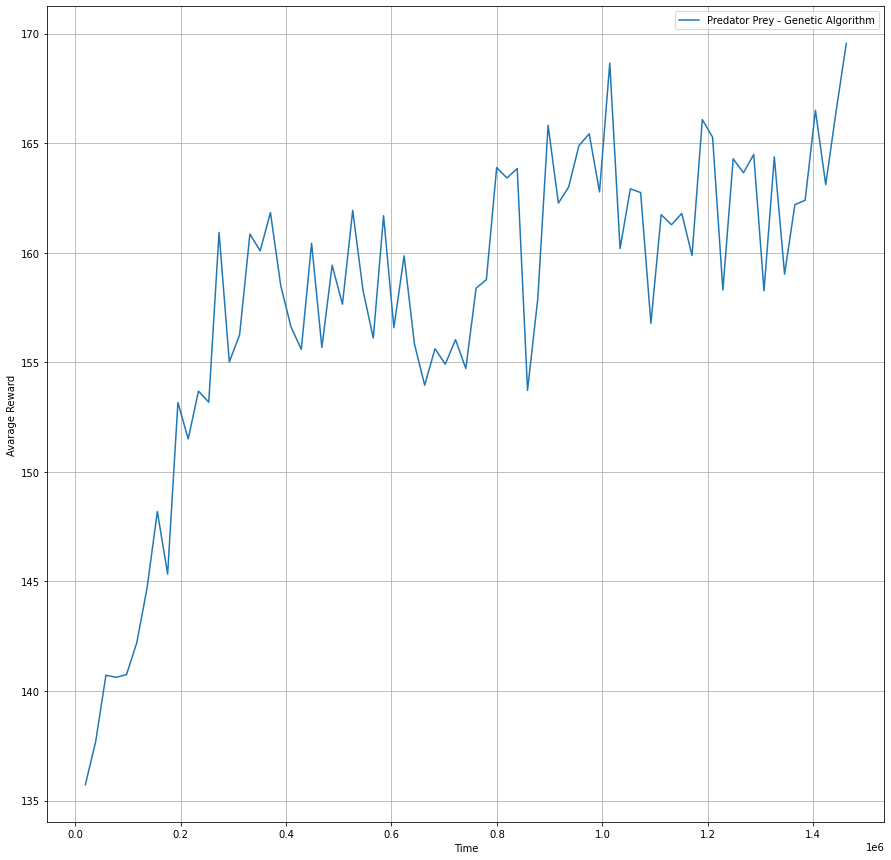

In [644]:
plt.figure(figsize=(15,15))
plt.plot(steps_x, fitness_y, label="Predator Prey - Genetic Algorithm")
plt.xlabel("Time")
plt.ylabel("Avarage Reward")
plt.grid(True)
plt.legend()
plt.show()

In [645]:
models[0]

In [646]:
model_trained = models[0]

## Save model

In [647]:
path_best_model = 'Training/my_model_PP_2'
model_trained.model.save(path_best_model)

INFO:tensorflow:Assets written to: Training/my_model_PP_2\assets


## Load model

In [648]:
path_best_model = 'Training/my_model_PP_2'
model = keras.models.load_model(path_best_model)

In [651]:
obs = env.reset()

In [652]:
'''
0 - direita
1 - esquerda
2 - cima
3 - baixo
'''

obs

array([[0, 0, 2, 2, 2],
       [0, 0, 2, 2, 2],
       [2, 0, 1, 2, 2],
       [2, 2, 0, 2, 0],
       [0, 0, 0, 0, 2]])

In [653]:
print(model_trained(obs.reshape(1, -1)).numpy(), model_trained(obs.reshape(1, -1)).numpy().argmax())

[[0.000000e+00 7.702775e-14 1.000000e+00 0.000000e+00]] 2


In [676]:
env.reset()

array([[2, 0, 0, 0, 2],
       [2, 0, 0, 2, 2],
       [0, 0, 1, 0, 0],
       [2, 2, 0, 2, 2],
       [2, 2, 2, 2, 0]])

In [680]:
[env.action_space.sample() for i in range(10)]

[0, 1, 0, 0, 0, 2, 2, 3, 3, 1]

In [677]:
for i in range(20):
    action = model_trained(obs.reshape(1, -1)).numpy().argmax()
    print(action)
    obs, _, _, _ = env.step(action)
    print(env.array, '\n')
    print(env.get_obs(), '\n')
    print(env.get_neighboors())
    print("-" * 30)

1
[[2 0 0 0 2]
 [2 0 0 2 2]
 [0 1 0 0 0]
 [2 2 0 2 2]
 [2 2 2 2 0]] 

[[2 2 0 0 0]
 [2 2 0 0 2]
 [0 0 1 0 0]
 [2 2 2 0 2]
 [0 2 2 2 2]] 

[0, 0, 0, 2]
------------------------------
1
[[2 0 0 0 2]
 [2 0 0 2 2]
 [1 0 0 0 0]
 [2 2 0 2 2]
 [2 2 2 2 0]] 

[[0 2 2 0 0]
 [2 2 2 0 0]
 [0 0 1 0 0]
 [2 2 2 2 0]
 [2 0 2 2 2]] 

[0, 0, 2, 2]
------------------------------
2
[[2 0 0 0 2]
 [1 0 0 2 2]
 [2 0 0 0 0]
 [2 2 0 2 2]
 [2 2 2 2 0]] 

[[2 0 2 2 2]
 [0 2 2 0 0]
 [2 2 1 0 0]
 [0 0 2 0 0]
 [2 2 2 2 0]] 

[0, 2, 2, 2]
------------------------------
2
[[1 0 0 0 2]
 [2 0 0 2 2]
 [2 0 0 0 0]
 [2 2 0 2 2]
 [2 2 2 2 0]] 

[[2 2 2 2 0]
 [2 0 2 2 2]
 [0 2 1 0 0]
 [2 2 2 0 0]
 [0 0 2 0 0]] 

[0, 2, 2, 2]
------------------------------
2
[[2 0 0 0 2]
 [2 0 0 2 2]
 [2 0 0 0 0]
 [2 2 0 2 2]
 [1 2 2 2 0]] 

[[0 0 2 0 0]
 [2 2 2 2 0]
 [2 0 1 2 2]
 [0 2 2 0 0]
 [2 2 2 0 0]] 

[2, 0, 2, 2]
------------------------------
1
[[2 0 0 0 2]
 [2 0 0 2 2]
 [2 0 0 0 0]
 [2 2 0 2 2]
 [0 2 2 2 1]] 

[[0 0 0 2 0]
 [0 2 2

In [575]:
episodes = 100
avg_total = 0
for ep in range(episodes):
    obs = env.reset().reshape(1, -1)
    done = False
    score = 0
    while not done:
        action = model(obs.reshape(1, -1)).numpy().argmax()
        obs, rew, done, info = env.step(action)
        if render:
            env.render()
        score += rew
    avg_total += score
    print(f"Ep: {ep} || Score: {score}")
print(f"Avg score: {avg_total / episodes}")

Ep: 0 || Score: 766
Ep: 1 || Score: 608
Ep: 2 || Score: 400
Ep: 3 || Score: 296
Ep: 4 || Score: 1181
Ep: 5 || Score: 369
Ep: 6 || Score: 1186
Ep: 7 || Score: 600
Ep: 8 || Score: 540
Ep: 9 || Score: 602
Ep: 10 || Score: 804
Ep: 11 || Score: 1208
Ep: 12 || Score: 804
Ep: 13 || Score: 1072
Ep: 14 || Score: 598
Ep: 15 || Score: 379
Ep: 16 || Score: 607
Ep: 17 || Score: 452
Ep: 18 || Score: 906
Ep: 19 || Score: 1130
Ep: 20 || Score: 296
Ep: 21 || Score: 777
Ep: 22 || Score: 796
Ep: 23 || Score: 785
Ep: 24 || Score: 668
Ep: 25 || Score: 988
Ep: 26 || Score: 864
Ep: 27 || Score: 611
Ep: 28 || Score: 600
Ep: 29 || Score: 489
Ep: 30 || Score: 586
Ep: 31 || Score: 848
Ep: 32 || Score: 982
Ep: 33 || Score: 404
Ep: 34 || Score: 634
Ep: 35 || Score: 596
Ep: 36 || Score: 920
Ep: 37 || Score: 484
Ep: 38 || Score: 1128
Ep: 39 || Score: 961
Ep: 40 || Score: 512
Ep: 41 || Score: 528
Ep: 42 || Score: 770
Ep: 43 || Score: 976
Ep: 44 || Score: 800
Ep: 45 || Score: 591
Ep: 46 || Score: 988
Ep: 47 || Score: 

In [576]:
episodes = 100
avg_total = 0
for ep in range(episodes):
    obs = env.reset().reshape(1, -1)
    done = False
    score = 0
    while not done:
        action = model(obs.reshape(1, -1)).numpy().argmax()
        obs, rew, done, info = env.step(env.action_space.sample())
        if render:
            env.render()
        score += rew
    avg_total += score
    print(f"Ep: {ep} || Score: {score}")
print(f"Avg score: {avg_total / episodes}")

Ep: 0 || Score: 537
Ep: 1 || Score: 469
Ep: 2 || Score: 523
Ep: 3 || Score: 561
Ep: 4 || Score: 660
Ep: 5 || Score: 504
Ep: 6 || Score: 572
Ep: 7 || Score: 513
Ep: 8 || Score: 446
Ep: 9 || Score: 438
Ep: 10 || Score: 688
Ep: 11 || Score: 558
Ep: 12 || Score: 543
Ep: 13 || Score: 561
Ep: 14 || Score: 454
Ep: 15 || Score: 505
Ep: 16 || Score: 496
Ep: 17 || Score: 529
Ep: 18 || Score: 471
Ep: 19 || Score: 417
Ep: 20 || Score: 897
Ep: 21 || Score: 456
Ep: 22 || Score: 451
Ep: 23 || Score: 624
Ep: 24 || Score: 645
Ep: 25 || Score: 601
Ep: 26 || Score: 505
Ep: 27 || Score: 490
Ep: 28 || Score: 530
Ep: 29 || Score: 644
Ep: 30 || Score: 496
Ep: 31 || Score: 521
Ep: 32 || Score: 565
Ep: 33 || Score: 410
Ep: 34 || Score: 388
Ep: 35 || Score: 588
Ep: 36 || Score: 407
Ep: 37 || Score: 653
Ep: 38 || Score: 477
Ep: 39 || Score: 353
Ep: 40 || Score: 613
Ep: 41 || Score: 476
Ep: 42 || Score: 525
Ep: 43 || Score: 464
Ep: 44 || Score: 384
Ep: 45 || Score: 572
Ep: 46 || Score: 497
Ep: 47 || Score: 499
Ep